# TODOs
- [x] reduce decoder linear layers
- [x] remove pe for debug
- [ ] remove dimension numbers
- [x] use xyz only

In [2]:
# %load_ext autoreload 
# %autoreload 2
# from utils import *
# from Network import *
# basic packages
import numpy as np
import glob
import math
%matplotlib notebook
%matplotlib inline
import matplotlib.pyplot as plt
import scipy.io
from scipy import stats
import os
import copy
import time
import torch
from torch import nn, Tensor
import torch.nn.functional as F
from torch.nn import TransformerEncoder, TransformerEncoderLayer
from torch.utils.data import DataLoader, Dataset, Subset, random_split
from torchvision.transforms import ToTensor
#from torch.utils.tensorboard import SummaryWriter
import torch.optim as optim
from sklearn.model_selection import train_test_split
from tqdm.autonotebook import tqdm
import sys
# sys.path.append('/scratch/xc1490/projects/tmp/python_packages')
import wandb
wandb.__version__
%pylab inline

/state/partition1/job-41989595/ipykernel_1816903/4186659708.py:26: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm


%pylab is deprecated, use %matplotlib inline and import the required libraries.
Populating the interactive namespace from numpy and matplotlib


/ext3/miniconda3/lib/python3.11/site-packages/IPython/core/magics/pylab.py:162: UserWarning: pylab import has clobbered these variables: ['copy']
`%matplotlib` prevents importing * from pylab and numpy
  warn("pylab import has clobbered these variables: %s"  % clobbered +


In [3]:
use_wandb = False
if use_wandb:
    os.environ['WANDB_DISABLE_SERVICE'] = 'True'

In [4]:
# !wandb login

In [5]:
#!pip install --target=/home/xc1490/home/projects/tmp/python_packages wandb
#!pip install --target=/home/xc1490/home/projects/tmp/python_packages click

In [6]:
# config
FRAME_RATE = 60 # 60 frames/sec
MAX_HISTORY_TIME = 10
MAX_PREDICTION_TIME = 10
HISTORY_TIME = 2
PREDICTION_TIME = 2
HISTORY_LENGTH = HISTORY_TIME*FRAME_RATE
PREDICTION_LENGTH = PREDICTION_TIME*FRAME_RATE
MAX_HISTORY_LENGTH = MAX_HISTORY_TIME*FRAME_RATE
MAX_PREDICTION_LENGTH = MAX_PREDICTION_TIME*FRAME_RATE
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
print(DEVICE)
TOTAL_FEATURE_NAMES = ['head_x','head_y','head_z','head_r_sin','head_r_cos','head_p_sin','head_p_cos','head_y_sin',\
'head_y_cos','head_rx','head_ry','head_rz']
ALL_FEATURE_NAMES = ['head_x','head_y','head_z','head_r_sin','head_r_cos','head_p_sin','head_p_cos','head_y_sin',\
'head_y_cos']
ALL_LOSS_NAMES = list(map(lambda x: x+'_loss', ALL_FEATURE_NAMES))
XYZ_FEATURE_NAMES = ['head_x', 'head_y', 'head_z']
ONE_FEATURE = ['head_x']
SC_FEATURE_NAMES = ['head_r_sin','head_r_cos','head_p_sin','head_p_cos','head_y_sin','head_y_cos']
RPY_FEATURE_NAMES = ['head_rx','head_ry','head_rz']
ANGLE_FEATURE_NAMES = ['head_r_cos','head_p_sin','head_p_cos','head_y_sin','head_y_cos','head_rx','head_ry','head_rz']
FEATURE_NAMES = XYZ_FEATURE_NAMES
FEATURE_INDEX = [ALL_FEATURE_NAMES.index(x) for x in FEATURE_NAMES]
ALL_FEATURE_SIZE = len(ALL_FEATURE_NAMES)
FEATURE_SIZE = len(FEATURE_NAMES)
BATCH_SIZE = 16

cuda


In [7]:
class FoVDataset(Dataset):
    def __init__(self, x_data, y_data, feature_idx):
        self.feature_idx = feature_idx
        self.x_data = x_data[:,:,feature_idx]
        self.y_data = y_data[:,:,feature_idx]

    def __len__(self):
        return len(self.x_data)

    def __getitem__(self, idx):
        x = torch.tensor(self.x_data[idx])
        y = torch.tensor(self.y_data[idx])
        return x,y

In [8]:
# load data
x_train = np.loadtxt(f'processed_data/x_train_{HISTORY_TIME}_{PREDICTION_TIME}.csv', dtype='float32', delimiter=',').reshape((-1,HISTORY_LENGTH,ALL_FEATURE_SIZE))
y_train = np.loadtxt(f'processed_data/y_train_{HISTORY_TIME}_{PREDICTION_TIME}.csv', dtype='float32', delimiter=',').reshape((-1,PREDICTION_LENGTH,ALL_FEATURE_SIZE))
x_val = np.loadtxt(f'processed_data/x_val_{HISTORY_TIME}_{PREDICTION_TIME}.csv', dtype='float32', delimiter=',').reshape((-1,HISTORY_LENGTH,ALL_FEATURE_SIZE))
y_val = np.loadtxt(f'processed_data/y_val_{HISTORY_TIME}_{PREDICTION_TIME}.csv', dtype='float32', delimiter=',').reshape((-1,PREDICTION_LENGTH,ALL_FEATURE_SIZE))
x_test = np.loadtxt(f'processed_data/x_test_{HISTORY_TIME}_{PREDICTION_TIME}.csv', dtype='float32', delimiter=',').reshape((-1,HISTORY_LENGTH,ALL_FEATURE_SIZE))
y_test = np.loadtxt(f'processed_data/y_test_{HISTORY_TIME}_{PREDICTION_TIME}.csv', dtype='float32', delimiter=',').reshape((-1,PREDICTION_LENGTH,ALL_FEATURE_SIZE))
mean_std = np.loadtxt(f'processed_data/xyz_mean_std_{HISTORY_TIME}_{PREDICTION_TIME}.csv', dtype='float32', delimiter=',').reshape((3, -1))

3
(15360, 9)


<Figure size 640x480 with 0 Axes>

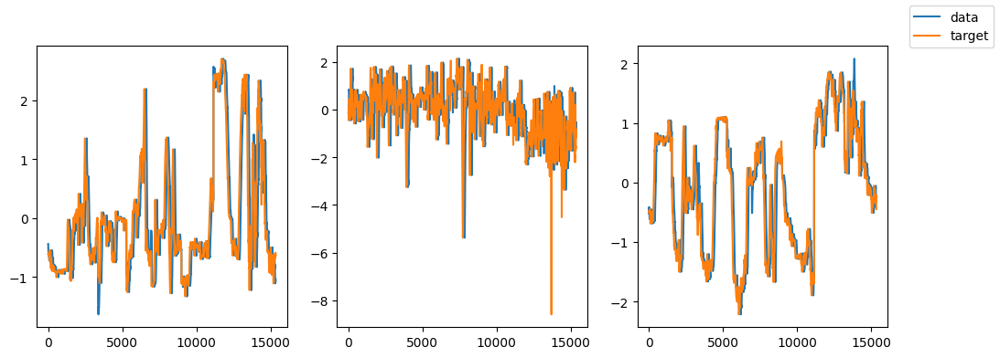

In [9]:
# visualize val dataset
feature_size = FEATURE_SIZE
print(feature_size)
x_data = x_val[::8,:,:].reshape(-1,9)
print(x_data.shape)
y_data = y_val[::8,:,:].reshape(-1,9)
plt.figure()
if feature_size<=3:
    fig, ax = plt.subplots(1, feature_size, figsize=(feature_size*4,4))
    for i in range(feature_size):
        ax[i].plot(x_data[:,i])
        ax[i].plot(y_data[:,i])
else:
    rows = (feature_size-1)//3+1
    fig, ax = plt.subplots(rows, 3, figsize=(12,4*rows))
    for i in range(rows):
        for j in range(3):
            if i*3+j<feature_size:
                ax[i][j].plot(x_data[:,3*i+j])
                ax[i][j].plot(y_data[:,3*i+j])
fig.legend(["data","target"])
plt.show()

In [10]:
# create dataset and dataloader
feature_names = FEATURE_NAMES
feature_idx = FEATURE_INDEX
x_train = x_train[:,:,feature_idx]
y_train = y_train[:,:,feature_idx]
x_val = x_val[:,:,feature_idx]
y_val = y_val[:,:,feature_idx]
x_test = x_test[:,:,feature_idx]
y_test = y_test[:,:,feature_idx]
train_data = FoVDataset(x_train, y_train, feature_idx)
val_data = FoVDataset(x_val, y_val, feature_idx)
test_data = FoVDataset(x_test, y_test, feature_idx)
train_dataloader = DataLoader(train_data, batch_size=BATCH_SIZE, shuffle=True)
val_dataloader = DataLoader(val_data, batch_size=BATCH_SIZE, shuffle=False)
test_dataloader = DataLoader(test_data, batch_size=BATCH_SIZE, shuffle=False)

In [11]:
def visualize_data(data, target, prediction=None):
    batch_size, seq_len, feature_size = data.shape
    rand_batch =random.randint(batch_size)
    rand_data = data[rand_batch]
    rand_target = target[rand_batch]
    if prediction is not None:
        rand_pred = prediction[rand_batch]
    x = np.arange(seq_len)
    plt.figure()
    if feature_size<=3:
        fig, ax = plt.subplots(1, feature_size, figsize=(feature_size*4,4))
        for i in range(feature_size):
            ax[i].plot(rand_data[:,i])
            ax[i].plot(x+seq_len, rand_target[:,i])
            if prediction is not None:
                ax[i].plot(x+seq_len, rand_pred[:,i])
    else:
        rows = (feature_size-1)//3+1
        fig, ax = plt.subplots(rows, 3, figsize=(12,4*rows))
        for i in range(rows):
            for j in range(3):
                if i*3+j<feature_size:
                    ax[i][j].plot(rand_data[:,3*i+j])
                    ax[i][j].plot(x+seq_len, rand_target[:,3*i+j])
                    if prediction is not None:
                        ax[i][j].plot(x+seq_len,rand_pred[:,3*i+j])
    if prediction is None:
        fig.legend(["data","target"])
    else:
        fig.legend(["data","target","pred"])
    plt.show()

<Figure size 640x480 with 0 Axes>

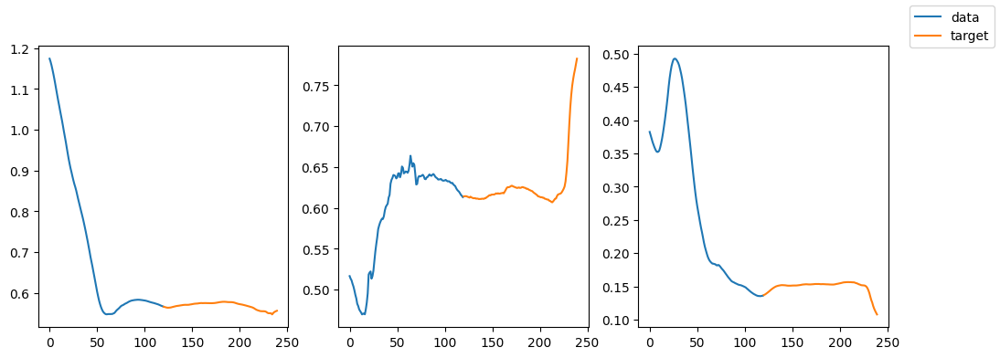

In [12]:
visualize_data(x_train,y_train)

In [13]:
# checkpointing
def save_ckpt(path, model, optimizer, epoch, train_losses, val_losses):
    
#     torch.save({'net': network.state_dict(), 'opt': optimizer.state_dict()}, fn)
    path = f'{path}/batch_{BATCH_SIZE}_{HISTORY_TIME}_{PREDICTION_TIME}_ckpts.pt'
    torch.save({
            'epoch': epoch,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'train_losses': train_losses,
            'val_losses': val_losses,
            'lr': lr
            }, path)

def load_ckpt(path, model, optimizer, device='cuda'):
    if device == 'cpu':
        checkpoint = torch.load(path,map_location=torch.device('cpu'))
    else:
        checkpoint = torch.load(path)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    epoch = checkpoint['epoch']
    train_losses = checkpoint['train_losses']
    val_losses = checkpoint['val_losses']
#     lr = checkpoint['lr']
    model.eval()
    return model, optimizer, train_losses, val_losses

In [14]:
def a_norm(Q, K, mask = None):
    m = torch.matmul(Q, K.transpose(2,1).float())
    m /= torch.sqrt(torch.tensor(Q.shape[-1]).float())
    
    
    if mask is not None:
        m.masked_fill(mask == 0, float("-1e20"))
    
    return torch.softmax(m , -1) #(batch_size, seq_length, seq_length)

def attention(Q, K, V, mask = None):
    #Attention(Q, K, V) = norm(QK)V
    a = a_norm(Q, K, mask) #(batch_size, seq_length, seq_length)
    
    return  torch.matmul(a,  V) #(batch_size, seq_length, head_dim)

class AttentionBlock(torch.nn.Module):
    def __init__(self, dim_val, head_dim):
        super(AttentionBlock, self).__init__()
        self.value = nn.Linear(dim_val, head_dim, bias=False)
        self.key = nn.Linear(dim_val, head_dim, bias=False)
        self.query = nn.Linear(dim_val, head_dim, bias=False)
    
    def forward(self, x, kv = None, mask = None):
        if(kv is None):
            #Attention with x connected to Q,K and V (For encoder)
            output =  attention(self.query(x), self.key(x), self.value(x), mask)
        else:
            #Attention with x as Q, external vector kv as K an V (For decoder)
            output = attention(self.query(x), self.key(kv), self.value(kv), mask)

        
        return output #(batch_size, seq_length, head_dim)
    
class MultiHeadAttentionBlock(torch.nn.Module):
    def __init__(self, dim_val, head_dim, n_heads):
        super(MultiHeadAttentionBlock, self).__init__()
        self.heads = []
        for i in range(n_heads):
            self.heads.append(AttentionBlock(dim_val, head_dim))
        self.heads = nn.ModuleList(self.heads)
        self.fc = nn.Linear(n_heads * head_dim, dim_val)
                      
    def forward(self, x, kv = None, mask = None):
        a = []
        for h in self.heads:
            a.append(h(x, kv = kv, mask = mask)) # [[N, seq_len, head_dim]_1,...,[]_heads]
            
        a = torch.stack(a, dim = -1) #combine heads
        a = a.flatten(start_dim = 2) #flatten all head outputs [N, seq_len, dim_val]
        x = self.fc(a)
        
        return x

# https://pytorch.org/tutorials/beginner/transformer_tutorial.html
class PositionalEncoding(nn.Module):
    def __init__(self, d_model, max_len=600, dropout=0.1):
        super(PositionalEncoding, self).__init__()
        pe = torch.zeros(max_len, d_model)
        position = torch.arange(0, max_len, dtype=torch.float).unsqueeze(1)
        div_term = torch.exp(torch.arange(0, d_model, 2).float() * (-math.log(10000.0)/ d_model))
        
        pe[:, 0::2] = torch.sin(position * div_term)
        pe[:, 1::2] = torch.cos(position * div_term[:pe[:,1::2].shape[1]])
        
        pe = pe.unsqueeze(0).transpose(0, 1)
        
        self.register_buffer('pe', pe) # [seq_len, dim_val]
        
    def forward(self, x):
        x = x + self.pe[:x.size(1), :].squeeze(1) # x + [seq_len, dim_val]
        return x  

#TODO
class RelativePositionalEncoding(nn.Module):
    def __init__(self, seq_len, dropout=0.1, max_len=5000):
        super(RelativePositionalEncoding, self).__init__()
        self.seq_len = seq_len
        self.table = nn.Linear(seq_len, 2*seq_len)
        

    def forward(self, x):
        x = table(x)
        return x 
class EncoderLayer(torch.nn.Module):
    def __init__(self, dim_val, head_dim, n_heads = 1, dropout=0.1):
        super(EncoderLayer, self).__init__()
        self.attn = MultiHeadAttentionBlock(dim_val, head_dim , n_heads)
        #self.attn = MultiHeadAttention(dim_val,head_dim ,  n_heads)
        self.fc1 = nn.Linear(dim_val, dim_val)
        self.fc2 = nn.Linear(dim_val, dim_val)
        self.norm1 = nn.LayerNorm(dim_val)
        self.norm2 = nn.LayerNorm(dim_val)
        # added a dropout layer
        self.dropout = nn.Dropout(dropout)
    
    def forward(self, x, mask = None):
        # x: [N, enc_seq_len, dim_val]
        a = self.attn(x, mask)
        x1 = self.norm1(x + a)
        # does not have an forward expansion factor here! But maybe not a bad thing since we want smaller embedding size
        a1 = self.fc1(F.elu(self.fc2(x1)))
#         out = self.dropout(self.norm2(x1 + a1))
        out = self.norm2(x1 + a1) # [N, enc_seq_len, dim_val]
        #import pdb;pdb.set_trace()
        return out

class DecoderLayer(torch.nn.Module):
    def __init__(self, dim_val, head_dim, n_heads = 1, dropout=0.1):
        super(DecoderLayer, self).__init__()
        self.attn1 = MultiHeadAttentionBlock(dim_val, head_dim, n_heads)
        self.attn2 = MultiHeadAttentionBlock(dim_val, head_dim, n_heads)
        self.fc1 = nn.Linear(dim_val, dim_val)
        self.fc2 = nn.Linear(dim_val, dim_val)
        self.norm1 = nn.LayerNorm(dim_val)
        self.norm2 = nn.LayerNorm(dim_val)
        self.norm3 = nn.LayerNorm(dim_val)
        self.dropout = nn.Dropout(dropout)
        
    def forward(self, x, enc, mask):
        # x: [N, dec_seq_len, dim_val]
        a = self.attn1(x, kv=None, mask = mask)
        x = self.norm1(a + x)
        a = self.attn2(x, kv = enc, mask = mask) # TODO check does this need mask?
        x = self.norm2(a + x)
        a = self.fc1(F.elu(self.fc2(x)))
        x = self.norm3(x + a) # x: [N, dec_seq_len, dim_val]
        return x

class Transformer(torch.nn.Module):
    def __init__(self, dim_val, head_dim, feature_size, in_seq_len, out_seq_len, n_decoder_layers = 1, \
                 n_encoder_layers = 1, n_heads = 1, pe_mode = 'standard', device='cuda'):
        """
            dim_val: d_model - 64
            head_dim: 16
            feature_size: input feature size - 9(all)/3(xyz)/6(angles)
            in_seq_len: length of decoder input sequence - 600
            out_seq_len: decoder output sequence length - 1 or 600?
            pe_mode: positional encoding mode - 'relative' or 'standard' or 'none'
        """
        self.device=device
        super(Transformer, self).__init__()
        self.in_seq_len = in_seq_len
        #Initiate encoder and Decoder layers
        self.encs = nn.ModuleList()
        for i in range(n_encoder_layers):
            self.encs.append(EncoderLayer(dim_val, head_dim, n_heads))
        
#         self.decs = nn.ModuleList()
#         for i in range(n_decoder_layers):
#             self.decs.append(DecoderLayer(dim_val, head_dim, n_heads))
        self.pe_mode = pe_mode
        if pe_mode == 'standard':
            self.pos = PositionalEncoding(dim_val)
        #Dense layers for managing network inputs and outputs
#         self.enc_input_fc = nn.Linear(feature_size, dim_val)
#         self.enc_input_fc = nn.Sequential(
#             nn.Linear(feature_size, dim_val//2),
#             nn.LeakyReLU(),
#             nn.Linear(dim_val//2, dim_val),
#         )
        self.enc_input_fc = nn.Linear(feature_size, dim_val)
        self.dec_input_fc = nn.Linear(feature_size, dim_val)
#         self.enc_input_fc = nn.Conv1d(feature_size, dim_val,1)
#         self.dec_input_fc = nn.Conv1d(feature_size, dim_val,1)
#         self.out_fc = nn.Linear(dec_seq_len * dim_val, out_seq_len)
#         self.out_fc = nn.Sequential(
#             nn.Linear(dim_val, int(dim_val/2)),
#             nn.LeakyReLU(),
#             nn.Linear(int(dim_val/2), feature_size),
#         )
        self.out_fc = nn.Linear(dim_val, feature_size)
        self.final_activation = F.elu
        
    def make_trg_mask(self, N, trg_len):
        trg_mask = torch.tril(torch.ones((trg_len, trg_len))).expand(
           N, 1, trg_len, trg_len
        )
        return trg_mask.to(self.device)
    
    def forward(self, x, target=None):
        # x: [N, enc_seq_len, feature_size] = [8, 600, 9]
        # dec_input = [N, dec_seq_len, feature_size]
        
        # MLP
        mlp = self.enc_input_fc(x) # [N, enc_seq_len, dim_val]
        #encoder
        #print ('mlp',mlp)
#         mlp = x
        if self.pe_mode=='stardard':
            e = self.encs[0](self.pos(mlp))
            #print ('pe',  e)
        else:
            e = self.encs[0]( mlp )
            #print ('no pe',e)
        for enc in self.encs[1:]:
            e = enc(e) # [N, enc_seq_len, dim_val]
        #print ('e',e)
#         out = e
        #decoder
        out = self.out_fc(e) # [N, enc_seq_len, feature_size]
        #print ('out',out)
        #out = self.final_activation(out)
        #import pdb;pdb.set_trace()
        return out


In [48]:
#cp ../FoV_jinhan/processed_data/xyz_mean_std.csv processed_data/

In [ ]:
train_data_exam = next(iter(train_dataloader))[0]
train_data_exam.shape
fig,ax=plt.subplots(3,3,figsize=(20,9))
for i in range(3):
    for j in range(3):
        ax[i,j].hist(train_data_exam[:,:,i*3+j].numpy().ravel());

In [15]:
#training hyperparams
enc_seq_len = HISTORY_LENGTH
dec_seq_len = PREDICTION_LENGTH
output_sequence_length = PREDICTION_LENGTH

n_heads = 3 ##4
head_dim = 3 #32 # dimension of each head, not total
dim_val = 9 #16#n_heads*head_dim # embedding dimension, all heads together
lr = 0.005
tf_rate = 0.5
epochs = 400
n_decoder_layers = 2
n_encoder_layers = 2
batch_size = BATCH_SIZE
n_batches = len(train_dataloader)

#init network and optimizer
model = Transformer(dim_val, head_dim, FEATURE_SIZE, dec_seq_len, output_sequence_length, n_decoder_layers, n_encoder_layers, n_heads, pe_mode='None',device=DEVICE).to(device=DEVICE)
optimizer = torch.optim.Adam(model.parameters(), lr=lr)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, 1.0, gamma=0.95)
#keep track of loss for graph
train_losses = []
val_losses = []
test_losses = []
sep_train_losses = []
sep_val_losses = []
sep_test_losses = []
train_pearsonr_arr = []
val_pearsonr_arr = []
test_pearsonr_arr = []

In [16]:
model(torch.rand(16,120,3).cuda()).shape

torch.Size([16, 120, 3])

In [17]:
def my_loss(output, target, feature_names):
    # compute loss for each feature
    # output/target: [N, seq_len, 9]
    # change sin cos back to angle ?
    if 'head_r_sin' in feature_names:
        feature_idx = feature_names.index('head_r_sin')
        output_rx = torch.atan2(output[:,:,feature_idx], output[:,:,feature_idx+1]).unsqueeze(2)
        target_rx = torch.atan2(target[:,:,feature_idx], target[:,:,feature_idx+1]).unsqueeze(2)
        output = torch.cat((output,output_rx),-1)
    if 'head_p_sin' in feature_names:
        feature_idx = feature_names.index('head_p_sin')
        output_ry = torch.atan2(output[:,:,feature_idx], output[:,:,feature_idx+1]).unsqueeze(2)
        target_ry = torch.atan2(target[:,:,feature_idx], target[:,:,feature_idx+1]).unsqueeze(2)
        output = torch.cat((output,output_ry),-1)
    if 'head_y_sin' in feature_names:
        feature_idx = feature_names.index('head_y_sin')
        output_rz = torch.atan2(output[:,:,feature_idx], output[:,:,feature_idx+1]).unsqueeze(2)
        target_rz = torch.atan2(target[:,:,feature_idx], target[:,:,feature_idx+1]).unsqueeze(2)
        output = torch.cat((output,output_rz),-1)
        
    
    loss = torch.mean((output - target) ** 2, [0,1])
    pearsonr = stats.pearsonr(output.detach().cpu().flatten(), target.detach().cpu().flatten())
    return loss, pearsonr

In [18]:

def train(model: nn.Module, data_loader, optimizer, scaler, writer, step, feature_names, plot_flag = False) -> None:
    progress_bar = tqdm(data_loader)
    model.train() # turn on train mode
    feature_size = len(feature_names)
    loss_names = list(map(lambda x: x+'_loss', feature_names))
    total_loss = 0.
    start_time = time.time()
    num_batches = len(data_loader)
    log_interval = num_batches // 5
    return_loss = 0.
    sep_return_loss = np.zeros((1,feature_size))
    loss_dict_train = {}
#     total_sep_loss = np.zeros((1,6))
    for batch_idx, (data, targets) in enumerate(progress_bar):
#         print("batch index: ", batch_idx)
        data = data.to(device=DEVICE)
        targets = targets.to(device=DEVICE)
        # with torch.cuda.amp.autocast():
        output = model(data)
        optimizer.zero_grad()
        # loss = criterion(output, targets)
        sep_loss, train_pearsonr = my_loss(output, targets, feature_names)
#         print("sep_loss shape: ", sep_loss.unsqueeze(0).shape)
        # scaler.scale(loss).backward()
        loss = torch.sum(sep_loss[:feature_size])
        loss.backward()
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1)
        # scaler.step(optimizer)
        optimizer.step()
        # scaler.update()
        #writer.add_scalar("Training Loss", loss, global_step=step)
        step += 1
        total_loss += loss.item()
        return_loss += loss.item()
        sep_return_loss += sep_loss.detach().cpu().numpy()
        progress_bar.set_postfix_str(f"training loss={loss.item():.4e}|avg training loss={total_loss/(batch_idx+1):.4e}")
        loss_dict_train['training loss'] = loss.item()
        for name_count, loss_name in enumerate(loss_names):
            loss_dict_train[loss_name] = sep_loss[name_count]
        loss_dict_train['avg training loss'] = total_loss/(batch_idx+1)
        loss_dict_train['train pearsonr'] = train_pearsonr
        
        if use_wandb:
            wandb.log(loss_dict_train) 
        if batch_idx % log_interval == 0 and batch_idx > 0:
            lr = scheduler.get_last_lr()[0]
            ms_per_batch = (time.time() - start_time) * 1000 / log_interval
            cur_loss = total_loss / log_interval
            print(f'| epoch {epoch:3d} | {batch_idx:5d}/{num_batches:5d} batches | '
                  f'lr {lr:02.5f} | ms/batch {ms_per_batch:5.5f} | '
                  f'loss {cur_loss:5.5f}')
            total_loss = 0
            start_time = time.time()
            if plot_flag == True:
                # training prediction
                print ('training prediction')
                visualize_data(data.detach().cpu().numpy(), targets.detach().cpu().numpy(), output.detach().cpu().numpy())
    return return_loss/(batch_idx+1), sep_return_loss/(batch_idx+1), train_pearsonr

def validate(model: nn.Module, dataloader: DataLoader, feature_names, plot_flag = False) -> float:
    feature_size = len(feature_names)
    loss_names = list(map(lambda x: x+'_loss', feature_names))
    model.eval()
    total_loss = 0.
    sep_total_loss = np.zeros((1,feature_size))
    loss_dict_valid = {}
    iter_count = 0
    with torch.no_grad():
        for (data, targets) in dataloader:
            data = data.to(device=DEVICE) # [N, seq_len, feature_size]
            targets = targets.to(device=DEVICE) # [N, seq_len, feature_size]
            output = model(data)
            if plot_flag and iter_count == 0:
                print ('validation prediction')
                visualize_data(data.detach().cpu().numpy(), targets.detach().cpu().numpy(), output.detach().cpu().numpy())
                if use_wandb:
                    wandb.log({"validation plot": fig})
            sep_valid_loss, valid_pearsonr = my_loss(output, targets, feature_names)
            total_loss += torch.sum(sep_valid_loss)
            sep_total_loss += sep_valid_loss.detach().cpu().numpy()
            #import pdb;pdb.set_trace()
            for name_count, loss_name in enumerate(loss_names):
                loss_dict_valid[loss_name] = sep_valid_loss[name_count]
            #loss_dict_valid['valid loss'] = sep_valid_loss
            loss_dict_valid['valid pearsonr'] = valid_pearsonr[0]
            iter_count += 1
            if use_wandb:
                wandb.log(loss_dict_valid) 
    return total_loss/(len(dataloader) - 1), sep_total_loss/(len(dataloader) - 1), valid_pearsonr
    

# def inference(model: nn.Module, dataloader: DataLoader) -> float:
#     model.eval()  # turn on evaluation mode
#     total_loss = 0.
#     o = []
#     loss_dict_test = {}
#     with torch.no_grad():
#         for (data, targets) in dataloader:
#             data = data.to(device=DEVICE) # [N, seq_len, feature_size]
#             targets = targets.to(device=DEVICE) # [N, seq_len, feature_size]
#             N, seq_len, feature_size = targets.shape
#             dec_input = torch.zeros(targets.shape)
#             for i in range(seq_len):
#                 if i == 0:
#                     dec_input = data
#                     output = model(data, dec_input)
#                     o = output
#                 else:
#                     dec_input[:,:seq_len-i,:] = data[:,i:,:]
#                     dec_input[:,seq_len-i:,:] = o
#                     output = model(data, dec_input)
#                     o = torch.hstack(o, output[:,-1,:])
#             test_loss = my_loss(o, targets).item()
#             total_loss += test_loss
#             loss_dict_test['test loss'] = test_loss
#             wandb.log(loss_dict_test) 
#             # print("val loss: ", total_loss)
#             # data = data.permute(1, 0, 2) #.detach().cpu().numpy()
#             # output = output.permute(1, 0, 2) #.detach().cpu().numpy()
#             # print("output2: ", output[0][0])
#     return total_loss / (len(dataloader) - 1)

In [53]:
if use_wandb:
    wandb.init(
        project="Transformer_Enc_MLP",
        # track hyperparameters and run metadata
        #config=vars(args)
        config={
            "epochs": epochs,
            "batch_size": batch_size,
            "history_time": HISTORY_TIME,
            "prediction_time": PREDICTION_TIME,
            "learning_rate": lr,
            "dim_val": dim_val,
            "decoder": "MLP"
        }
    )

In [20]:
#cp ../FoV_jinhan/checkpoints/* checkpoints/

In [ ]:
model, optimizer, train_losses, val_losses = load_ckpt("{}/checkpoints/epoch_{}_batch_{}_ckpts.pt".format(os.getcwd(), 50, batch_size), model, optimizer)
total_train_loss, sep_train_loss, train_pearsonr = validate(model, train_dataloader)

  0%|          | 0/200 [00:00<?, ?it/s]

Epoch #1


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch   1 |    74/  373 batches | lr 0.00500 | ms/batch 27.60522 | loss 1.10483
training prediction


<Figure size 640x480 with 0 Axes>

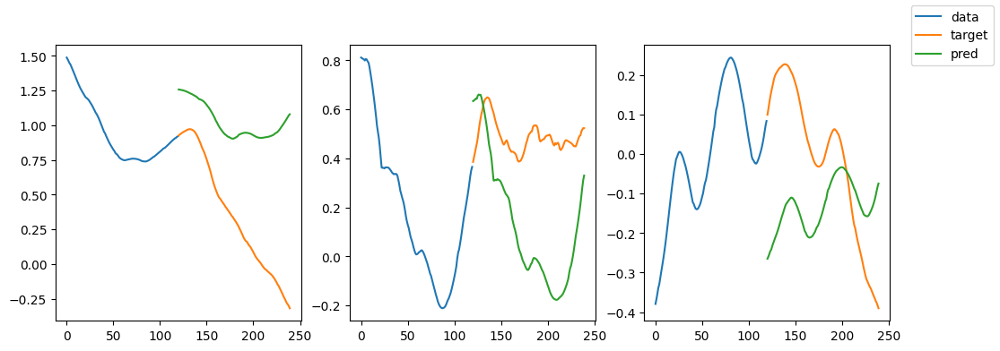

| epoch   1 |   148/  373 batches | lr 0.00500 | ms/batch 11.51796 | loss 0.82087
training prediction


<Figure size 640x480 with 0 Axes>

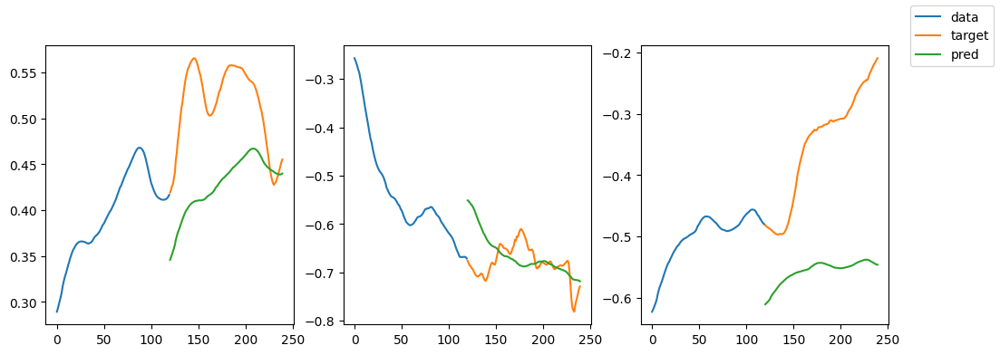

| epoch   1 |   222/  373 batches | lr 0.00500 | ms/batch 11.31590 | loss 0.81964
training prediction


<Figure size 640x480 with 0 Axes>

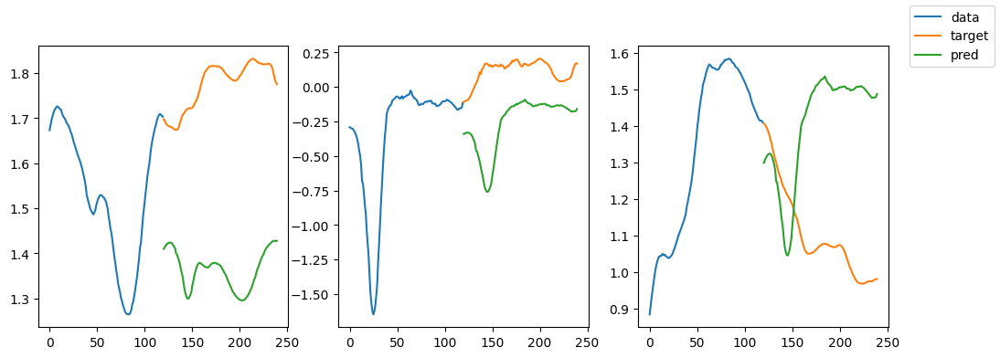

| epoch   1 |   296/  373 batches | lr 0.00500 | ms/batch 11.52296 | loss 0.69125
training prediction


<Figure size 640x480 with 0 Axes>

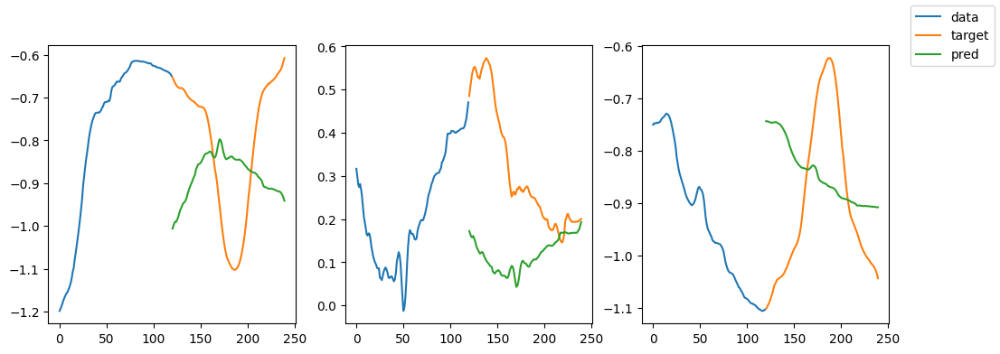

| epoch   1 |   370/  373 batches | lr 0.00500 | ms/batch 11.74321 | loss 0.73354
training prediction


<Figure size 640x480 with 0 Axes>

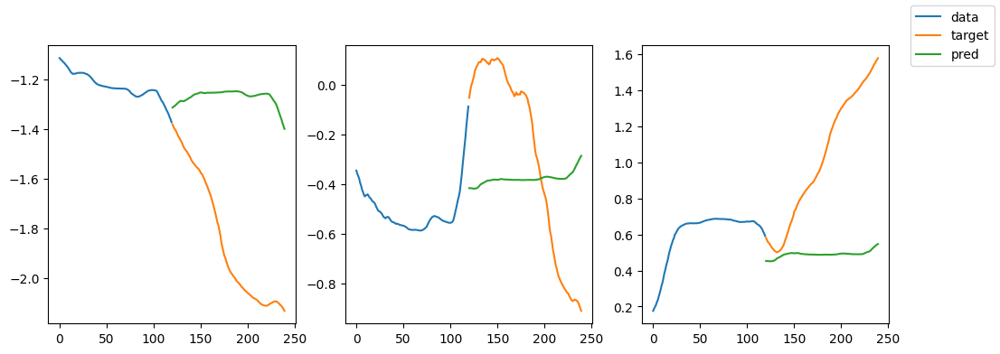

validation prediction


<Figure size 640x480 with 0 Axes>

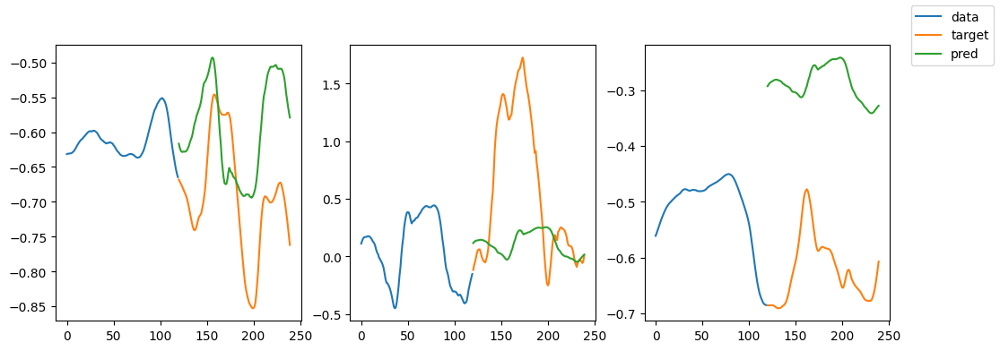

validation prediction


<Figure size 640x480 with 0 Axes>

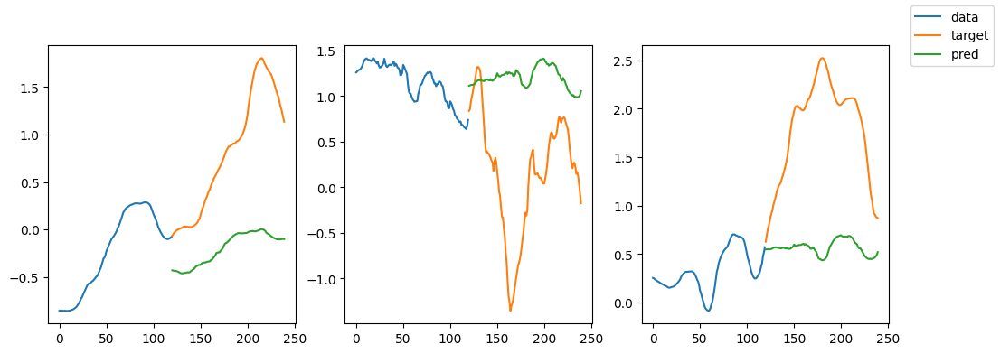

-----------------------------------------------------------------------------------------
| end of epoch   1 | time:  6.30s | valid loss 1.6654 | mean loss   0.8297
-----------------------------------------------------------------------------------------


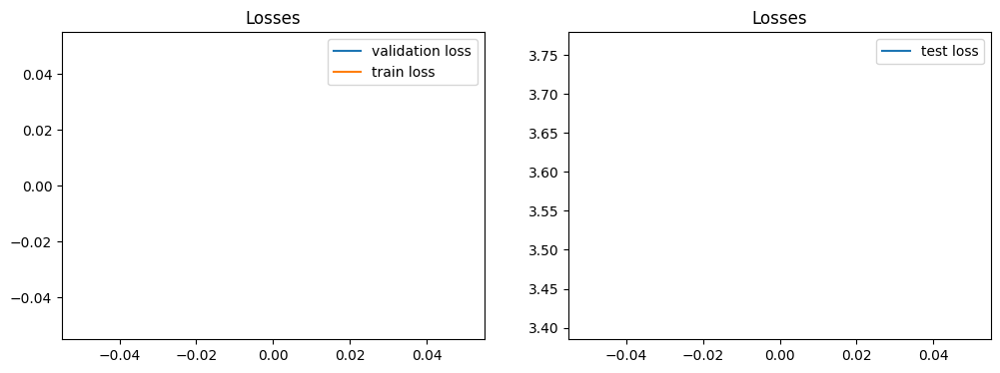

Epoch #2


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch   2 |    74/  373 batches | lr 0.00475 | ms/batch 8.72760 | loss 0.68684
| epoch   2 |   148/  373 batches | lr 0.00475 | ms/batch 8.56765 | loss 0.66826
| epoch   2 |   222/  373 batches | lr 0.00475 | ms/batch 8.56651 | loss 0.73653
| epoch   2 |   296/  373 batches | lr 0.00475 | ms/batch 8.58417 | loss 0.64881
| epoch   2 |   370/  373 batches | lr 0.00475 | ms/batch 8.63487 | loss 0.77398
-----------------------------------------------------------------------------------------
| end of epoch   2 | time:  3.43s | valid loss 1.6148 | mean loss   0.7654
-----------------------------------------------------------------------------------------
Epoch #3


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch   3 |    74/  373 batches | lr 0.00451 | ms/batch 8.70689 | loss 0.72688
training prediction


<Figure size 640x480 with 0 Axes>

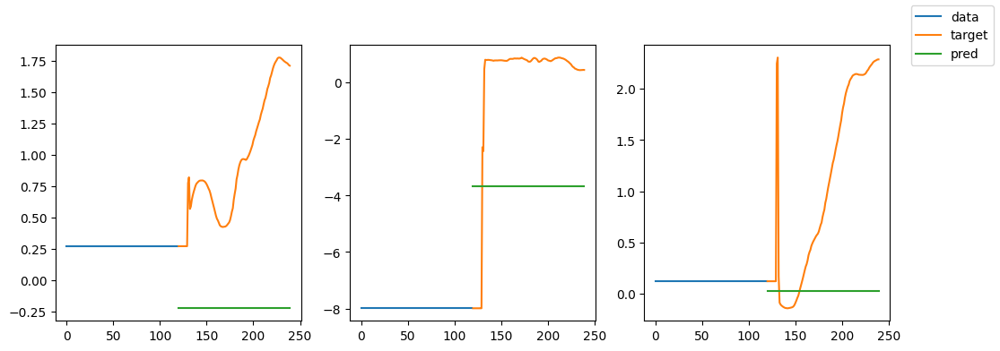

| epoch   3 |   148/  373 batches | lr 0.00451 | ms/batch 14.04331 | loss 0.67558
training prediction


<Figure size 640x480 with 0 Axes>

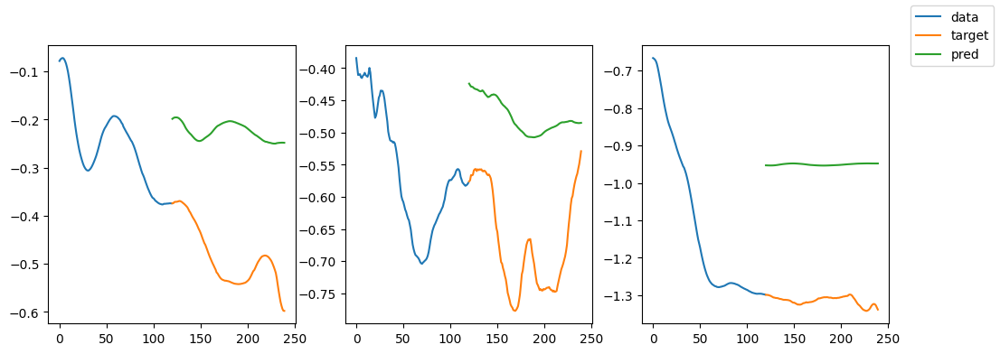

| epoch   3 |   222/  373 batches | lr 0.00451 | ms/batch 11.50601 | loss 0.65596
training prediction


<Figure size 640x480 with 0 Axes>

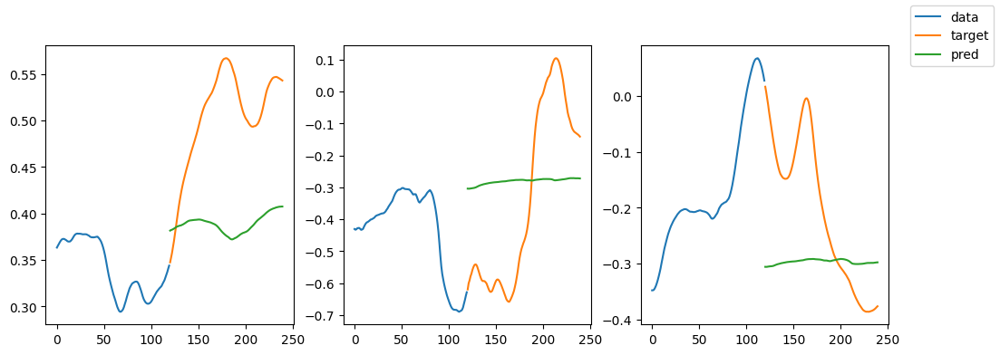

| epoch   3 |   296/  373 batches | lr 0.00451 | ms/batch 11.49501 | loss 0.59047
training prediction


<Figure size 640x480 with 0 Axes>

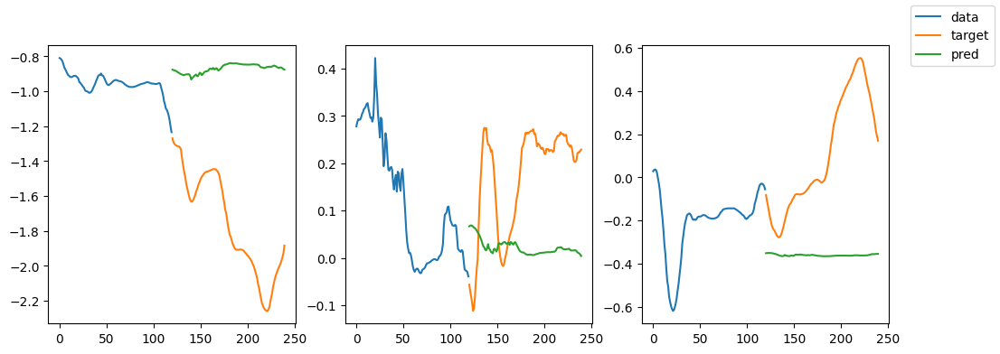

| epoch   3 |   370/  373 batches | lr 0.00451 | ms/batch 11.45360 | loss 0.71725
training prediction


<Figure size 640x480 with 0 Axes>

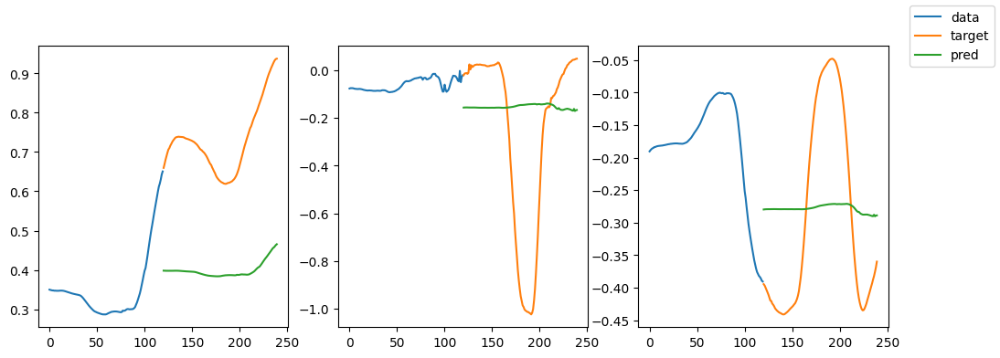

validation prediction


<Figure size 640x480 with 0 Axes>

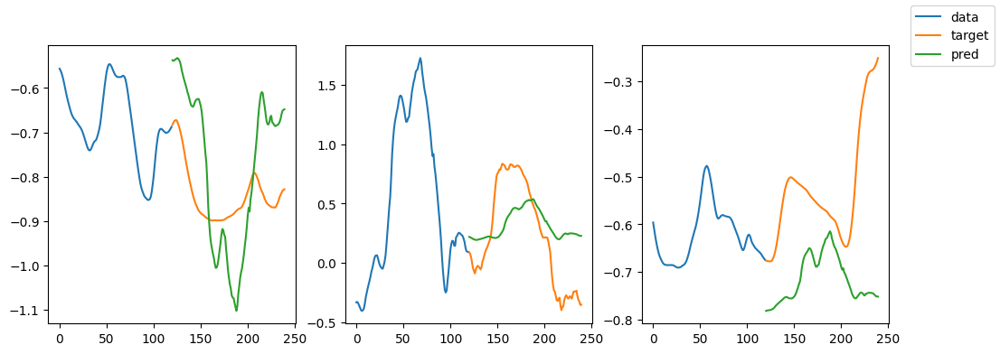

validation prediction


<Figure size 640x480 with 0 Axes>

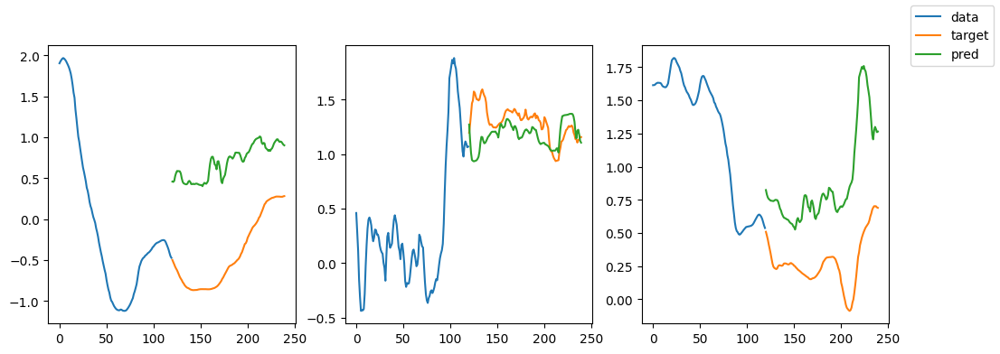

-----------------------------------------------------------------------------------------
| end of epoch   3 | time:  5.11s | valid loss 1.5774 | mean loss   0.7338
-----------------------------------------------------------------------------------------


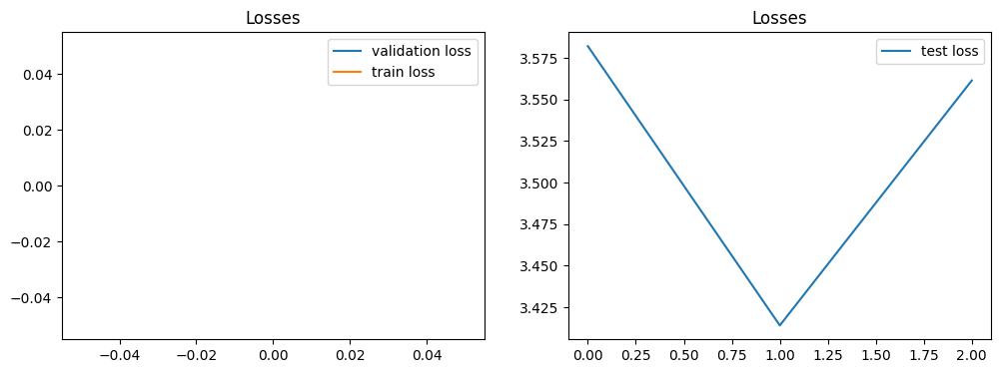

Epoch #4


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch   4 |    74/  373 batches | lr 0.00429 | ms/batch 8.74288 | loss 0.73711
| epoch   4 |   148/  373 batches | lr 0.00429 | ms/batch 8.63091 | loss 0.65061
| epoch   4 |   222/  373 batches | lr 0.00429 | ms/batch 8.57162 | loss 0.63714
| epoch   4 |   296/  373 batches | lr 0.00429 | ms/batch 8.58532 | loss 0.59237
| epoch   4 |   370/  373 batches | lr 0.00429 | ms/batch 8.61746 | loss 0.69474
-----------------------------------------------------------------------------------------
| end of epoch   4 | time:  3.43s | valid loss 1.6281 | mean loss   0.7152
-----------------------------------------------------------------------------------------
Epoch #5


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch   5 |    74/  373 batches | lr 0.00407 | ms/batch 8.75133 | loss 0.64582
training prediction


<Figure size 640x480 with 0 Axes>

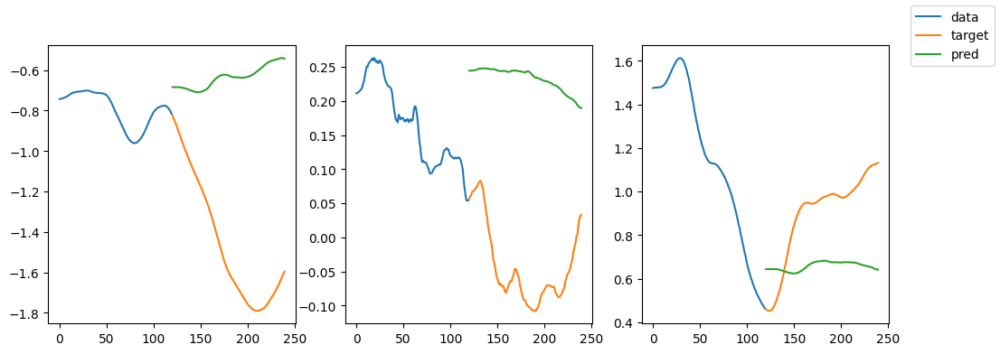

| epoch   5 |   148/  373 batches | lr 0.00407 | ms/batch 11.51354 | loss 0.72503
training prediction


<Figure size 640x480 with 0 Axes>

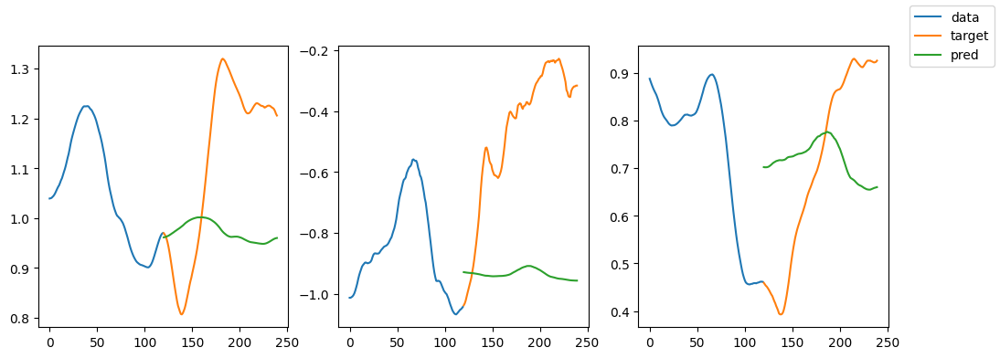

| epoch   5 |   222/  373 batches | lr 0.00407 | ms/batch 11.32587 | loss 0.56679
training prediction


<Figure size 640x480 with 0 Axes>

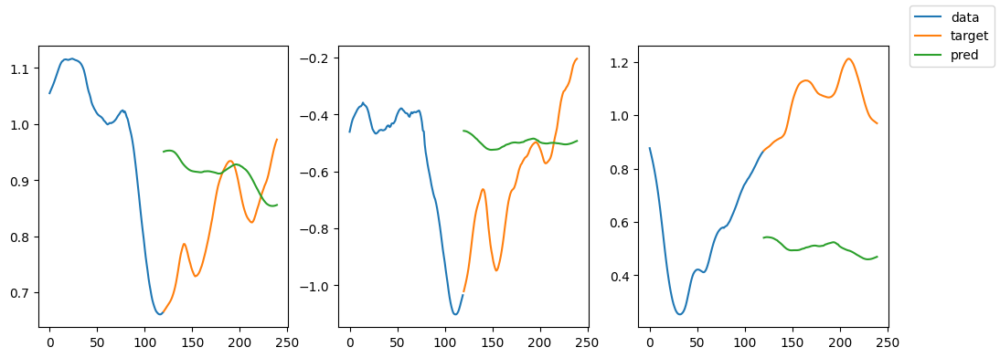

| epoch   5 |   296/  373 batches | lr 0.00407 | ms/batch 11.23752 | loss 0.60626
training prediction


<Figure size 640x480 with 0 Axes>

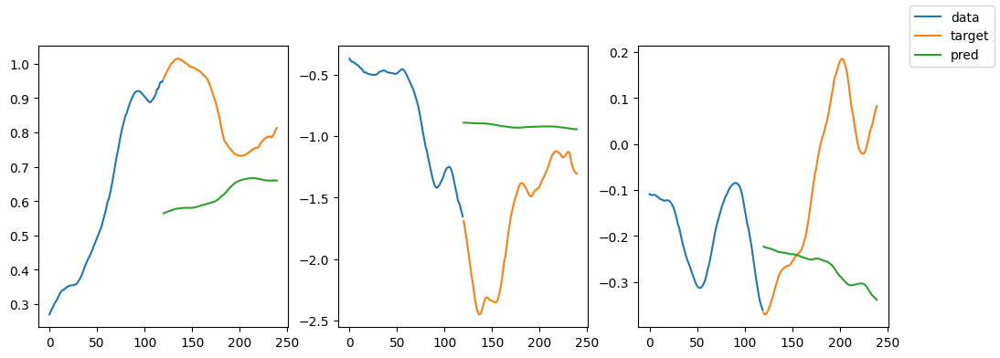

| epoch   5 |   370/  373 batches | lr 0.00407 | ms/batch 14.23870 | loss 0.69429
training prediction


<Figure size 640x480 with 0 Axes>

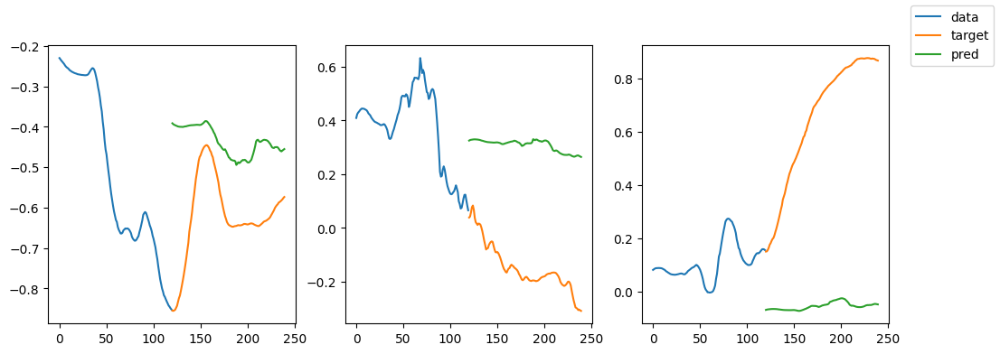

validation prediction


<Figure size 640x480 with 0 Axes>

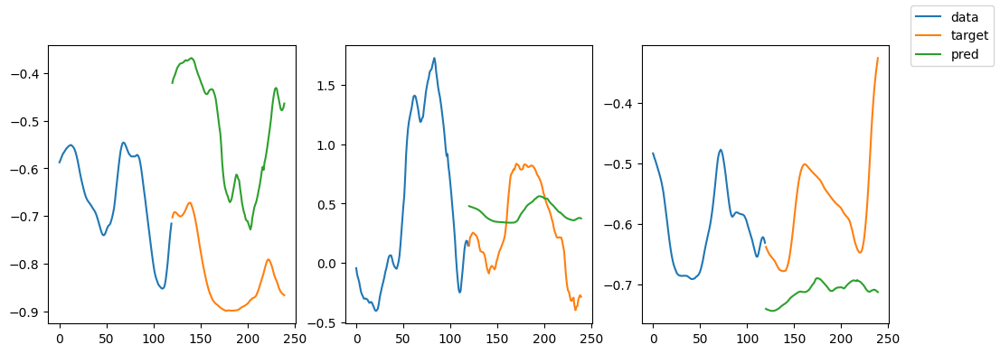

validation prediction


<Figure size 640x480 with 0 Axes>

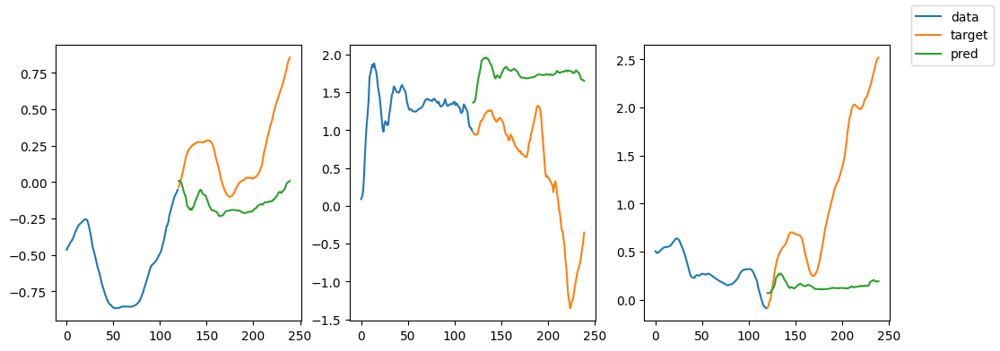

-----------------------------------------------------------------------------------------
| end of epoch   5 | time:  5.08s | valid loss 1.6859 | mean loss   0.7013
-----------------------------------------------------------------------------------------


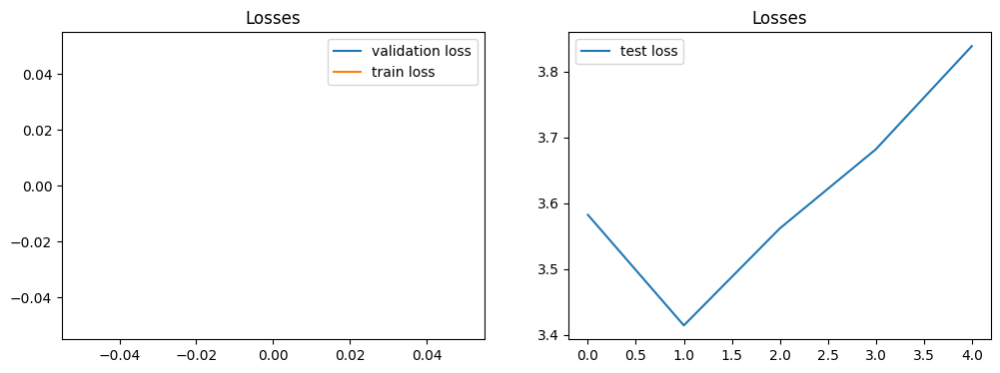

Epoch #6


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch   6 |    74/  373 batches | lr 0.00387 | ms/batch 8.88990 | loss 0.68285
| epoch   6 |   148/  373 batches | lr 0.00387 | ms/batch 8.62282 | loss 0.63578
| epoch   6 |   222/  373 batches | lr 0.00387 | ms/batch 8.62132 | loss 0.58302
| epoch   6 |   296/  373 batches | lr 0.00387 | ms/batch 8.65049 | loss 0.67951
| epoch   6 |   370/  373 batches | lr 0.00387 | ms/batch 8.67581 | loss 0.61632
-----------------------------------------------------------------------------------------
| end of epoch   6 | time:  3.46s | valid loss 1.7085 | mean loss   0.6904
-----------------------------------------------------------------------------------------
Epoch #7


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch   7 |    74/  373 batches | lr 0.00368 | ms/batch 8.75083 | loss 0.55304
training prediction


<Figure size 640x480 with 0 Axes>

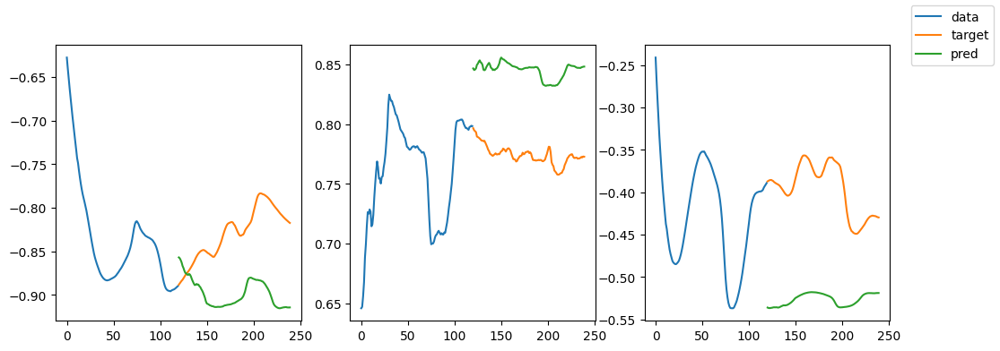

| epoch   7 |   148/  373 batches | lr 0.00368 | ms/batch 11.42008 | loss 0.64016
training prediction


<Figure size 640x480 with 0 Axes>

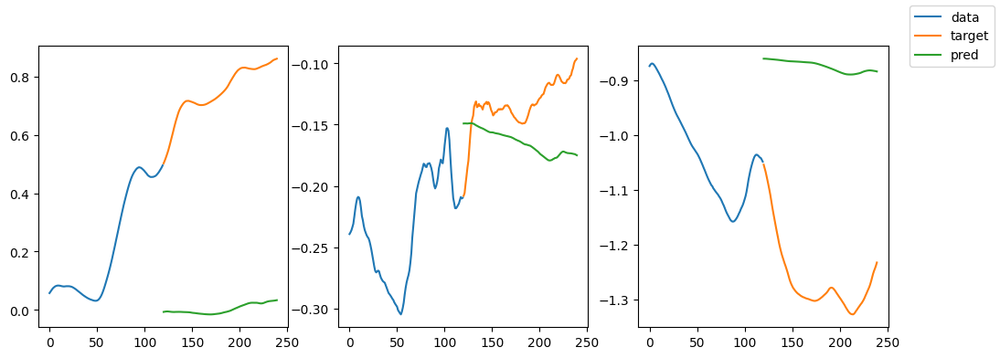

| epoch   7 |   222/  373 batches | lr 0.00368 | ms/batch 11.29193 | loss 0.62427
training prediction


<Figure size 640x480 with 0 Axes>

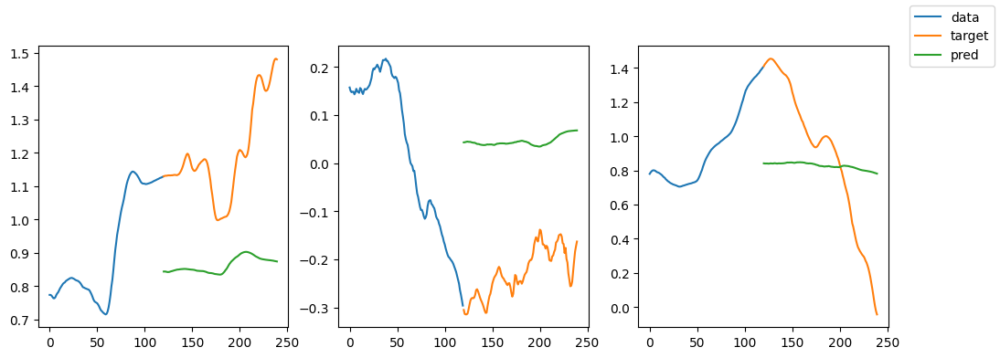

| epoch   7 |   296/  373 batches | lr 0.00368 | ms/batch 11.48654 | loss 0.70552
training prediction


<Figure size 640x480 with 0 Axes>

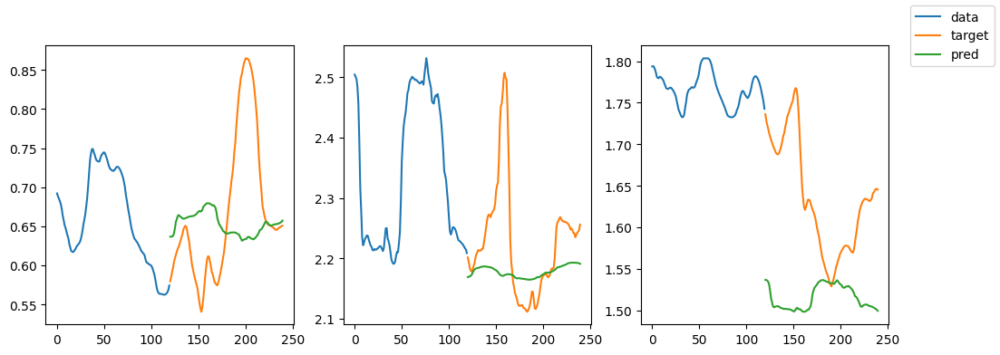

| epoch   7 |   370/  373 batches | lr 0.00368 | ms/batch 11.46993 | loss 0.63562
training prediction


<Figure size 640x480 with 0 Axes>

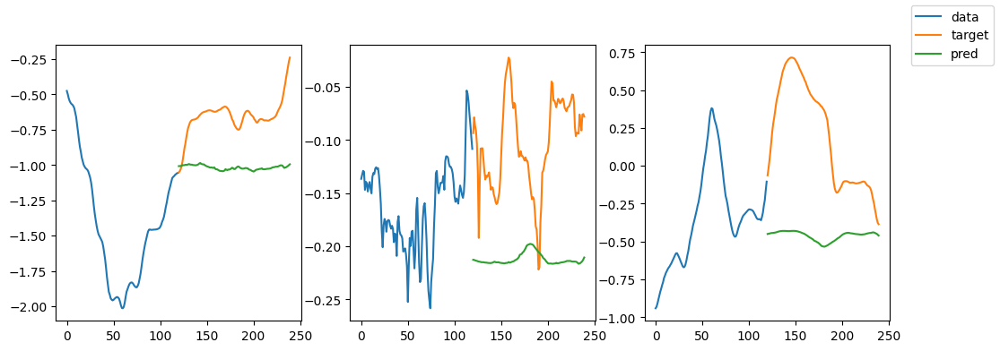

validation prediction


<Figure size 640x480 with 0 Axes>

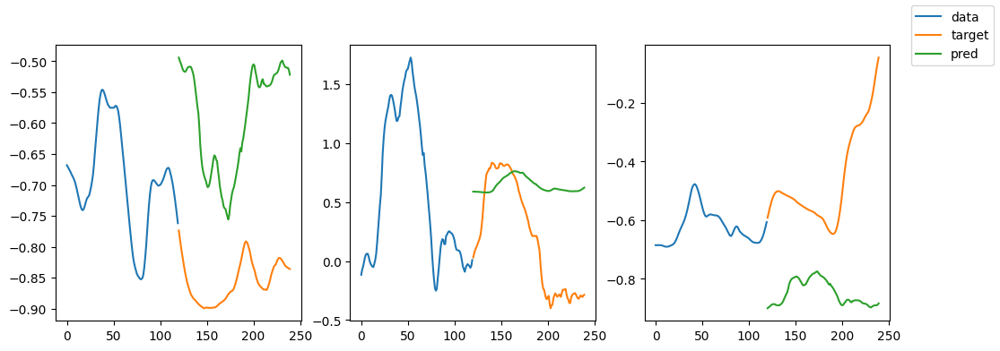

validation prediction


<Figure size 640x480 with 0 Axes>

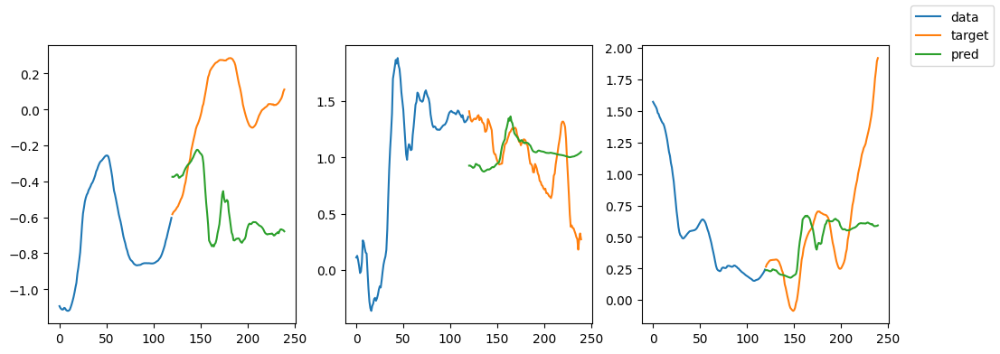

-----------------------------------------------------------------------------------------
| end of epoch   7 | time:  5.09s | valid loss 1.6587 | mean loss   0.6816
-----------------------------------------------------------------------------------------


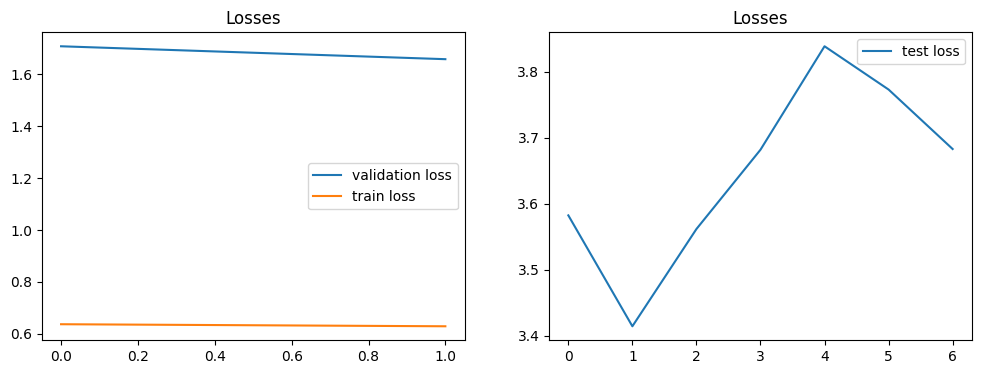

Epoch #8


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch   8 |    74/  373 batches | lr 0.00349 | ms/batch 8.80748 | loss 0.61534
| epoch   8 |   148/  373 batches | lr 0.00349 | ms/batch 8.62245 | loss 0.61811
| epoch   8 |   222/  373 batches | lr 0.00349 | ms/batch 8.65287 | loss 0.71855
| epoch   8 |   296/  373 batches | lr 0.00349 | ms/batch 8.83665 | loss 0.56486
| epoch   8 |   370/  373 batches | lr 0.00349 | ms/batch 8.69462 | loss 0.63000
-----------------------------------------------------------------------------------------
| end of epoch   8 | time:  3.47s | valid loss 1.7755 | mean loss   0.6746
-----------------------------------------------------------------------------------------
Epoch #9


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch   9 |    74/  373 batches | lr 0.00332 | ms/batch 8.81798 | loss 0.67312
training prediction


<Figure size 640x480 with 0 Axes>

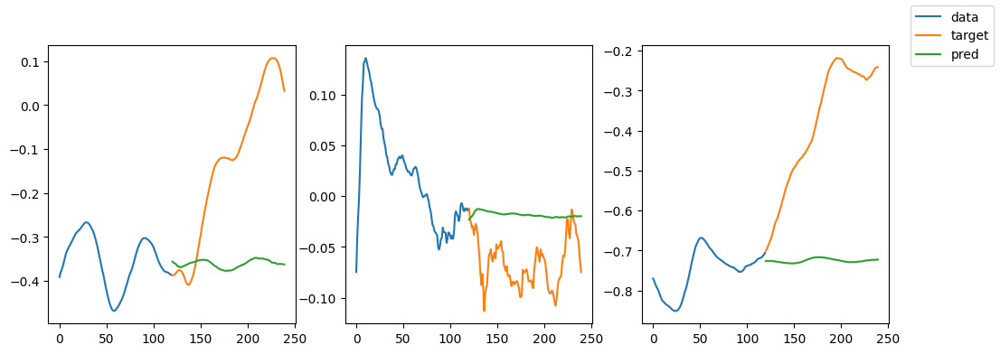

| epoch   9 |   148/  373 batches | lr 0.00332 | ms/batch 11.44064 | loss 0.60844
training prediction


<Figure size 640x480 with 0 Axes>

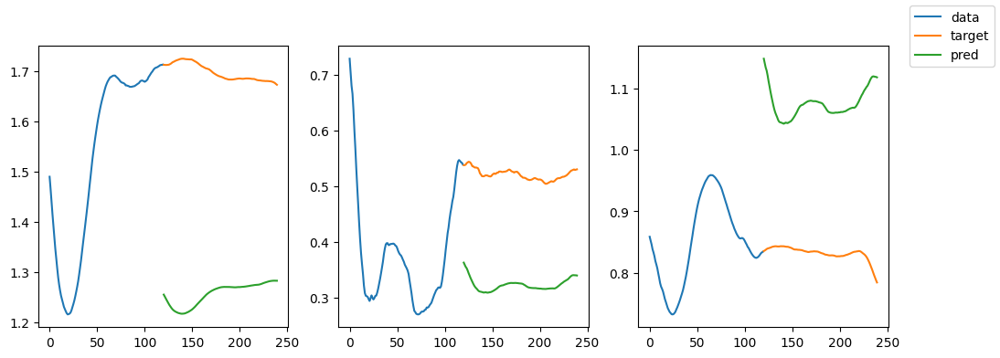

| epoch   9 |   222/  373 batches | lr 0.00332 | ms/batch 11.23648 | loss 0.61213
training prediction


<Figure size 640x480 with 0 Axes>

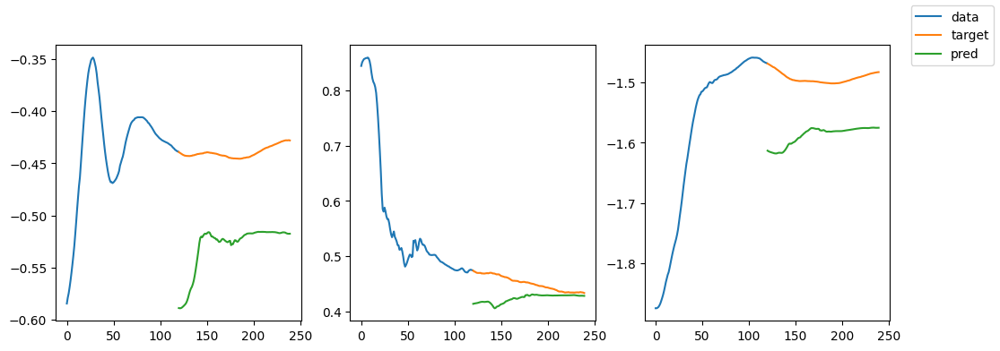

| epoch   9 |   296/  373 batches | lr 0.00332 | ms/batch 11.26902 | loss 0.61867
training prediction


<Figure size 640x480 with 0 Axes>

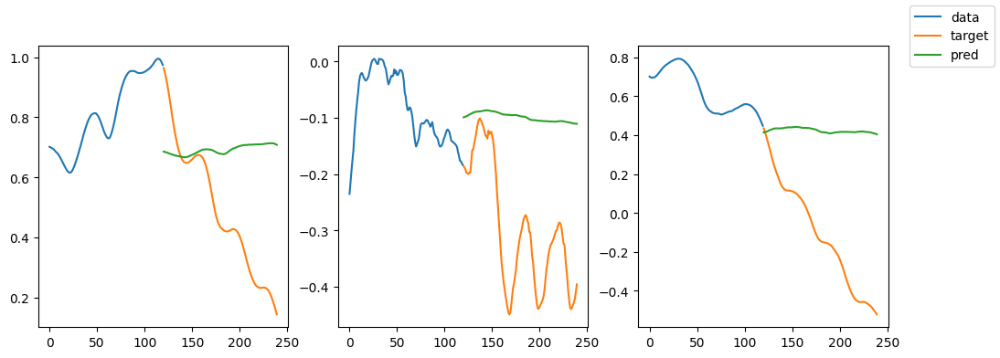

| epoch   9 |   370/  373 batches | lr 0.00332 | ms/batch 11.32517 | loss 0.60790
training prediction


<Figure size 640x480 with 0 Axes>

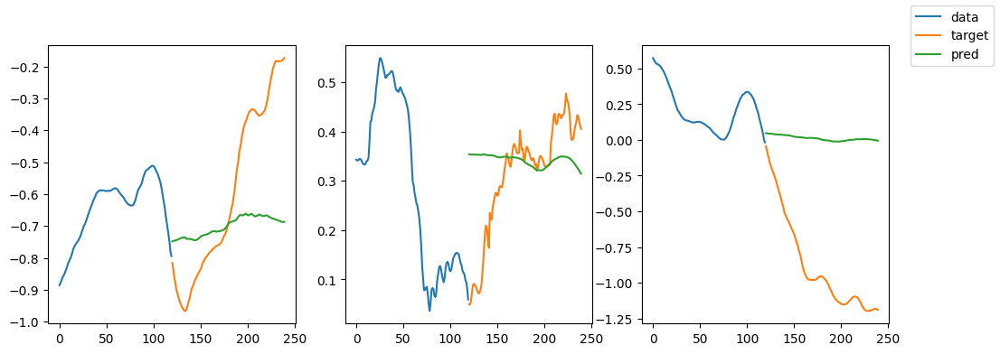

validation prediction


<Figure size 640x480 with 0 Axes>

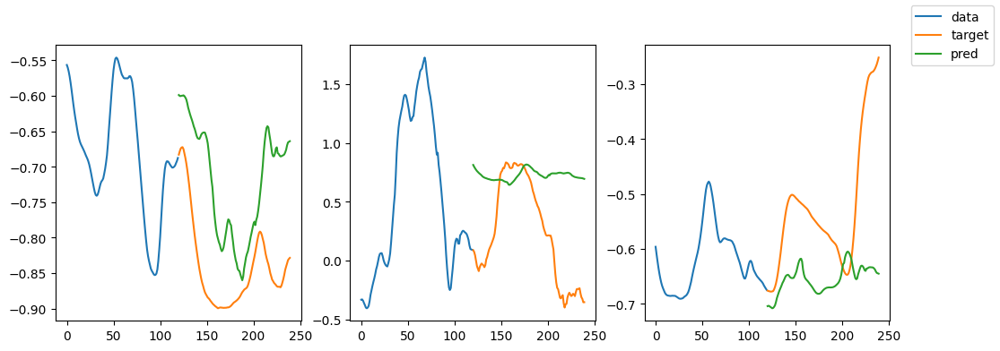

validation prediction


<Figure size 640x480 with 0 Axes>

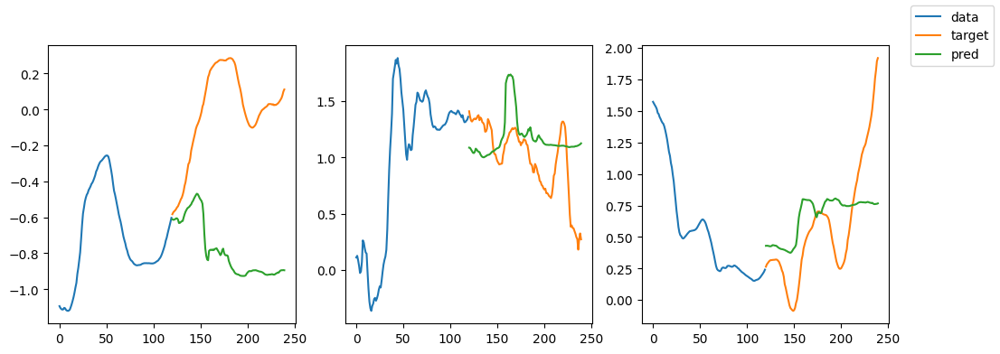

-----------------------------------------------------------------------------------------
| end of epoch   9 | time:  4.87s | valid loss 1.7810 | mean loss   0.6687
-----------------------------------------------------------------------------------------


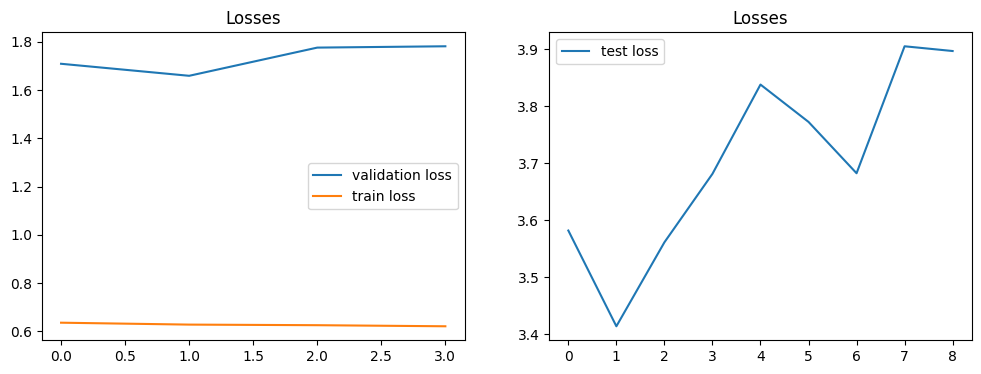

Epoch #10


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  10 |    74/  373 batches | lr 0.00315 | ms/batch 8.76882 | loss 0.60915
| epoch  10 |   148/  373 batches | lr 0.00315 | ms/batch 8.56520 | loss 0.63277
| epoch  10 |   222/  373 batches | lr 0.00315 | ms/batch 8.57044 | loss 0.62820
| epoch  10 |   296/  373 batches | lr 0.00315 | ms/batch 8.56575 | loss 0.58816
| epoch  10 |   370/  373 batches | lr 0.00315 | ms/batch 8.59085 | loss 0.61746
-----------------------------------------------------------------------------------------
| end of epoch  10 | time:  3.43s | valid loss 1.7644 | mean loss   0.6631
-----------------------------------------------------------------------------------------
Epoch #11


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  11 |    74/  373 batches | lr 0.00299 | ms/batch 8.79246 | loss 0.65915
training prediction


<Figure size 640x480 with 0 Axes>

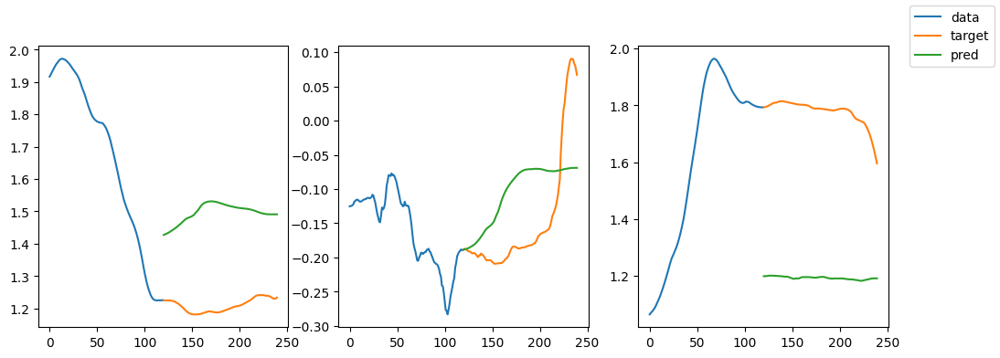

| epoch  11 |   148/  373 batches | lr 0.00299 | ms/batch 11.41914 | loss 0.55249
training prediction


<Figure size 640x480 with 0 Axes>

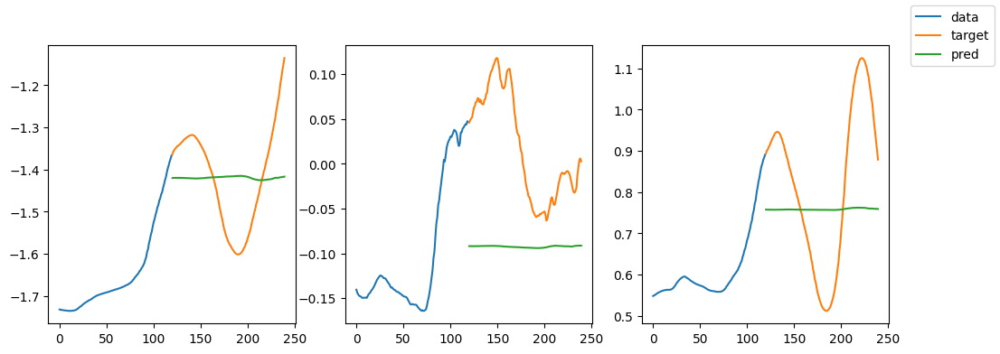

| epoch  11 |   222/  373 batches | lr 0.00299 | ms/batch 14.46730 | loss 0.65469
training prediction


<Figure size 640x480 with 0 Axes>

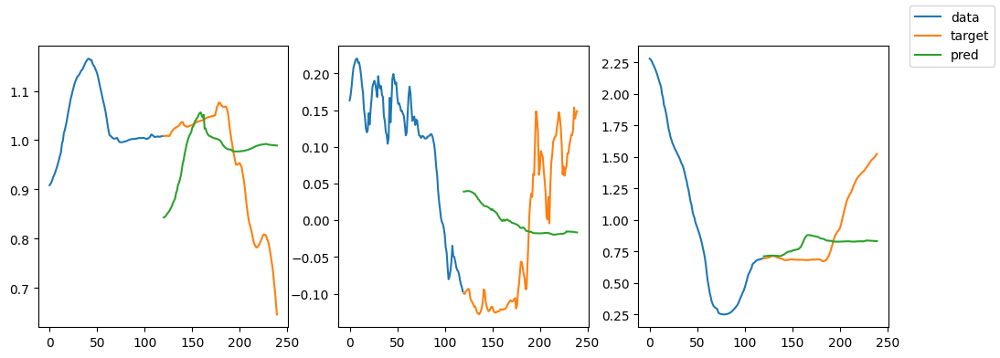

| epoch  11 |   296/  373 batches | lr 0.00299 | ms/batch 11.51432 | loss 0.62584
training prediction


<Figure size 640x480 with 0 Axes>

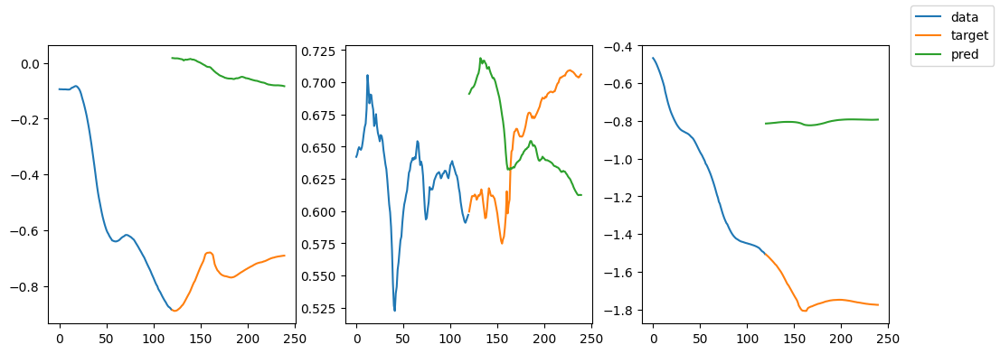

| epoch  11 |   370/  373 batches | lr 0.00299 | ms/batch 11.54144 | loss 0.58675
training prediction


<Figure size 640x480 with 0 Axes>

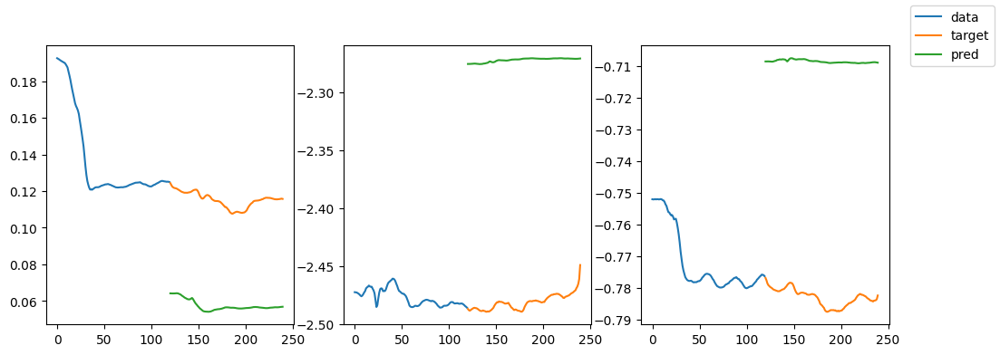

validation prediction


<Figure size 640x480 with 0 Axes>

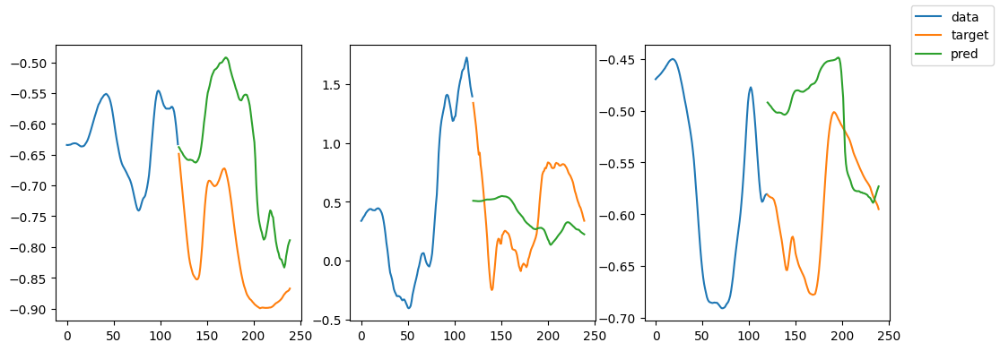

validation prediction


<Figure size 640x480 with 0 Axes>

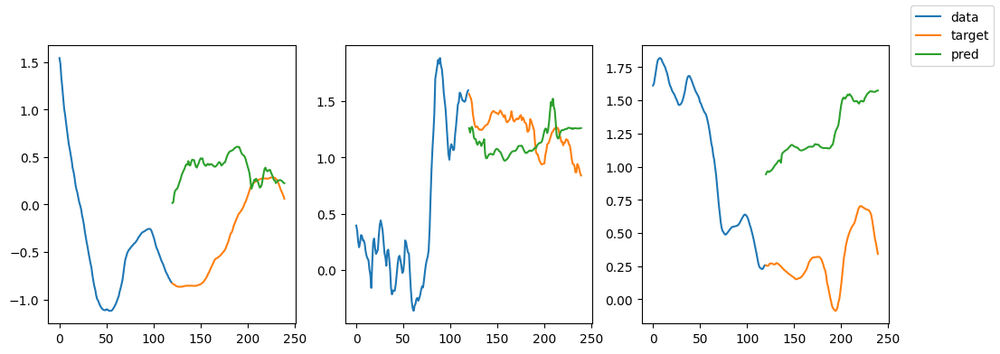

-----------------------------------------------------------------------------------------
| end of epoch  11 | time:  5.14s | valid loss 1.7082 | mean loss   0.6587
-----------------------------------------------------------------------------------------


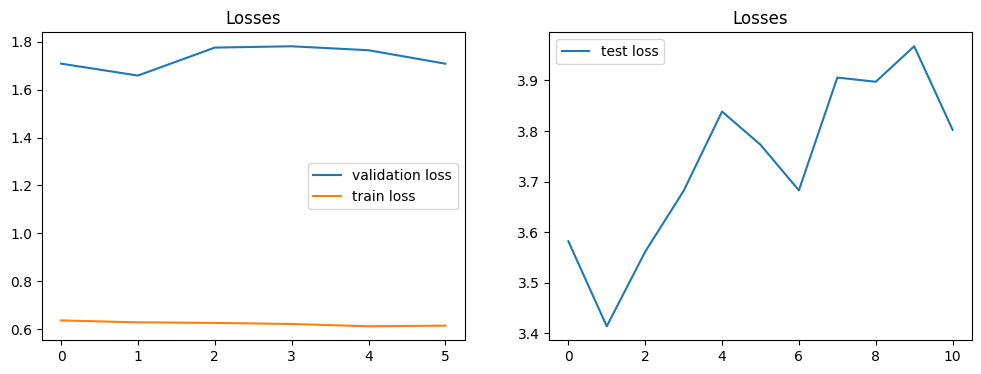

Epoch #12


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  12 |    74/  373 batches | lr 0.00284 | ms/batch 8.74161 | loss 0.60889
| epoch  12 |   148/  373 batches | lr 0.00284 | ms/batch 8.57791 | loss 0.59179
| epoch  12 |   222/  373 batches | lr 0.00284 | ms/batch 8.58017 | loss 0.57877
| epoch  12 |   296/  373 batches | lr 0.00284 | ms/batch 8.55774 | loss 0.68463
| epoch  12 |   370/  373 batches | lr 0.00284 | ms/batch 8.70931 | loss 0.57440
-----------------------------------------------------------------------------------------
| end of epoch  12 | time:  3.43s | valid loss 1.7163 | mean loss   0.6546
-----------------------------------------------------------------------------------------
Epoch #13


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  13 |    74/  373 batches | lr 0.00270 | ms/batch 8.69775 | loss 0.65707
training prediction


<Figure size 640x480 with 0 Axes>

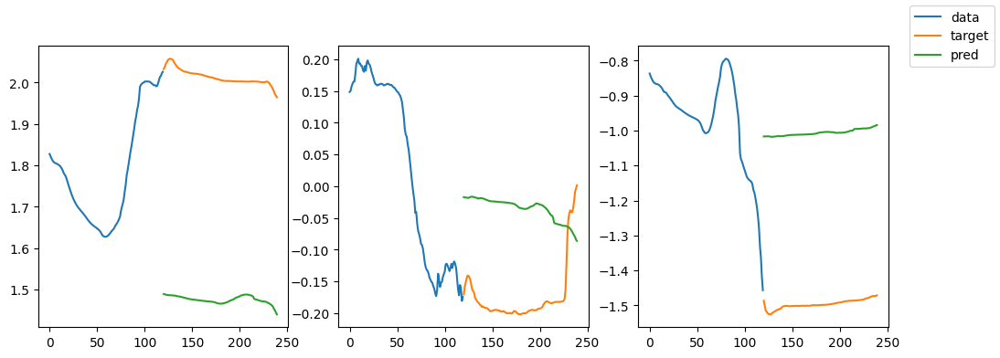

| epoch  13 |   148/  373 batches | lr 0.00270 | ms/batch 11.47977 | loss 0.56928
training prediction


<Figure size 640x480 with 0 Axes>

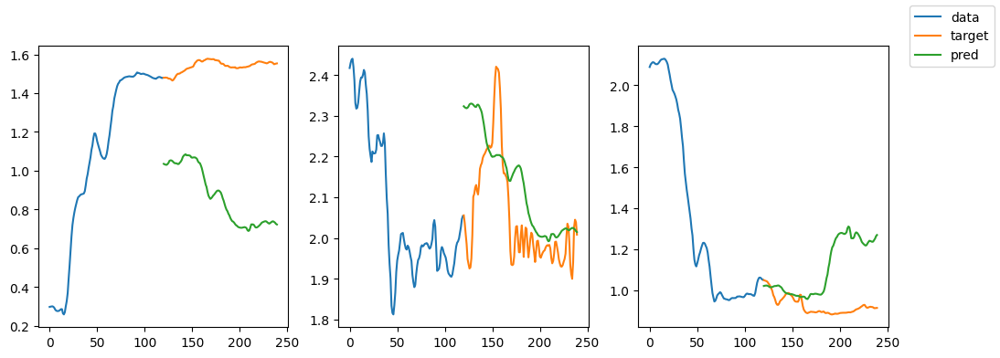

| epoch  13 |   222/  373 batches | lr 0.00270 | ms/batch 11.41114 | loss 0.60729
training prediction


<Figure size 640x480 with 0 Axes>

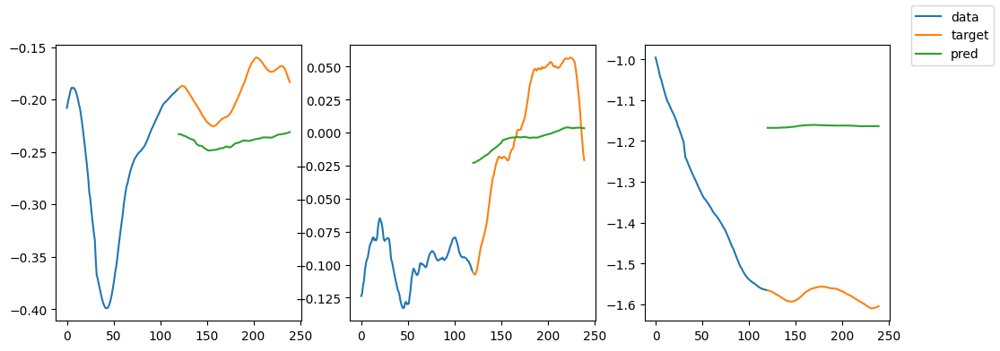

| epoch  13 |   296/  373 batches | lr 0.00270 | ms/batch 11.40598 | loss 0.58325
training prediction


<Figure size 640x480 with 0 Axes>

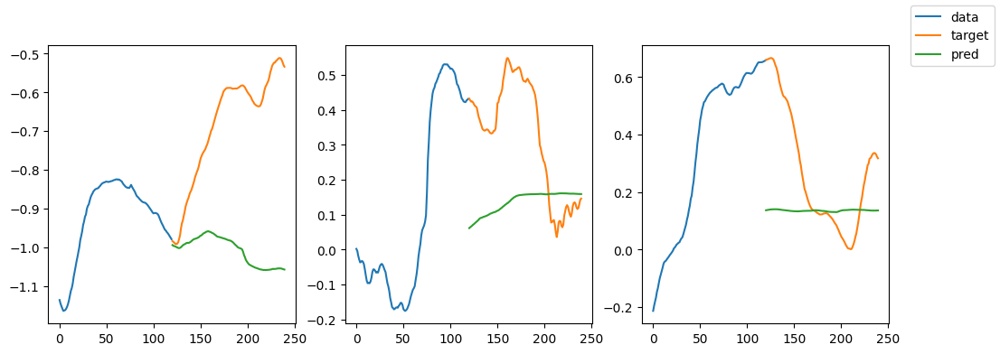

| epoch  13 |   370/  373 batches | lr 0.00270 | ms/batch 11.38827 | loss 0.57869
training prediction


<Figure size 640x480 with 0 Axes>

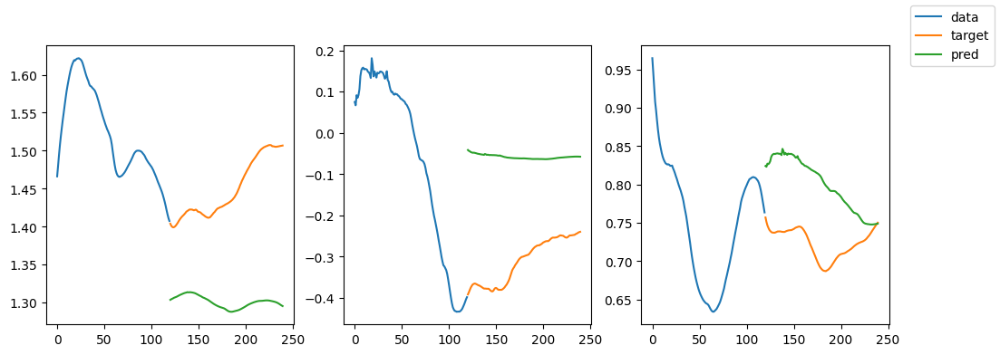

validation prediction


<Figure size 640x480 with 0 Axes>

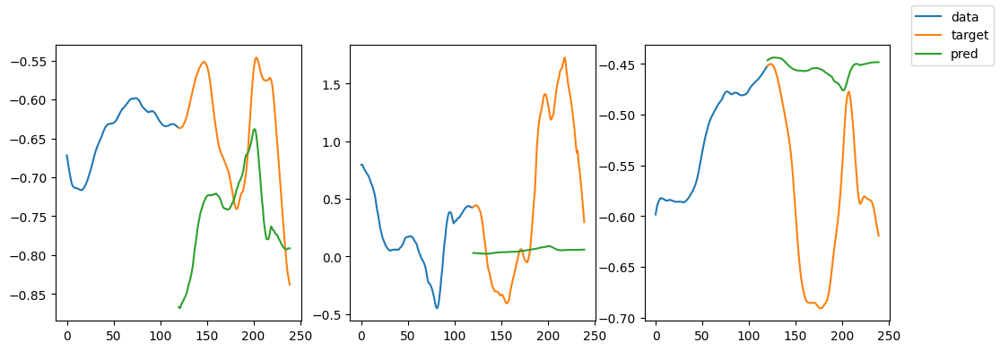

validation prediction


<Figure size 640x480 with 0 Axes>

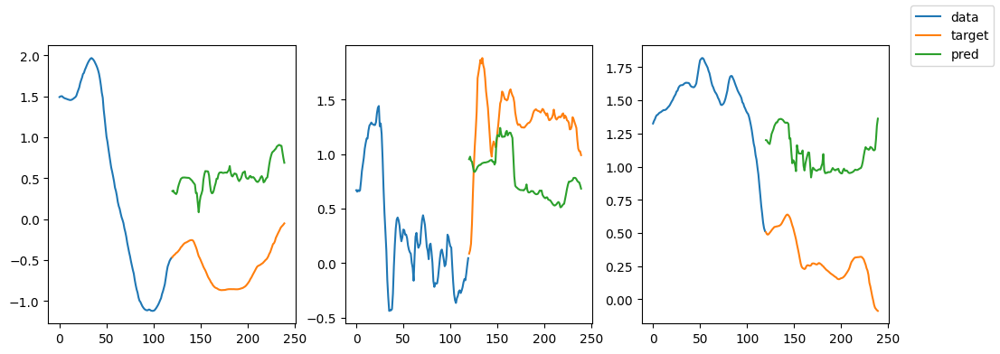

-----------------------------------------------------------------------------------------
| end of epoch  13 | time:  5.07s | valid loss 1.7513 | mean loss   0.6503
-----------------------------------------------------------------------------------------


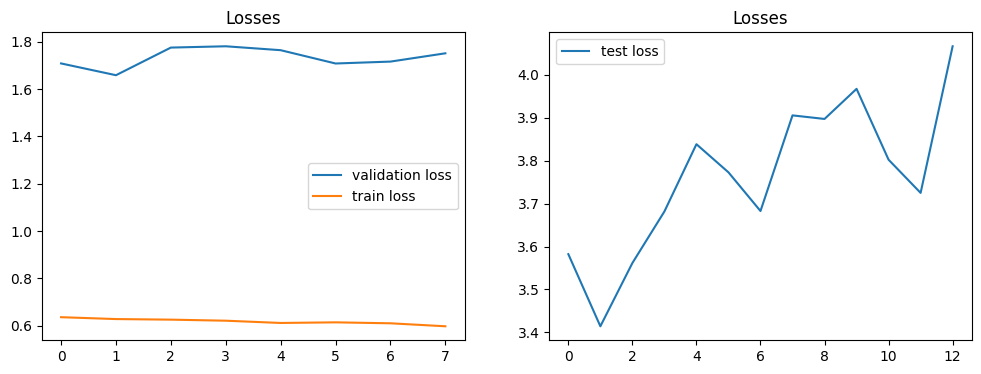

Epoch #14


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  14 |    74/  373 batches | lr 0.00257 | ms/batch 8.84590 | loss 0.55150
| epoch  14 |   148/  373 batches | lr 0.00257 | ms/batch 8.60090 | loss 0.60430
| epoch  14 |   222/  373 batches | lr 0.00257 | ms/batch 8.60541 | loss 0.58674
| epoch  14 |   296/  373 batches | lr 0.00257 | ms/batch 8.60564 | loss 0.67895
| epoch  14 |   370/  373 batches | lr 0.00257 | ms/batch 8.63956 | loss 0.56185
-----------------------------------------------------------------------------------------
| end of epoch  14 | time:  3.45s | valid loss 1.7183 | mean loss   0.6463
-----------------------------------------------------------------------------------------
Epoch #15


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  15 |    74/  373 batches | lr 0.00244 | ms/batch 8.74024 | loss 0.55052
training prediction


<Figure size 640x480 with 0 Axes>

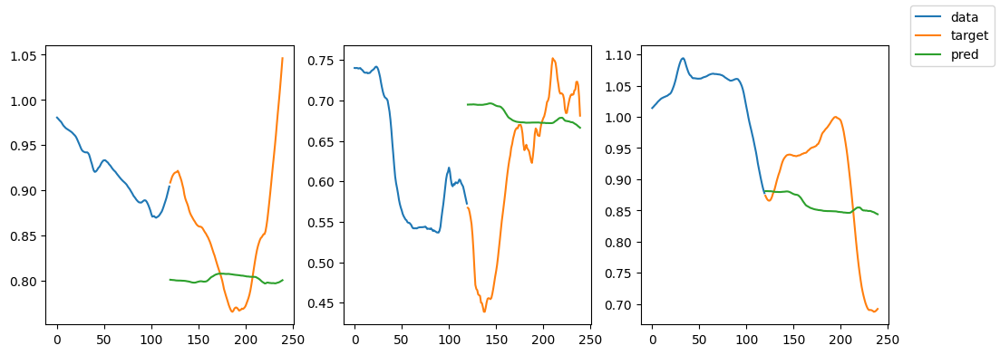

| epoch  15 |   148/  373 batches | lr 0.00244 | ms/batch 11.54353 | loss 0.57030
training prediction


<Figure size 640x480 with 0 Axes>

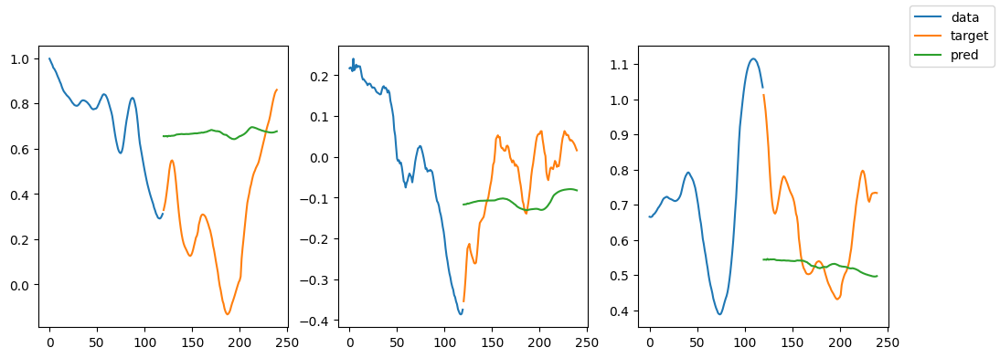

| epoch  15 |   222/  373 batches | lr 0.00244 | ms/batch 11.48938 | loss 0.56864
training prediction


<Figure size 640x480 with 0 Axes>

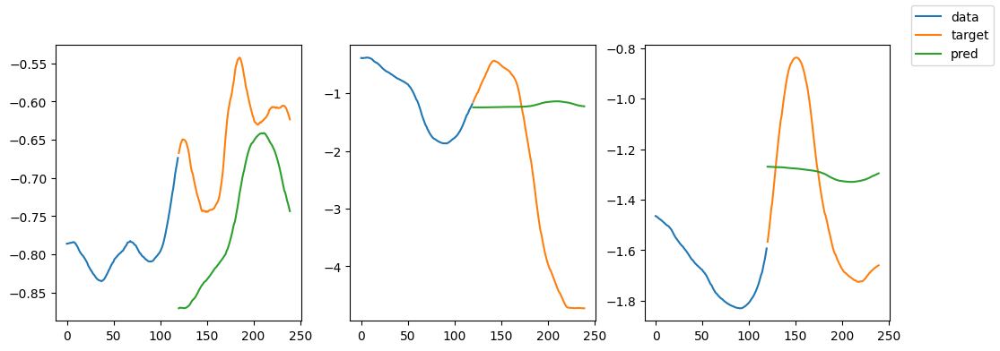

| epoch  15 |   296/  373 batches | lr 0.00244 | ms/batch 11.63859 | loss 0.59579
training prediction


<Figure size 640x480 with 0 Axes>

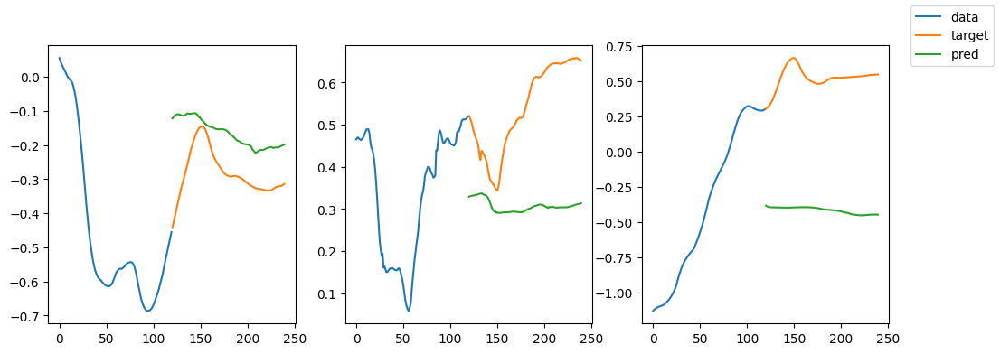

| epoch  15 |   370/  373 batches | lr 0.00244 | ms/batch 11.54160 | loss 0.70729
training prediction


<Figure size 640x480 with 0 Axes>

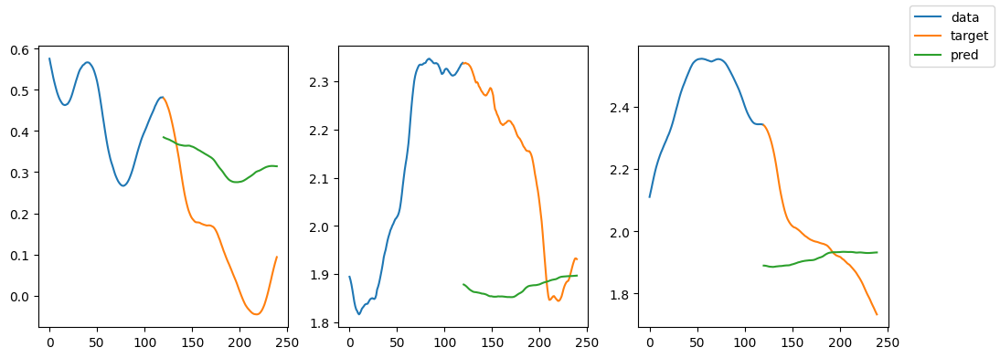

validation prediction


<Figure size 640x480 with 0 Axes>

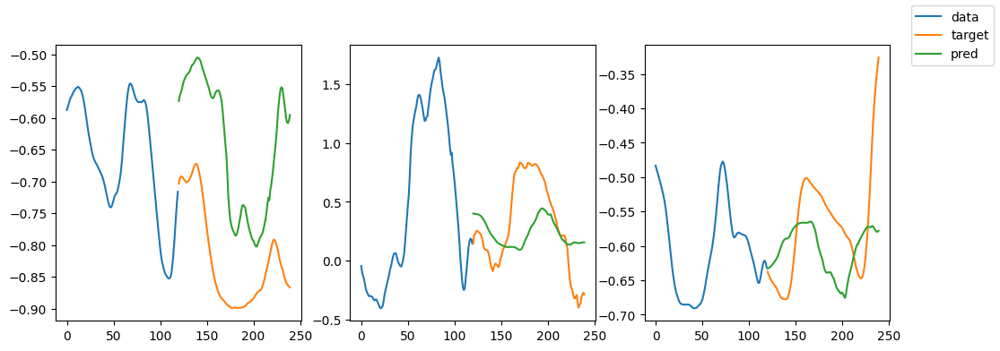

validation prediction


<Figure size 640x480 with 0 Axes>

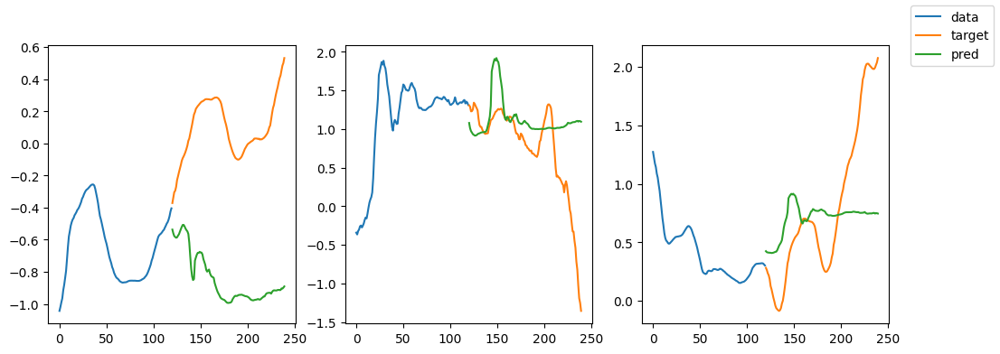

-----------------------------------------------------------------------------------------
| end of epoch  15 | time:  4.93s | valid loss 1.7981 | mean loss   0.6430
-----------------------------------------------------------------------------------------


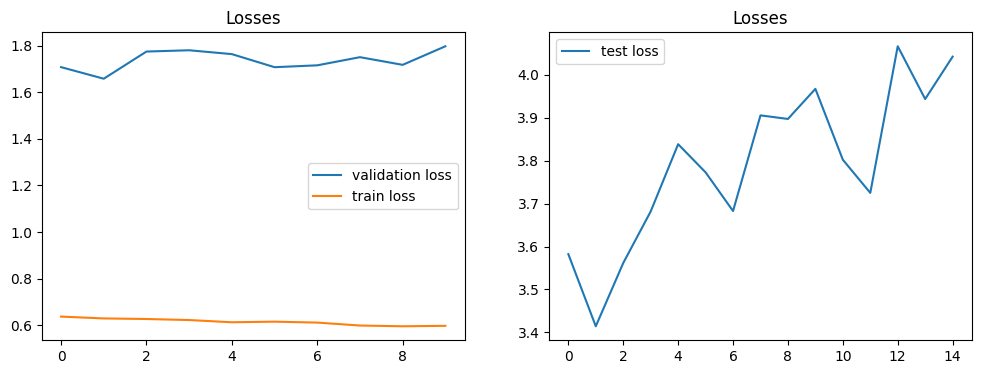

Epoch #16


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  16 |    74/  373 batches | lr 0.00232 | ms/batch 8.80524 | loss 0.60894
| epoch  16 |   148/  373 batches | lr 0.00232 | ms/batch 8.64420 | loss 0.60956
| epoch  16 |   222/  373 batches | lr 0.00232 | ms/batch 8.73202 | loss 0.60235
| epoch  16 |   296/  373 batches | lr 0.00232 | ms/batch 8.64806 | loss 0.56372
| epoch  16 |   370/  373 batches | lr 0.00232 | ms/batch 8.68177 | loss 0.58212
-----------------------------------------------------------------------------------------
| end of epoch  16 | time:  3.46s | valid loss 1.7696 | mean loss   0.6401
-----------------------------------------------------------------------------------------
Epoch #17


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  17 |    74/  373 batches | lr 0.00220 | ms/batch 8.78100 | loss 0.57809
training prediction


<Figure size 640x480 with 0 Axes>

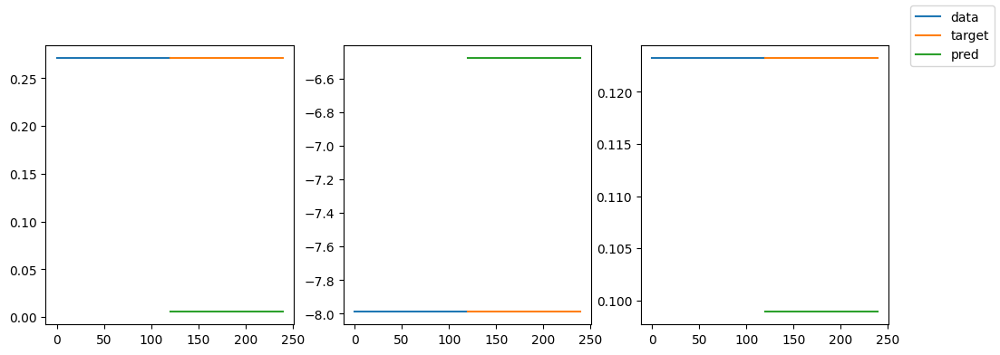

| epoch  17 |   148/  373 batches | lr 0.00220 | ms/batch 11.35366 | loss 0.62868
training prediction


<Figure size 640x480 with 0 Axes>

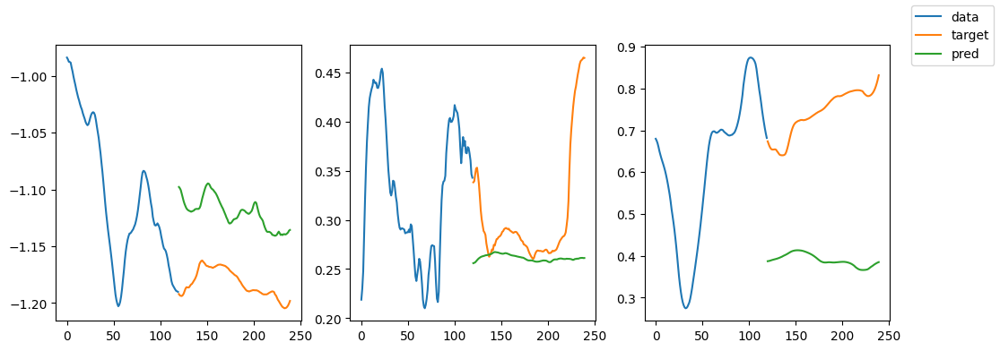

| epoch  17 |   222/  373 batches | lr 0.00220 | ms/batch 11.41790 | loss 0.66289
training prediction


<Figure size 640x480 with 0 Axes>

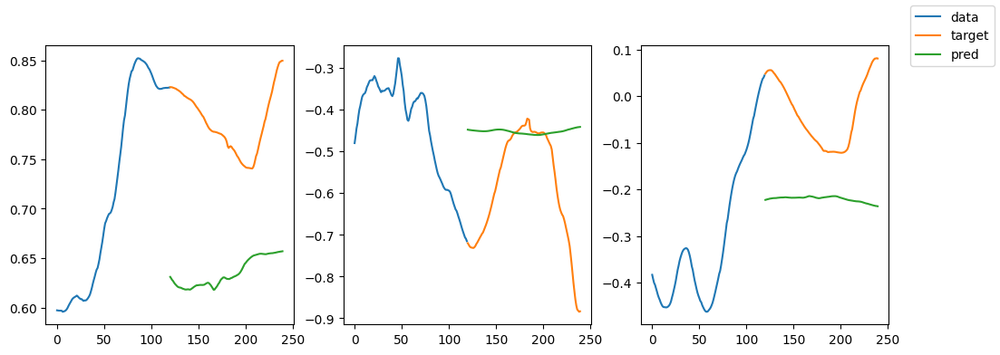

| epoch  17 |   296/  373 batches | lr 0.00220 | ms/batch 11.39570 | loss 0.53770
training prediction


<Figure size 640x480 with 0 Axes>

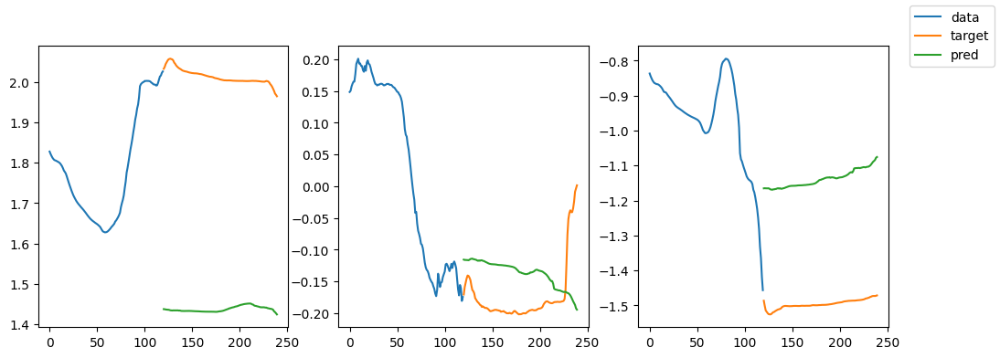

| epoch  17 |   370/  373 batches | lr 0.00220 | ms/batch 11.55968 | loss 0.54154
training prediction


<Figure size 640x480 with 0 Axes>

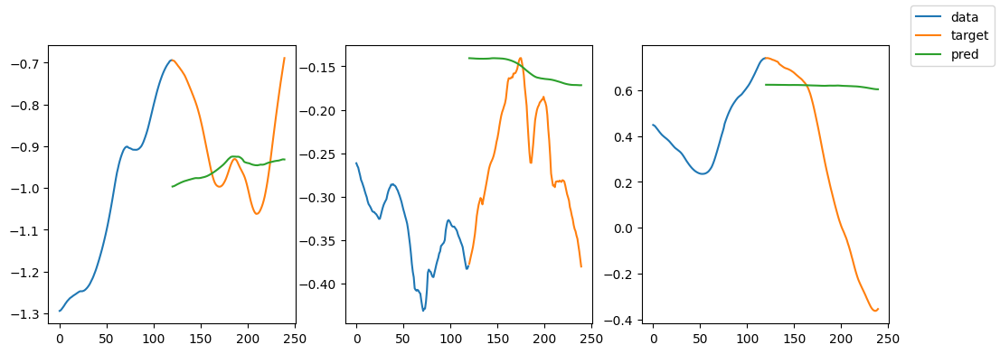

validation prediction


<Figure size 640x480 with 0 Axes>

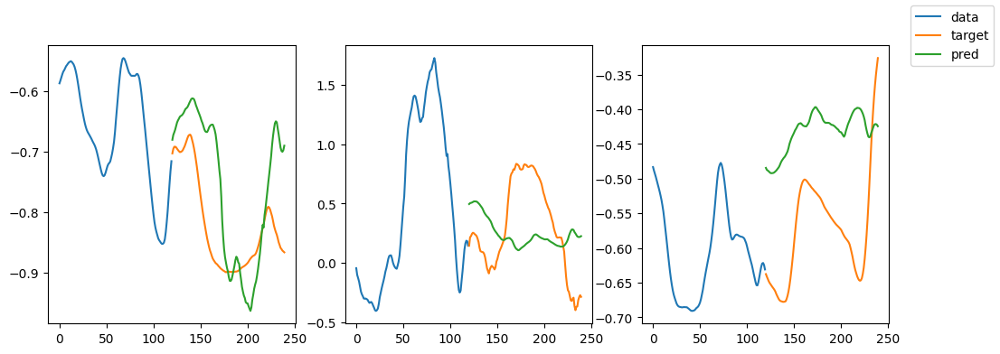

validation prediction


<Figure size 640x480 with 0 Axes>

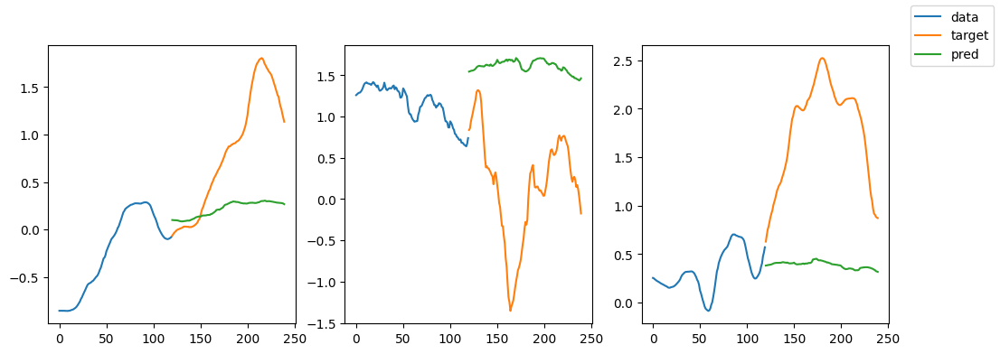

-----------------------------------------------------------------------------------------
| end of epoch  17 | time:  4.88s | valid loss 1.8032 | mean loss   0.6372
-----------------------------------------------------------------------------------------


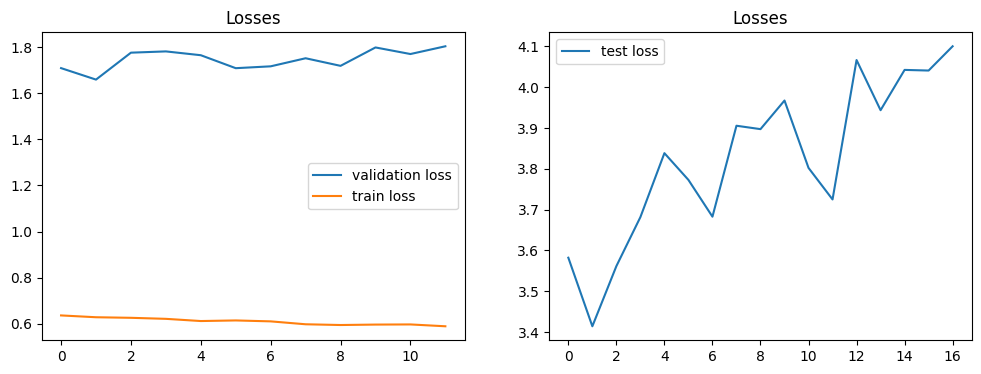

Epoch #18


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  18 |    74/  373 batches | lr 0.00209 | ms/batch 8.80639 | loss 0.56614
| epoch  18 |   148/  373 batches | lr 0.00209 | ms/batch 8.56513 | loss 0.57184
| epoch  18 |   222/  373 batches | lr 0.00209 | ms/batch 8.56143 | loss 0.63931
| epoch  18 |   296/  373 batches | lr 0.00209 | ms/batch 8.55105 | loss 0.61362
| epoch  18 |   370/  373 batches | lr 0.00209 | ms/batch 8.62364 | loss 0.57454
-----------------------------------------------------------------------------------------
| end of epoch  18 | time:  3.43s | valid loss 1.7960 | mean loss   0.6346
-----------------------------------------------------------------------------------------
Epoch #19


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  19 |    74/  373 batches | lr 0.00199 | ms/batch 8.71111 | loss 0.53867
training prediction


<Figure size 640x480 with 0 Axes>

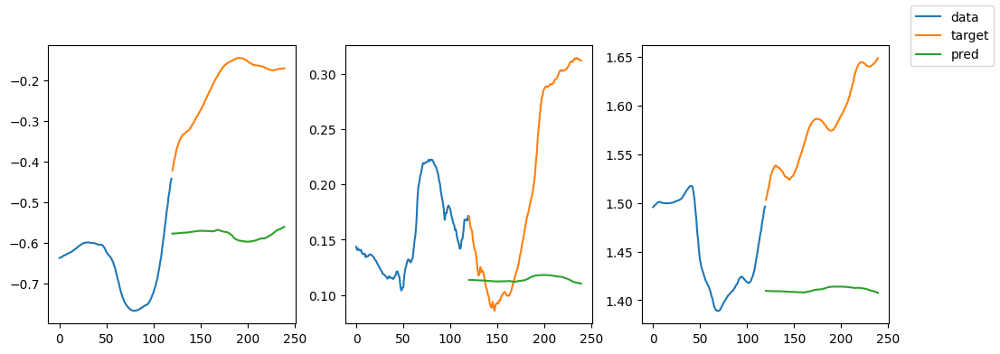

| epoch  19 |   148/  373 batches | lr 0.00199 | ms/batch 11.30905 | loss 0.63569
training prediction


<Figure size 640x480 with 0 Axes>

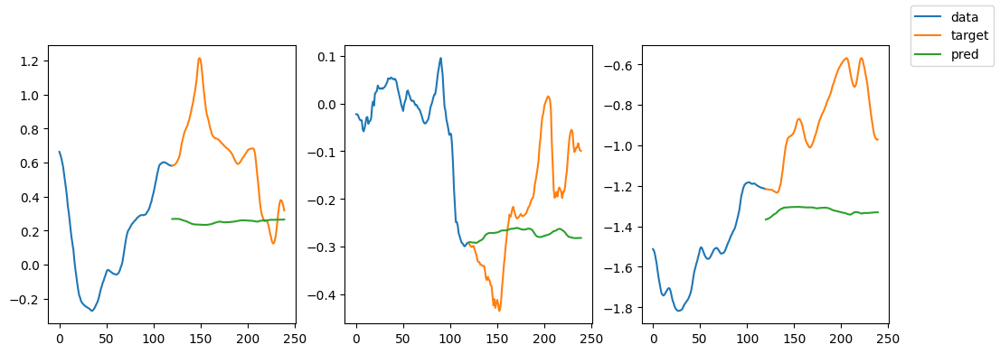

| epoch  19 |   222/  373 batches | lr 0.00199 | ms/batch 11.40382 | loss 0.58603
training prediction


<Figure size 640x480 with 0 Axes>

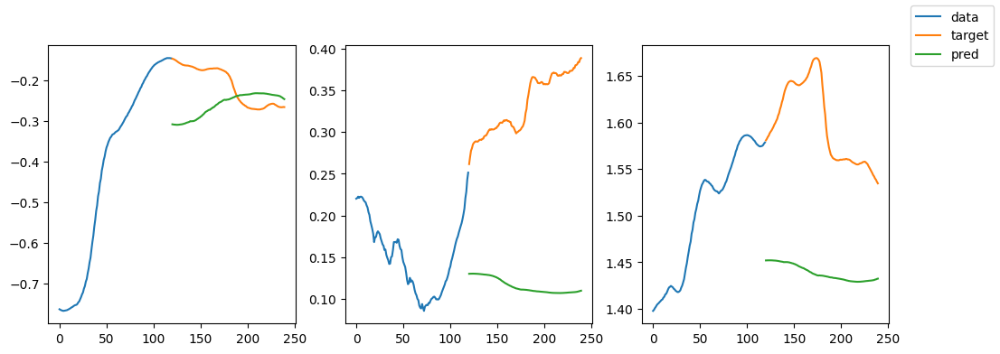

| epoch  19 |   296/  373 batches | lr 0.00199 | ms/batch 14.04034 | loss 0.56721
training prediction


<Figure size 640x480 with 0 Axes>

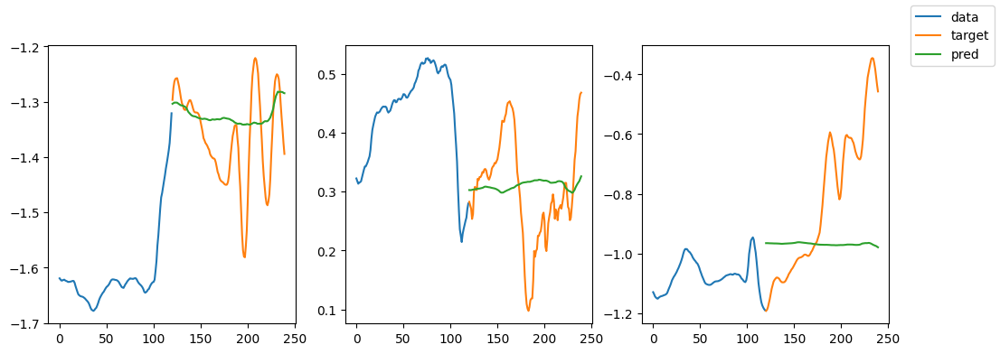

| epoch  19 |   370/  373 batches | lr 0.00199 | ms/batch 11.69825 | loss 0.59447
training prediction


<Figure size 640x480 with 0 Axes>

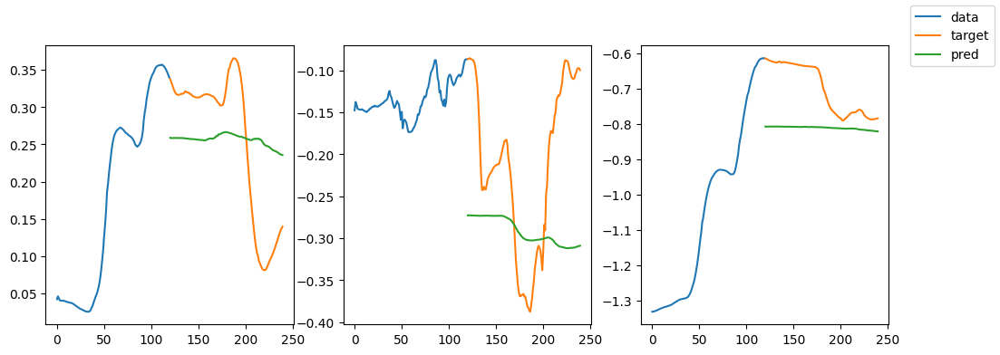

validation prediction


<Figure size 640x480 with 0 Axes>

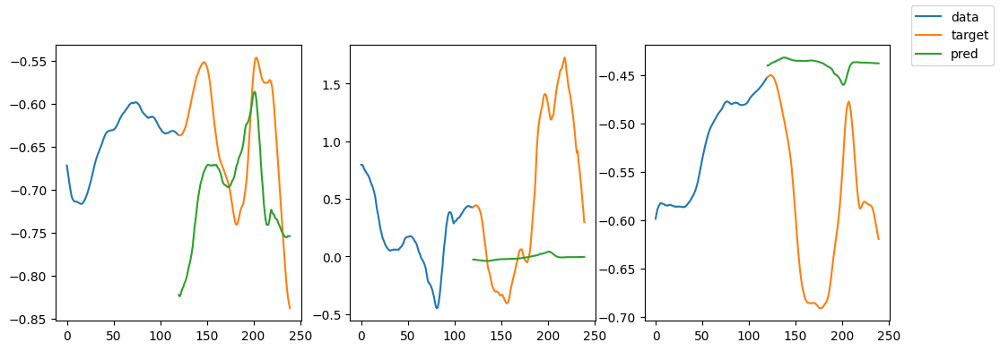

validation prediction


<Figure size 640x480 with 0 Axes>

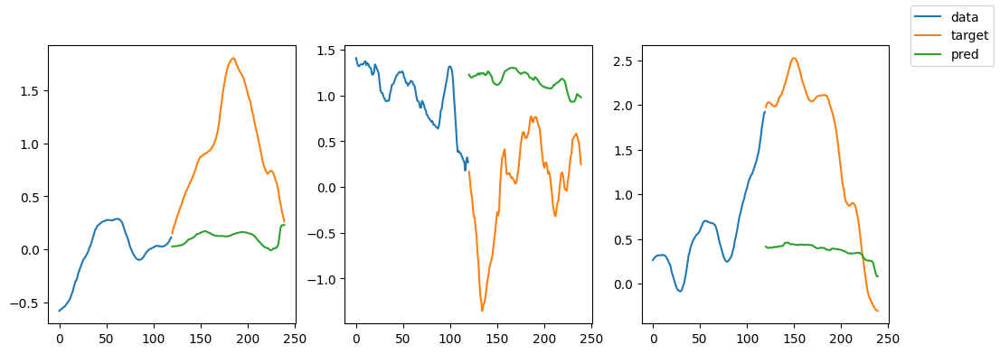

-----------------------------------------------------------------------------------------
| end of epoch  19 | time:  5.09s | valid loss 1.8198 | mean loss   0.6318
-----------------------------------------------------------------------------------------


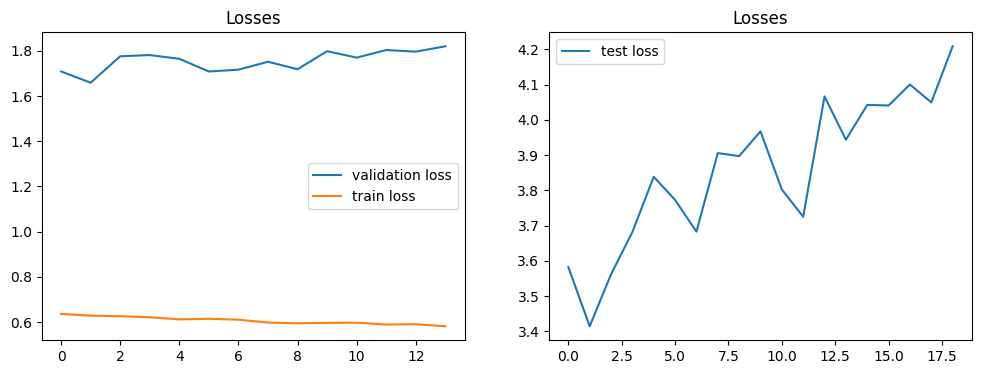

Epoch #20


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  20 |    74/  373 batches | lr 0.00189 | ms/batch 8.76212 | loss 0.64944
| epoch  20 |   148/  373 batches | lr 0.00189 | ms/batch 8.63528 | loss 0.49899
| epoch  20 |   222/  373 batches | lr 0.00189 | ms/batch 8.59257 | loss 0.60090
| epoch  20 |   296/  373 batches | lr 0.00189 | ms/batch 8.65681 | loss 0.59528
| epoch  20 |   370/  373 batches | lr 0.00189 | ms/batch 8.65973 | loss 0.54706
-----------------------------------------------------------------------------------------
| end of epoch  20 | time:  3.45s | valid loss 1.8307 | mean loss   0.6291
-----------------------------------------------------------------------------------------
Epoch #21


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  21 |    74/  373 batches | lr 0.00179 | ms/batch 8.74967 | loss 0.65360
training prediction


<Figure size 640x480 with 0 Axes>

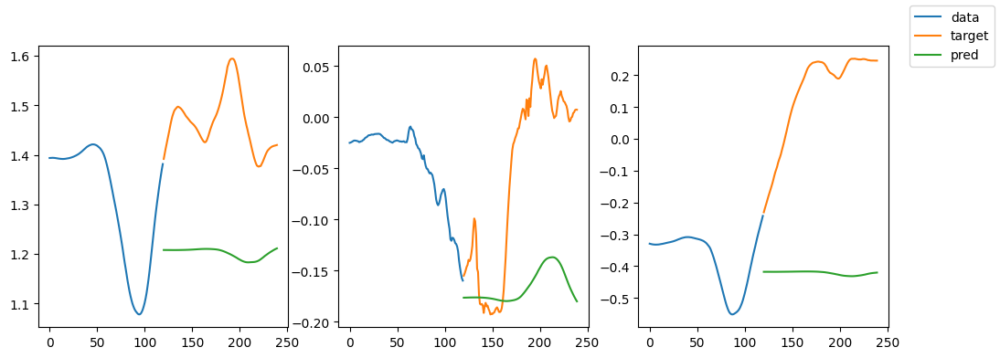

| epoch  21 |   148/  373 batches | lr 0.00179 | ms/batch 11.52317 | loss 0.56701
training prediction


<Figure size 640x480 with 0 Axes>

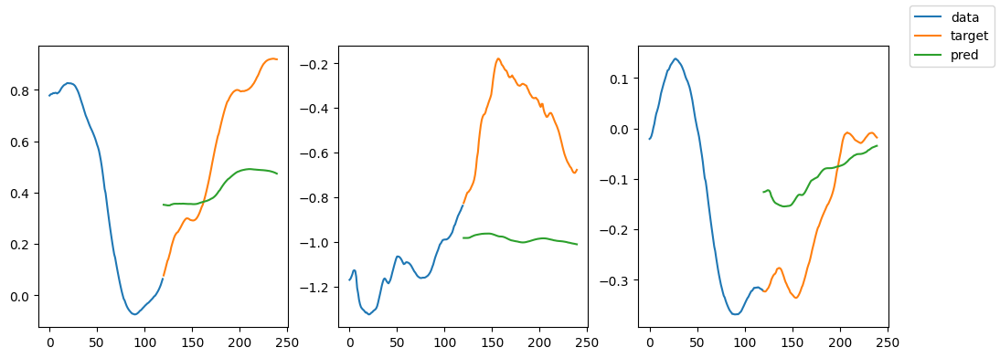

| epoch  21 |   222/  373 batches | lr 0.00179 | ms/batch 11.32264 | loss 0.59510
training prediction


<Figure size 640x480 with 0 Axes>

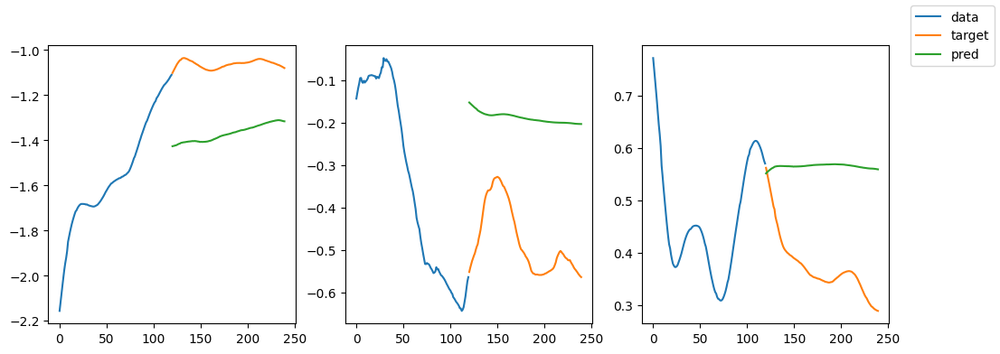

| epoch  21 |   296/  373 batches | lr 0.00179 | ms/batch 11.42308 | loss 0.52684
training prediction


<Figure size 640x480 with 0 Axes>

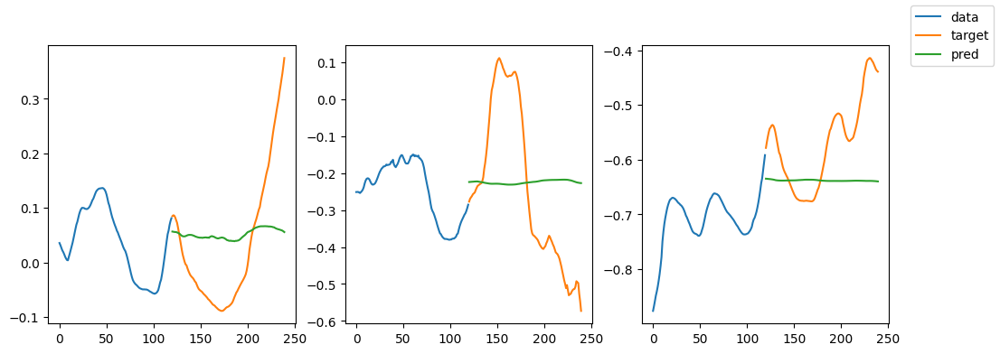

| epoch  21 |   370/  373 batches | lr 0.00179 | ms/batch 11.38631 | loss 0.56708
training prediction


<Figure size 640x480 with 0 Axes>

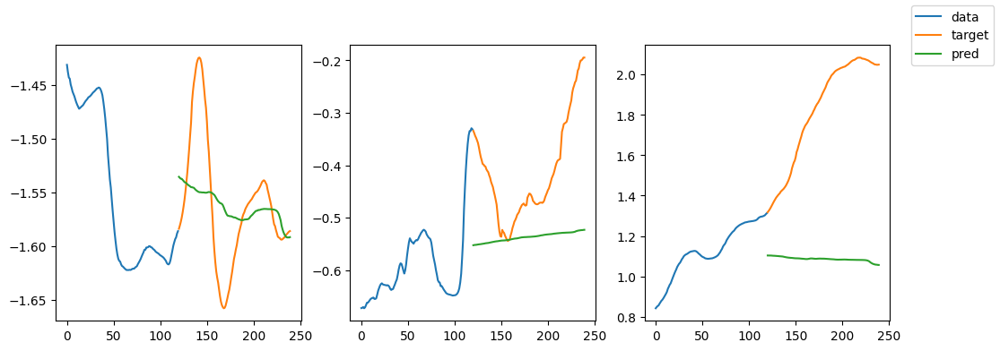

validation prediction


<Figure size 640x480 with 0 Axes>

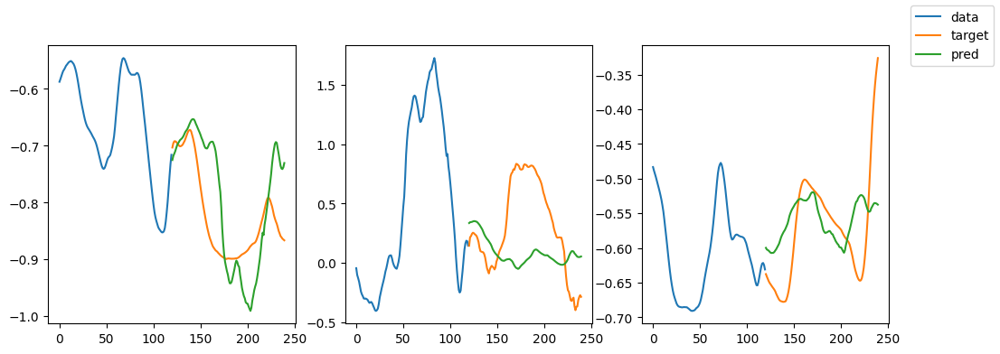

validation prediction


<Figure size 640x480 with 0 Axes>

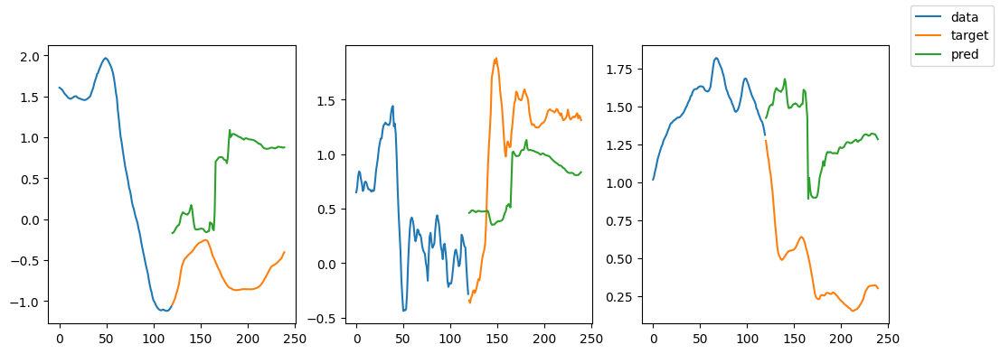

-----------------------------------------------------------------------------------------
| end of epoch  21 | time:  5.09s | valid loss 1.8070 | mean loss   0.6267
-----------------------------------------------------------------------------------------


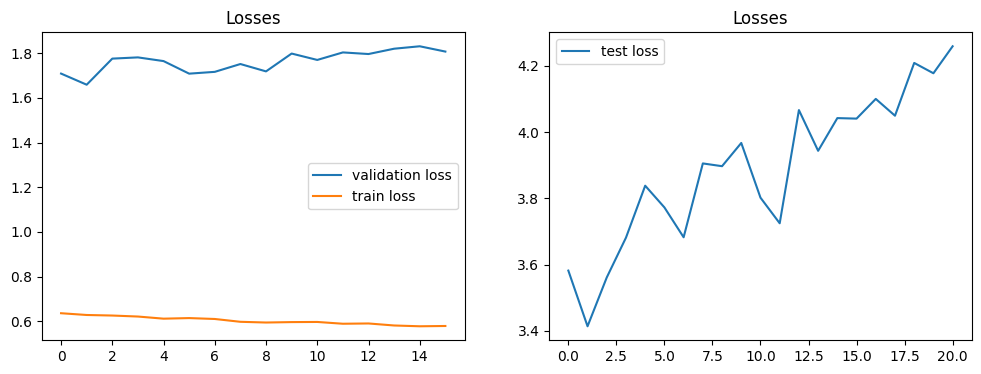

Epoch #22


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  22 |    74/  373 batches | lr 0.00170 | ms/batch 8.80021 | loss 0.59108
| epoch  22 |   148/  373 batches | lr 0.00170 | ms/batch 8.65141 | loss 0.52204
| epoch  22 |   222/  373 batches | lr 0.00170 | ms/batch 8.84002 | loss 0.67097
| epoch  22 |   296/  373 batches | lr 0.00170 | ms/batch 7.79222 | loss 0.56643
| epoch  22 |   370/  373 batches | lr 0.00170 | ms/batch 7.52538 | loss 0.53222
-----------------------------------------------------------------------------------------
| end of epoch  22 | time:  3.31s | valid loss 1.8380 | mean loss   0.6243
-----------------------------------------------------------------------------------------
Epoch #23


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  23 |    74/  373 batches | lr 0.00162 | ms/batch 7.62265 | loss 0.65558
training prediction


<Figure size 640x480 with 0 Axes>

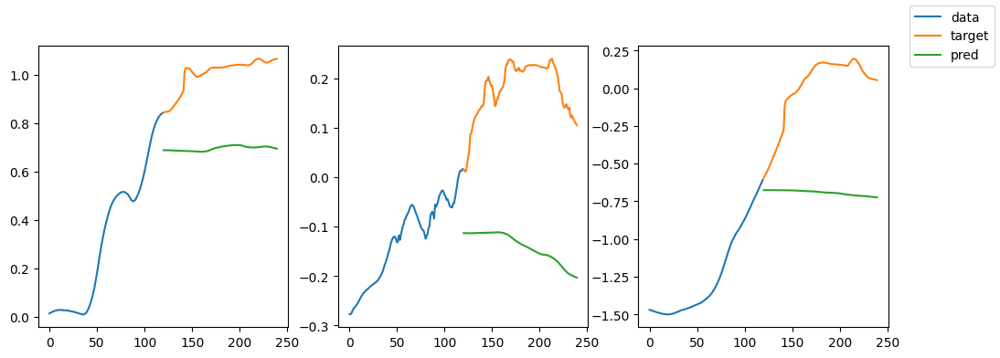

| epoch  23 |   148/  373 batches | lr 0.00162 | ms/batch 10.32250 | loss 0.53907
training prediction


<Figure size 640x480 with 0 Axes>

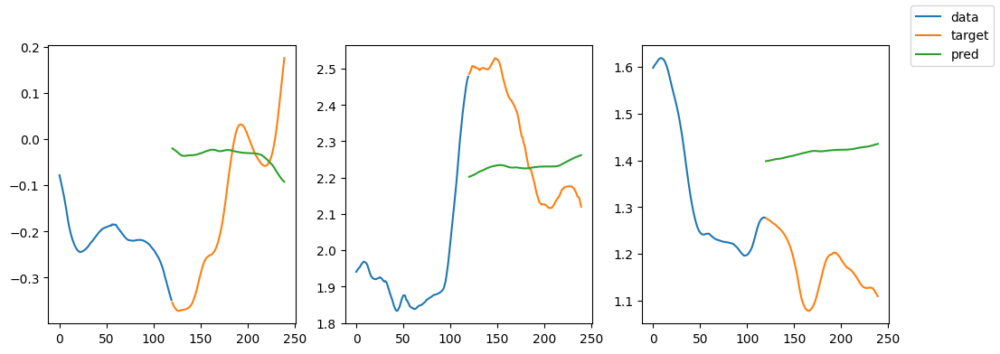

| epoch  23 |   222/  373 batches | lr 0.00162 | ms/batch 10.32105 | loss 0.54132
training prediction


<Figure size 640x480 with 0 Axes>

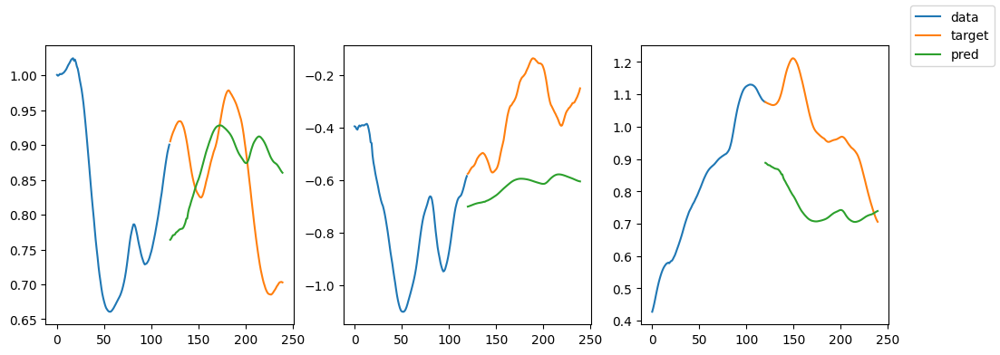

| epoch  23 |   296/  373 batches | lr 0.00162 | ms/batch 10.38336 | loss 0.56834
training prediction


<Figure size 640x480 with 0 Axes>

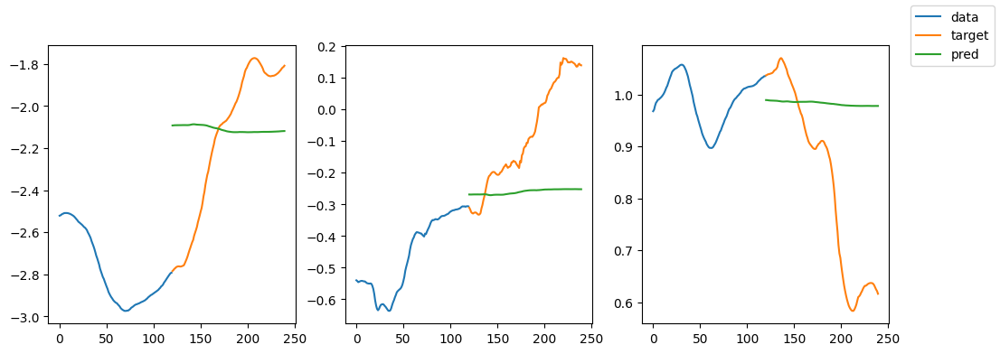

| epoch  23 |   370/  373 batches | lr 0.00162 | ms/batch 10.28802 | loss 0.58454
training prediction


<Figure size 640x480 with 0 Axes>

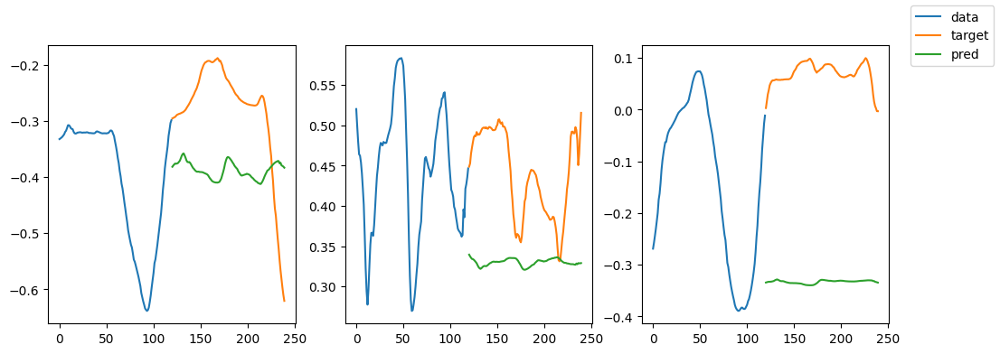

validation prediction


<Figure size 640x480 with 0 Axes>

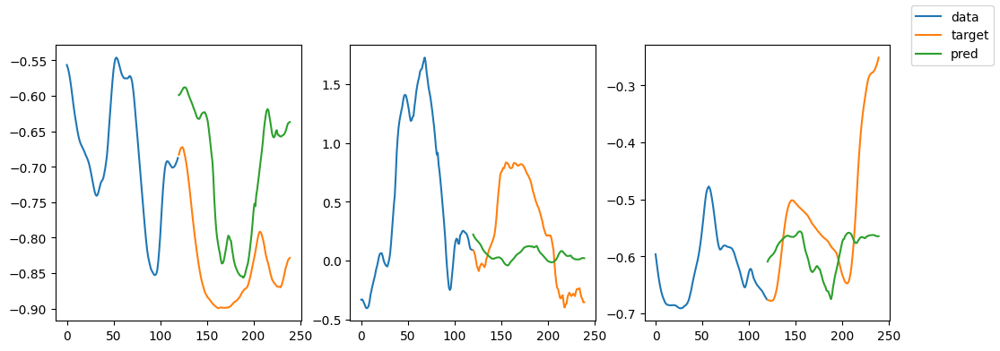

validation prediction


<Figure size 640x480 with 0 Axes>

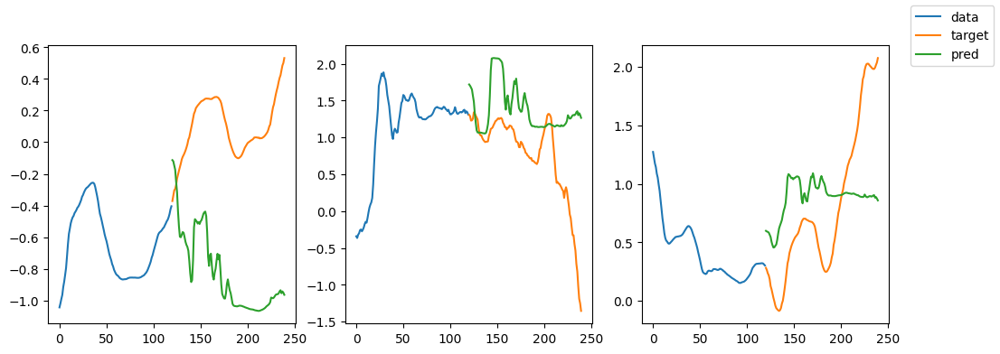

-----------------------------------------------------------------------------------------
| end of epoch  23 | time:  4.45s | valid loss 1.7455 | mean loss   0.6221
-----------------------------------------------------------------------------------------


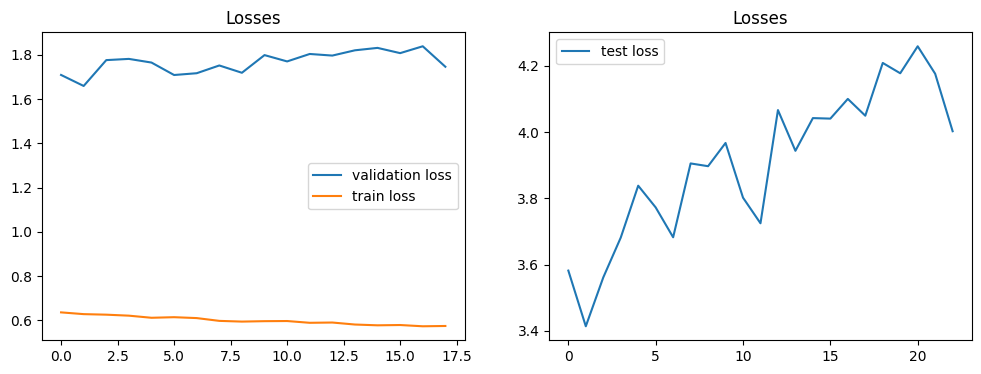

Epoch #24


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  24 |    74/  373 batches | lr 0.00154 | ms/batch 7.57202 | loss 0.57608
| epoch  24 |   148/  373 batches | lr 0.00154 | ms/batch 7.43464 | loss 0.59935
| epoch  24 |   222/  373 batches | lr 0.00154 | ms/batch 7.45771 | loss 0.56839
| epoch  24 |   296/  373 batches | lr 0.00154 | ms/batch 7.43921 | loss 0.61047
| epoch  24 |   370/  373 batches | lr 0.00154 | ms/batch 7.43540 | loss 0.51806
-----------------------------------------------------------------------------------------
| end of epoch  24 | time:  2.98s | valid loss 1.7995 | mean loss   0.6200
-----------------------------------------------------------------------------------------
Epoch #25


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  25 |    74/  373 batches | lr 0.00146 | ms/batch 7.57236 | loss 0.50467
training prediction


<Figure size 640x480 with 0 Axes>

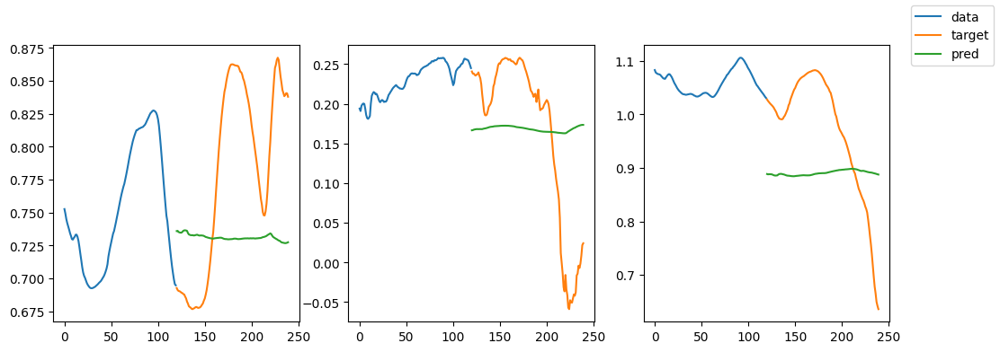

| epoch  25 |   148/  373 batches | lr 0.00146 | ms/batch 10.28575 | loss 0.61705
training prediction


<Figure size 640x480 with 0 Axes>

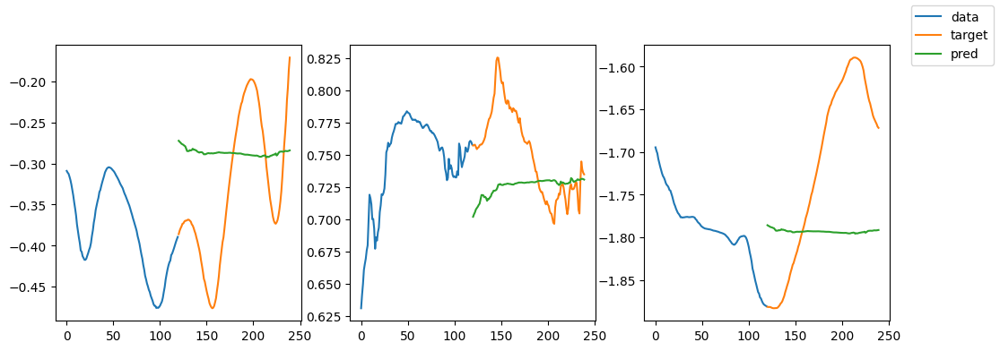

| epoch  25 |   222/  373 batches | lr 0.00146 | ms/batch 13.26823 | loss 0.60000
training prediction


<Figure size 640x480 with 0 Axes>

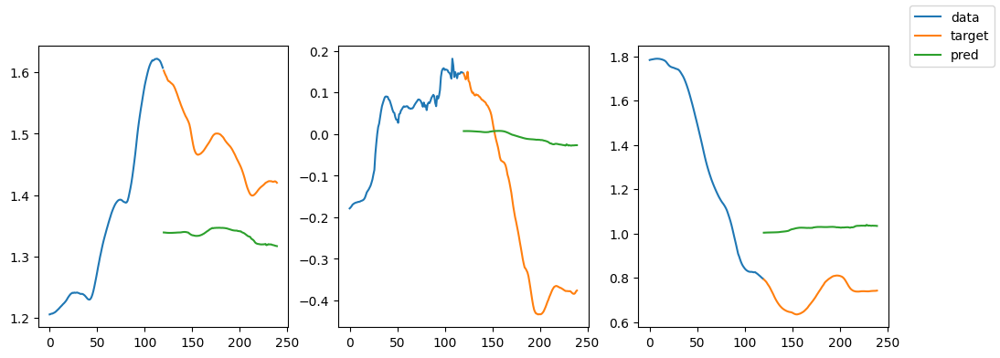

| epoch  25 |   296/  373 batches | lr 0.00146 | ms/batch 10.23922 | loss 0.59154
training prediction


<Figure size 640x480 with 0 Axes>

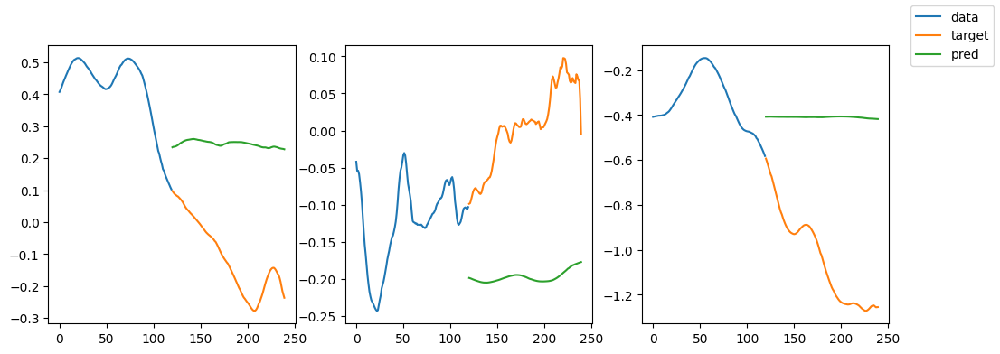

| epoch  25 |   370/  373 batches | lr 0.00146 | ms/batch 10.34512 | loss 0.56001
training prediction


<Figure size 640x480 with 0 Axes>

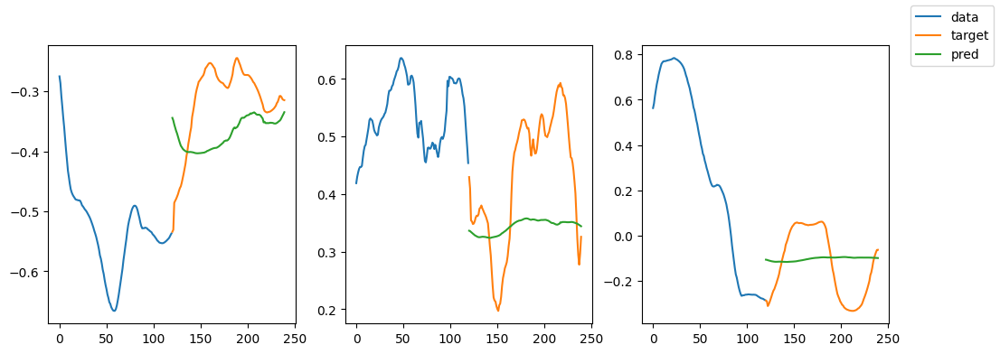

validation prediction


<Figure size 640x480 with 0 Axes>

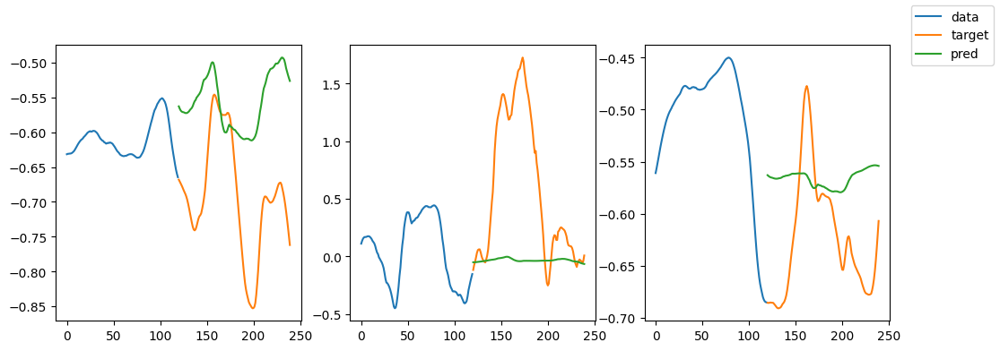

validation prediction


<Figure size 640x480 with 0 Axes>

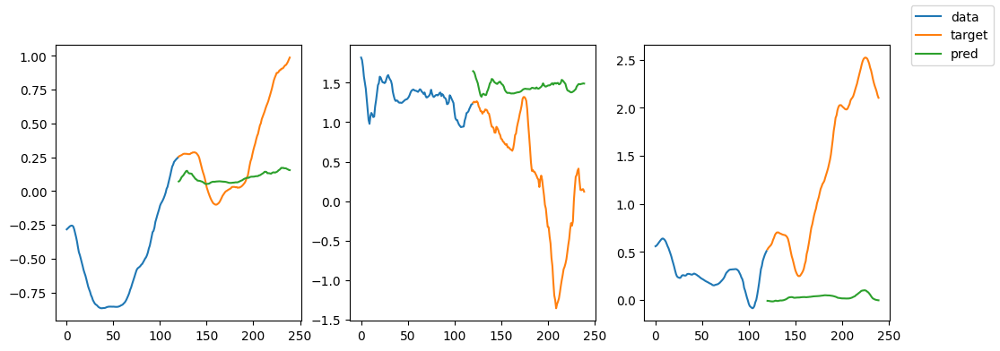

-----------------------------------------------------------------------------------------
| end of epoch  25 | time:  4.65s | valid loss 1.7655 | mean loss   0.6181
-----------------------------------------------------------------------------------------


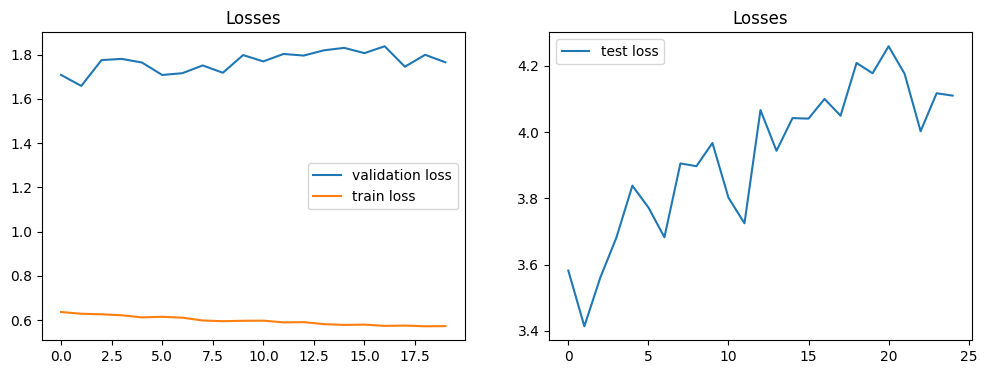

Epoch #26


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  26 |    74/  373 batches | lr 0.00139 | ms/batch 7.60968 | loss 0.59509
| epoch  26 |   148/  373 batches | lr 0.00139 | ms/batch 7.47126 | loss 0.57684
| epoch  26 |   222/  373 batches | lr 0.00139 | ms/batch 7.45979 | loss 0.52033
| epoch  26 |   296/  373 batches | lr 0.00139 | ms/batch 7.45816 | loss 0.58311
| epoch  26 |   370/  373 batches | lr 0.00139 | ms/batch 7.46743 | loss 0.58829
-----------------------------------------------------------------------------------------
| end of epoch  26 | time:  2.99s | valid loss 1.7942 | mean loss   0.6163
-----------------------------------------------------------------------------------------
Epoch #27


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  27 |    74/  373 batches | lr 0.00132 | ms/batch 7.54891 | loss 0.60392
training prediction


<Figure size 640x480 with 0 Axes>

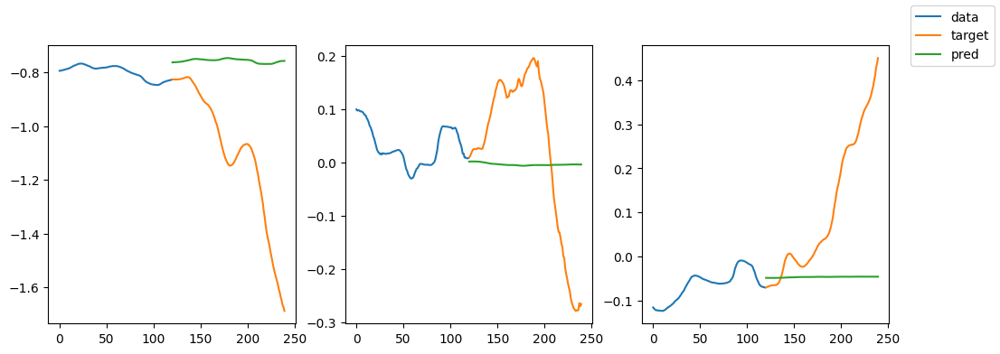

| epoch  27 |   148/  373 batches | lr 0.00132 | ms/batch 10.24915 | loss 0.54177
training prediction


<Figure size 640x480 with 0 Axes>

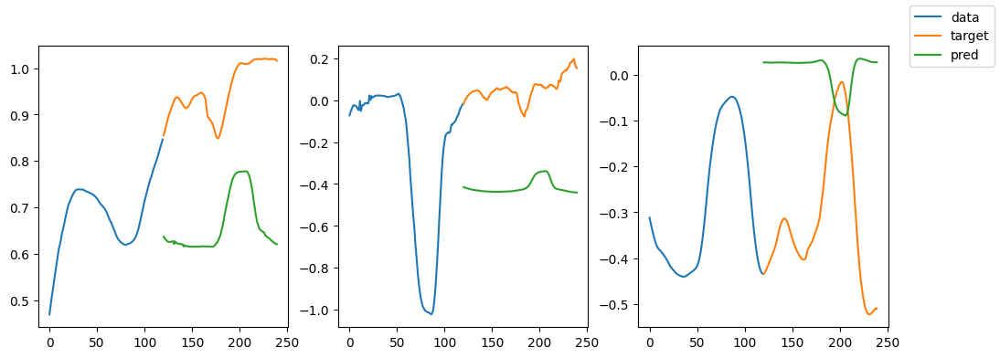

| epoch  27 |   222/  373 batches | lr 0.00132 | ms/batch 10.19836 | loss 0.51665
training prediction


<Figure size 640x480 with 0 Axes>

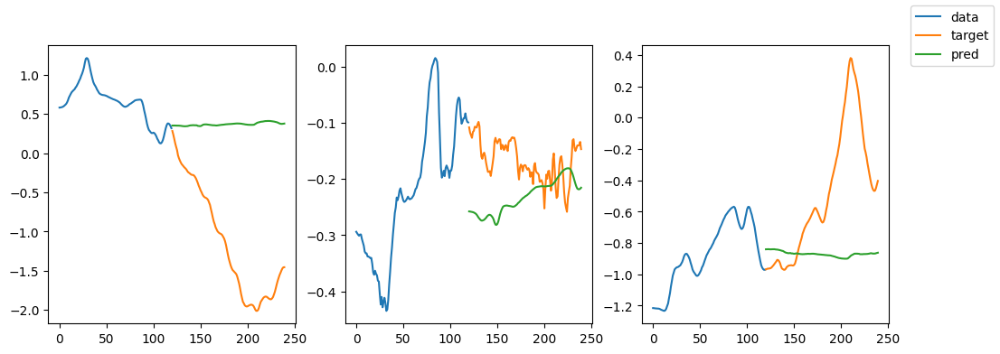

| epoch  27 |   296/  373 batches | lr 0.00132 | ms/batch 10.32103 | loss 0.57852
training prediction


<Figure size 640x480 with 0 Axes>

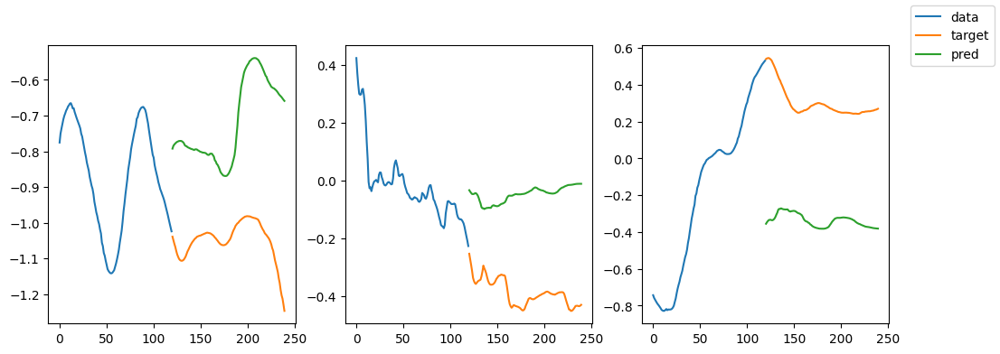

| epoch  27 |   370/  373 batches | lr 0.00132 | ms/batch 12.92813 | loss 0.60032
training prediction


<Figure size 640x480 with 0 Axes>

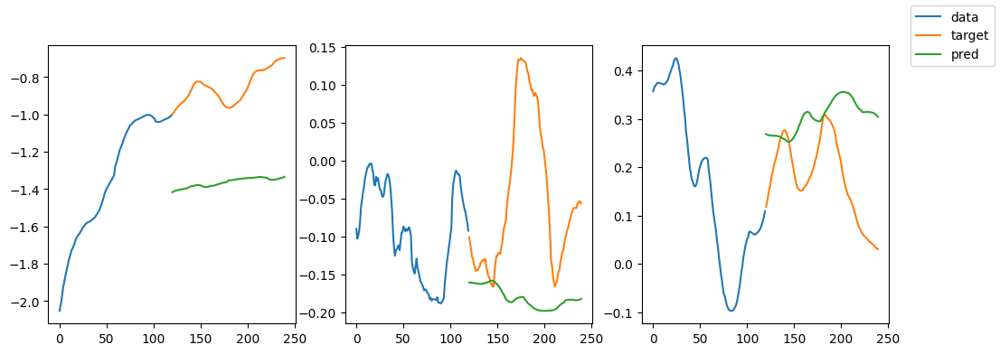

validation prediction


<Figure size 640x480 with 0 Axes>

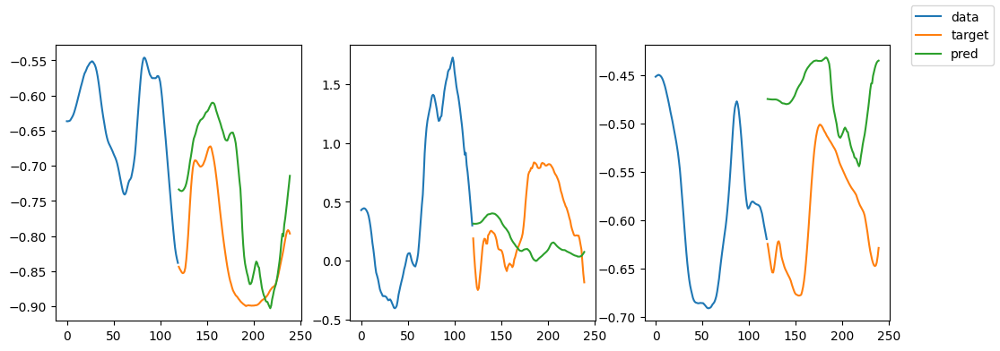

validation prediction


<Figure size 640x480 with 0 Axes>

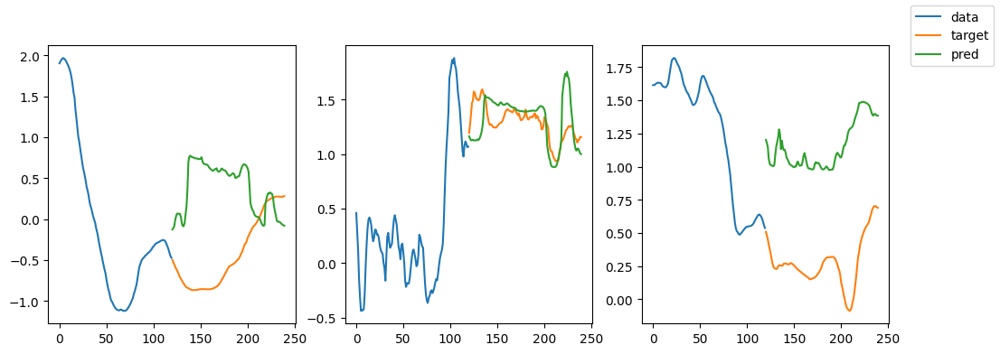

-----------------------------------------------------------------------------------------
| end of epoch  27 | time:  4.63s | valid loss 1.7955 | mean loss   0.6144
-----------------------------------------------------------------------------------------


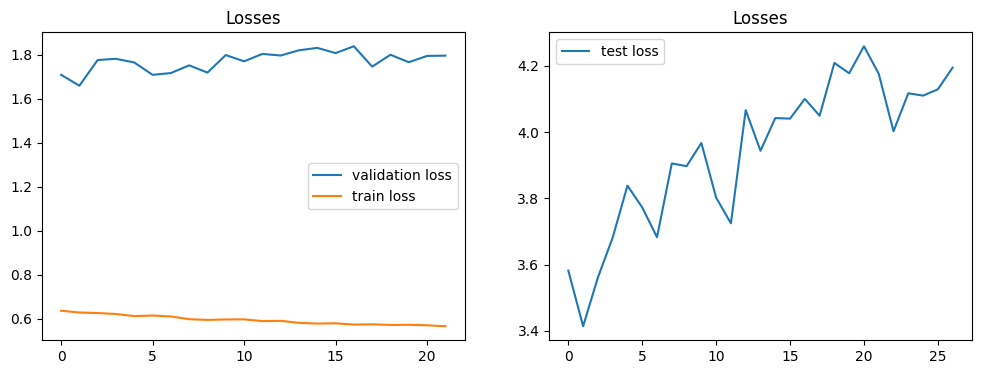

Epoch #28


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  28 |    74/  373 batches | lr 0.00125 | ms/batch 7.58722 | loss 0.60391
| epoch  28 |   148/  373 batches | lr 0.00125 | ms/batch 7.48544 | loss 0.57611
| epoch  28 |   222/  373 batches | lr 0.00125 | ms/batch 7.45539 | loss 0.54819
| epoch  28 |   296/  373 batches | lr 0.00125 | ms/batch 7.47791 | loss 0.54921
| epoch  28 |   370/  373 batches | lr 0.00125 | ms/batch 7.46795 | loss 0.56349
-----------------------------------------------------------------------------------------
| end of epoch  28 | time:  2.99s | valid loss 1.8142 | mean loss   0.6127
-----------------------------------------------------------------------------------------
Epoch #29


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  29 |    74/  373 batches | lr 0.00119 | ms/batch 7.56661 | loss 0.52197
training prediction


<Figure size 640x480 with 0 Axes>

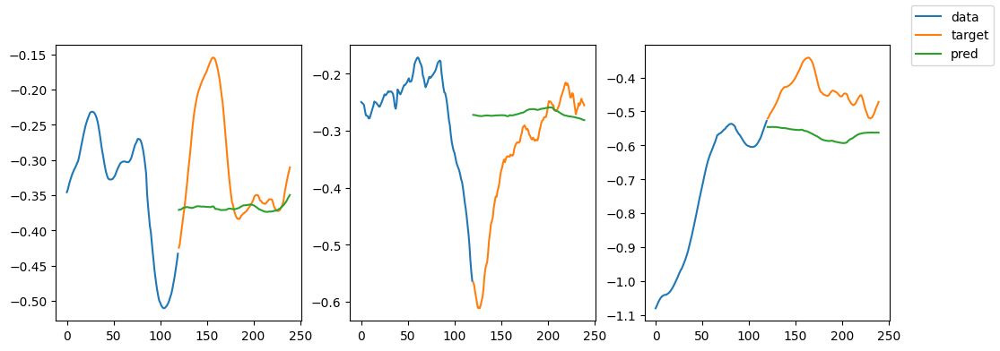

| epoch  29 |   148/  373 batches | lr 0.00119 | ms/batch 10.27701 | loss 0.56756
training prediction


<Figure size 640x480 with 0 Axes>

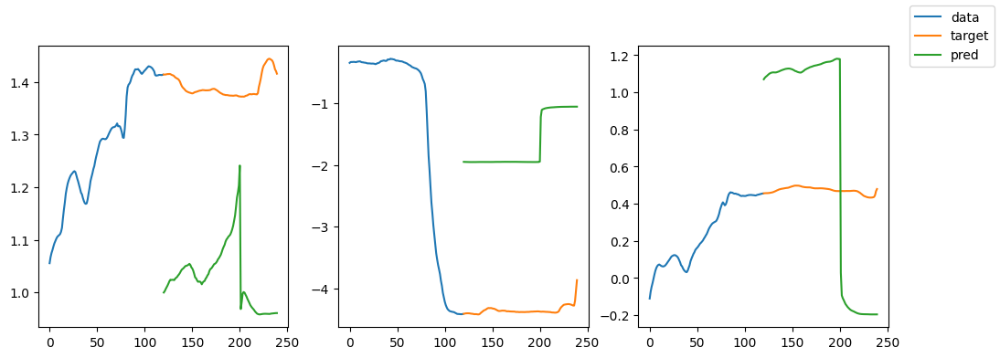

| epoch  29 |   222/  373 batches | lr 0.00119 | ms/batch 10.11777 | loss 0.61759
training prediction


<Figure size 640x480 with 0 Axes>

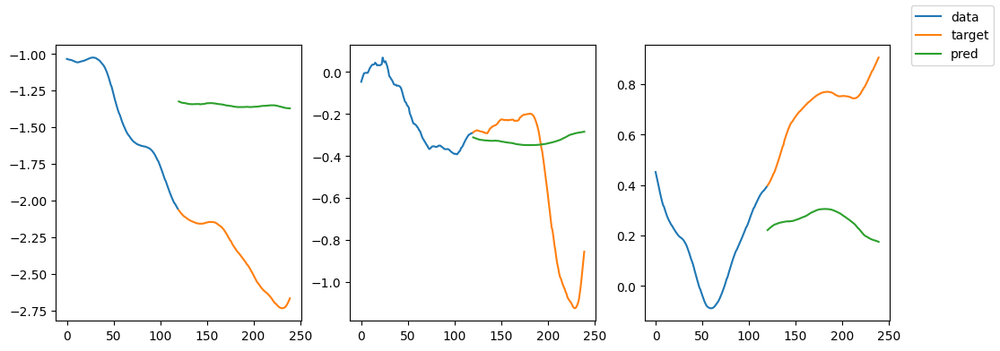

| epoch  29 |   296/  373 batches | lr 0.00119 | ms/batch 10.21324 | loss 0.47888
training prediction


<Figure size 640x480 with 0 Axes>

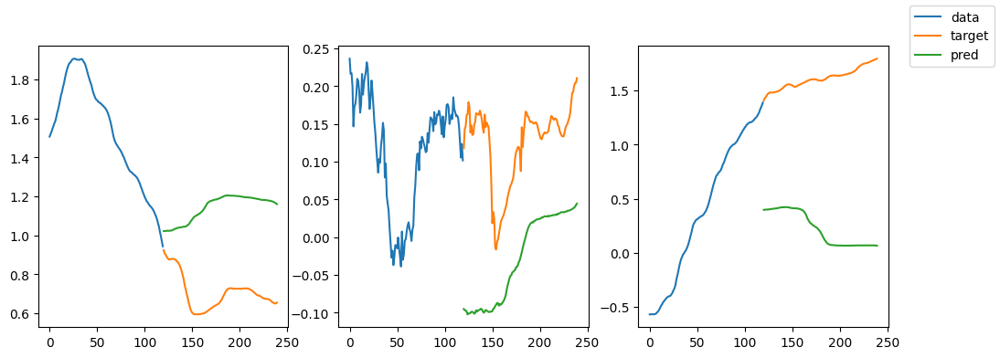

| epoch  29 |   370/  373 batches | lr 0.00119 | ms/batch 10.25922 | loss 0.64476
training prediction


<Figure size 640x480 with 0 Axes>

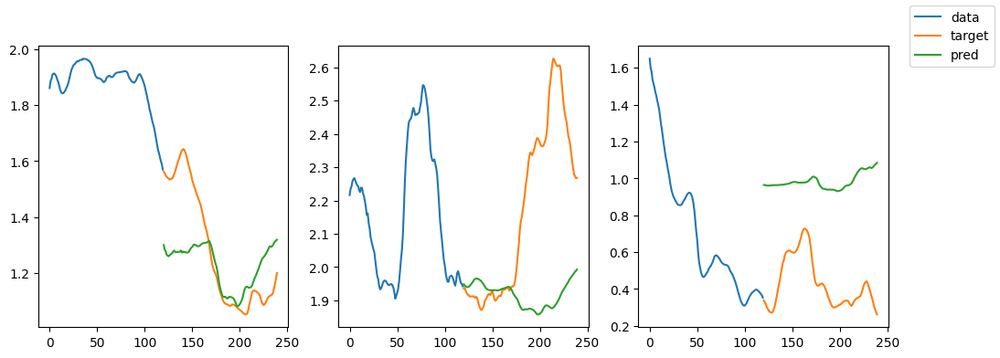

validation prediction


<Figure size 640x480 with 0 Axes>

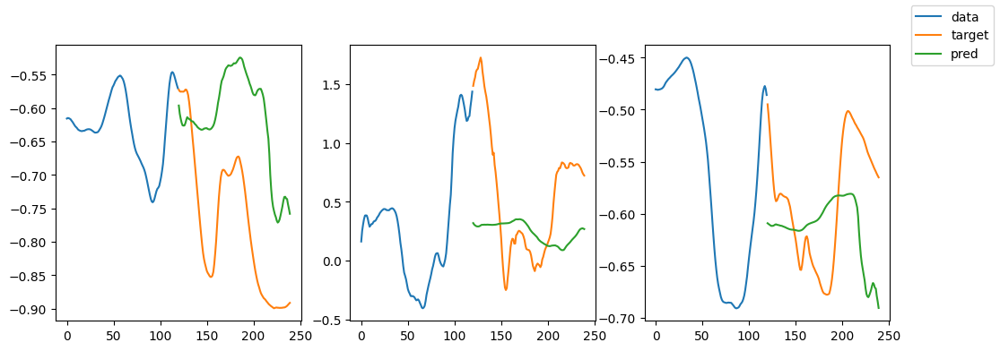

validation prediction


<Figure size 640x480 with 0 Axes>

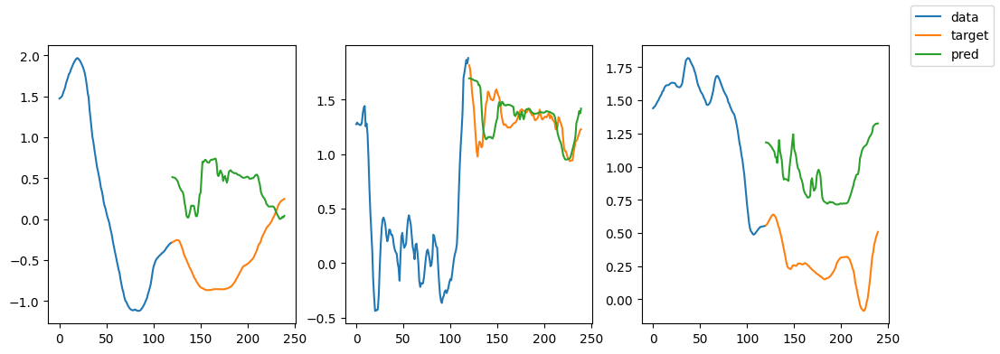

-----------------------------------------------------------------------------------------
| end of epoch  29 | time:  4.42s | valid loss 1.8271 | mean loss   0.6111
-----------------------------------------------------------------------------------------


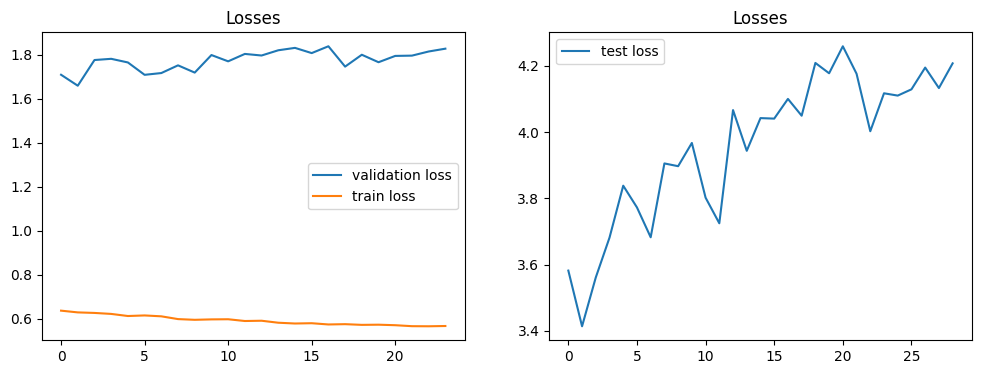

Epoch #30


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  30 |    74/  373 batches | lr 0.00113 | ms/batch 7.78170 | loss 0.58903
| epoch  30 |   148/  373 batches | lr 0.00113 | ms/batch 7.63470 | loss 0.61845
| epoch  30 |   222/  373 batches | lr 0.00113 | ms/batch 7.51231 | loss 0.57583
| epoch  30 |   296/  373 batches | lr 0.00113 | ms/batch 7.50401 | loss 0.50029
| epoch  30 |   370/  373 batches | lr 0.00113 | ms/batch 7.50719 | loss 0.53534
-----------------------------------------------------------------------------------------
| end of epoch  30 | time:  3.03s | valid loss 1.7991 | mean loss   0.6095
-----------------------------------------------------------------------------------------
Epoch #31


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  31 |    74/  373 batches | lr 0.00107 | ms/batch 10.75494 | loss 0.56501
training prediction


<Figure size 640x480 with 0 Axes>

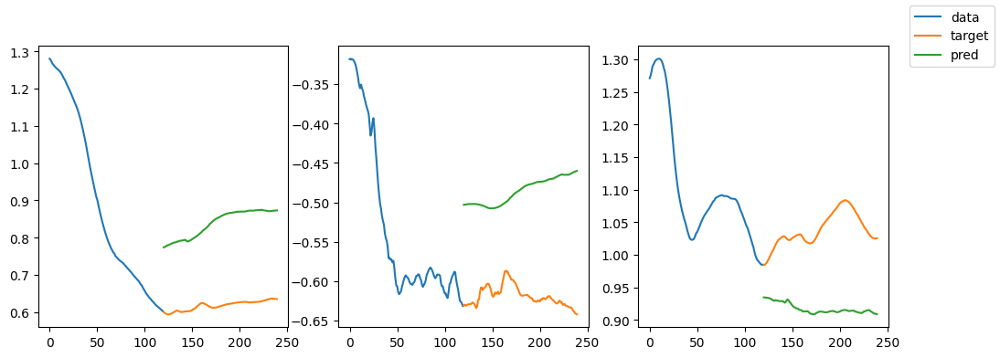

| epoch  31 |   148/  373 batches | lr 0.00107 | ms/batch 18.20968 | loss 0.62772
training prediction


<Figure size 640x480 with 0 Axes>

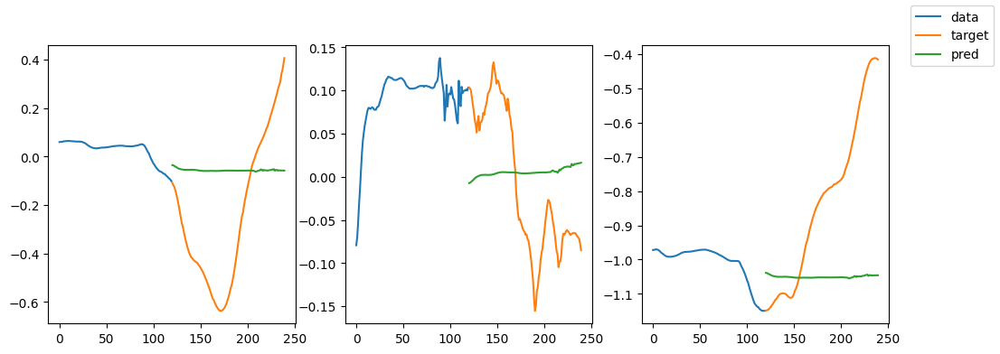

| epoch  31 |   222/  373 batches | lr 0.00107 | ms/batch 17.92330 | loss 0.54454
training prediction


<Figure size 640x480 with 0 Axes>

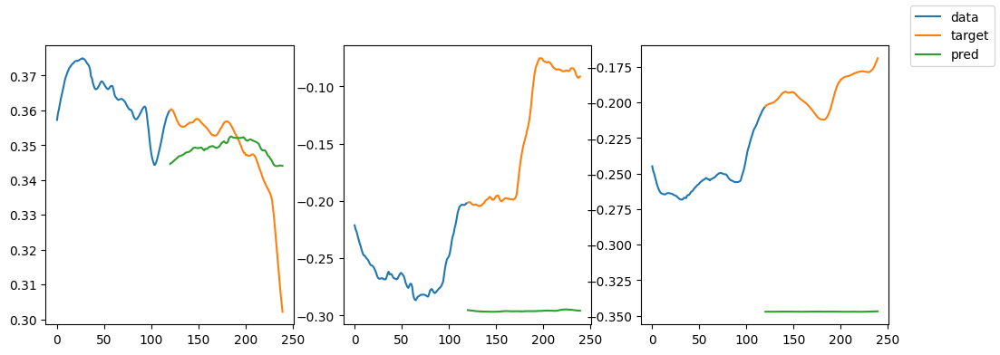

| epoch  31 |   296/  373 batches | lr 0.00107 | ms/batch 18.28550 | loss 0.50626
training prediction


<Figure size 640x480 with 0 Axes>

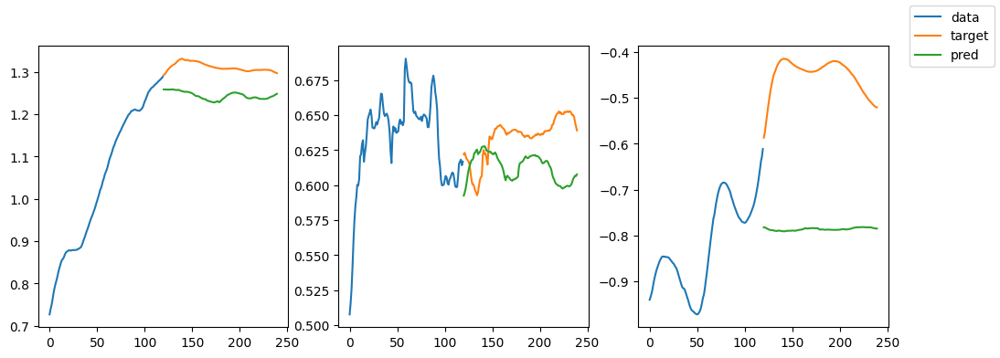

| epoch  31 |   370/  373 batches | lr 0.00107 | ms/batch 17.82846 | loss 0.58039
training prediction


<Figure size 640x480 with 0 Axes>

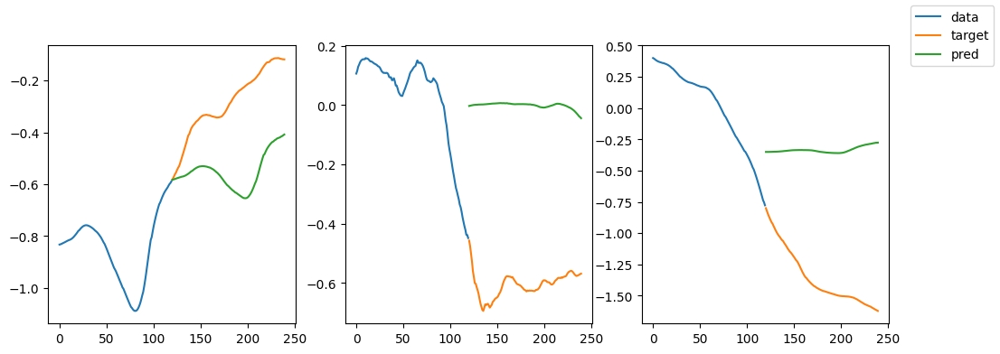

validation prediction


<Figure size 640x480 with 0 Axes>

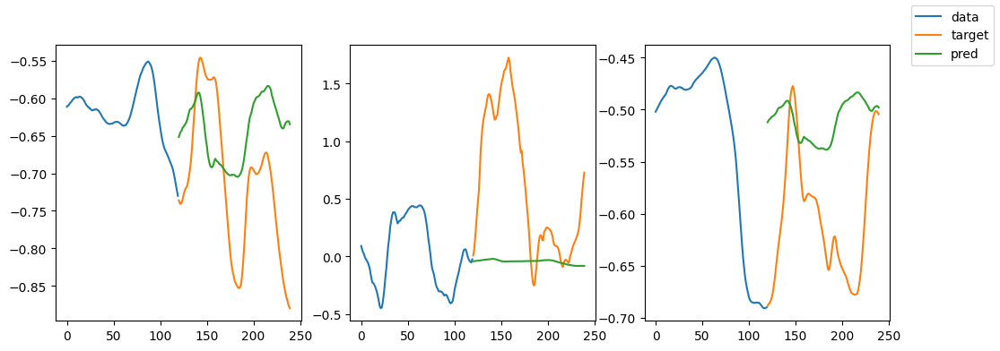

validation prediction


<Figure size 640x480 with 0 Axes>

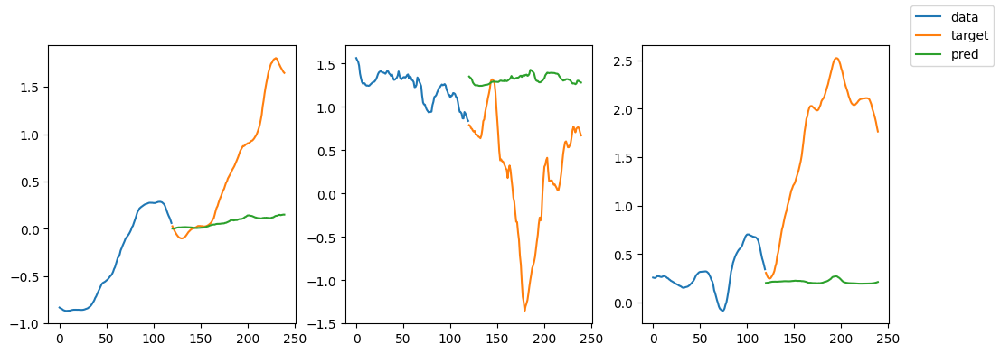

-----------------------------------------------------------------------------------------
| end of epoch  31 | time:  7.82s | valid loss 1.8144 | mean loss   0.6081
-----------------------------------------------------------------------------------------


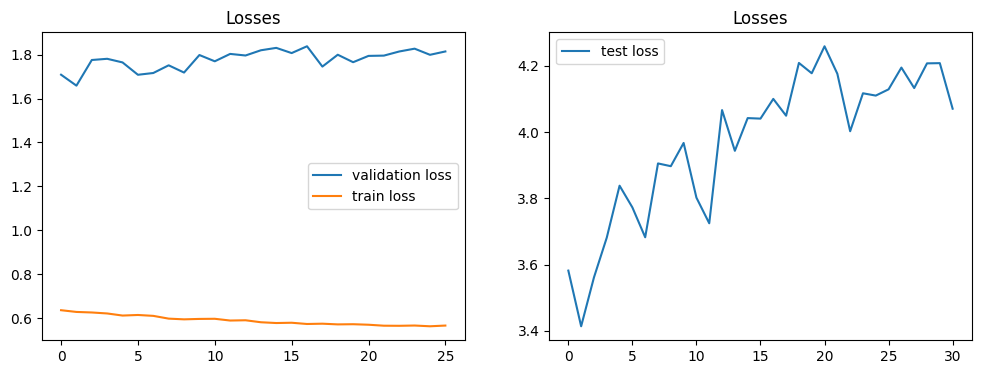

Epoch #32


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  32 |    74/  373 batches | lr 0.00102 | ms/batch 12.10087 | loss 0.51392
| epoch  32 |   148/  373 batches | lr 0.00102 | ms/batch 8.76915 | loss 0.58162
| epoch  32 |   222/  373 batches | lr 0.00102 | ms/batch 8.61830 | loss 0.59184
| epoch  32 |   296/  373 batches | lr 0.00102 | ms/batch 8.56831 | loss 0.56267
| epoch  32 |   370/  373 batches | lr 0.00102 | ms/batch 8.62738 | loss 0.56543
-----------------------------------------------------------------------------------------
| end of epoch  32 | time:  3.68s | valid loss 1.7921 | mean loss   0.6067
-----------------------------------------------------------------------------------------
Epoch #33


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  33 |    74/  373 batches | lr 0.00097 | ms/batch 8.69098 | loss 0.52330
training prediction


<Figure size 640x480 with 0 Axes>

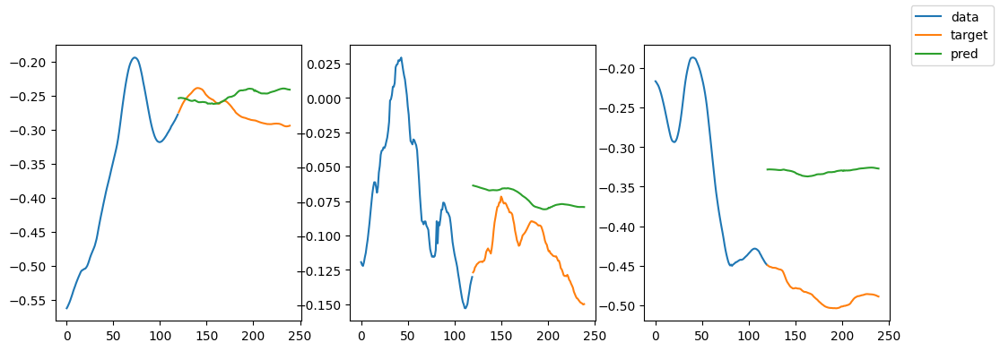

| epoch  33 |   148/  373 batches | lr 0.00097 | ms/batch 11.48708 | loss 0.55522
training prediction


<Figure size 640x480 with 0 Axes>

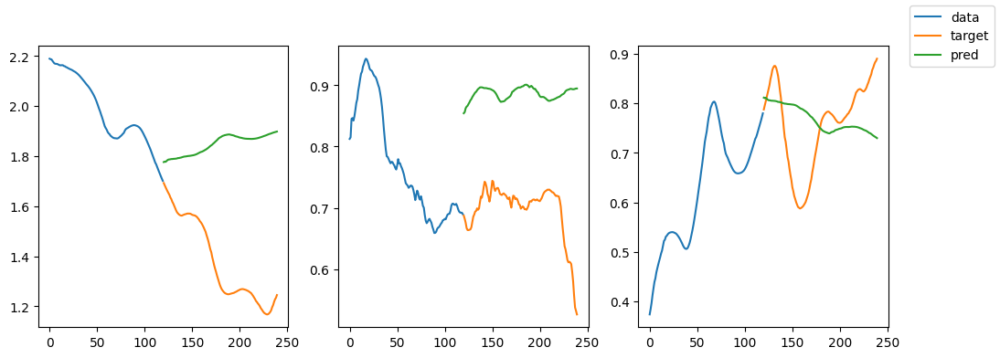

| epoch  33 |   222/  373 batches | lr 0.00097 | ms/batch 11.25147 | loss 0.59356
training prediction


<Figure size 640x480 with 0 Axes>

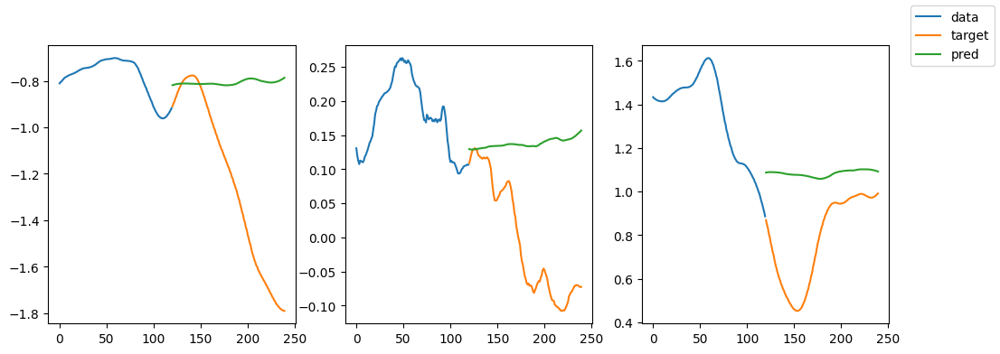

| epoch  33 |   296/  373 batches | lr 0.00097 | ms/batch 14.18594 | loss 0.56055
training prediction


<Figure size 640x480 with 0 Axes>

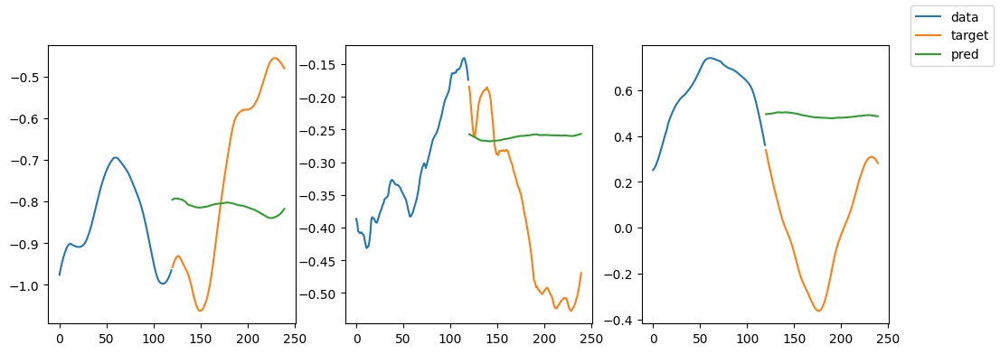

| epoch  33 |   370/  373 batches | lr 0.00097 | ms/batch 11.55092 | loss 0.56165
training prediction


<Figure size 640x480 with 0 Axes>

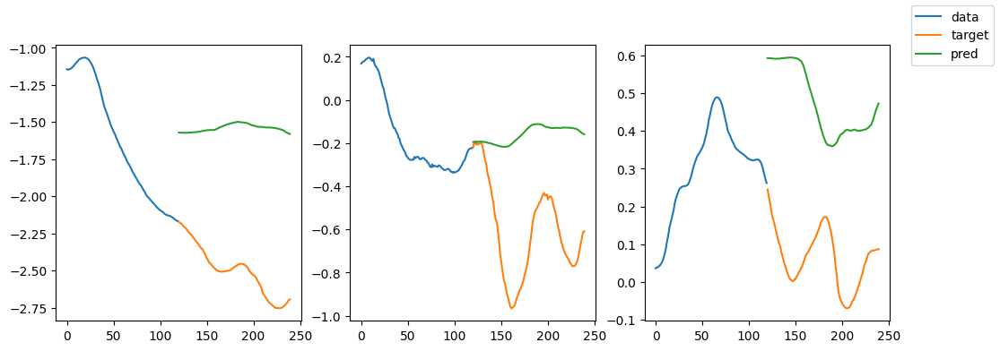

validation prediction


<Figure size 640x480 with 0 Axes>

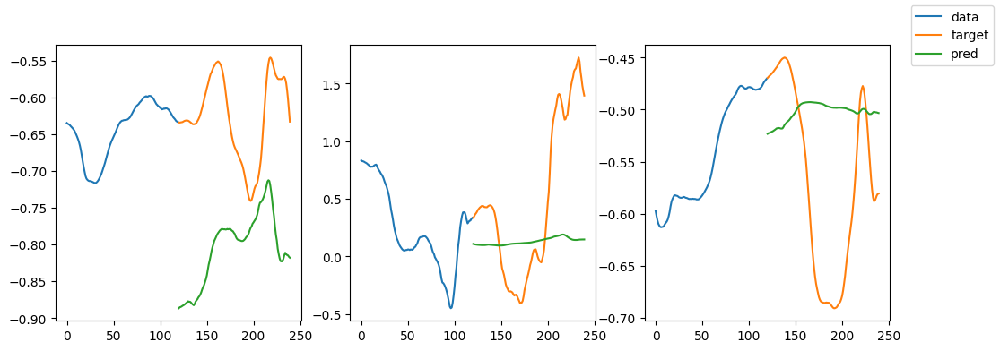

validation prediction


<Figure size 640x480 with 0 Axes>

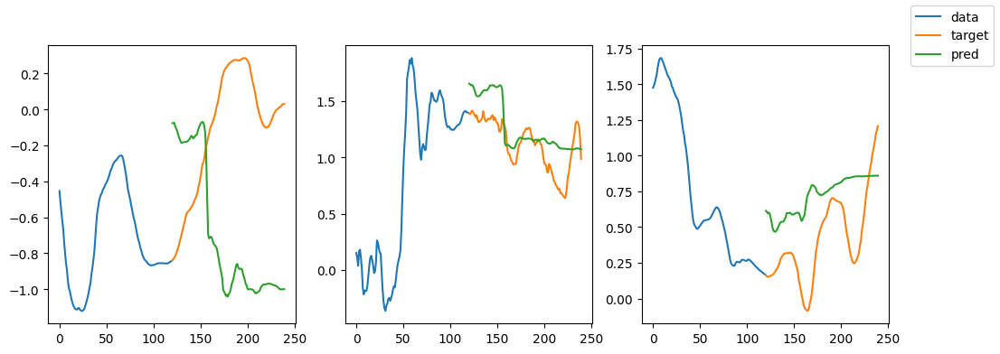

-----------------------------------------------------------------------------------------
| end of epoch  33 | time:  5.10s | valid loss 1.8648 | mean loss   0.6052
-----------------------------------------------------------------------------------------


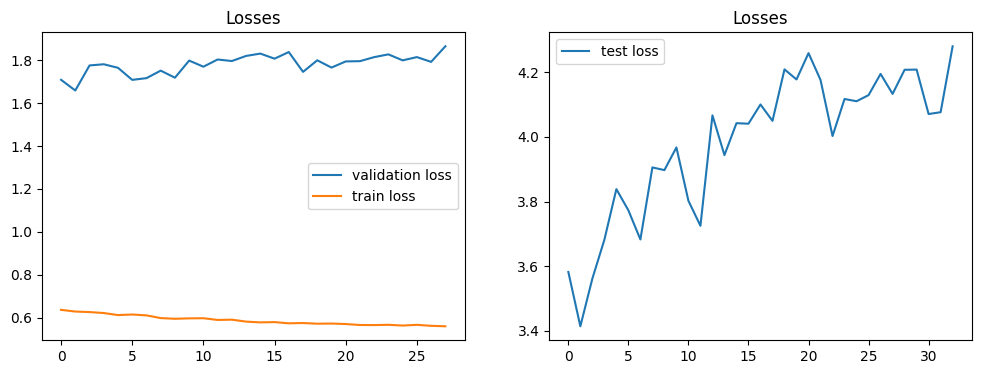

Epoch #34


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  34 |    74/  373 batches | lr 0.00092 | ms/batch 8.78321 | loss 0.54996
| epoch  34 |   148/  373 batches | lr 0.00092 | ms/batch 8.61203 | loss 0.55445
| epoch  34 |   222/  373 batches | lr 0.00092 | ms/batch 8.66868 | loss 0.55769
| epoch  34 |   296/  373 batches | lr 0.00092 | ms/batch 8.63813 | loss 0.57177
| epoch  34 |   370/  373 batches | lr 0.00092 | ms/batch 8.66916 | loss 0.57865
-----------------------------------------------------------------------------------------
| end of epoch  34 | time:  3.45s | valid loss 1.7924 | mean loss   0.6039
-----------------------------------------------------------------------------------------
Epoch #35


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  35 |    74/  373 batches | lr 0.00087 | ms/batch 8.77256 | loss 0.61266
training prediction


<Figure size 640x480 with 0 Axes>

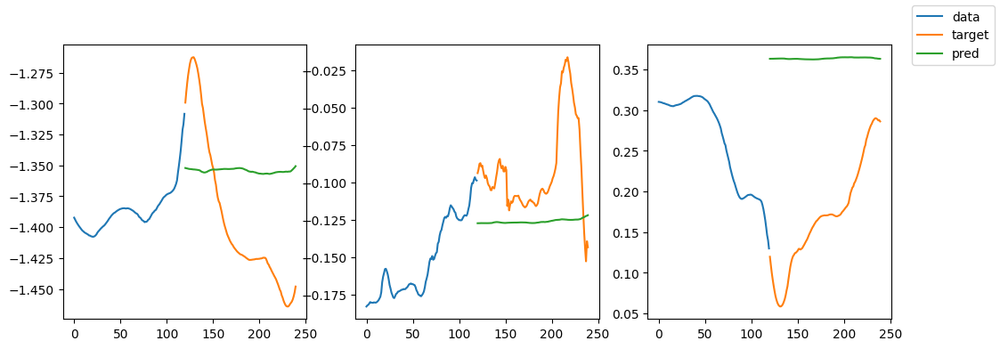

| epoch  35 |   148/  373 batches | lr 0.00087 | ms/batch 11.53577 | loss 0.58026
training prediction


<Figure size 640x480 with 0 Axes>

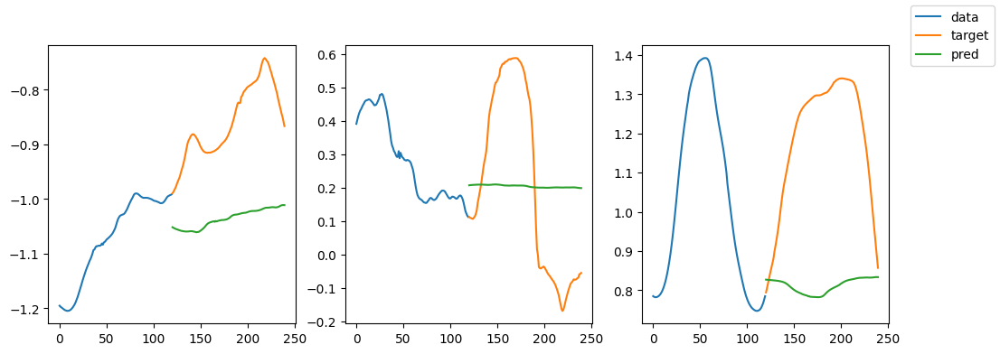

| epoch  35 |   222/  373 batches | lr 0.00087 | ms/batch 11.42786 | loss 0.55259
training prediction


<Figure size 640x480 with 0 Axes>

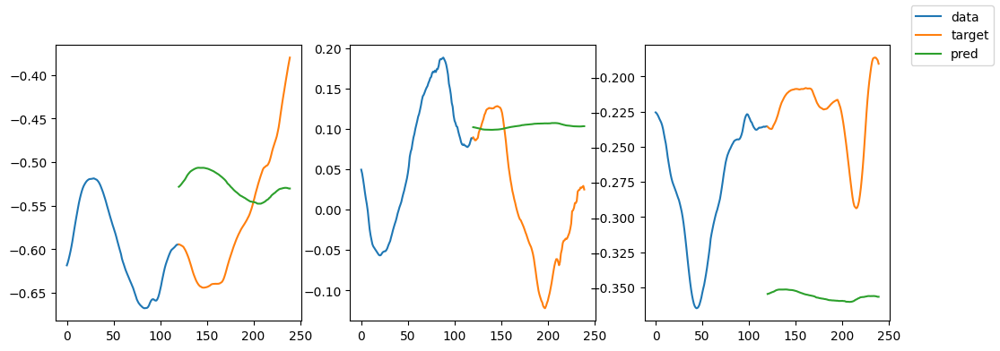

| epoch  35 |   296/  373 batches | lr 0.00087 | ms/batch 11.42520 | loss 0.52004
training prediction


<Figure size 640x480 with 0 Axes>

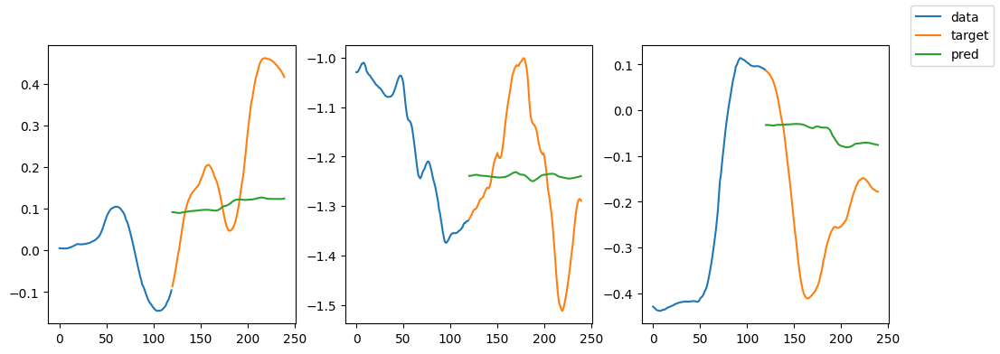

| epoch  35 |   370/  373 batches | lr 0.00087 | ms/batch 11.37703 | loss 0.54277
training prediction


<Figure size 640x480 with 0 Axes>

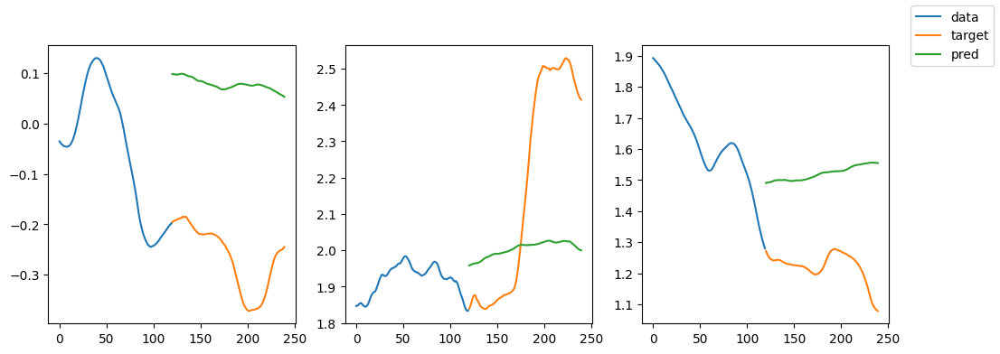

validation prediction


<Figure size 640x480 with 0 Axes>

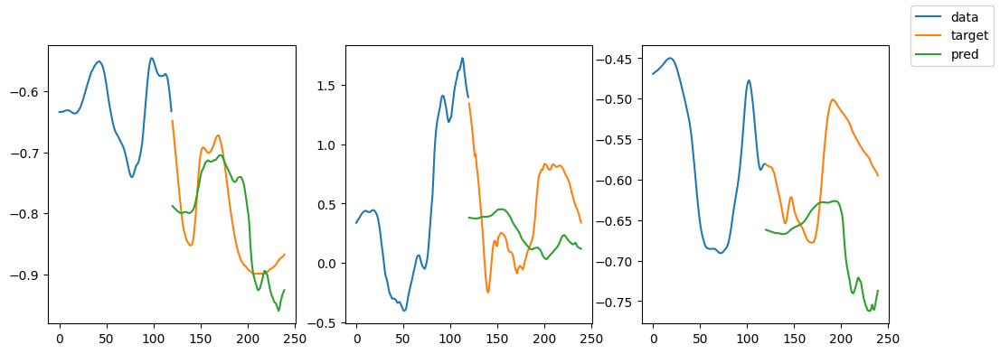

validation prediction


<Figure size 640x480 with 0 Axes>

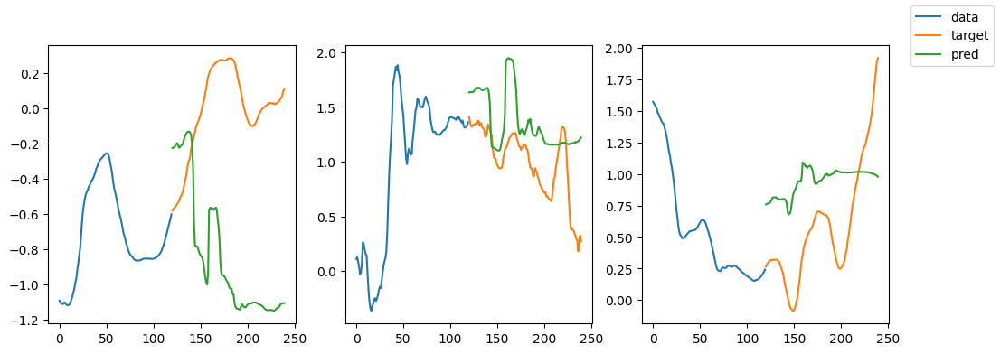

-----------------------------------------------------------------------------------------
| end of epoch  35 | time:  5.10s | valid loss 1.8096 | mean loss   0.6027
-----------------------------------------------------------------------------------------


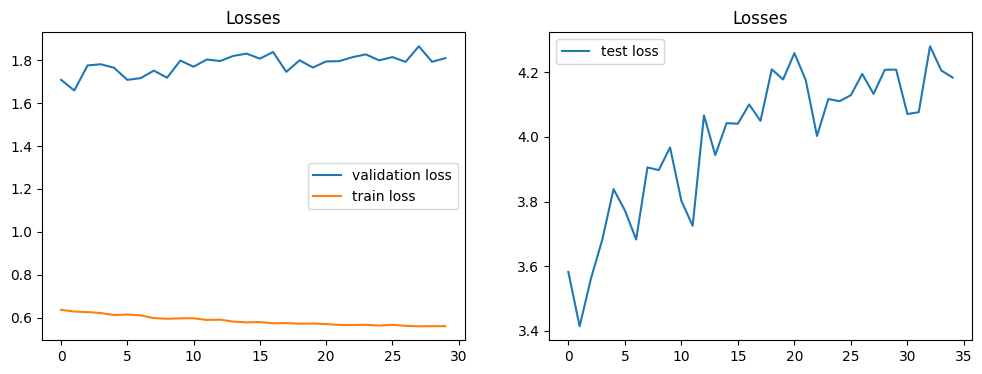

Epoch #36


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  36 |    74/  373 batches | lr 0.00083 | ms/batch 8.86294 | loss 0.51282
| epoch  36 |   148/  373 batches | lr 0.00083 | ms/batch 8.64125 | loss 0.58555
| epoch  36 |   222/  373 batches | lr 0.00083 | ms/batch 8.81455 | loss 0.56875
| epoch  36 |   296/  373 batches | lr 0.00083 | ms/batch 8.62661 | loss 0.55970
| epoch  36 |   370/  373 batches | lr 0.00083 | ms/batch 8.73046 | loss 0.55780
-----------------------------------------------------------------------------------------
| end of epoch  36 | time:  3.48s | valid loss 1.8112 | mean loss   0.6013
-----------------------------------------------------------------------------------------
Epoch #37


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  37 |    74/  373 batches | lr 0.00079 | ms/batch 8.77999 | loss 0.63045
training prediction


<Figure size 640x480 with 0 Axes>

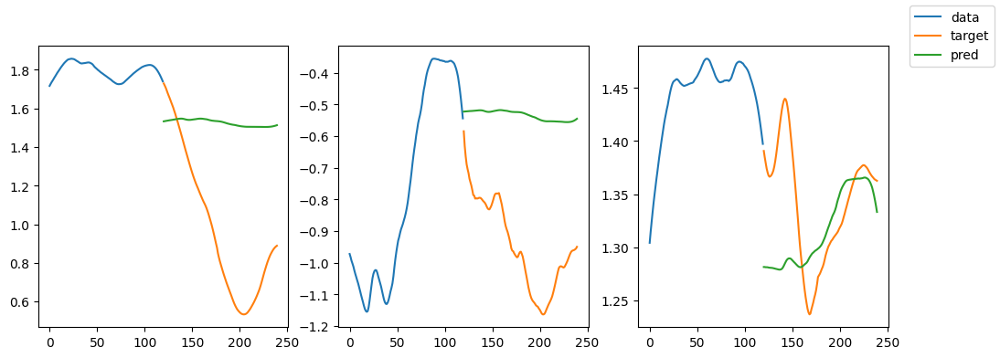

| epoch  37 |   148/  373 batches | lr 0.00079 | ms/batch 11.55175 | loss 0.51378
training prediction


<Figure size 640x480 with 0 Axes>

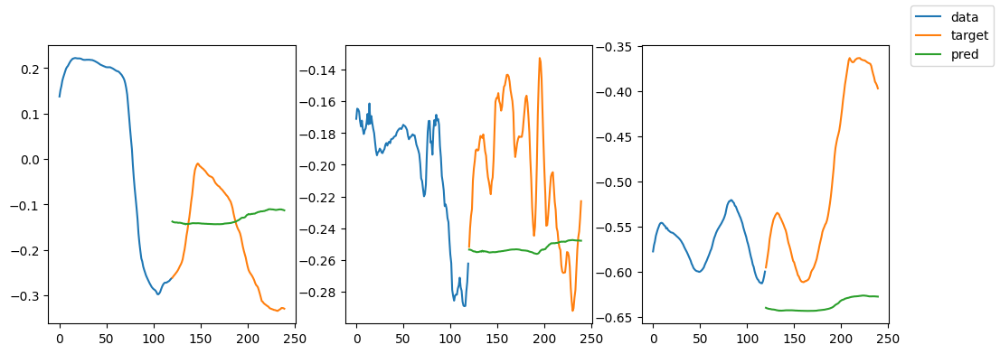

| epoch  37 |   222/  373 batches | lr 0.00079 | ms/batch 11.52763 | loss 0.49148
training prediction


<Figure size 640x480 with 0 Axes>

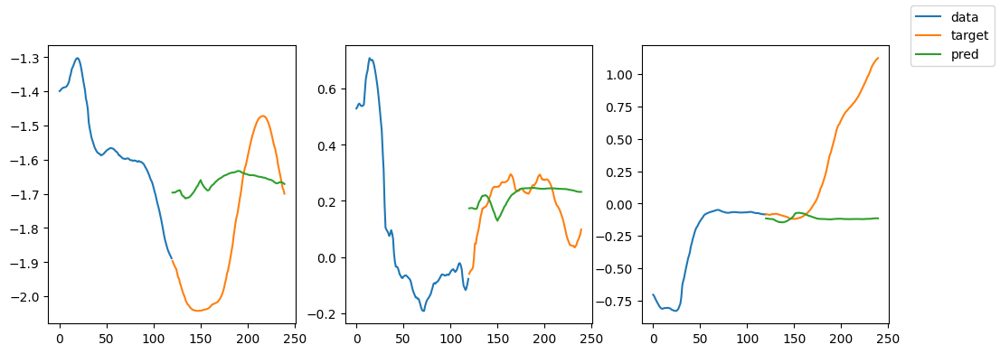

| epoch  37 |   296/  373 batches | lr 0.00079 | ms/batch 11.45375 | loss 0.52941
training prediction


<Figure size 640x480 with 0 Axes>

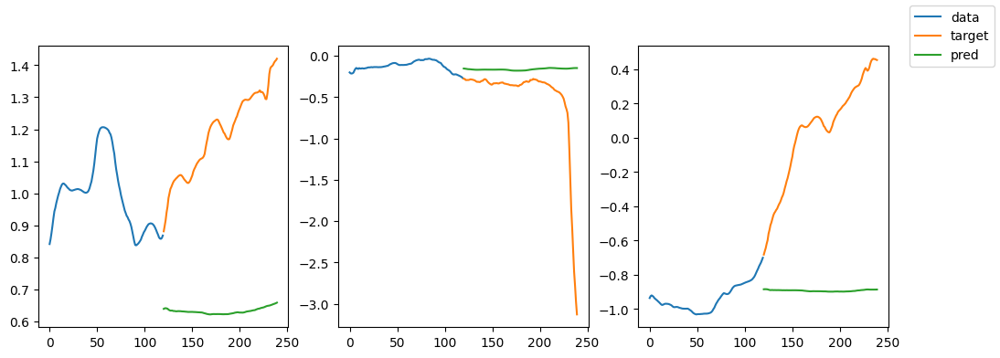

| epoch  37 |   370/  373 batches | lr 0.00079 | ms/batch 11.56396 | loss 0.61705
training prediction


<Figure size 640x480 with 0 Axes>

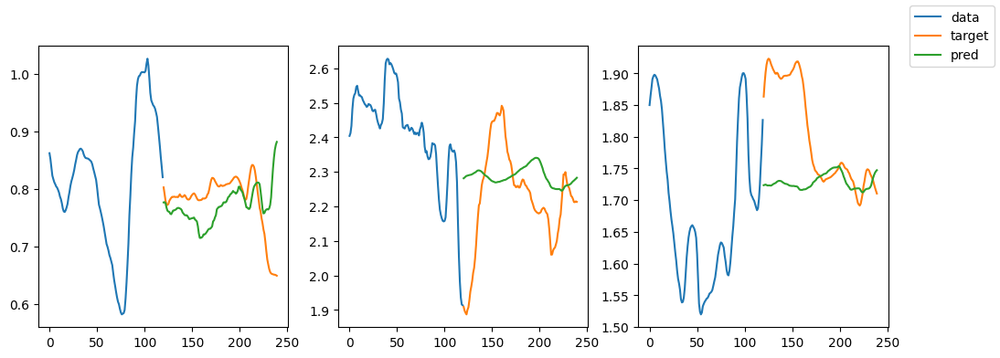

validation prediction


<Figure size 640x480 with 0 Axes>

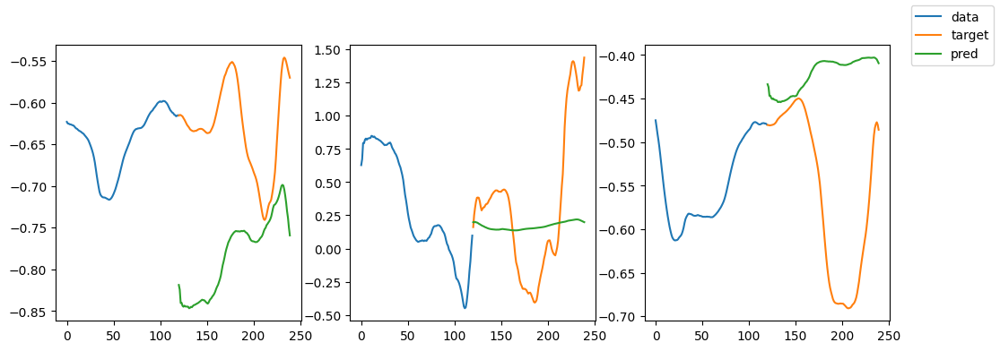

validation prediction


<Figure size 640x480 with 0 Axes>

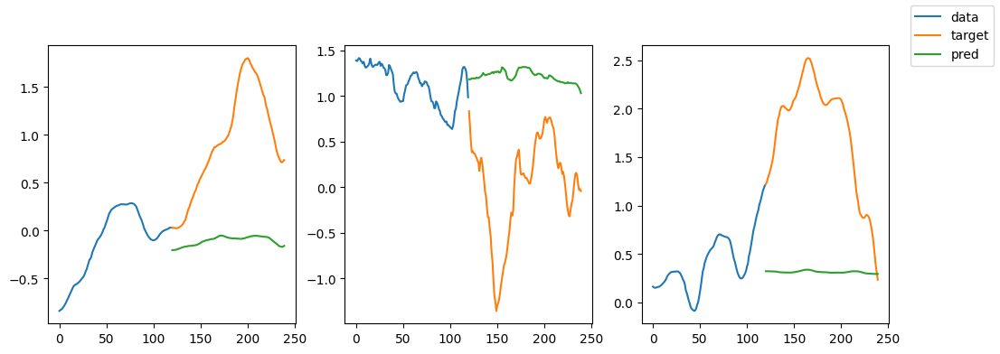

-----------------------------------------------------------------------------------------
| end of epoch  37 | time:  4.93s | valid loss 1.8129 | mean loss   0.6001
-----------------------------------------------------------------------------------------


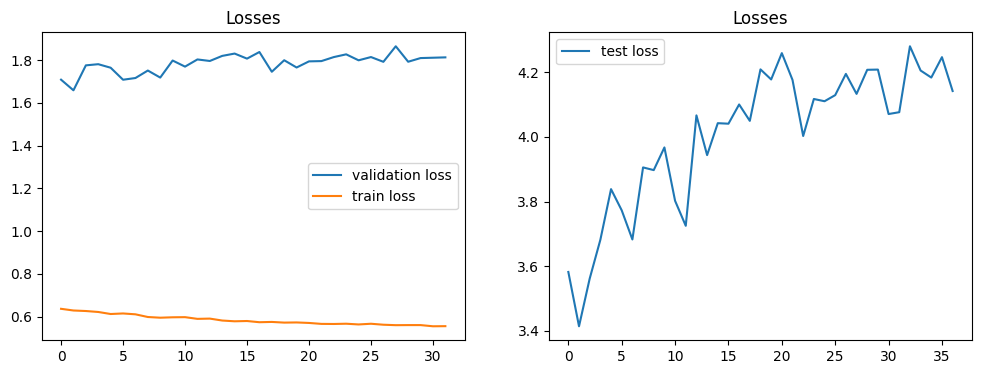

Epoch #38


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  38 |    74/  373 batches | lr 0.00075 | ms/batch 8.73959 | loss 0.54867
| epoch  38 |   148/  373 batches | lr 0.00075 | ms/batch 8.57889 | loss 0.48132
| epoch  38 |   222/  373 batches | lr 0.00075 | ms/batch 8.62326 | loss 0.54179
| epoch  38 |   296/  373 batches | lr 0.00075 | ms/batch 8.65826 | loss 0.56022
| epoch  38 |   370/  373 batches | lr 0.00075 | ms/batch 8.62922 | loss 0.64501
-----------------------------------------------------------------------------------------
| end of epoch  38 | time:  3.44s | valid loss 1.7767 | mean loss   0.5989
-----------------------------------------------------------------------------------------
Epoch #39


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  39 |    74/  373 batches | lr 0.00071 | ms/batch 8.77146 | loss 0.60248
training prediction


<Figure size 640x480 with 0 Axes>

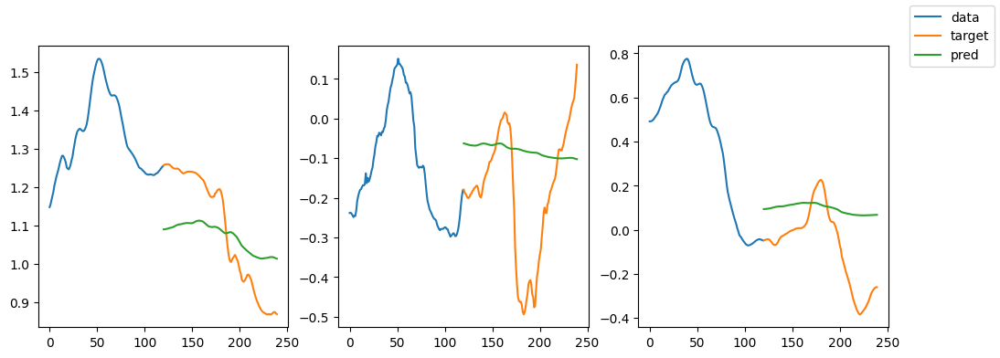

| epoch  39 |   148/  373 batches | lr 0.00071 | ms/batch 14.48735 | loss 0.55853
training prediction


<Figure size 640x480 with 0 Axes>

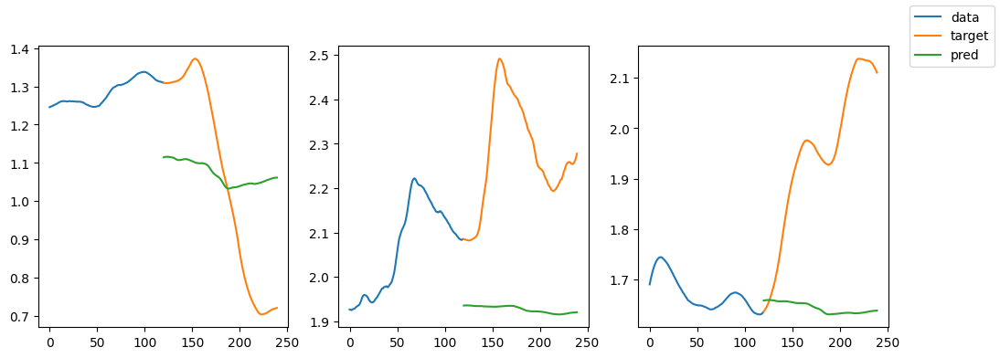

| epoch  39 |   222/  373 batches | lr 0.00071 | ms/batch 11.43837 | loss 0.58411
training prediction


<Figure size 640x480 with 0 Axes>

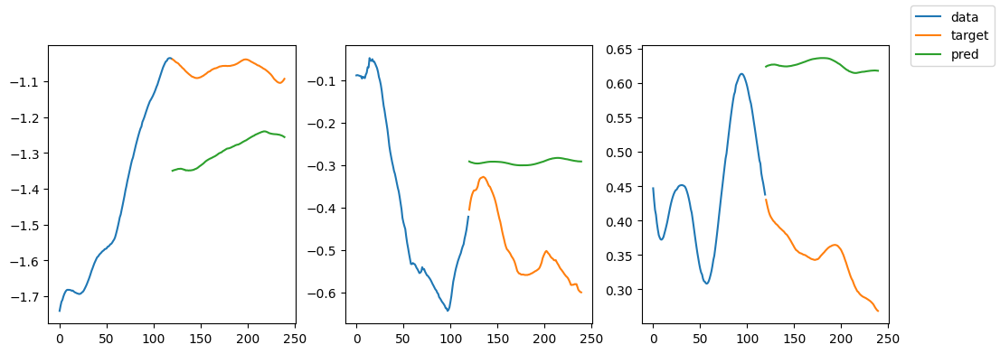

| epoch  39 |   296/  373 batches | lr 0.00071 | ms/batch 11.65624 | loss 0.49541
training prediction


<Figure size 640x480 with 0 Axes>

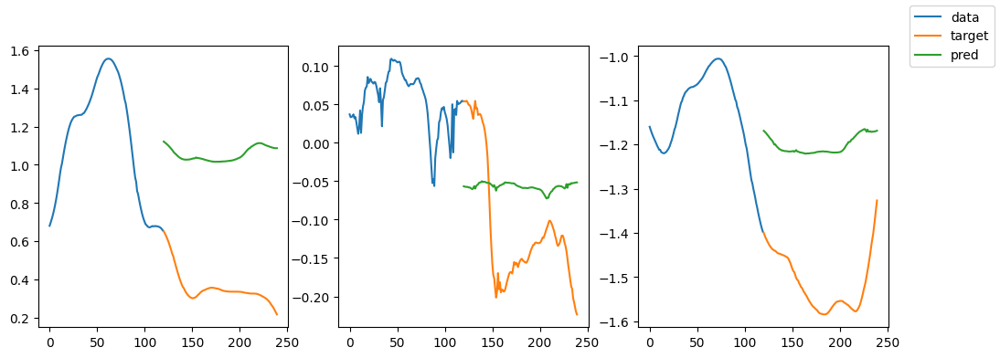

| epoch  39 |   370/  373 batches | lr 0.00071 | ms/batch 11.52176 | loss 0.53289
training prediction


<Figure size 640x480 with 0 Axes>

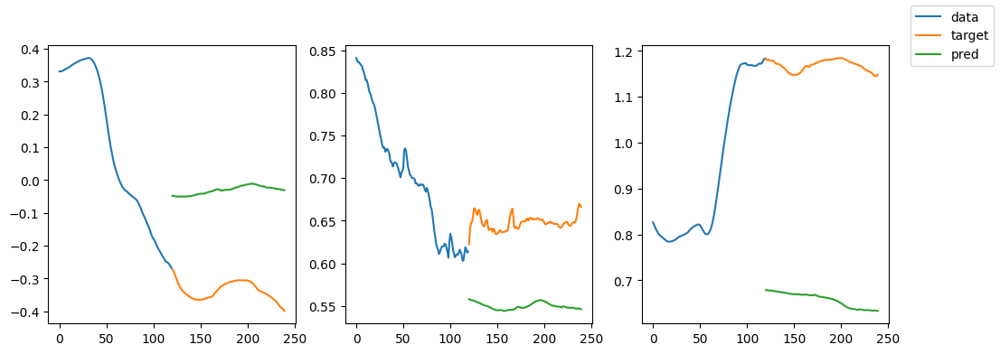

validation prediction


<Figure size 640x480 with 0 Axes>

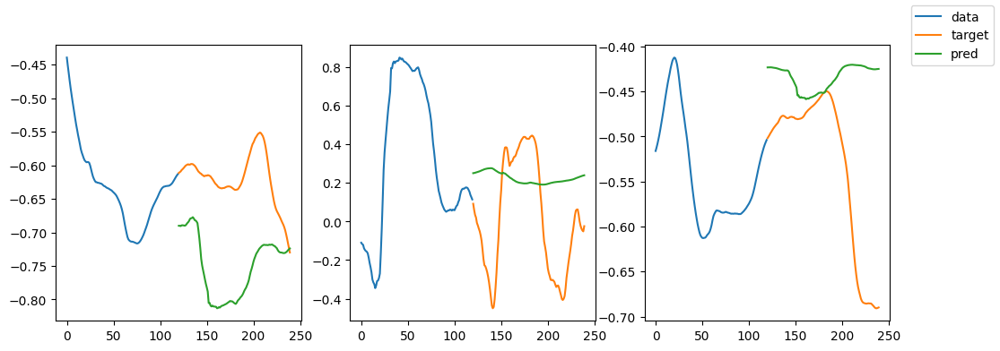

validation prediction


<Figure size 640x480 with 0 Axes>

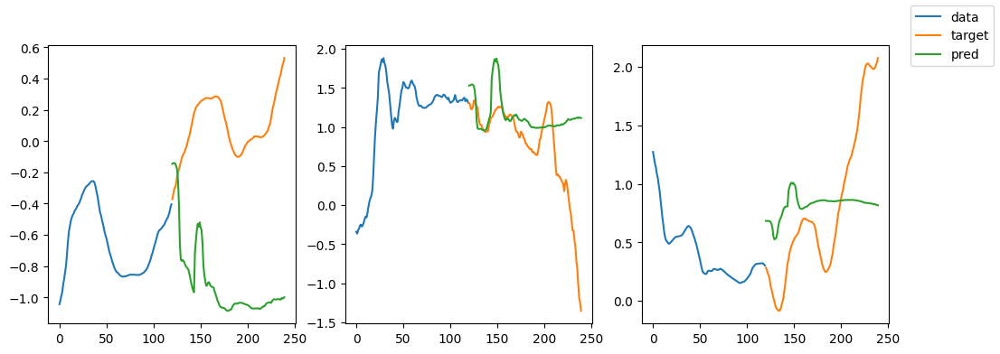

-----------------------------------------------------------------------------------------
| end of epoch  39 | time:  5.16s | valid loss 1.7589 | mean loss   0.5977
-----------------------------------------------------------------------------------------


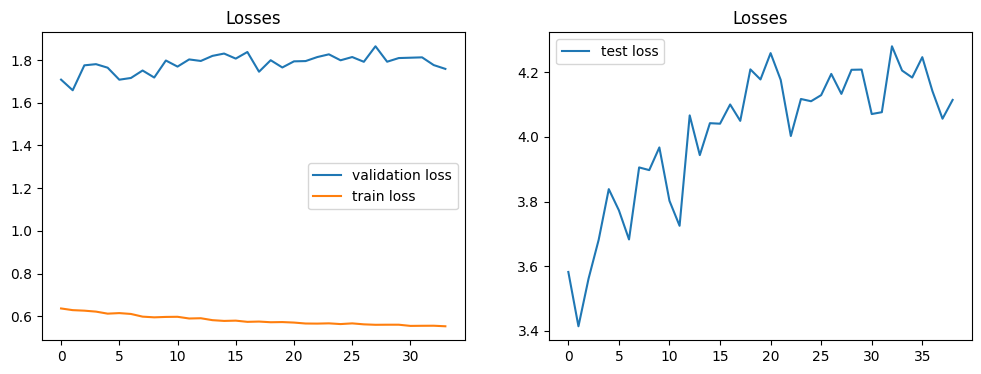

Epoch #40


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  40 |    74/  373 batches | lr 0.00068 | ms/batch 8.80780 | loss 0.58719
| epoch  40 |   148/  373 batches | lr 0.00068 | ms/batch 8.62777 | loss 0.54705
| epoch  40 |   222/  373 batches | lr 0.00068 | ms/batch 8.74450 | loss 0.54184
| epoch  40 |   296/  373 batches | lr 0.00068 | ms/batch 8.70708 | loss 0.54124
| epoch  40 |   370/  373 batches | lr 0.00068 | ms/batch 8.68095 | loss 0.56417
-----------------------------------------------------------------------------------------
| end of epoch  40 | time:  3.47s | valid loss 1.8519 | mean loss   0.5966
-----------------------------------------------------------------------------------------
Epoch #41


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  41 |    74/  373 batches | lr 0.00064 | ms/batch 8.80161 | loss 0.58168
training prediction


<Figure size 640x480 with 0 Axes>

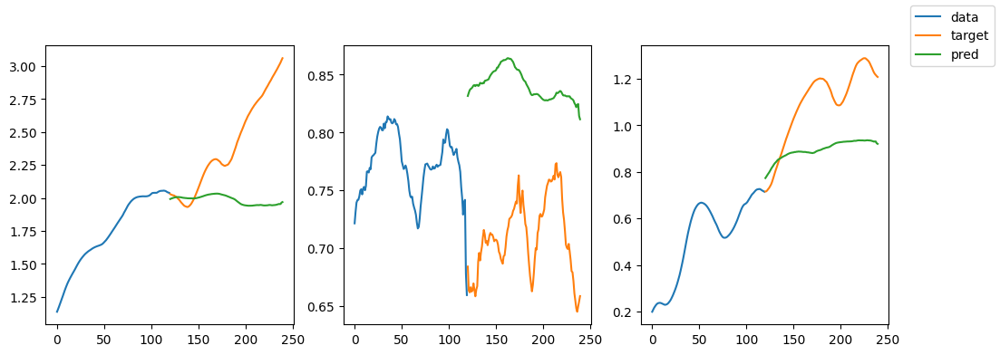

| epoch  41 |   148/  373 batches | lr 0.00064 | ms/batch 11.47069 | loss 0.54476
training prediction


<Figure size 640x480 with 0 Axes>

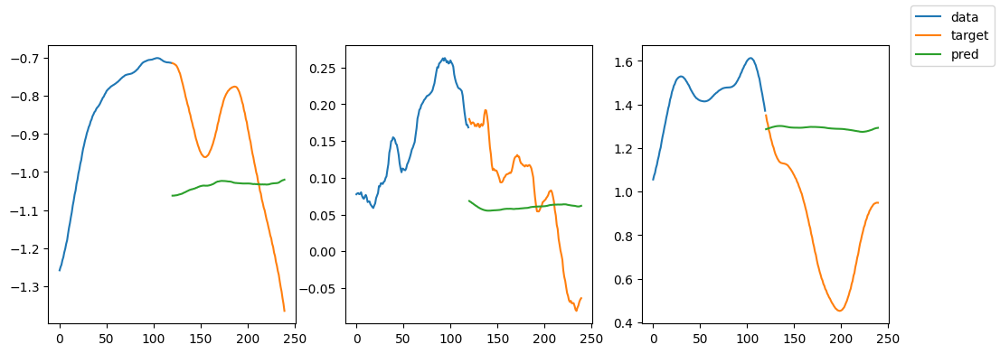

| epoch  41 |   222/  373 batches | lr 0.00064 | ms/batch 11.49927 | loss 0.54196
training prediction


<Figure size 640x480 with 0 Axes>

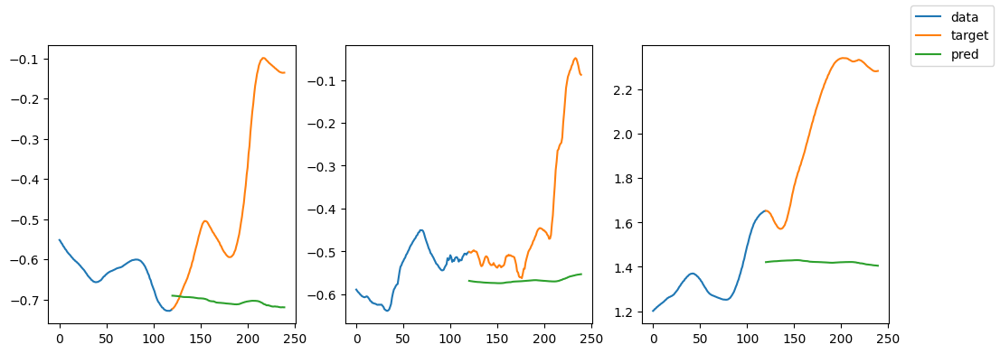

| epoch  41 |   296/  373 batches | lr 0.00064 | ms/batch 11.52463 | loss 0.54143
training prediction


<Figure size 640x480 with 0 Axes>

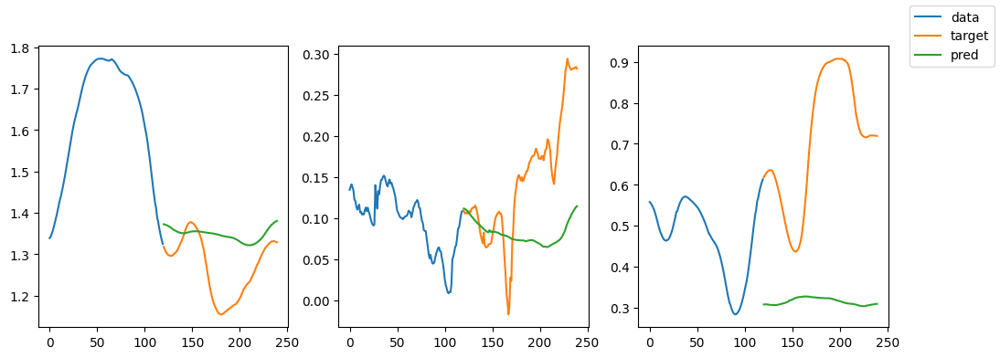

| epoch  41 |   370/  373 batches | lr 0.00064 | ms/batch 14.30845 | loss 0.56082
training prediction


<Figure size 640x480 with 0 Axes>

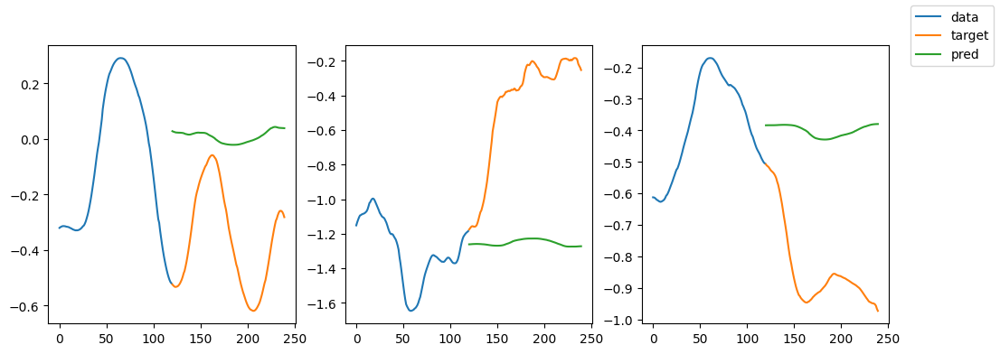

validation prediction


<Figure size 640x480 with 0 Axes>

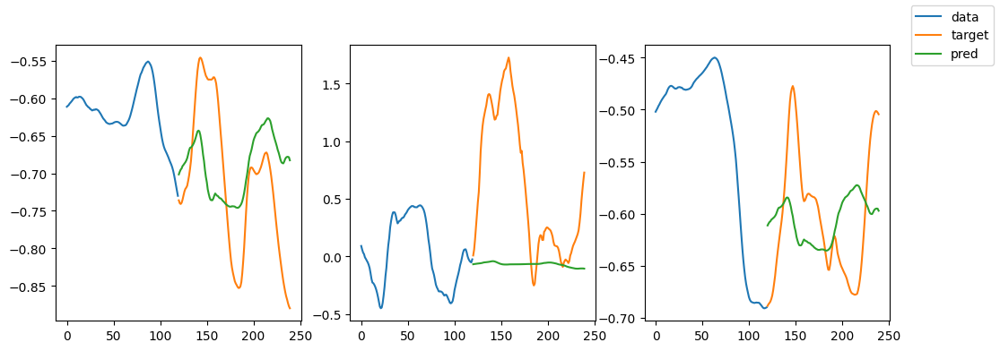

validation prediction


<Figure size 640x480 with 0 Axes>

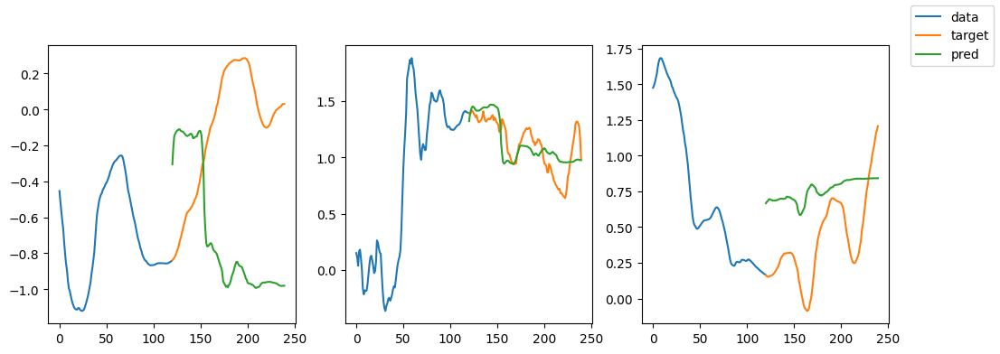

-----------------------------------------------------------------------------------------
| end of epoch  41 | time:  5.13s | valid loss 1.8021 | mean loss   0.5955
-----------------------------------------------------------------------------------------


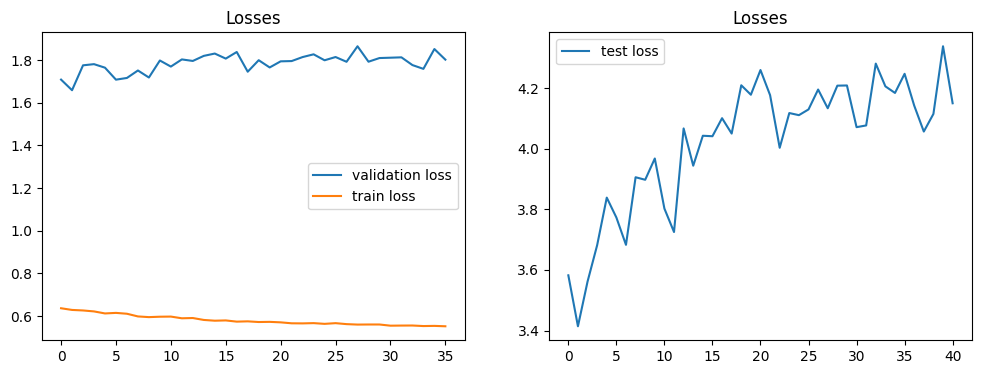

Epoch #42


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  42 |    74/  373 batches | lr 0.00061 | ms/batch 8.82419 | loss 0.50725
| epoch  42 |   148/  373 batches | lr 0.00061 | ms/batch 8.63676 | loss 0.55854
| epoch  42 |   222/  373 batches | lr 0.00061 | ms/batch 8.63426 | loss 0.62689
| epoch  42 |   296/  373 batches | lr 0.00061 | ms/batch 8.64730 | loss 0.53247
| epoch  42 |   370/  373 batches | lr 0.00061 | ms/batch 8.68310 | loss 0.54326
-----------------------------------------------------------------------------------------
| end of epoch  42 | time:  3.45s | valid loss 1.7932 | mean loss   0.5945
-----------------------------------------------------------------------------------------
Epoch #43


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  43 |    74/  373 batches | lr 0.00058 | ms/batch 8.77150 | loss 0.55631
training prediction


<Figure size 640x480 with 0 Axes>

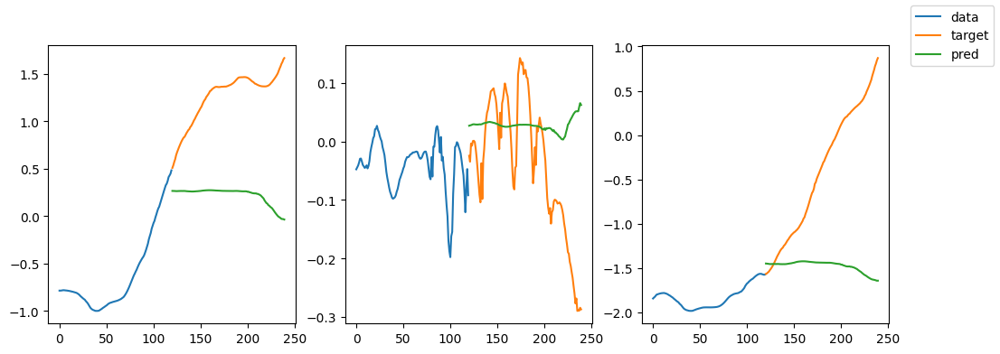

| epoch  43 |   148/  373 batches | lr 0.00058 | ms/batch 11.39659 | loss 0.52970
training prediction


<Figure size 640x480 with 0 Axes>

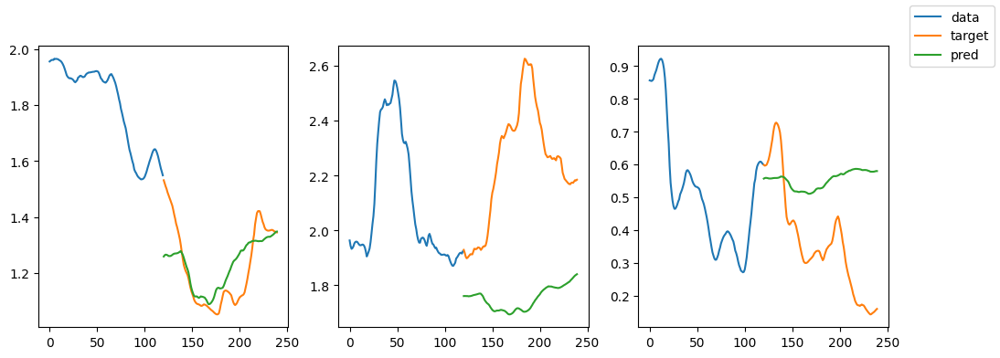

| epoch  43 |   222/  373 batches | lr 0.00058 | ms/batch 11.52386 | loss 0.61721
training prediction


<Figure size 640x480 with 0 Axes>

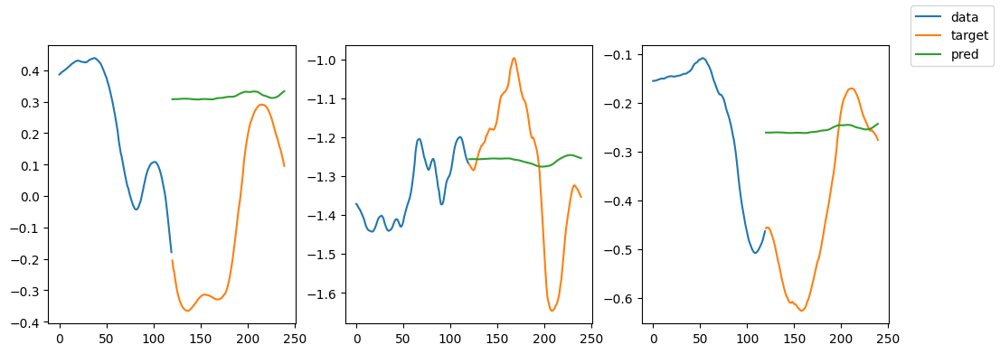

| epoch  43 |   296/  373 batches | lr 0.00058 | ms/batch 11.54334 | loss 0.53760
training prediction


<Figure size 640x480 with 0 Axes>

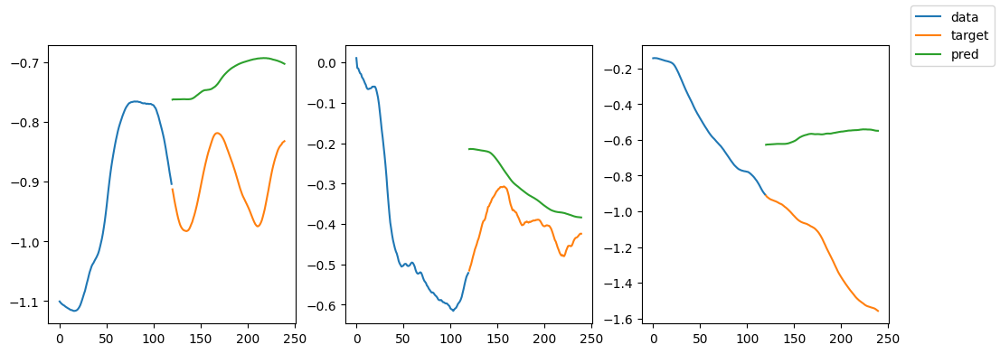

| epoch  43 |   370/  373 batches | lr 0.00058 | ms/batch 11.57316 | loss 0.53310
training prediction


<Figure size 640x480 with 0 Axes>

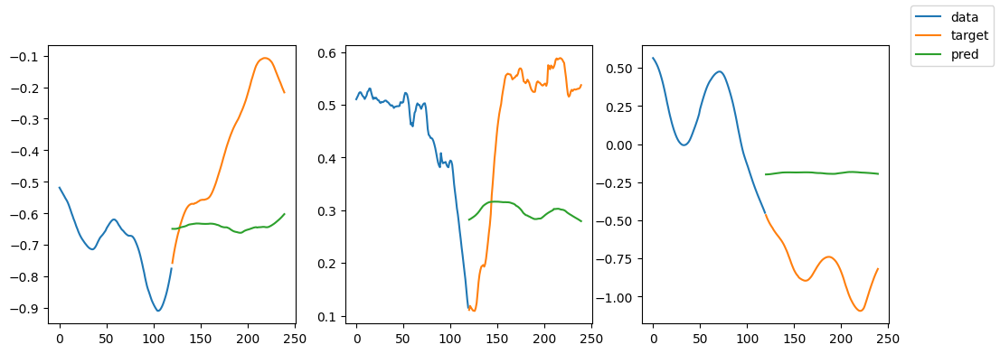

validation prediction


<Figure size 640x480 with 0 Axes>

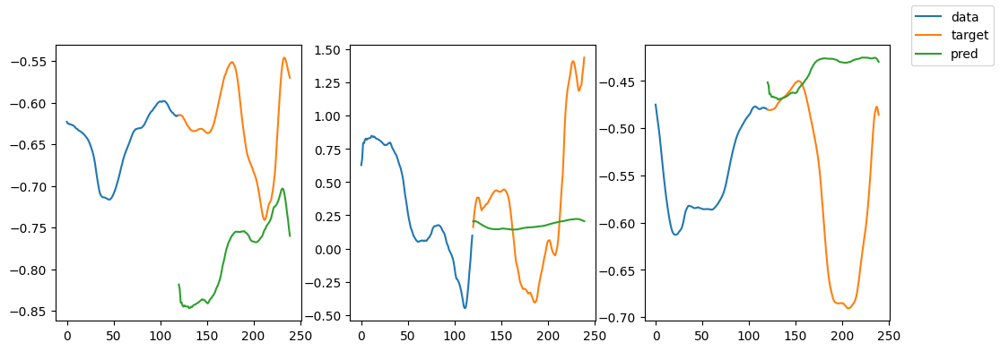

validation prediction


<Figure size 640x480 with 0 Axes>

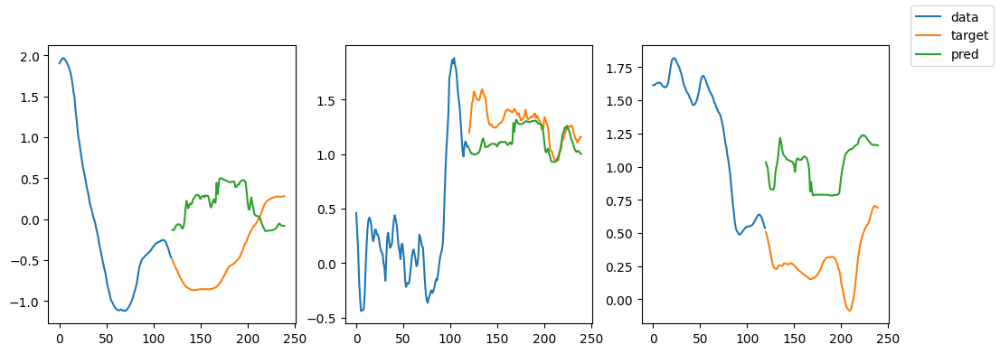

-----------------------------------------------------------------------------------------
| end of epoch  43 | time:  5.13s | valid loss 1.7911 | mean loss   0.5935
-----------------------------------------------------------------------------------------


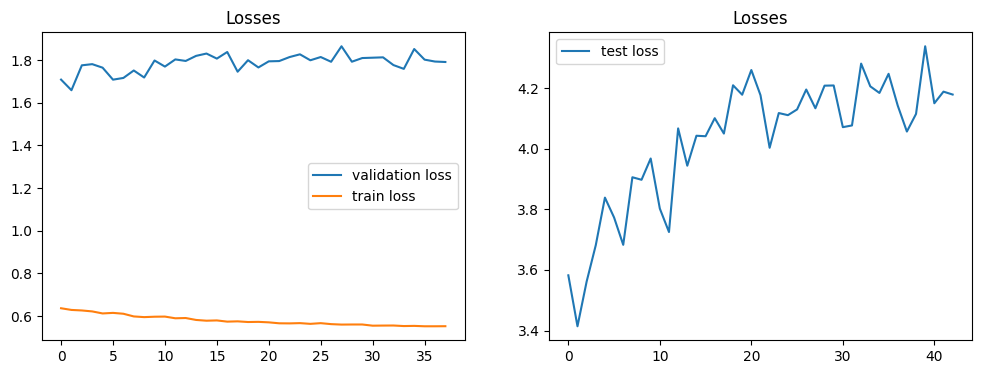

Epoch #44


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  44 |    74/  373 batches | lr 0.00055 | ms/batch 8.97989 | loss 0.53701
| epoch  44 |   148/  373 batches | lr 0.00055 | ms/batch 8.70066 | loss 0.59854
| epoch  44 |   222/  373 batches | lr 0.00055 | ms/batch 8.75640 | loss 0.56676
| epoch  44 |   296/  373 batches | lr 0.00055 | ms/batch 8.71313 | loss 0.51366
| epoch  44 |   370/  373 batches | lr 0.00055 | ms/batch 8.74322 | loss 0.55128
-----------------------------------------------------------------------------------------
| end of epoch  44 | time:  3.49s | valid loss 1.8359 | mean loss   0.5926
-----------------------------------------------------------------------------------------
Epoch #45


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  45 |    74/  373 batches | lr 0.00052 | ms/batch 8.84627 | loss 0.58356
training prediction


<Figure size 640x480 with 0 Axes>

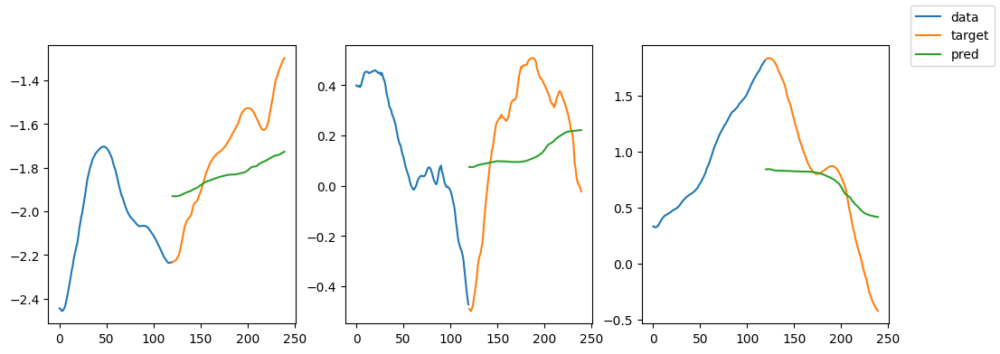

| epoch  45 |   148/  373 batches | lr 0.00052 | ms/batch 11.37421 | loss 0.48890
training prediction


<Figure size 640x480 with 0 Axes>

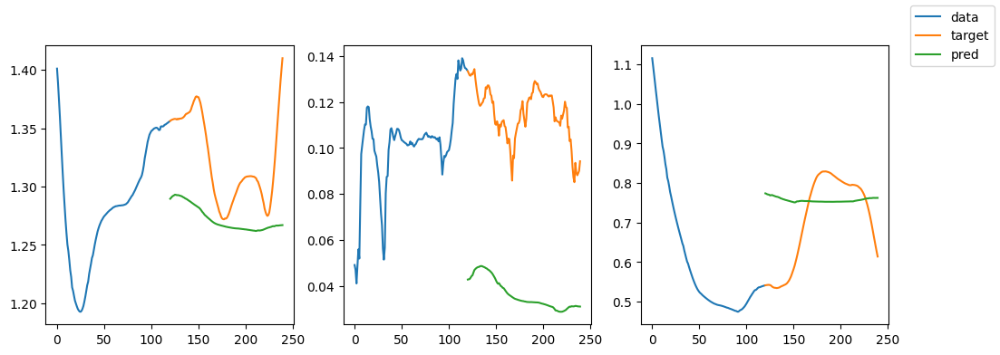

| epoch  45 |   222/  373 batches | lr 0.00052 | ms/batch 11.43208 | loss 0.51255
training prediction


<Figure size 640x480 with 0 Axes>

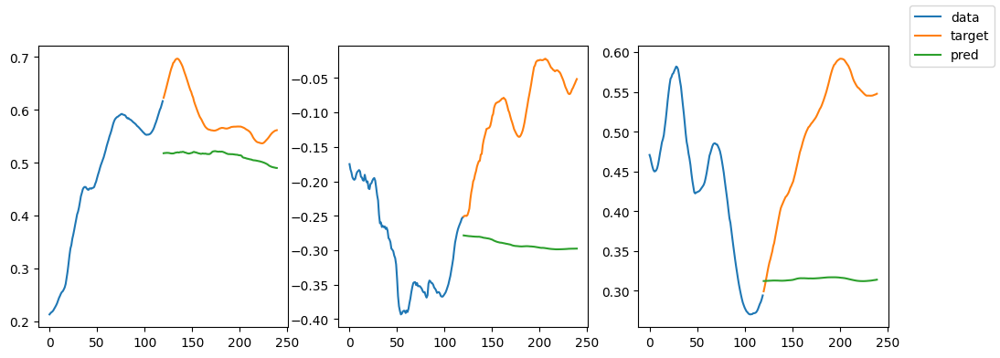

| epoch  45 |   296/  373 batches | lr 0.00052 | ms/batch 11.51491 | loss 0.58788
training prediction


<Figure size 640x480 with 0 Axes>

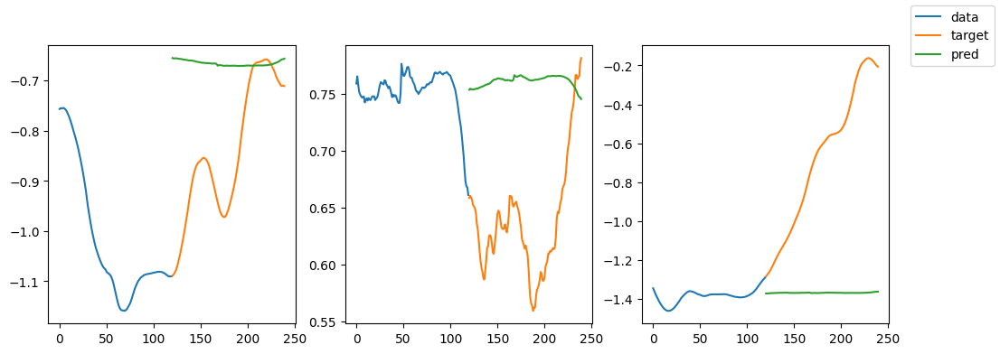

| epoch  45 |   370/  373 batches | lr 0.00052 | ms/batch 11.41841 | loss 0.59194
training prediction


<Figure size 640x480 with 0 Axes>

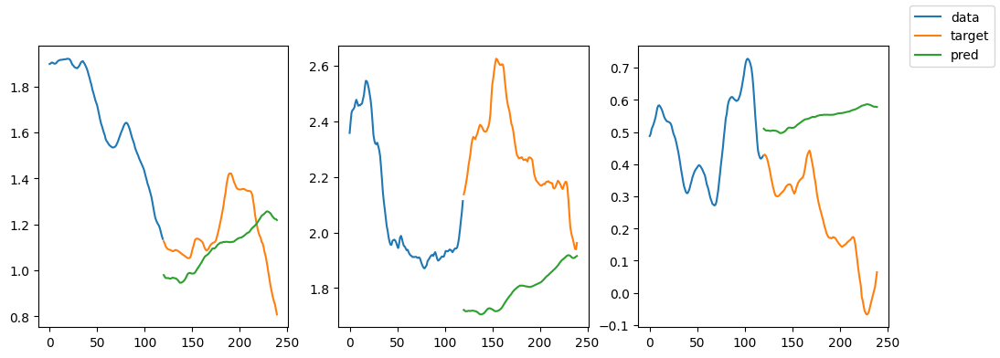

validation prediction


<Figure size 640x480 with 0 Axes>

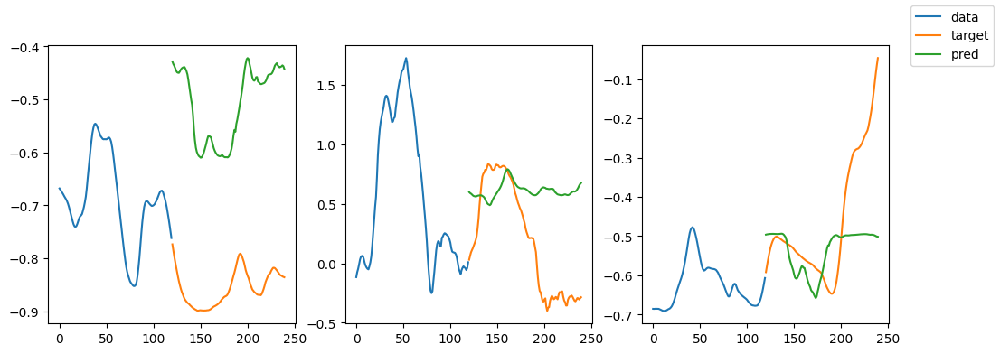

validation prediction


<Figure size 640x480 with 0 Axes>

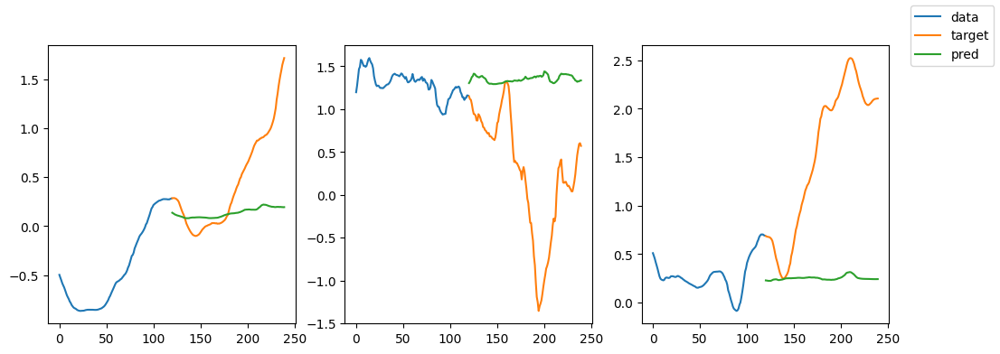

-----------------------------------------------------------------------------------------
| end of epoch  45 | time:  4.89s | valid loss 1.7956 | mean loss   0.5916
-----------------------------------------------------------------------------------------


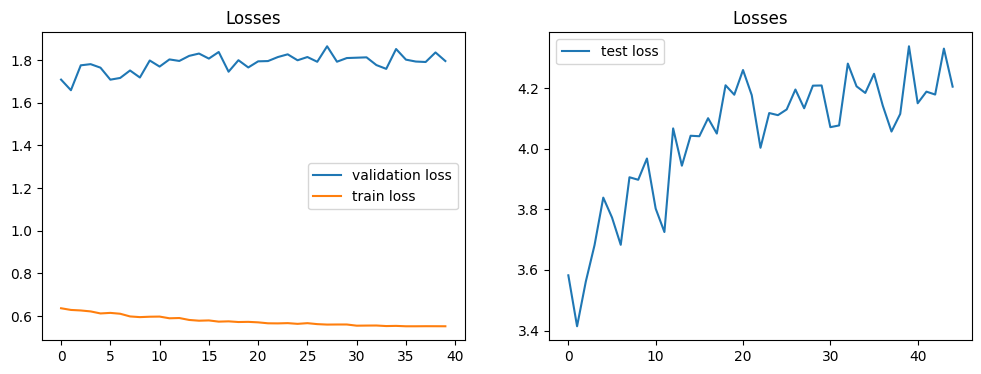

Epoch #46


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  46 |    74/  373 batches | lr 0.00050 | ms/batch 8.80827 | loss 0.53290
| epoch  46 |   148/  373 batches | lr 0.00050 | ms/batch 8.60375 | loss 0.50411
| epoch  46 |   222/  373 batches | lr 0.00050 | ms/batch 8.67200 | loss 0.48999
| epoch  46 |   296/  373 batches | lr 0.00050 | ms/batch 8.60900 | loss 0.59355
| epoch  46 |   370/  373 batches | lr 0.00050 | ms/batch 8.64987 | loss 0.63060
-----------------------------------------------------------------------------------------
| end of epoch  46 | time:  3.45s | valid loss 1.8294 | mean loss   0.5907
-----------------------------------------------------------------------------------------
Epoch #47


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  47 |    74/  373 batches | lr 0.00047 | ms/batch 8.81966 | loss 0.57680
training prediction


<Figure size 640x480 with 0 Axes>

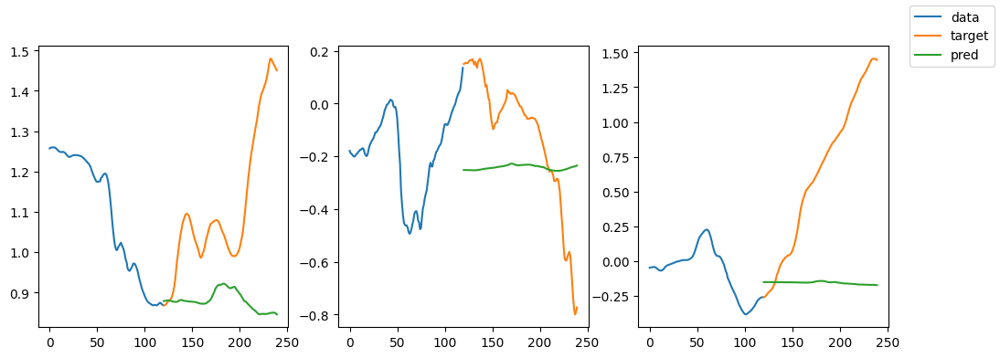

| epoch  47 |   148/  373 batches | lr 0.00047 | ms/batch 11.66683 | loss 0.59652
training prediction


<Figure size 640x480 with 0 Axes>

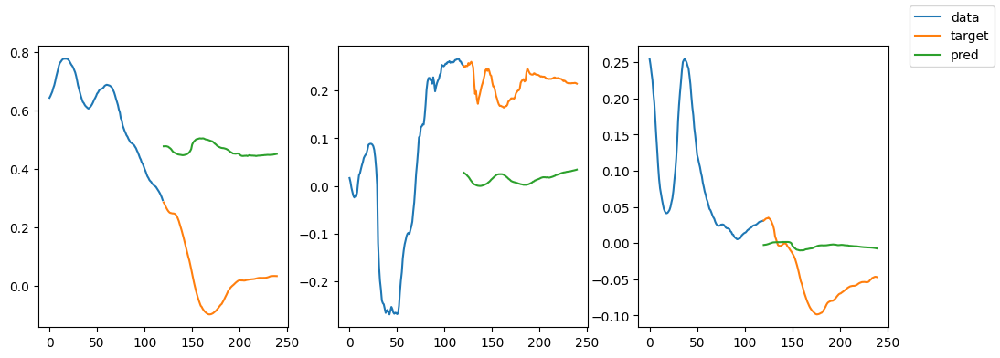

| epoch  47 |   222/  373 batches | lr 0.00047 | ms/batch 11.46973 | loss 0.52682
training prediction


<Figure size 640x480 with 0 Axes>

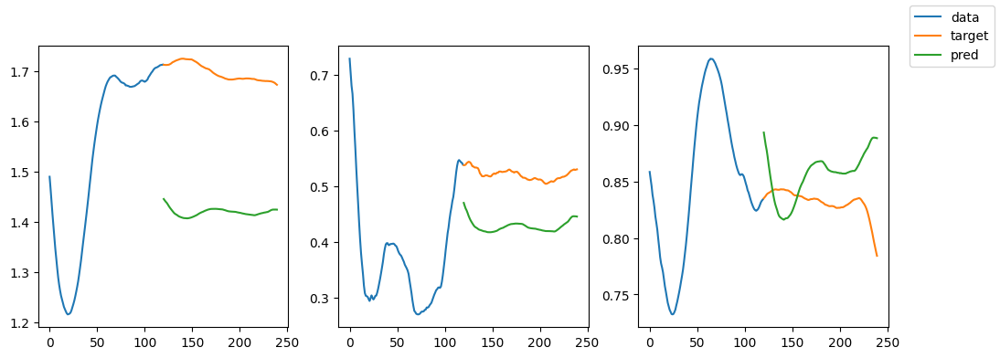

| epoch  47 |   296/  373 batches | lr 0.00047 | ms/batch 14.20344 | loss 0.51087
training prediction


<Figure size 640x480 with 0 Axes>

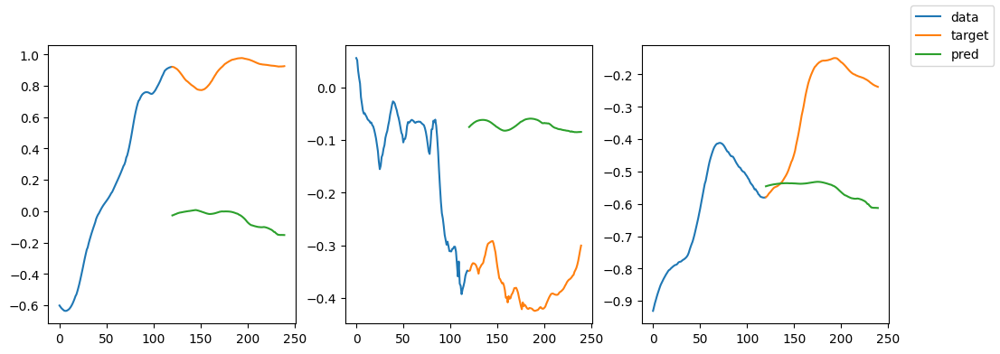

| epoch  47 |   370/  373 batches | lr 0.00047 | ms/batch 11.66869 | loss 0.53998
training prediction


<Figure size 640x480 with 0 Axes>

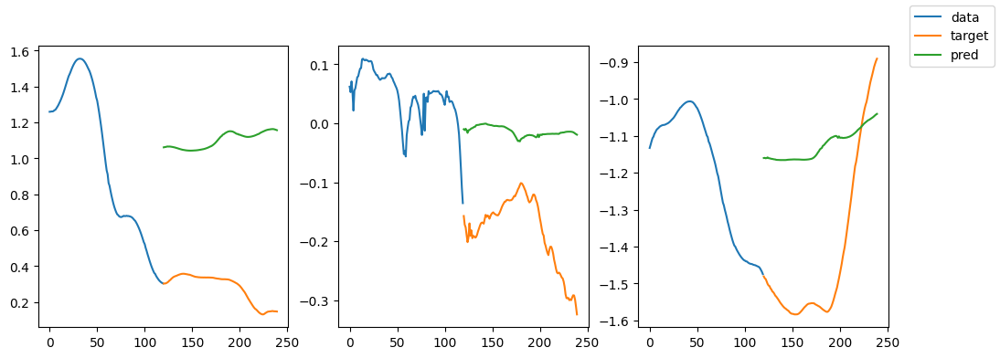

validation prediction


<Figure size 640x480 with 0 Axes>

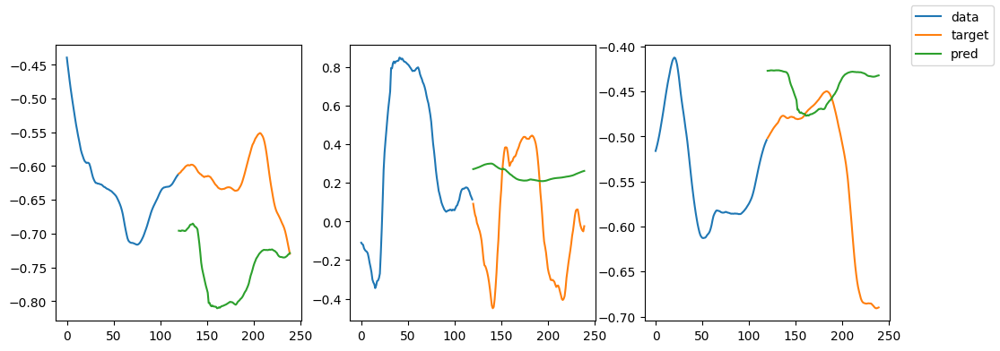

validation prediction


<Figure size 640x480 with 0 Axes>

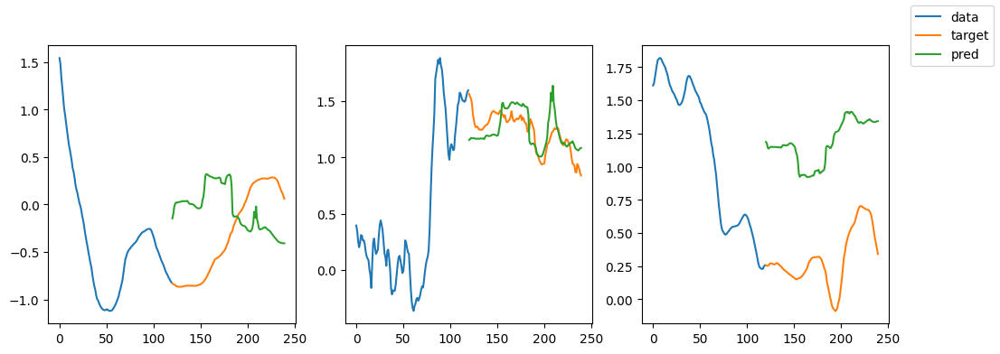

-----------------------------------------------------------------------------------------
| end of epoch  47 | time:  5.15s | valid loss 1.8202 | mean loss   0.5898
-----------------------------------------------------------------------------------------


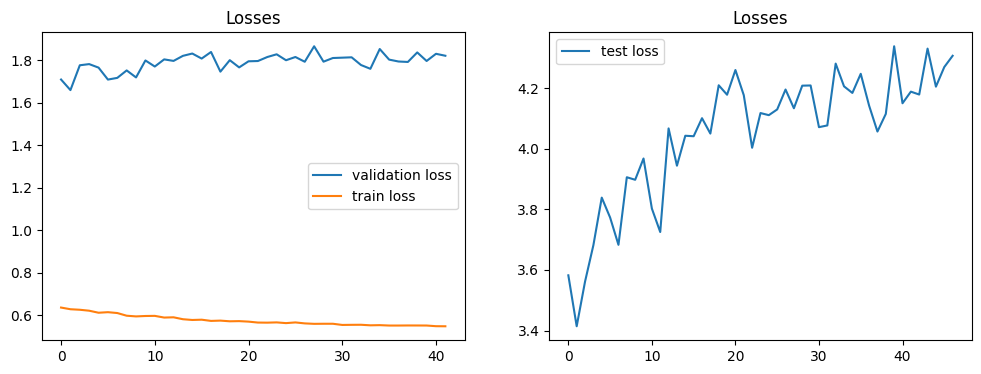

Epoch #48


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  48 |    74/  373 batches | lr 0.00045 | ms/batch 8.79626 | loss 0.55578
| epoch  48 |   148/  373 batches | lr 0.00045 | ms/batch 8.62707 | loss 0.50082
| epoch  48 |   222/  373 batches | lr 0.00045 | ms/batch 8.63516 | loss 0.54440
| epoch  48 |   296/  373 batches | lr 0.00045 | ms/batch 8.61852 | loss 0.58908
| epoch  48 |   370/  373 batches | lr 0.00045 | ms/batch 8.71935 | loss 0.55888
-----------------------------------------------------------------------------------------
| end of epoch  48 | time:  3.46s | valid loss 1.8066 | mean loss   0.5889
-----------------------------------------------------------------------------------------
Epoch #49


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  49 |    74/  373 batches | lr 0.00043 | ms/batch 8.76915 | loss 0.55320
training prediction


<Figure size 640x480 with 0 Axes>

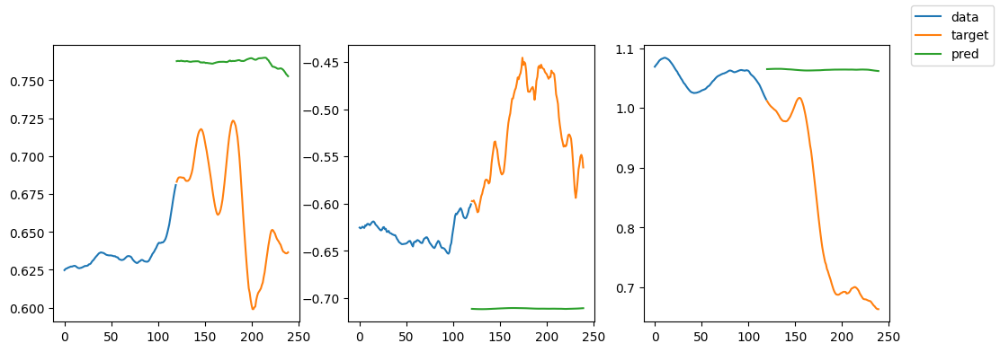

| epoch  49 |   148/  373 batches | lr 0.00043 | ms/batch 11.38189 | loss 0.49657
training prediction


<Figure size 640x480 with 0 Axes>

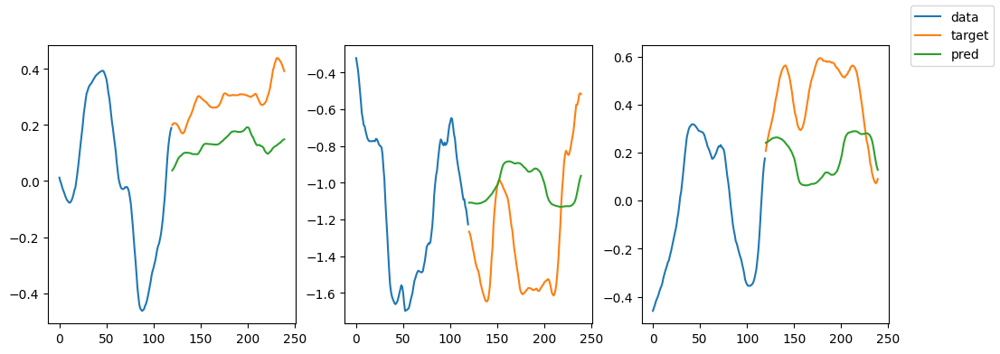

| epoch  49 |   222/  373 batches | lr 0.00043 | ms/batch 11.38262 | loss 0.60367
training prediction


<Figure size 640x480 with 0 Axes>

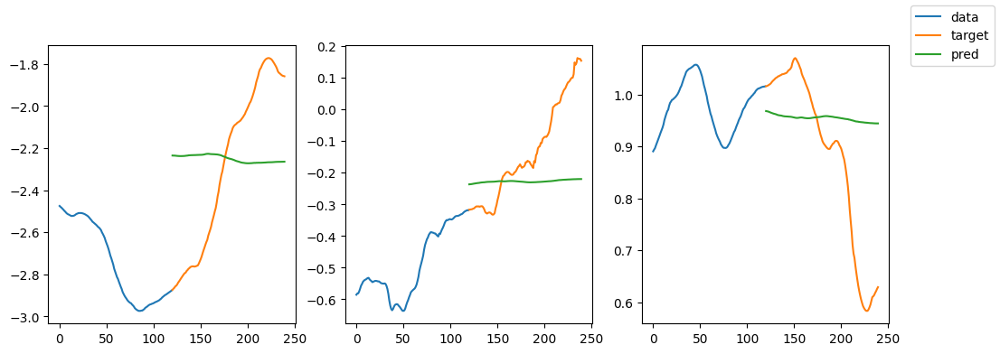

| epoch  49 |   296/  373 batches | lr 0.00043 | ms/batch 11.53326 | loss 0.56723
training prediction


<Figure size 640x480 with 0 Axes>

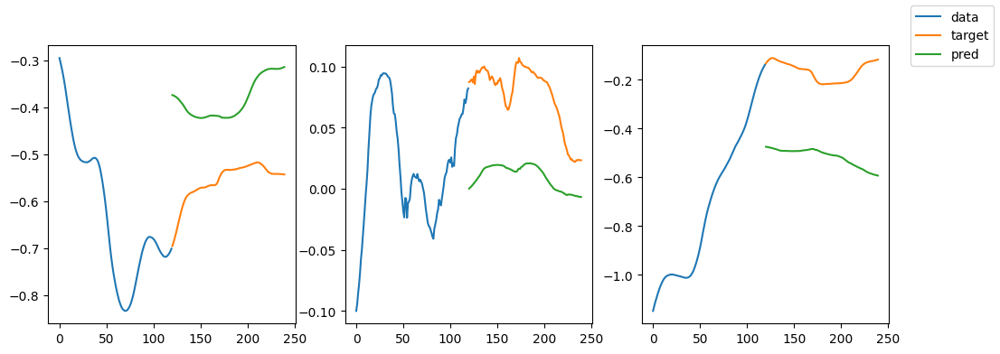

| epoch  49 |   370/  373 batches | lr 0.00043 | ms/batch 11.36650 | loss 0.52573
training prediction


<Figure size 640x480 with 0 Axes>

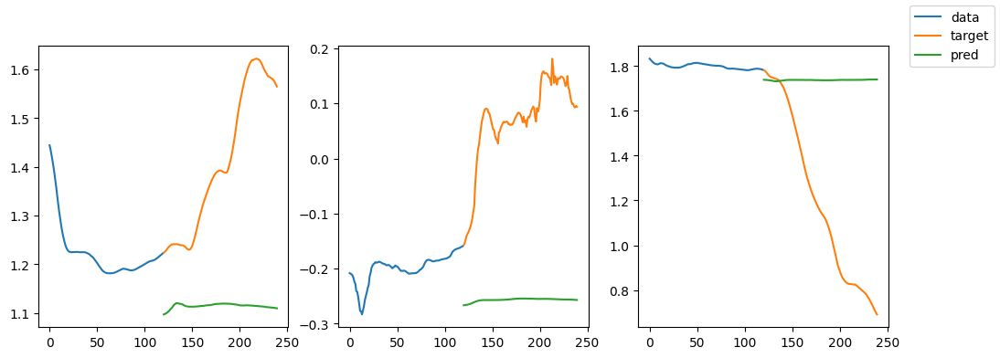

validation prediction


<Figure size 640x480 with 0 Axes>

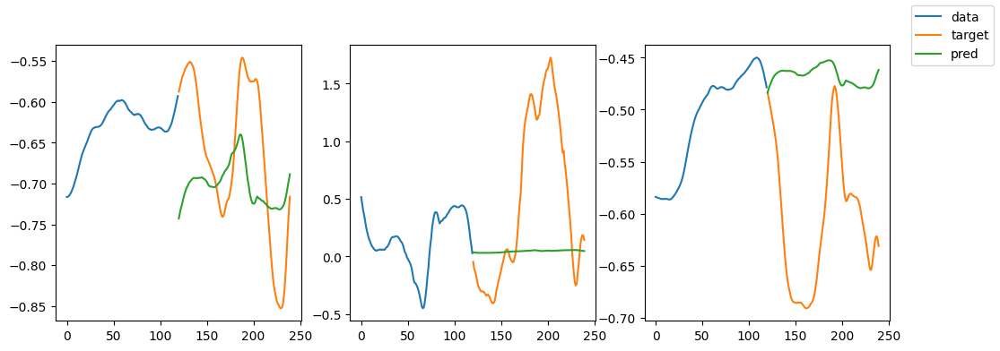

validation prediction


<Figure size 640x480 with 0 Axes>

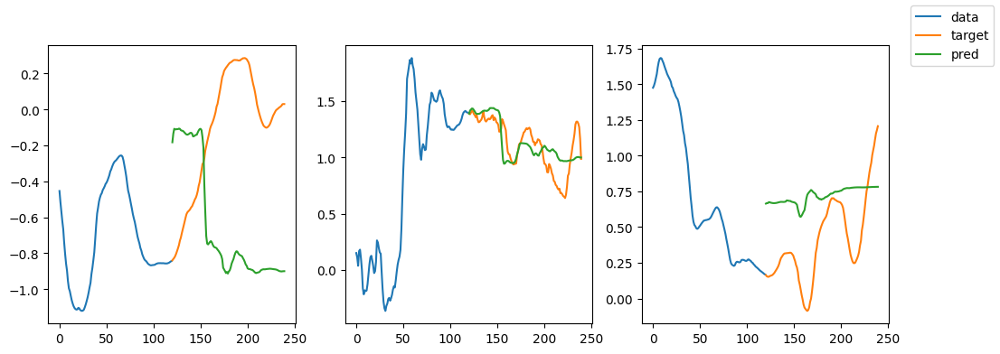

-----------------------------------------------------------------------------------------
| end of epoch  49 | time:  5.09s | valid loss 1.8027 | mean loss   0.5881
-----------------------------------------------------------------------------------------


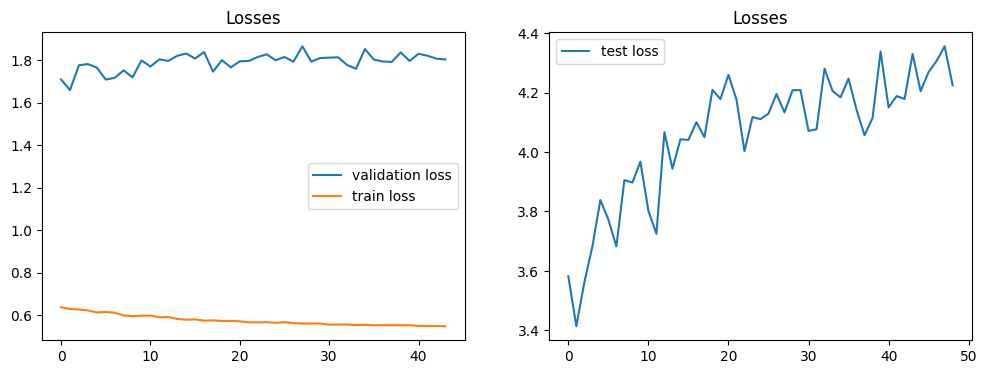

Epoch #50


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  50 |    74/  373 batches | lr 0.00040 | ms/batch 8.94743 | loss 0.59442
| epoch  50 |   148/  373 batches | lr 0.00040 | ms/batch 8.74795 | loss 0.47387
| epoch  50 |   222/  373 batches | lr 0.00040 | ms/batch 8.63992 | loss 0.60195
| epoch  50 |   296/  373 batches | lr 0.00040 | ms/batch 8.63534 | loss 0.58048
| epoch  50 |   370/  373 batches | lr 0.00040 | ms/batch 8.68187 | loss 0.49241
-----------------------------------------------------------------------------------------
| end of epoch  50 | time:  3.47s | valid loss 1.8577 | mean loss   0.5873
-----------------------------------------------------------------------------------------
Epoch #51


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  51 |    74/  373 batches | lr 0.00038 | ms/batch 8.78765 | loss 0.55387
training prediction


<Figure size 640x480 with 0 Axes>

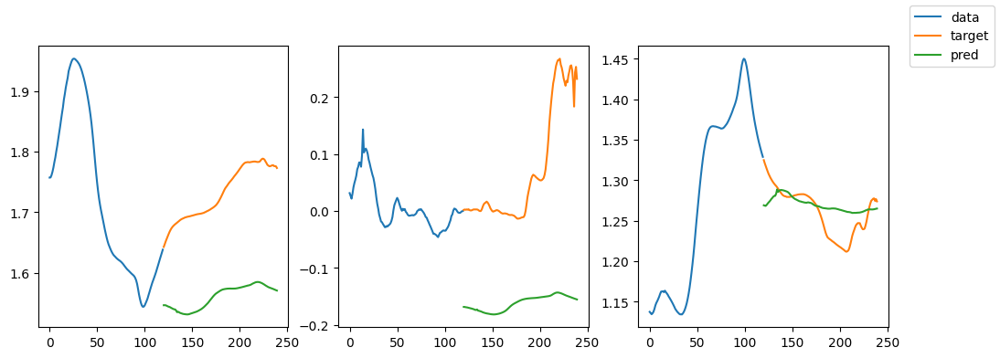

| epoch  51 |   148/  373 batches | lr 0.00038 | ms/batch 11.40189 | loss 0.49071
training prediction


<Figure size 640x480 with 0 Axes>

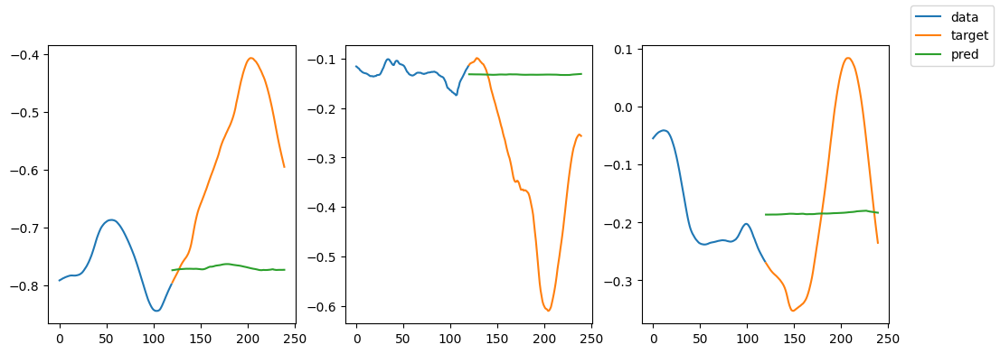

| epoch  51 |   222/  373 batches | lr 0.00038 | ms/batch 11.34042 | loss 0.52889
training prediction


<Figure size 640x480 with 0 Axes>

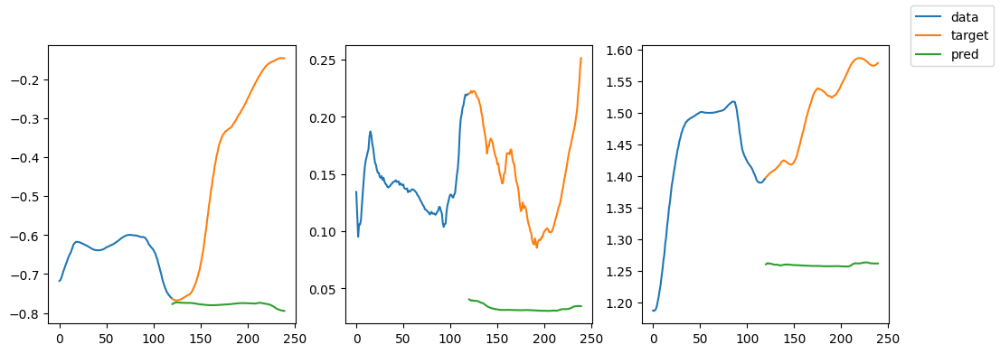

| epoch  51 |   296/  373 batches | lr 0.00038 | ms/batch 11.48321 | loss 0.63015
training prediction


<Figure size 640x480 with 0 Axes>

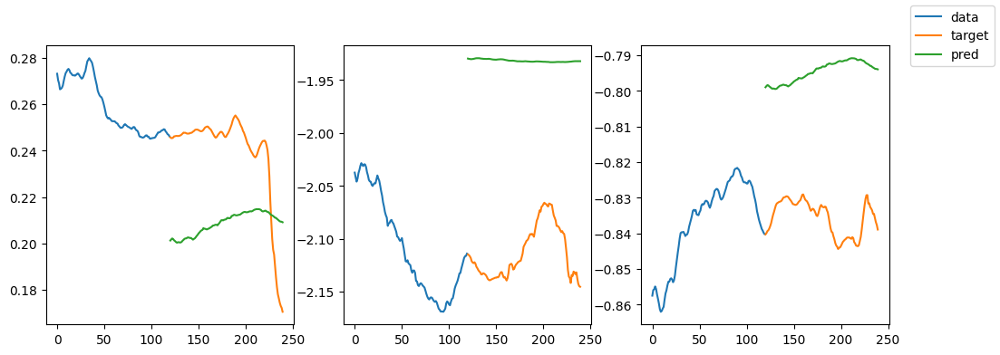

| epoch  51 |   370/  373 batches | lr 0.00038 | ms/batch 11.49660 | loss 0.52952
training prediction


<Figure size 640x480 with 0 Axes>

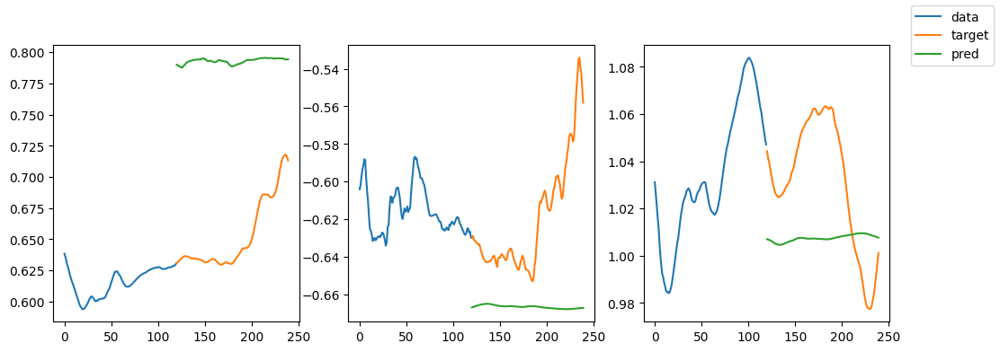

validation prediction


<Figure size 640x480 with 0 Axes>

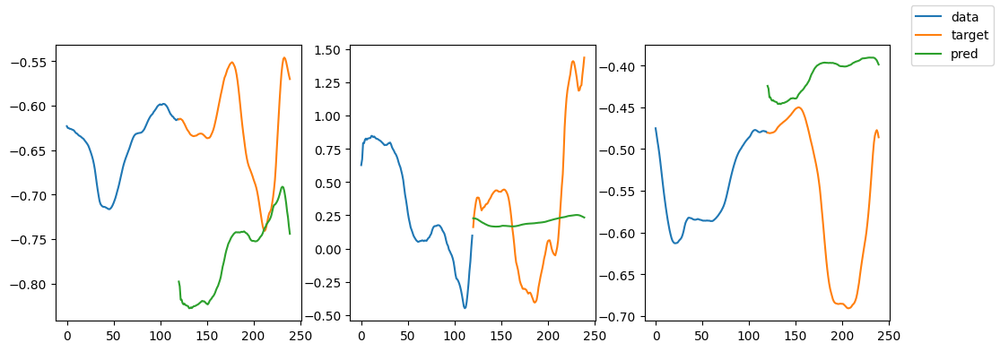

validation prediction


<Figure size 640x480 with 0 Axes>

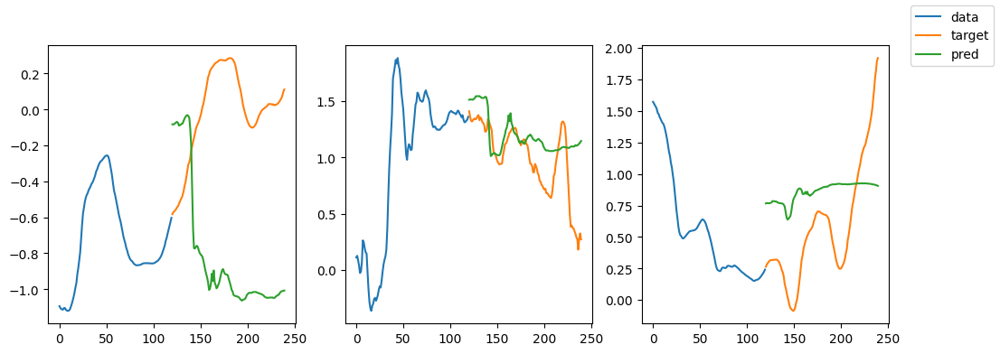

-----------------------------------------------------------------------------------------
| end of epoch  51 | time:  4.91s | valid loss 1.7952 | mean loss   0.5864
-----------------------------------------------------------------------------------------


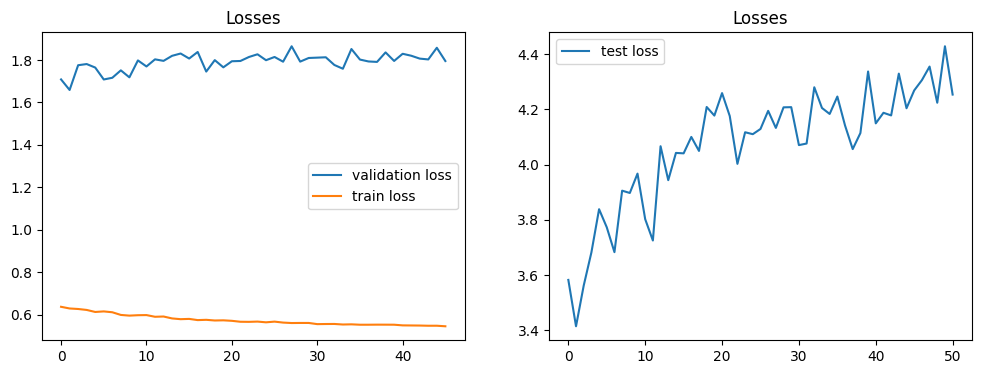

Epoch #52


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  52 |    74/  373 batches | lr 0.00037 | ms/batch 8.76526 | loss 0.51508
| epoch  52 |   148/  373 batches | lr 0.00037 | ms/batch 8.69246 | loss 0.52016
| epoch  52 |   222/  373 batches | lr 0.00037 | ms/batch 8.61135 | loss 0.59075
| epoch  52 |   296/  373 batches | lr 0.00037 | ms/batch 8.59564 | loss 0.48964
| epoch  52 |   370/  373 batches | lr 0.00037 | ms/batch 8.64228 | loss 0.61778
-----------------------------------------------------------------------------------------
| end of epoch  52 | time:  3.44s | valid loss 1.8117 | mean loss   0.5856
-----------------------------------------------------------------------------------------
Epoch #53


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  53 |    74/  373 batches | lr 0.00035 | ms/batch 8.75927 | loss 0.53521
training prediction


<Figure size 640x480 with 0 Axes>

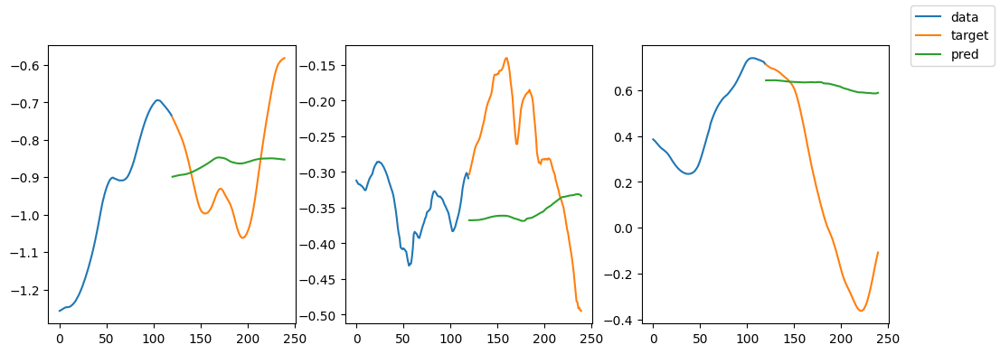

| epoch  53 |   148/  373 batches | lr 0.00035 | ms/batch 14.11644 | loss 0.58449
training prediction


<Figure size 640x480 with 0 Axes>

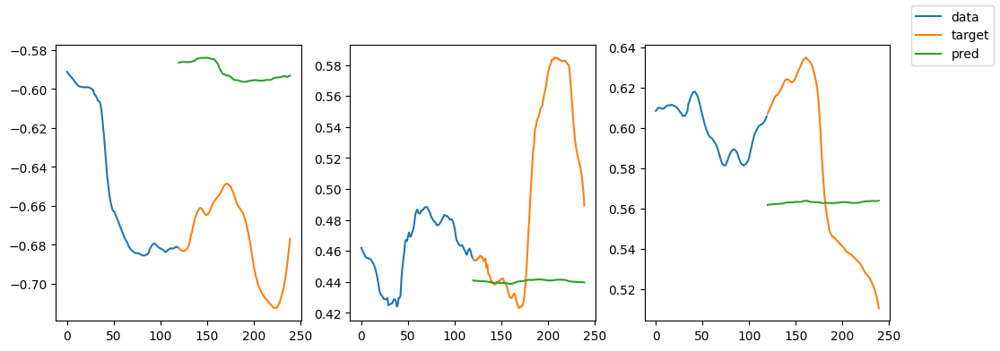

| epoch  53 |   222/  373 batches | lr 0.00035 | ms/batch 11.65919 | loss 0.57583
training prediction


<Figure size 640x480 with 0 Axes>

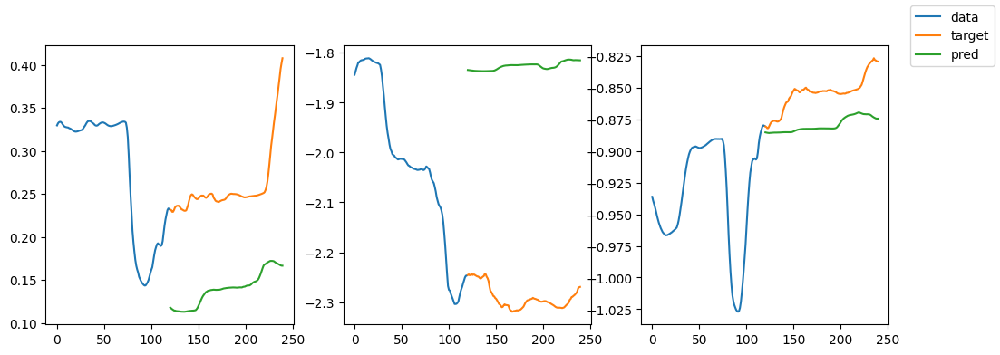

| epoch  53 |   296/  373 batches | lr 0.00035 | ms/batch 11.61167 | loss 0.53372
training prediction


<Figure size 640x480 with 0 Axes>

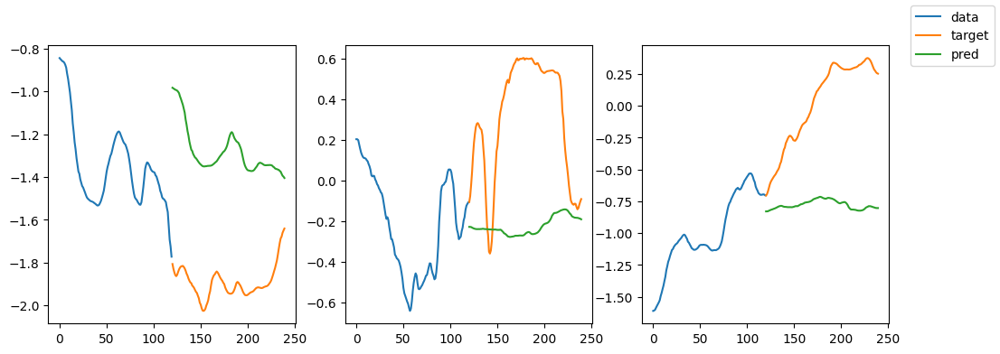

| epoch  53 |   370/  373 batches | lr 0.00035 | ms/batch 11.53739 | loss 0.49748
training prediction


<Figure size 640x480 with 0 Axes>

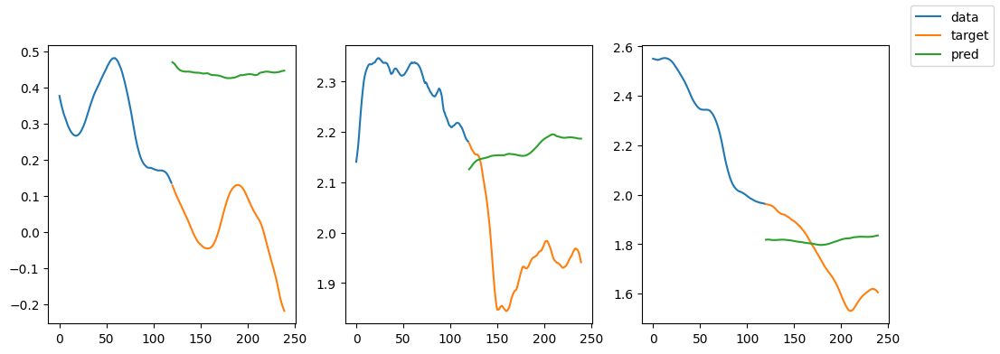

validation prediction


<Figure size 640x480 with 0 Axes>

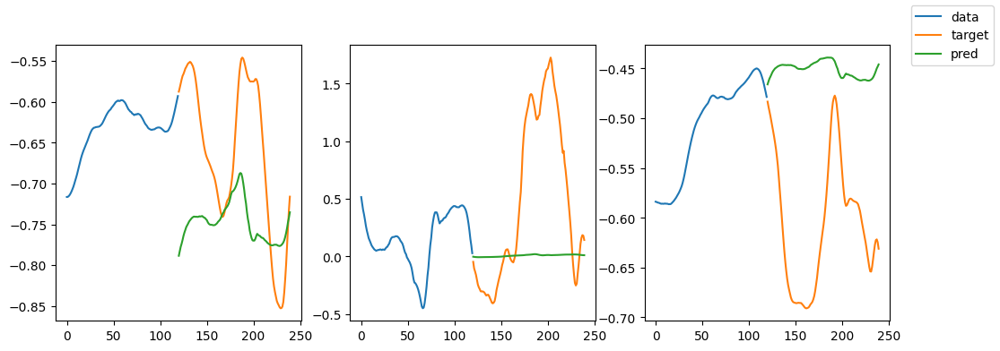

validation prediction


<Figure size 640x480 with 0 Axes>

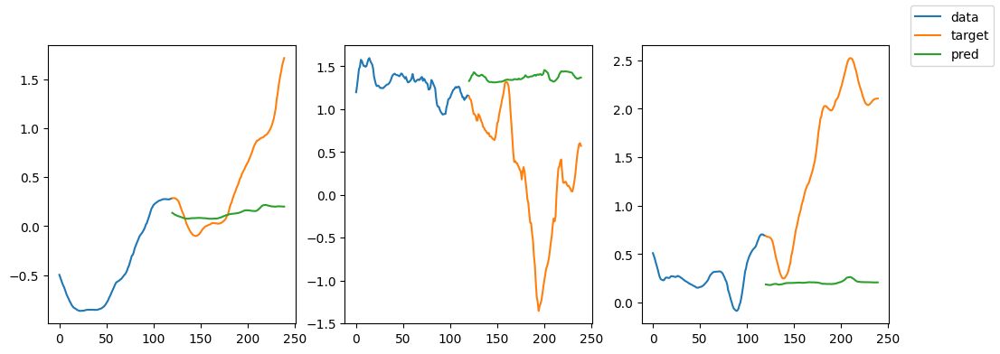

-----------------------------------------------------------------------------------------
| end of epoch  53 | time:  5.12s | valid loss 1.8181 | mean loss   0.5848
-----------------------------------------------------------------------------------------


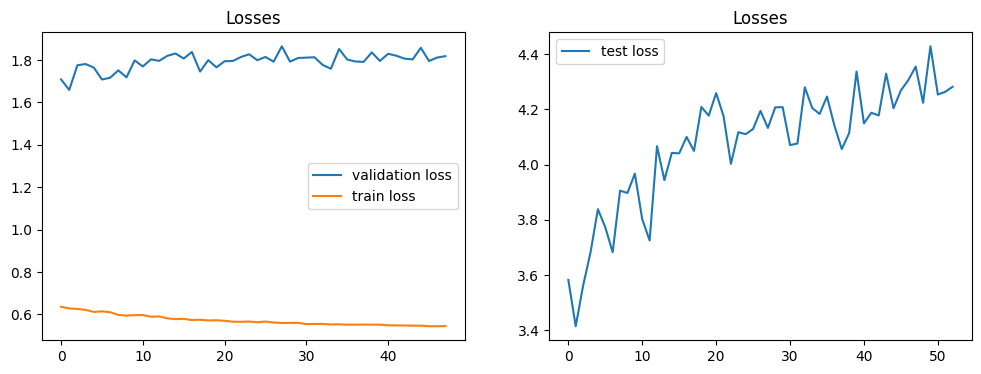

Epoch #54


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  54 |    74/  373 batches | lr 0.00033 | ms/batch 8.81377 | loss 0.52058
| epoch  54 |   148/  373 batches | lr 0.00033 | ms/batch 8.94671 | loss 0.54176
| epoch  54 |   222/  373 batches | lr 0.00033 | ms/batch 8.62027 | loss 0.57847
| epoch  54 |   296/  373 batches | lr 0.00033 | ms/batch 8.63595 | loss 0.48912
| epoch  54 |   370/  373 batches | lr 0.00033 | ms/batch 8.74186 | loss 0.59925
-----------------------------------------------------------------------------------------
| end of epoch  54 | time:  3.48s | valid loss 1.7984 | mean loss   0.5841
-----------------------------------------------------------------------------------------
Epoch #55


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  55 |    74/  373 batches | lr 0.00031 | ms/batch 8.76030 | loss 0.53647
training prediction


<Figure size 640x480 with 0 Axes>

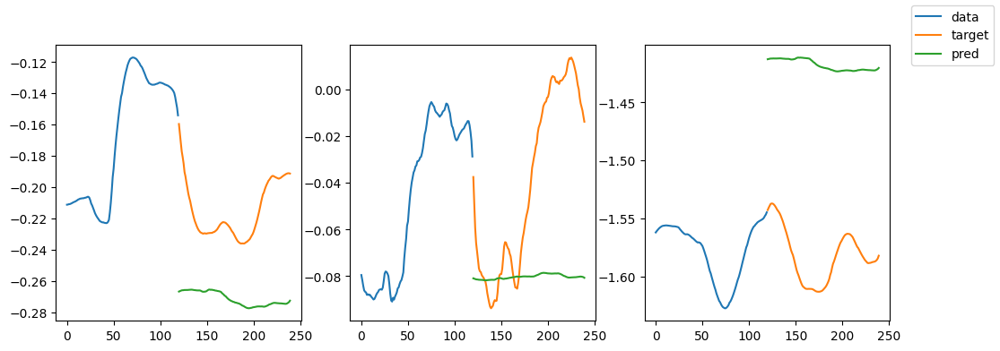

| epoch  55 |   148/  373 batches | lr 0.00031 | ms/batch 11.37173 | loss 0.61370
training prediction


<Figure size 640x480 with 0 Axes>

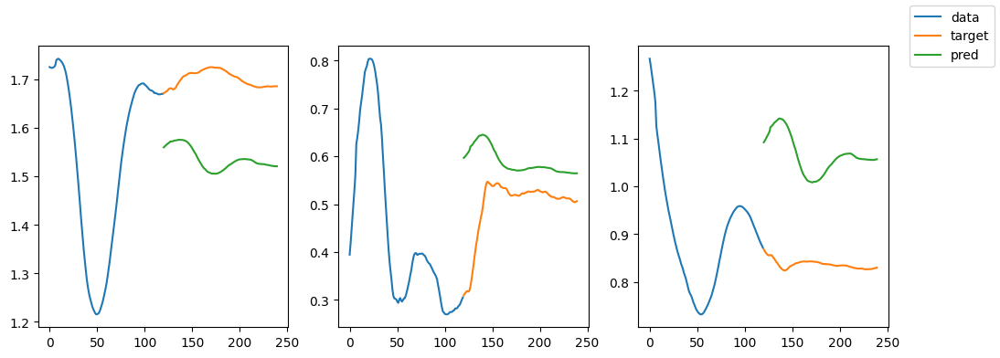

| epoch  55 |   222/  373 batches | lr 0.00031 | ms/batch 11.31098 | loss 0.51990
training prediction


<Figure size 640x480 with 0 Axes>

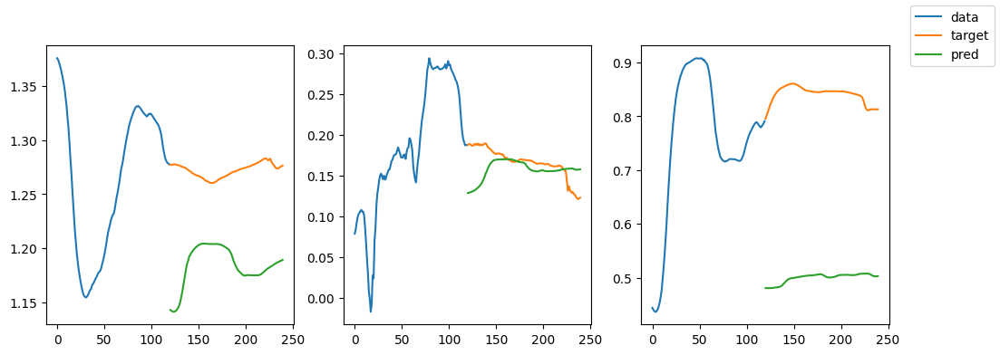

| epoch  55 |   296/  373 batches | lr 0.00031 | ms/batch 11.29067 | loss 0.50458
training prediction


<Figure size 640x480 with 0 Axes>

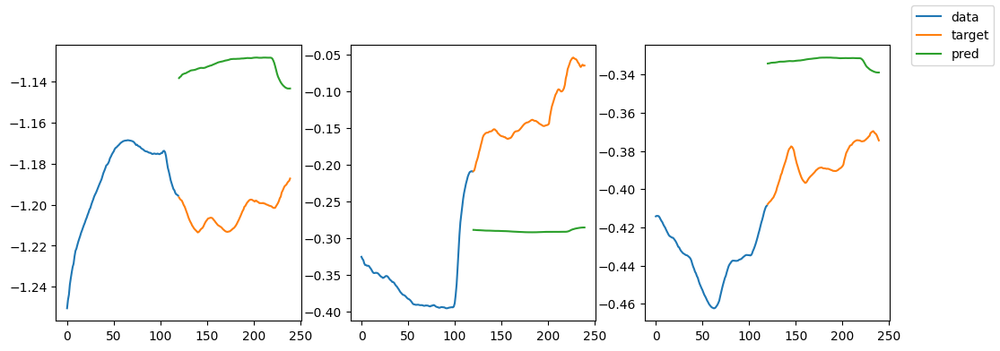

| epoch  55 |   370/  373 batches | lr 0.00031 | ms/batch 14.14091 | loss 0.55690
training prediction


<Figure size 640x480 with 0 Axes>

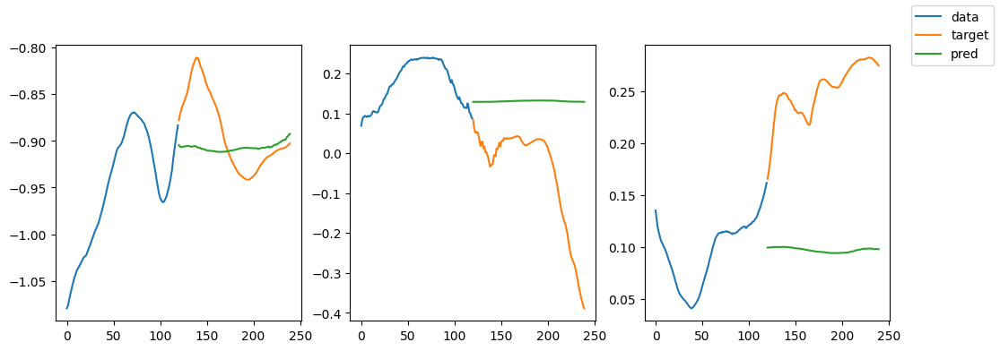

validation prediction


<Figure size 640x480 with 0 Axes>

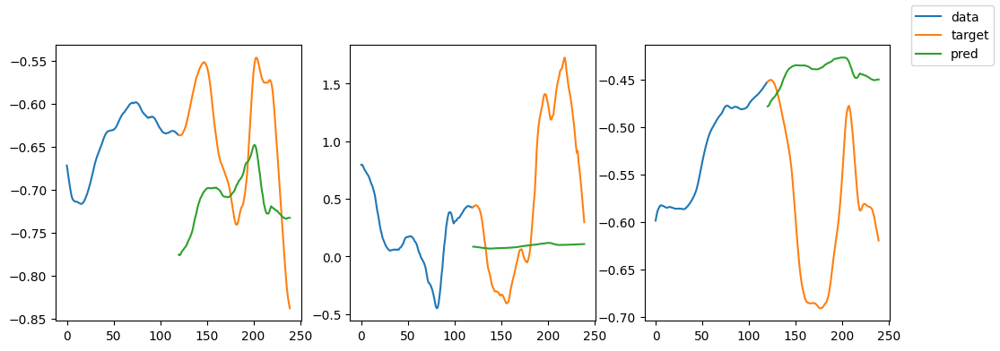

validation prediction


<Figure size 640x480 with 0 Axes>

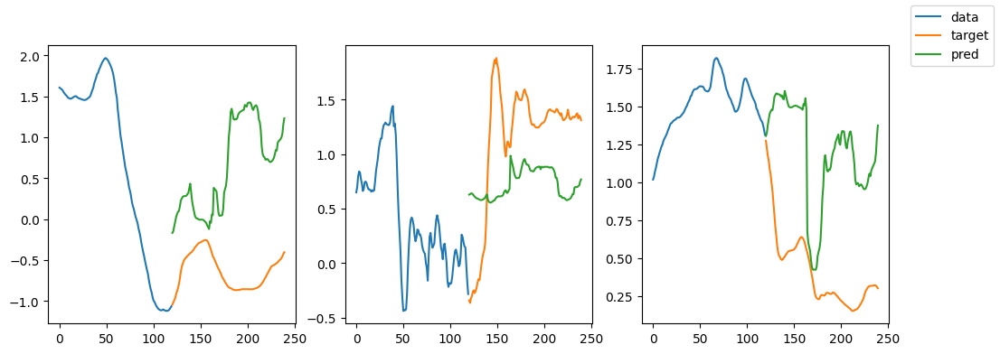

-----------------------------------------------------------------------------------------
| end of epoch  55 | time:  5.07s | valid loss 1.8007 | mean loss   0.5834
-----------------------------------------------------------------------------------------


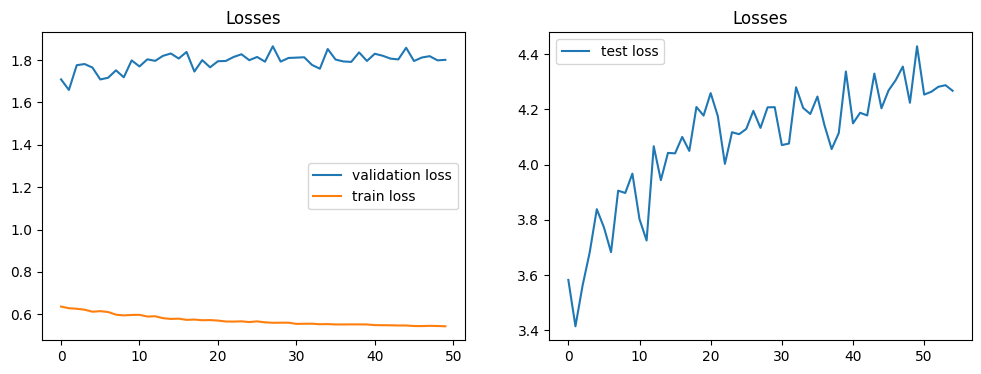

Epoch #56


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  56 |    74/  373 batches | lr 0.00030 | ms/batch 8.80010 | loss 0.55662
| epoch  56 |   148/  373 batches | lr 0.00030 | ms/batch 8.64192 | loss 0.57801
| epoch  56 |   222/  373 batches | lr 0.00030 | ms/batch 8.63713 | loss 0.58448
| epoch  56 |   296/  373 batches | lr 0.00030 | ms/batch 8.62819 | loss 0.47985
| epoch  56 |   370/  373 batches | lr 0.00030 | ms/batch 8.67438 | loss 0.53032
-----------------------------------------------------------------------------------------
| end of epoch  56 | time:  3.45s | valid loss 1.7898 | mean loss   0.5826
-----------------------------------------------------------------------------------------
Epoch #57


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  57 |    74/  373 batches | lr 0.00028 | ms/batch 8.83568 | loss 0.60245
training prediction


<Figure size 640x480 with 0 Axes>

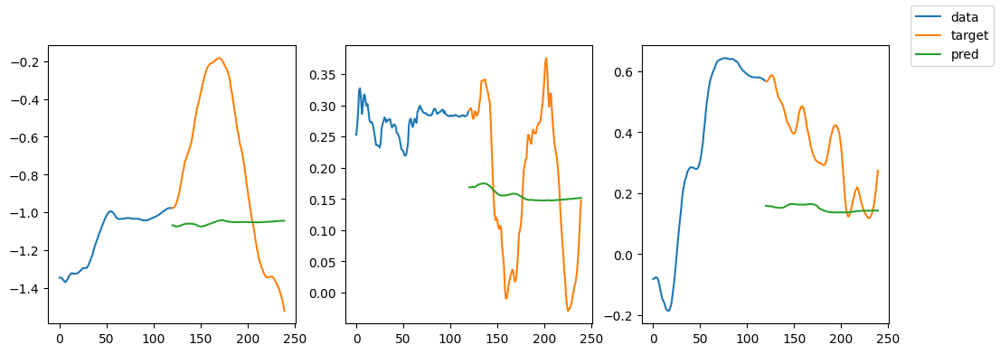

| epoch  57 |   148/  373 batches | lr 0.00028 | ms/batch 11.65132 | loss 0.52323
training prediction


<Figure size 640x480 with 0 Axes>

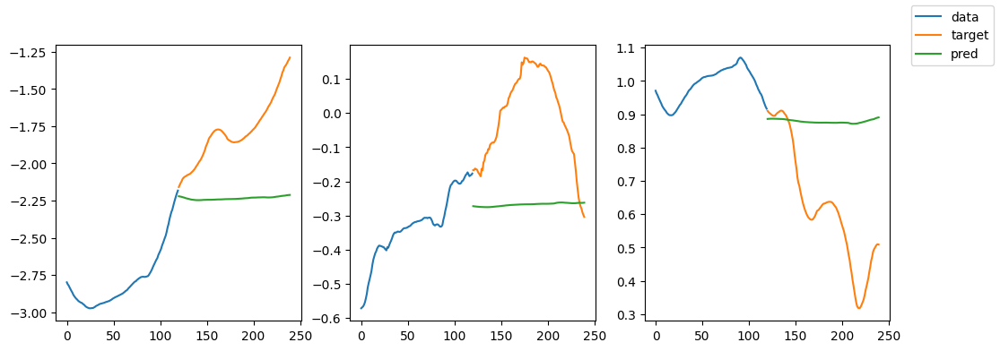

| epoch  57 |   222/  373 batches | lr 0.00028 | ms/batch 11.59960 | loss 0.55960
training prediction


<Figure size 640x480 with 0 Axes>

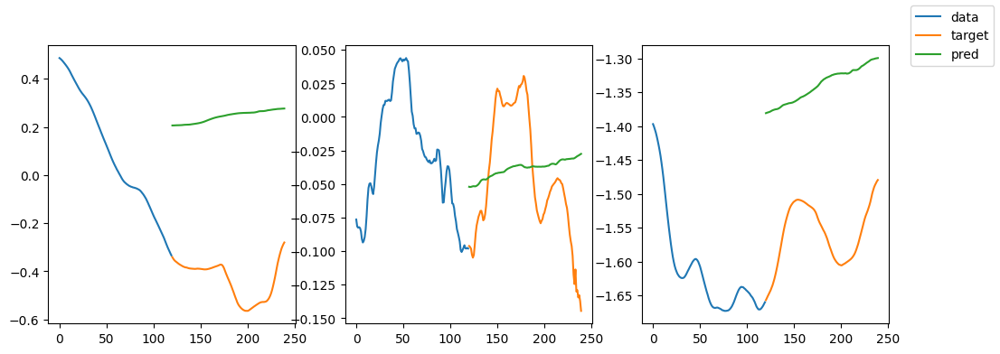

| epoch  57 |   296/  373 batches | lr 0.00028 | ms/batch 11.59611 | loss 0.53155
training prediction


<Figure size 640x480 with 0 Axes>

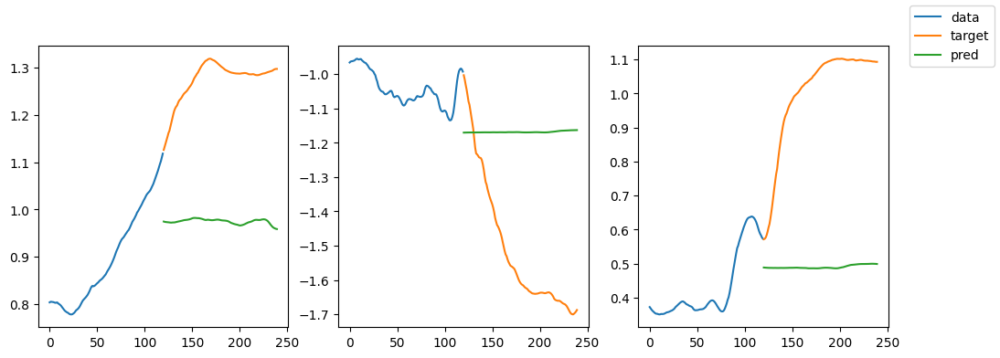

| epoch  57 |   370/  373 batches | lr 0.00028 | ms/batch 11.45280 | loss 0.50240
training prediction


<Figure size 640x480 with 0 Axes>

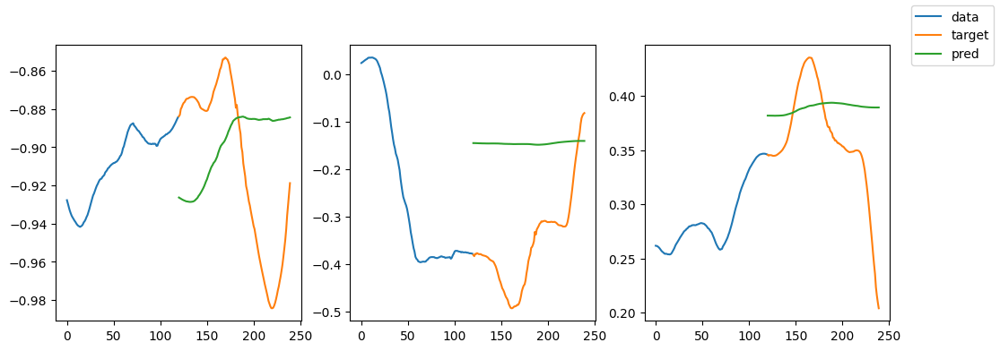

validation prediction


<Figure size 640x480 with 0 Axes>

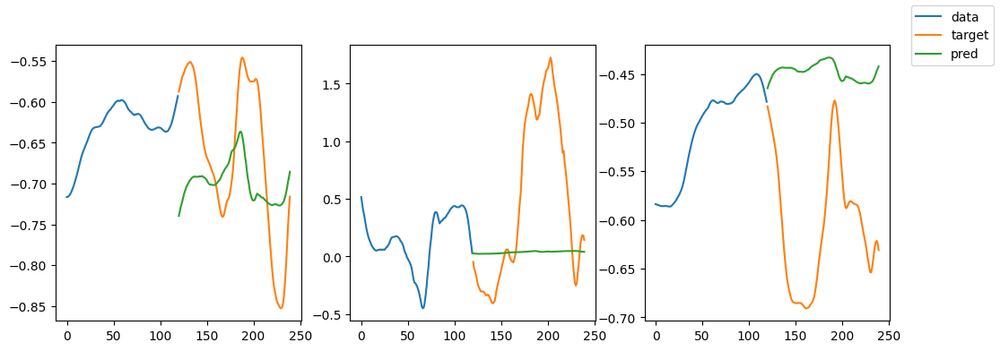

validation prediction


<Figure size 640x480 with 0 Axes>

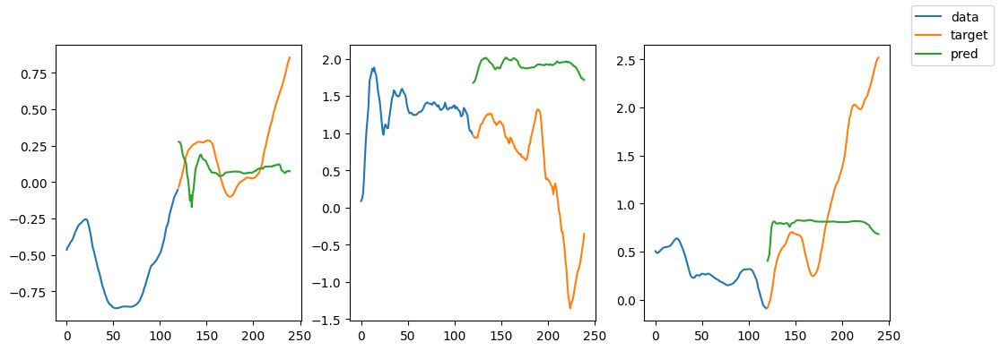

-----------------------------------------------------------------------------------------
| end of epoch  57 | time:  5.15s | valid loss 1.7983 | mean loss   0.5819
-----------------------------------------------------------------------------------------


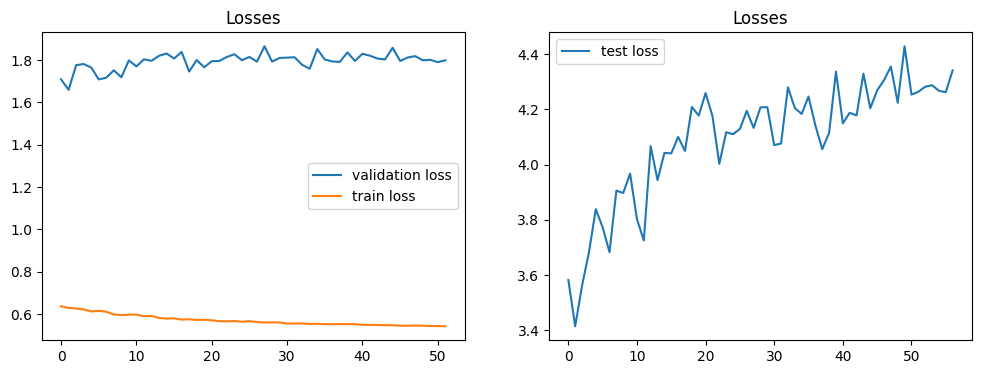

Epoch #58


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  58 |    74/  373 batches | lr 0.00027 | ms/batch 8.85494 | loss 0.53769
| epoch  58 |   148/  373 batches | lr 0.00027 | ms/batch 8.71636 | loss 0.62685
| epoch  58 |   222/  373 batches | lr 0.00027 | ms/batch 8.68225 | loss 0.51581
| epoch  58 |   296/  373 batches | lr 0.00027 | ms/batch 8.68955 | loss 0.52606
| epoch  58 |   370/  373 batches | lr 0.00027 | ms/batch 8.70568 | loss 0.51488
-----------------------------------------------------------------------------------------
| end of epoch  58 | time:  3.47s | valid loss 1.8113 | mean loss   0.5812
-----------------------------------------------------------------------------------------
Epoch #59


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  59 |    74/  373 batches | lr 0.00026 | ms/batch 8.86611 | loss 0.50827
training prediction


<Figure size 640x480 with 0 Axes>

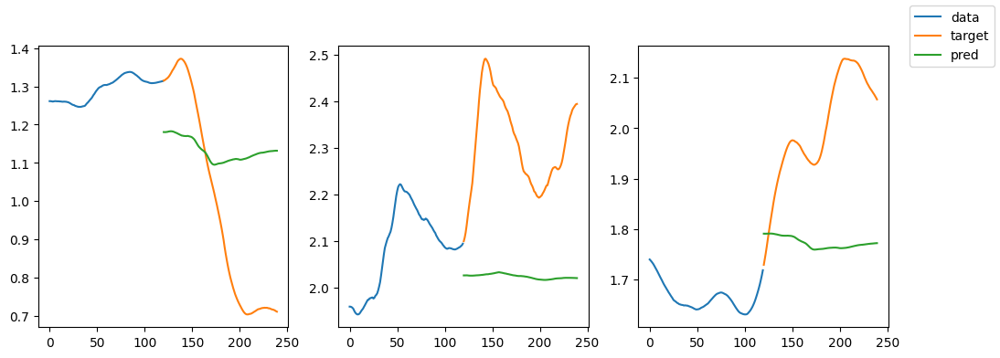

| epoch  59 |   148/  373 batches | lr 0.00026 | ms/batch 11.46268 | loss 0.55684
training prediction


<Figure size 640x480 with 0 Axes>

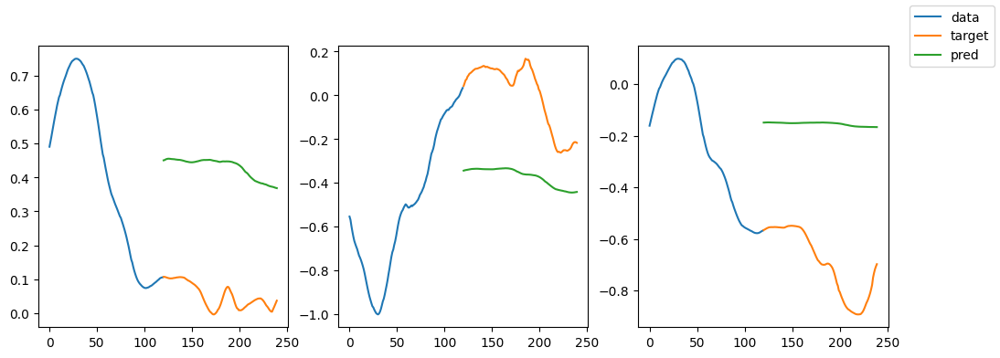

| epoch  59 |   222/  373 batches | lr 0.00026 | ms/batch 11.45343 | loss 0.51377
training prediction


<Figure size 640x480 with 0 Axes>

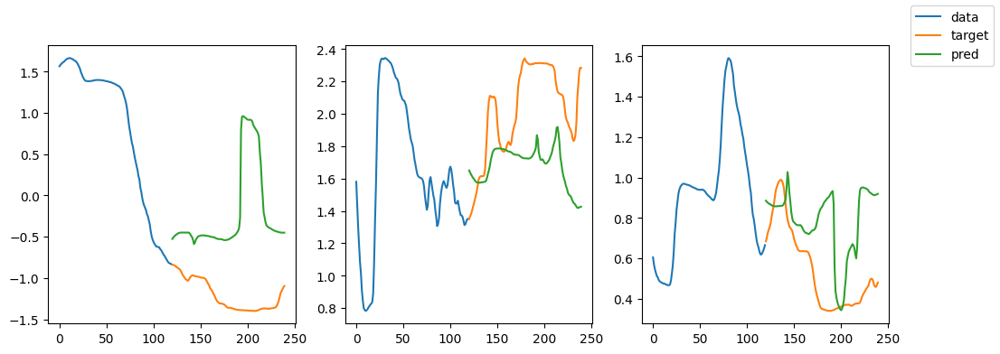

| epoch  59 |   296/  373 batches | lr 0.00026 | ms/batch 11.53872 | loss 0.59399
training prediction


<Figure size 640x480 with 0 Axes>

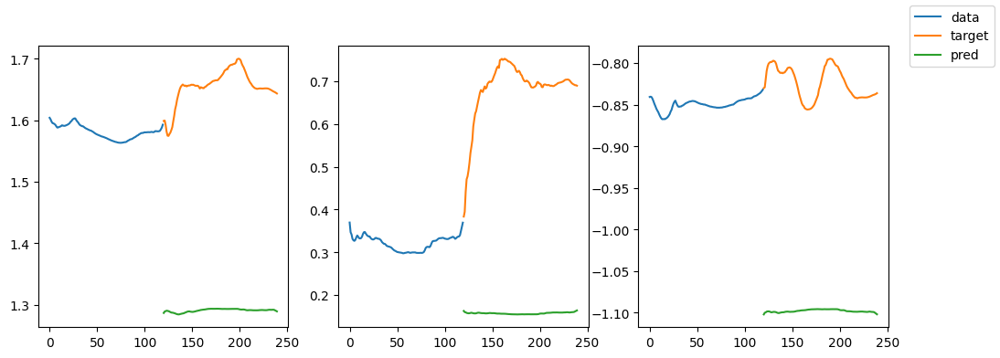

| epoch  59 |   370/  373 batches | lr 0.00026 | ms/batch 11.40979 | loss 0.55311
training prediction


<Figure size 640x480 with 0 Axes>

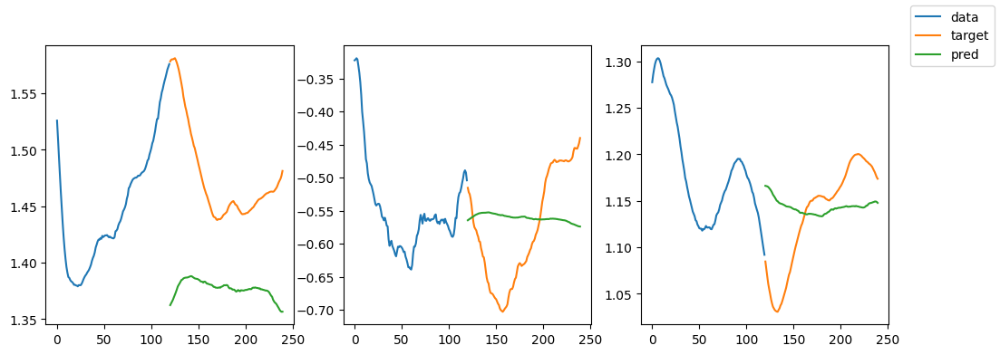

validation prediction


<Figure size 640x480 with 0 Axes>

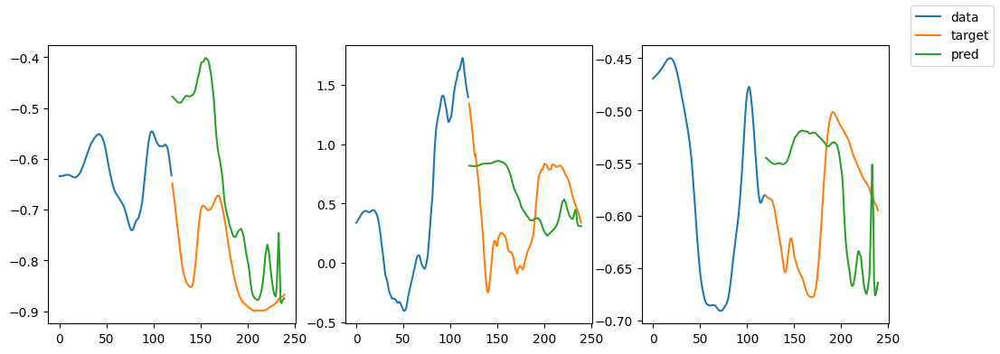

validation prediction


<Figure size 640x480 with 0 Axes>

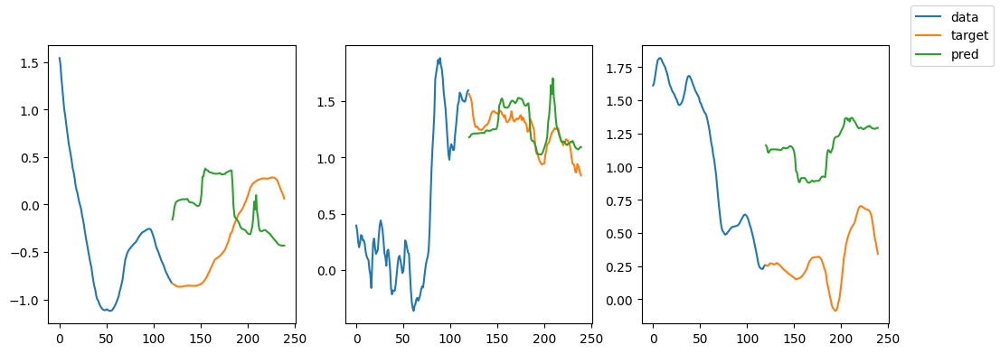

-----------------------------------------------------------------------------------------
| end of epoch  59 | time:  4.90s | valid loss 1.8089 | mean loss   0.5806
-----------------------------------------------------------------------------------------


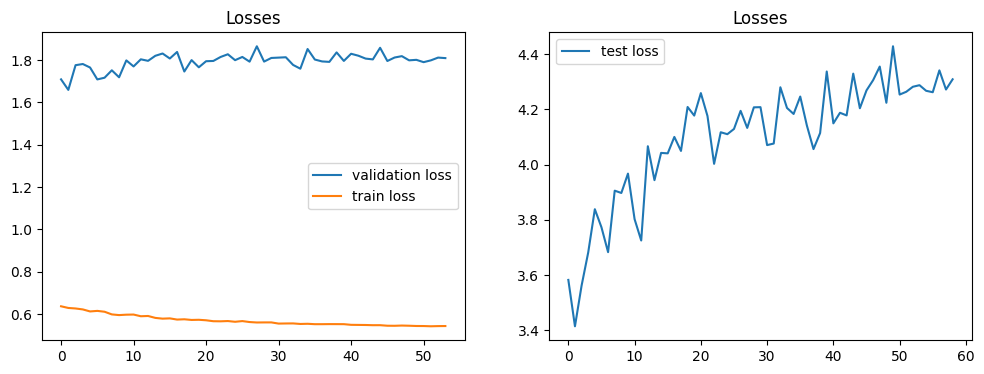

Epoch #60


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  60 |    74/  373 batches | lr 0.00024 | ms/batch 8.76678 | loss 0.56418
| epoch  60 |   148/  373 batches | lr 0.00024 | ms/batch 8.72651 | loss 0.52952
| epoch  60 |   222/  373 batches | lr 0.00024 | ms/batch 8.64515 | loss 0.56477
| epoch  60 |   296/  373 batches | lr 0.00024 | ms/batch 8.60654 | loss 0.52316
| epoch  60 |   370/  373 batches | lr 0.00024 | ms/batch 8.64858 | loss 0.53318
-----------------------------------------------------------------------------------------
| end of epoch  60 | time:  3.45s | valid loss 1.7791 | mean loss   0.5799
-----------------------------------------------------------------------------------------
Epoch #61


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  61 |    74/  373 batches | lr 0.00023 | ms/batch 8.75196 | loss 0.58114
training prediction


<Figure size 640x480 with 0 Axes>

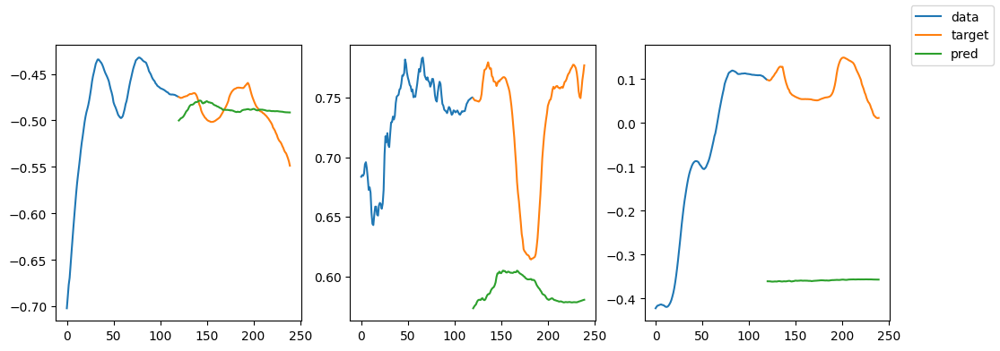

| epoch  61 |   148/  373 batches | lr 0.00023 | ms/batch 11.44273 | loss 0.49703
training prediction


<Figure size 640x480 with 0 Axes>

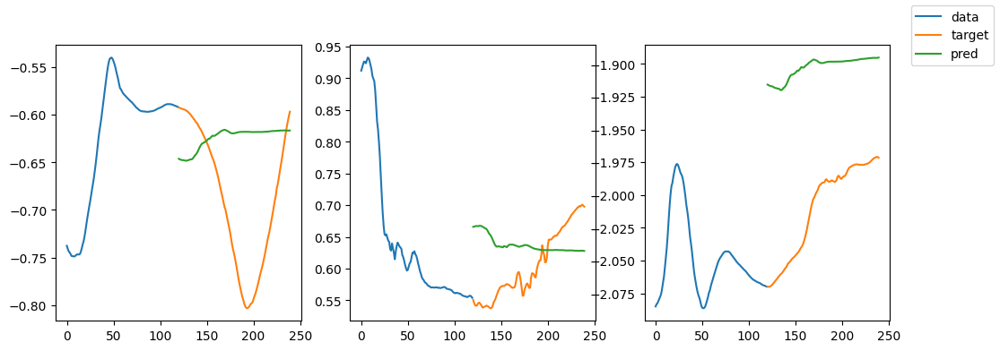

| epoch  61 |   222/  373 batches | lr 0.00023 | ms/batch 11.67169 | loss 0.60125
training prediction


<Figure size 640x480 with 0 Axes>

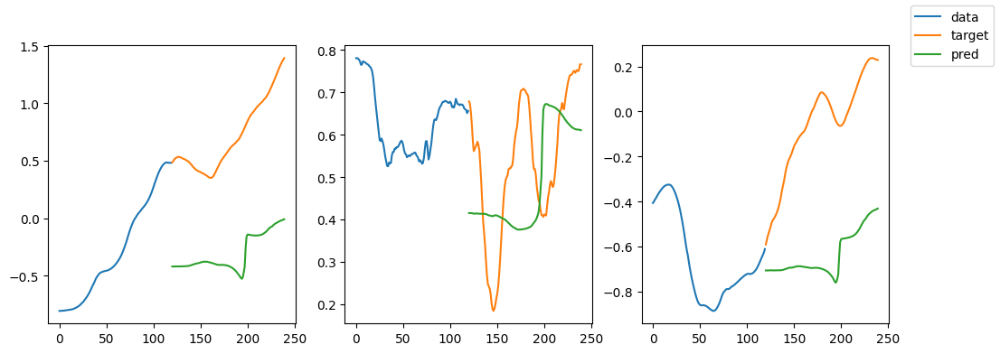

| epoch  61 |   296/  373 batches | lr 0.00023 | ms/batch 14.18432 | loss 0.50588
training prediction


<Figure size 640x480 with 0 Axes>

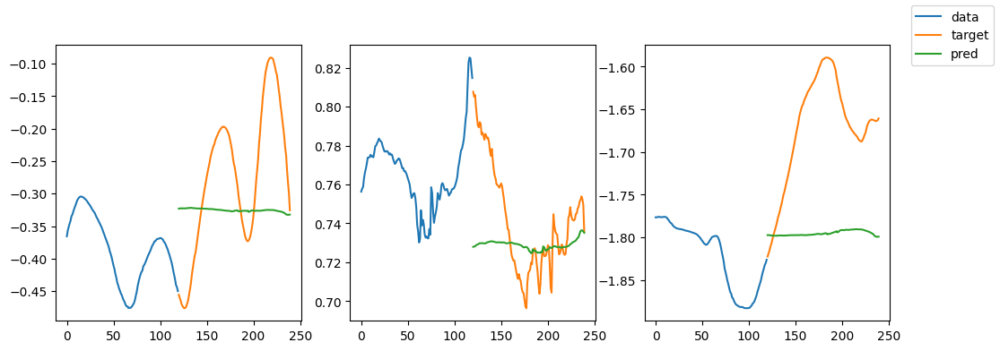

| epoch  61 |   370/  373 batches | lr 0.00023 | ms/batch 11.66038 | loss 0.52764
training prediction


<Figure size 640x480 with 0 Axes>

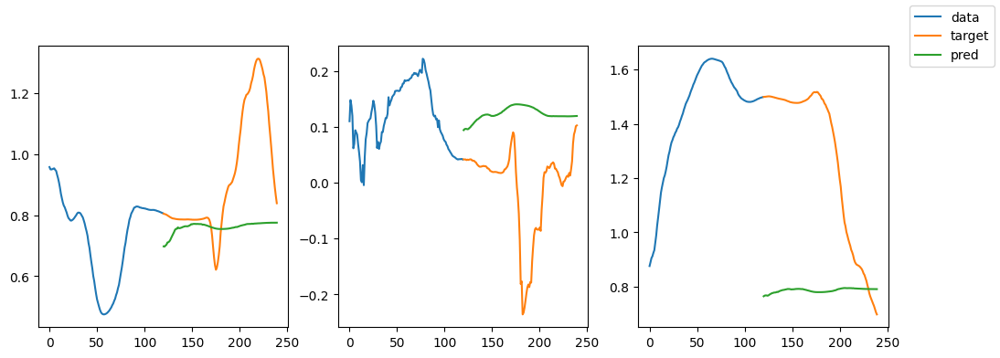

validation prediction


<Figure size 640x480 with 0 Axes>

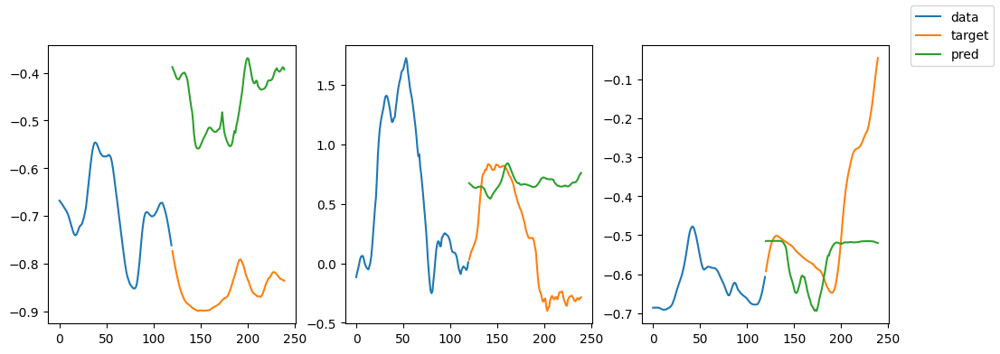

validation prediction


<Figure size 640x480 with 0 Axes>

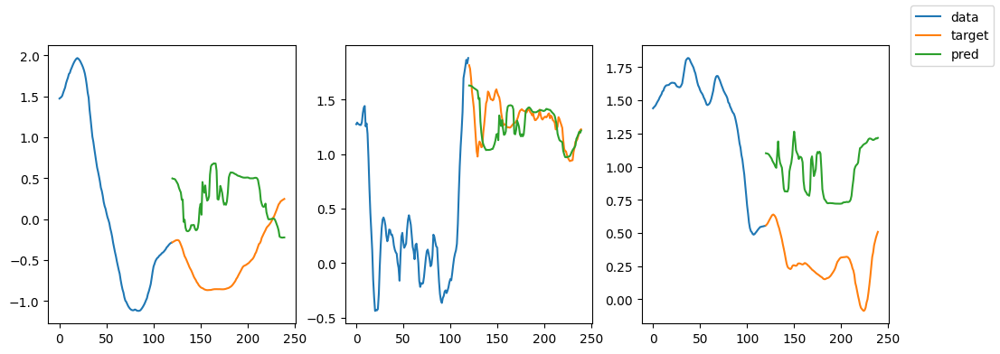

-----------------------------------------------------------------------------------------
| end of epoch  61 | time:  5.12s | valid loss 1.7886 | mean loss   0.5793
-----------------------------------------------------------------------------------------


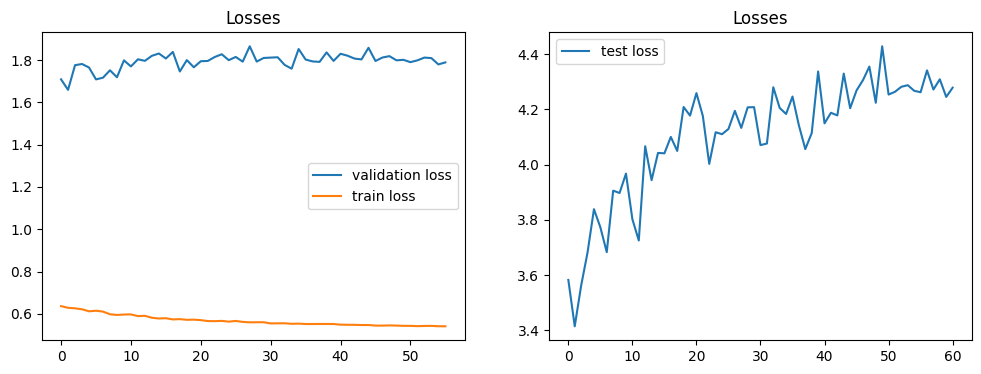

Epoch #62


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  62 |    74/  373 batches | lr 0.00022 | ms/batch 8.83090 | loss 0.56225
| epoch  62 |   148/  373 batches | lr 0.00022 | ms/batch 8.74241 | loss 0.50228
| epoch  62 |   222/  373 batches | lr 0.00022 | ms/batch 8.63576 | loss 0.51573
| epoch  62 |   296/  373 batches | lr 0.00022 | ms/batch 8.64915 | loss 0.54320
| epoch  62 |   370/  373 batches | lr 0.00022 | ms/batch 8.71757 | loss 0.59531
-----------------------------------------------------------------------------------------
| end of epoch  62 | time:  3.47s | valid loss 1.7928 | mean loss   0.5787
-----------------------------------------------------------------------------------------
Epoch #63


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  63 |    74/  373 batches | lr 0.00021 | ms/batch 8.76804 | loss 0.56916
training prediction


<Figure size 640x480 with 0 Axes>

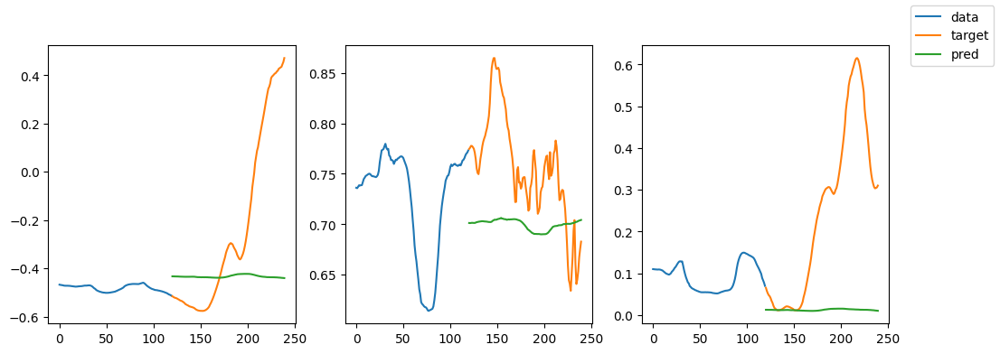

| epoch  63 |   148/  373 batches | lr 0.00021 | ms/batch 11.38003 | loss 0.55396
training prediction


<Figure size 640x480 with 0 Axes>

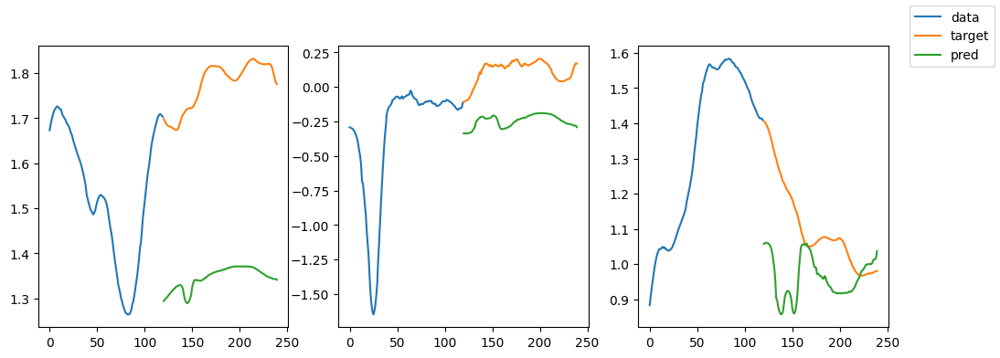

| epoch  63 |   222/  373 batches | lr 0.00021 | ms/batch 11.54914 | loss 0.55128
training prediction


<Figure size 640x480 with 0 Axes>

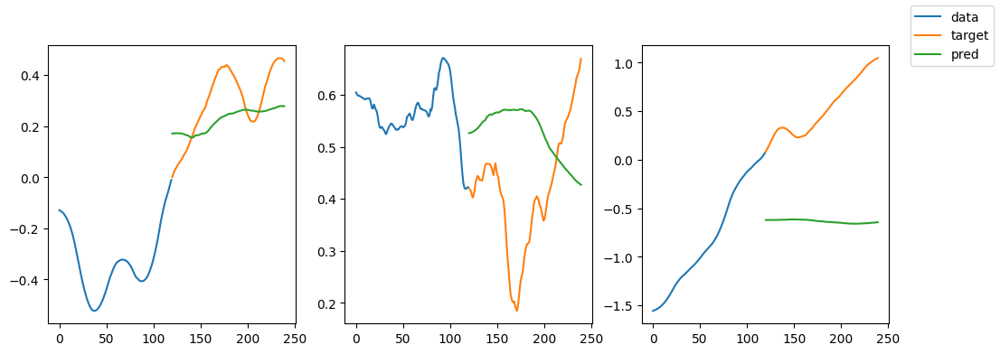

| epoch  63 |   296/  373 batches | lr 0.00021 | ms/batch 11.32422 | loss 0.53964
training prediction


<Figure size 640x480 with 0 Axes>

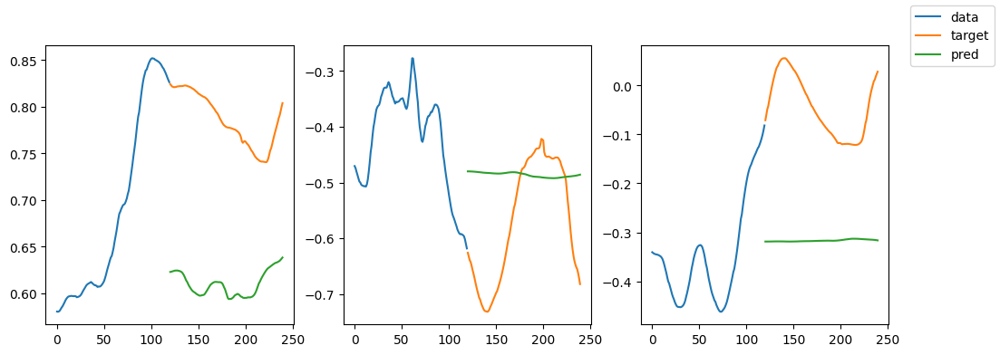

| epoch  63 |   370/  373 batches | lr 0.00021 | ms/batch 11.36721 | loss 0.49617
training prediction


<Figure size 640x480 with 0 Axes>

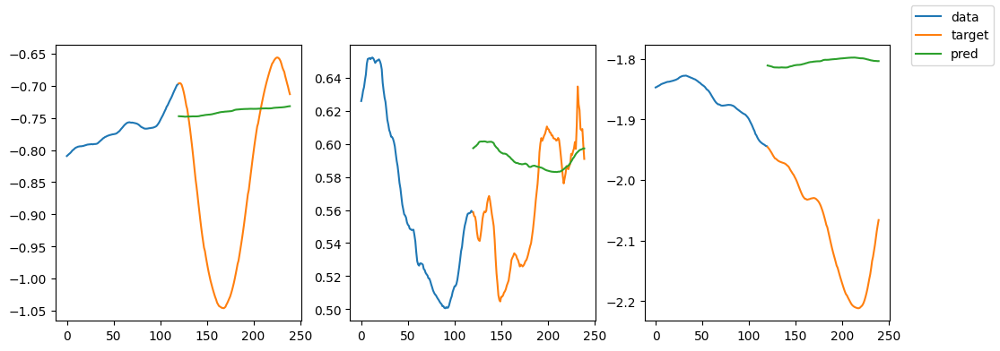

validation prediction


<Figure size 640x480 with 0 Axes>

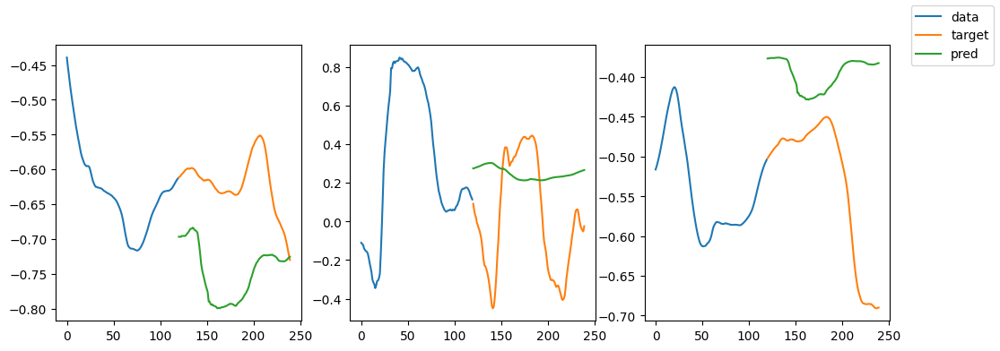

validation prediction


<Figure size 640x480 with 0 Axes>

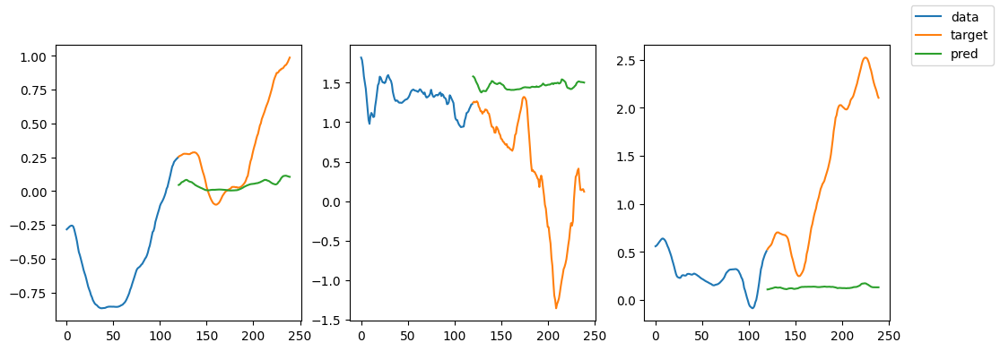

-----------------------------------------------------------------------------------------
| end of epoch  63 | time:  5.12s | valid loss 1.8195 | mean loss   0.5781
-----------------------------------------------------------------------------------------


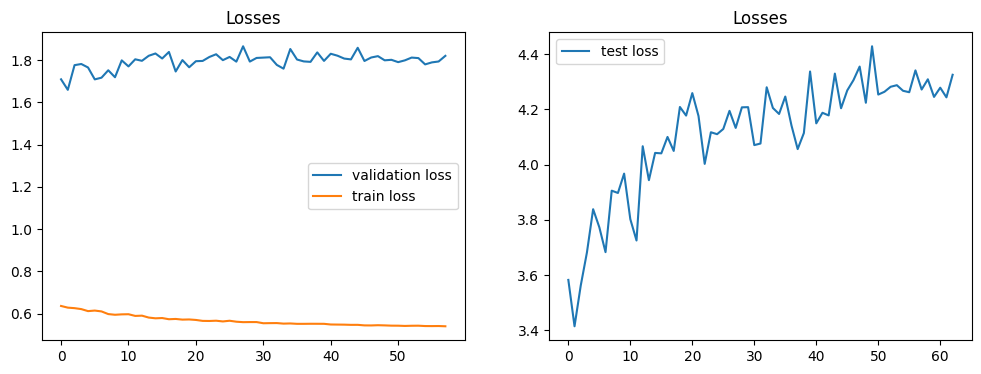

Epoch #64


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  64 |    74/  373 batches | lr 0.00020 | ms/batch 8.83396 | loss 0.55385
| epoch  64 |   148/  373 batches | lr 0.00020 | ms/batch 8.73365 | loss 0.59693
| epoch  64 |   222/  373 batches | lr 0.00020 | ms/batch 8.67003 | loss 0.51351
| epoch  64 |   296/  373 batches | lr 0.00020 | ms/batch 8.71205 | loss 0.53266
| epoch  64 |   370/  373 batches | lr 0.00020 | ms/batch 8.75852 | loss 0.51939
-----------------------------------------------------------------------------------------
| end of epoch  64 | time:  3.48s | valid loss 1.7994 | mean loss   0.5775
-----------------------------------------------------------------------------------------
Epoch #65


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  65 |    74/  373 batches | lr 0.00019 | ms/batch 8.87450 | loss 0.52877
training prediction


<Figure size 640x480 with 0 Axes>

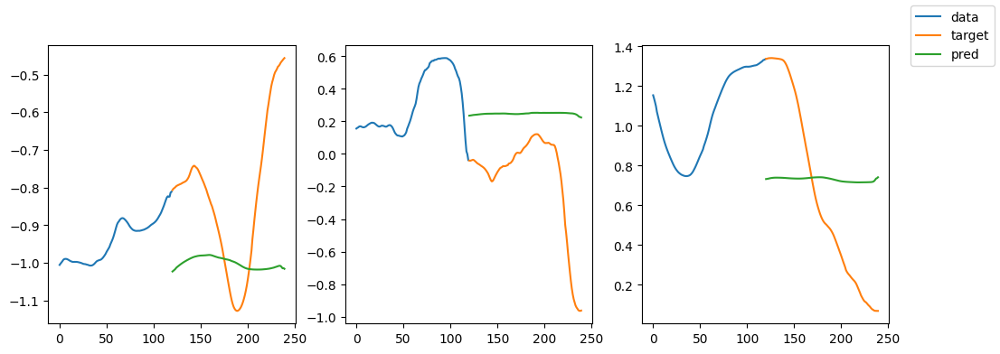

| epoch  65 |   148/  373 batches | lr 0.00019 | ms/batch 11.54589 | loss 0.50522
training prediction


<Figure size 640x480 with 0 Axes>

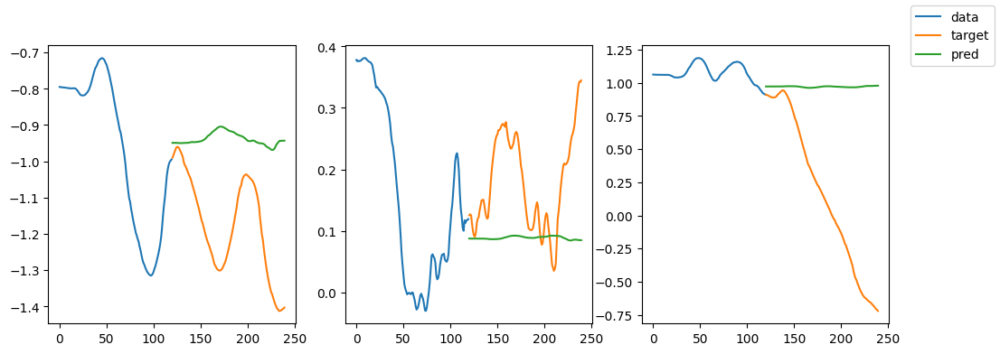

| epoch  65 |   222/  373 batches | lr 0.00019 | ms/batch 11.51124 | loss 0.59882
training prediction


<Figure size 640x480 with 0 Axes>

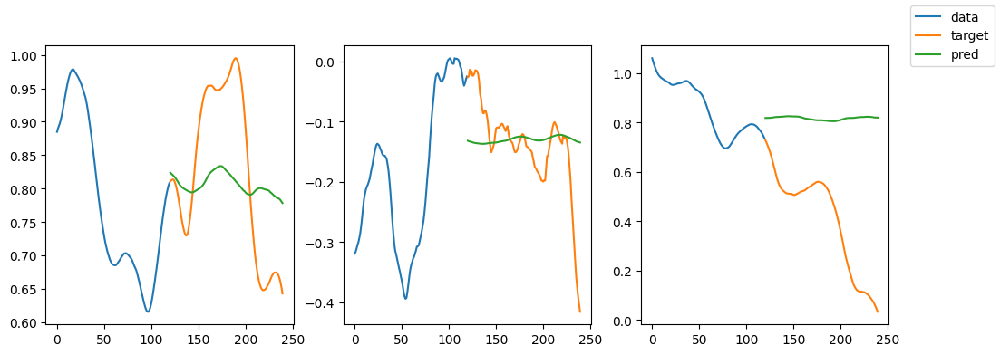

| epoch  65 |   296/  373 batches | lr 0.00019 | ms/batch 11.46367 | loss 0.54349
training prediction


<Figure size 640x480 with 0 Axes>

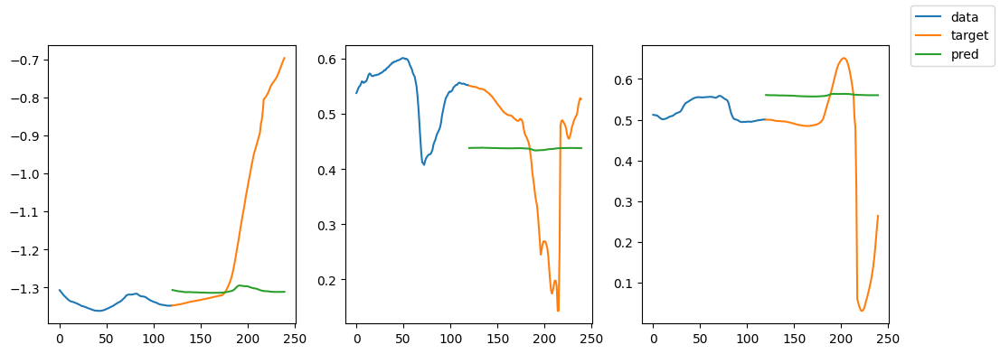

| epoch  65 |   370/  373 batches | lr 0.00019 | ms/batch 11.43365 | loss 0.53392
training prediction


<Figure size 640x480 with 0 Axes>

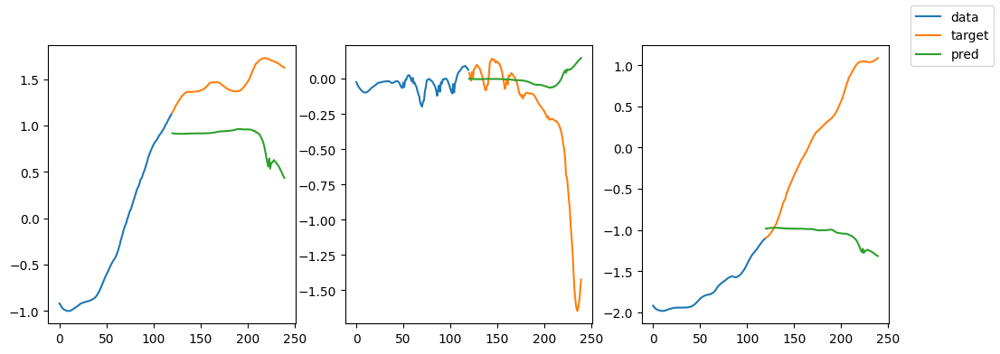

validation prediction


<Figure size 640x480 with 0 Axes>

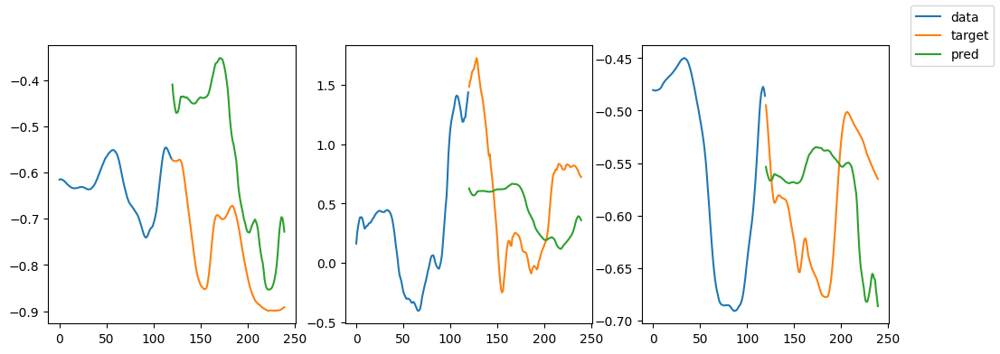

validation prediction


<Figure size 640x480 with 0 Axes>

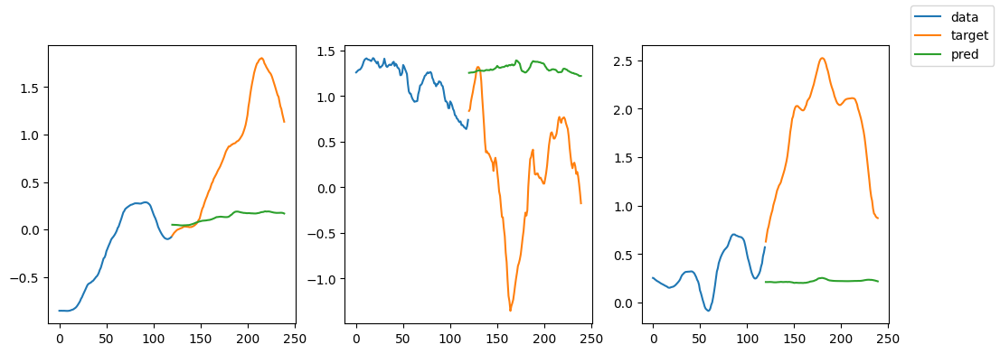

-----------------------------------------------------------------------------------------
| end of epoch  65 | time:  4.90s | valid loss 1.7999 | mean loss   0.5770
-----------------------------------------------------------------------------------------


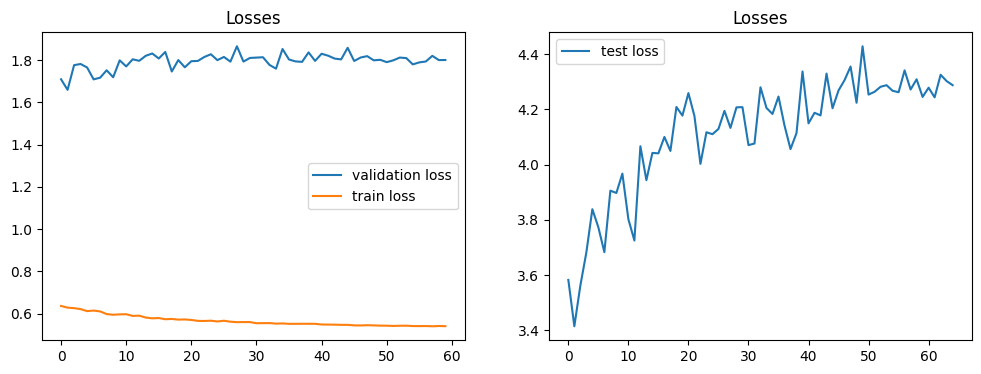

Epoch #66


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  66 |    74/  373 batches | lr 0.00018 | ms/batch 8.75327 | loss 0.53691
| epoch  66 |   148/  373 batches | lr 0.00018 | ms/batch 8.59640 | loss 0.49970
| epoch  66 |   222/  373 batches | lr 0.00018 | ms/batch 8.59452 | loss 0.55694
| epoch  66 |   296/  373 batches | lr 0.00018 | ms/batch 8.65833 | loss 0.56383
| epoch  66 |   370/  373 batches | lr 0.00018 | ms/batch 8.71635 | loss 0.55597
-----------------------------------------------------------------------------------------
| end of epoch  66 | time:  3.45s | valid loss 1.8065 | mean loss   0.5764
-----------------------------------------------------------------------------------------
Epoch #67


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  67 |    74/  373 batches | lr 0.00017 | ms/batch 8.86540 | loss 0.57287
training prediction


<Figure size 640x480 with 0 Axes>

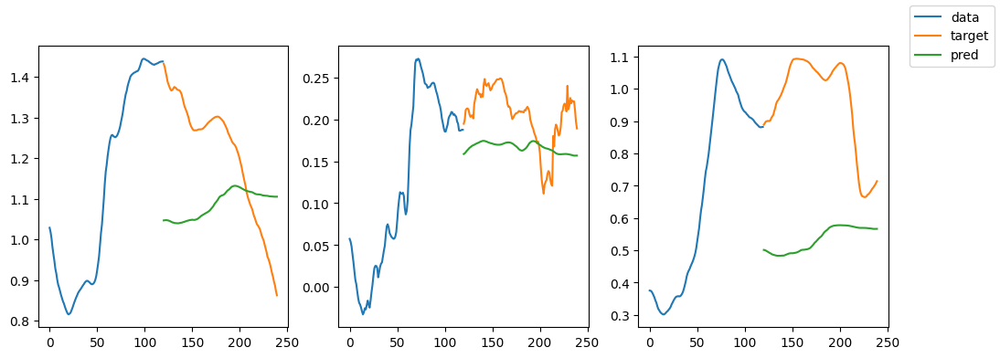

| epoch  67 |   148/  373 batches | lr 0.00017 | ms/batch 14.35277 | loss 0.58184
training prediction


<Figure size 640x480 with 0 Axes>

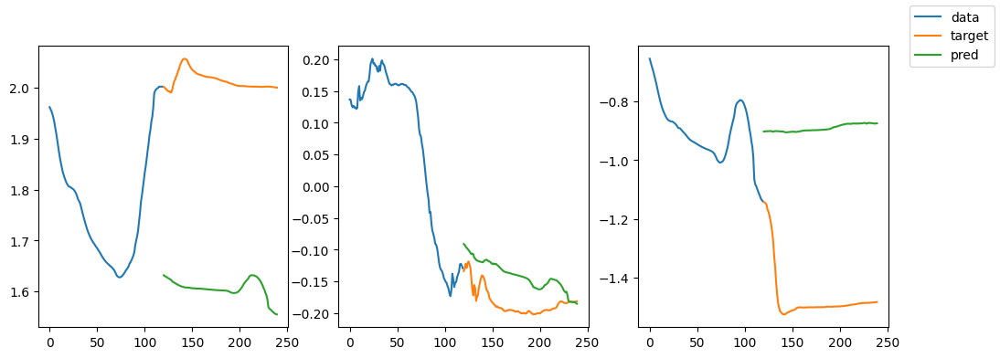

| epoch  67 |   222/  373 batches | lr 0.00017 | ms/batch 11.55547 | loss 0.52576
training prediction


<Figure size 640x480 with 0 Axes>

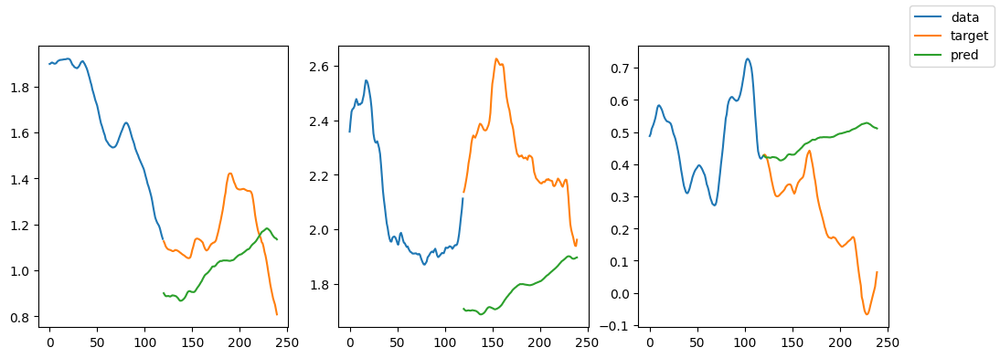

| epoch  67 |   296/  373 batches | lr 0.00017 | ms/batch 11.57648 | loss 0.51460
training prediction


<Figure size 640x480 with 0 Axes>

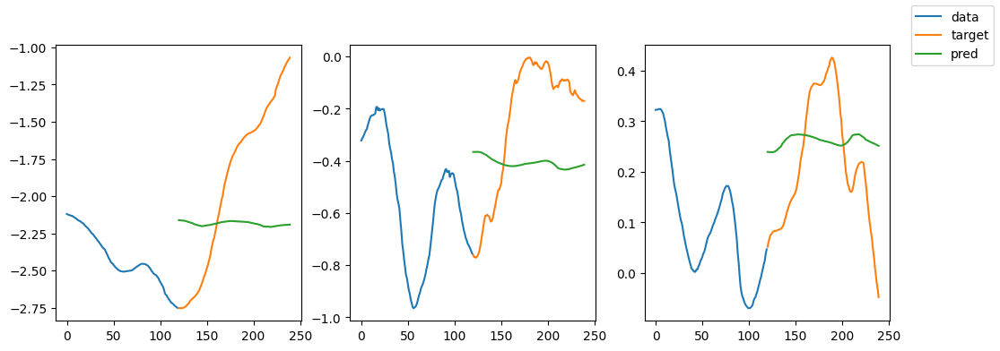

| epoch  67 |   370/  373 batches | lr 0.00017 | ms/batch 11.45894 | loss 0.51766
training prediction


<Figure size 640x480 with 0 Axes>

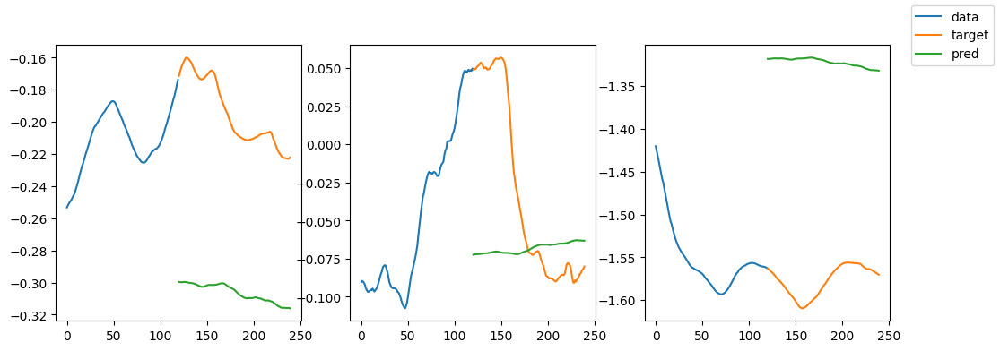

validation prediction


<Figure size 640x480 with 0 Axes>

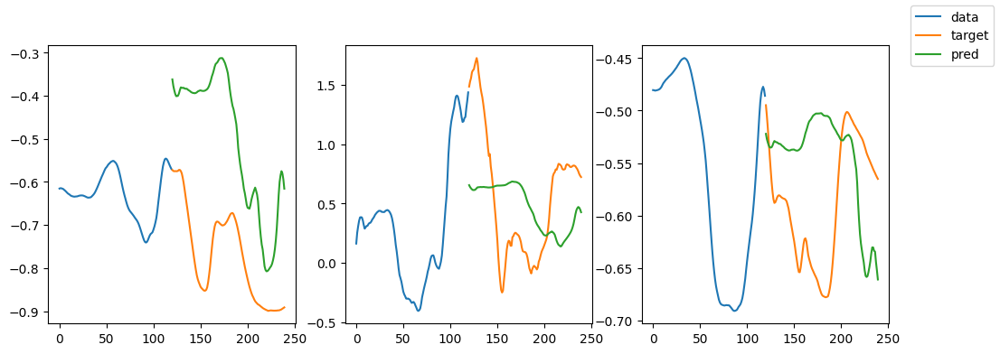

validation prediction


<Figure size 640x480 with 0 Axes>

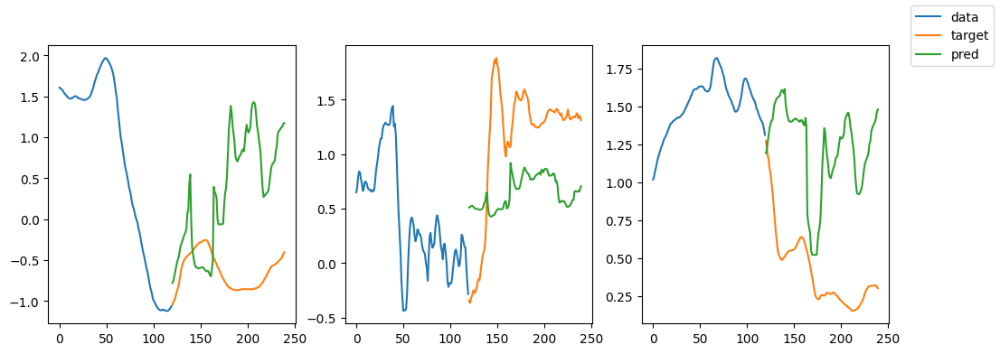

-----------------------------------------------------------------------------------------
| end of epoch  67 | time:  5.14s | valid loss 1.8113 | mean loss   0.5759
-----------------------------------------------------------------------------------------


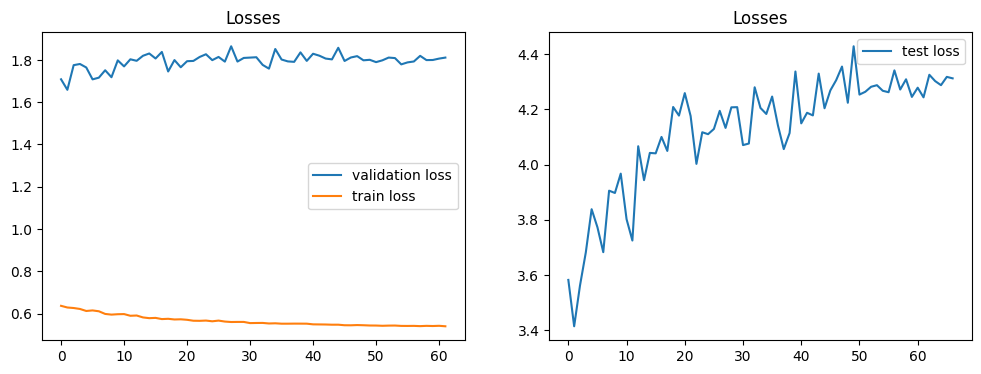

Epoch #68


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  68 |    74/  373 batches | lr 0.00016 | ms/batch 8.92174 | loss 0.57123
| epoch  68 |   148/  373 batches | lr 0.00016 | ms/batch 8.61852 | loss 0.57703
| epoch  68 |   222/  373 batches | lr 0.00016 | ms/batch 8.62678 | loss 0.51122
| epoch  68 |   296/  373 batches | lr 0.00016 | ms/batch 8.61770 | loss 0.50428
| epoch  68 |   370/  373 batches | lr 0.00016 | ms/batch 8.65997 | loss 0.54510
-----------------------------------------------------------------------------------------
| end of epoch  68 | time:  3.46s | valid loss 1.8074 | mean loss   0.5753
-----------------------------------------------------------------------------------------
Epoch #69


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  69 |    74/  373 batches | lr 0.00015 | ms/batch 8.77853 | loss 0.57232
training prediction


<Figure size 640x480 with 0 Axes>

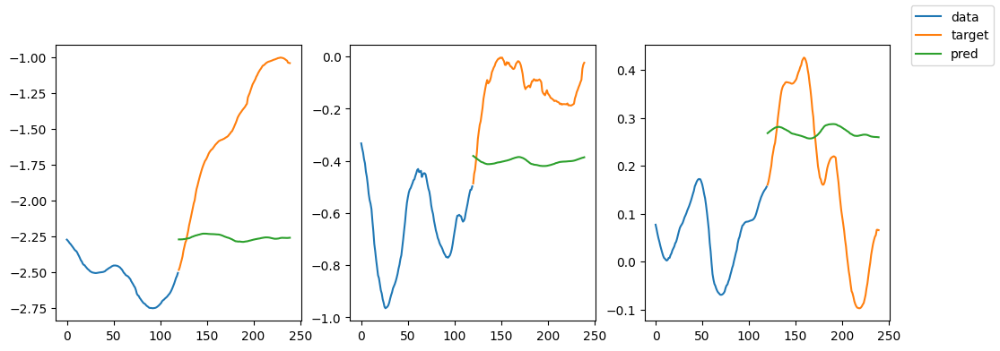

| epoch  69 |   148/  373 batches | lr 0.00015 | ms/batch 11.43750 | loss 0.52966
training prediction


<Figure size 640x480 with 0 Axes>

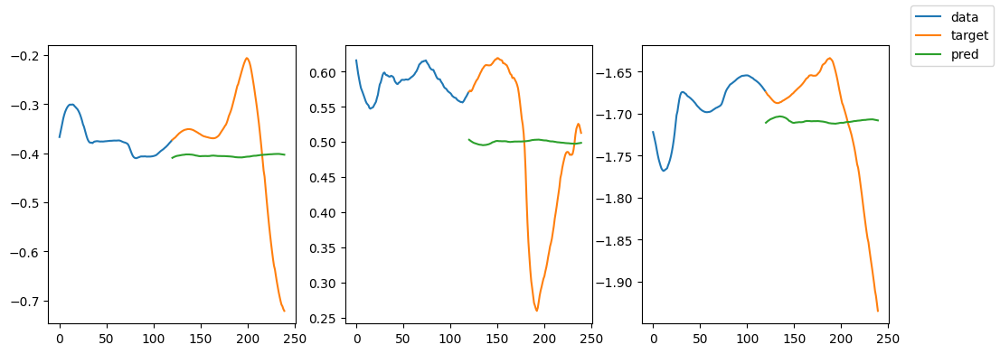

| epoch  69 |   222/  373 batches | lr 0.00015 | ms/batch 11.44981 | loss 0.54623
training prediction


<Figure size 640x480 with 0 Axes>

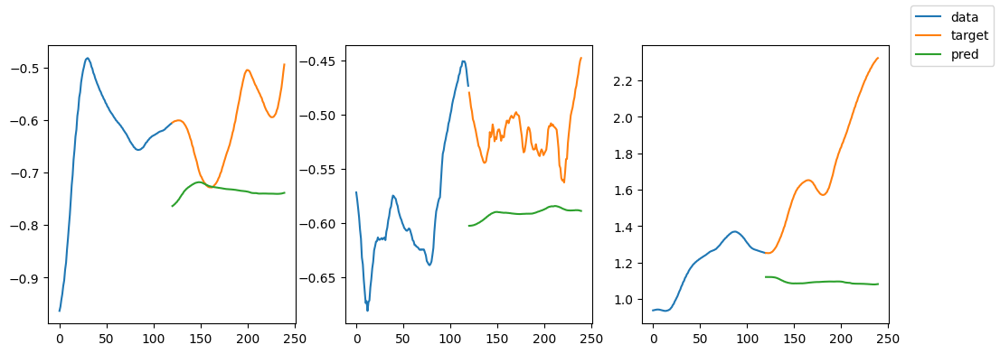

| epoch  69 |   296/  373 batches | lr 0.00015 | ms/batch 11.35918 | loss 0.52339
training prediction


<Figure size 640x480 with 0 Axes>

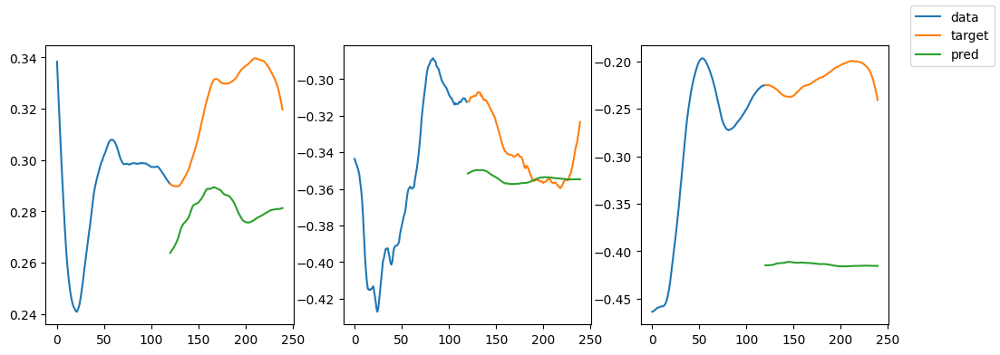

| epoch  69 |   370/  373 batches | lr 0.00015 | ms/batch 11.57348 | loss 0.53200
training prediction


<Figure size 640x480 with 0 Axes>

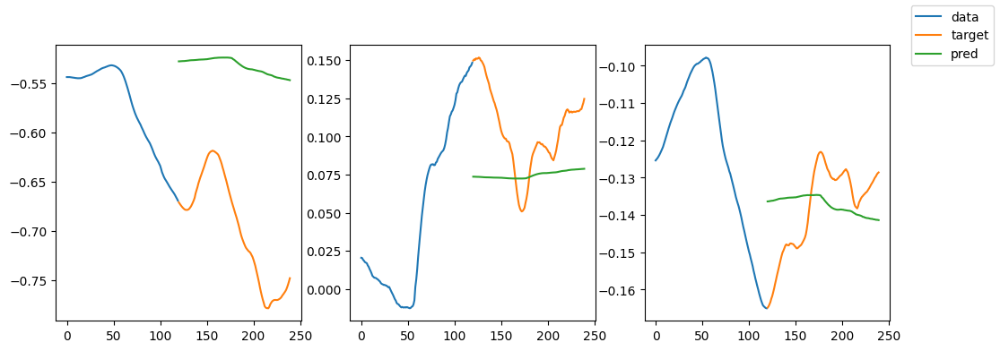

validation prediction


<Figure size 640x480 with 0 Axes>

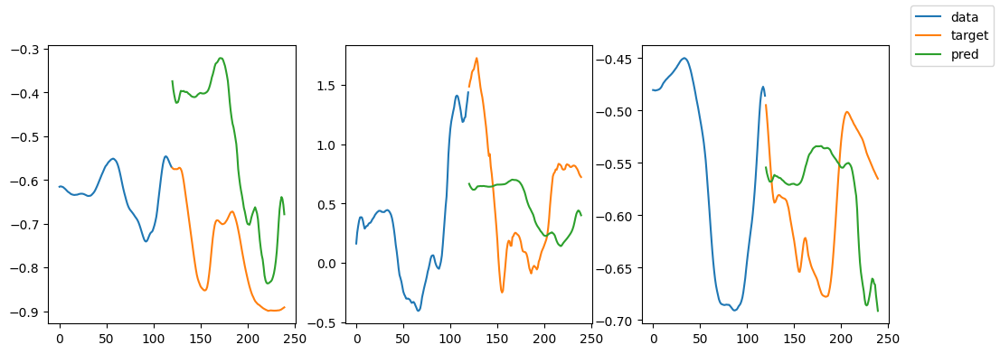

validation prediction


<Figure size 640x480 with 0 Axes>

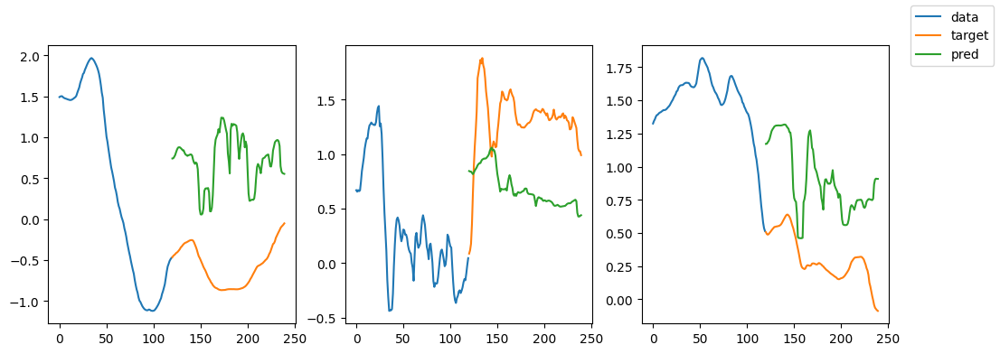

-----------------------------------------------------------------------------------------
| end of epoch  69 | time:  5.11s | valid loss 1.8104 | mean loss   0.5748
-----------------------------------------------------------------------------------------


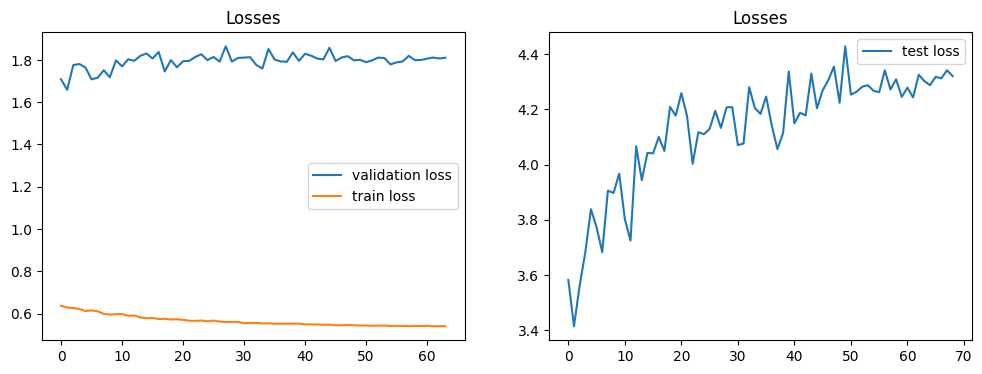

Epoch #70


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  70 |    74/  373 batches | lr 0.00015 | ms/batch 8.81415 | loss 0.59145
| epoch  70 |   148/  373 batches | lr 0.00015 | ms/batch 8.64911 | loss 0.51982
| epoch  70 |   222/  373 batches | lr 0.00015 | ms/batch 8.64542 | loss 0.48837
| epoch  70 |   296/  373 batches | lr 0.00015 | ms/batch 8.64487 | loss 0.51606
| epoch  70 |   370/  373 batches | lr 0.00015 | ms/batch 8.67646 | loss 0.59135
-----------------------------------------------------------------------------------------
| end of epoch  70 | time:  3.45s | valid loss 1.7846 | mean loss   0.5743
-----------------------------------------------------------------------------------------
Epoch #71


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  71 |    74/  373 batches | lr 0.00014 | ms/batch 9.01982 | loss 0.50762
training prediction


<Figure size 640x480 with 0 Axes>

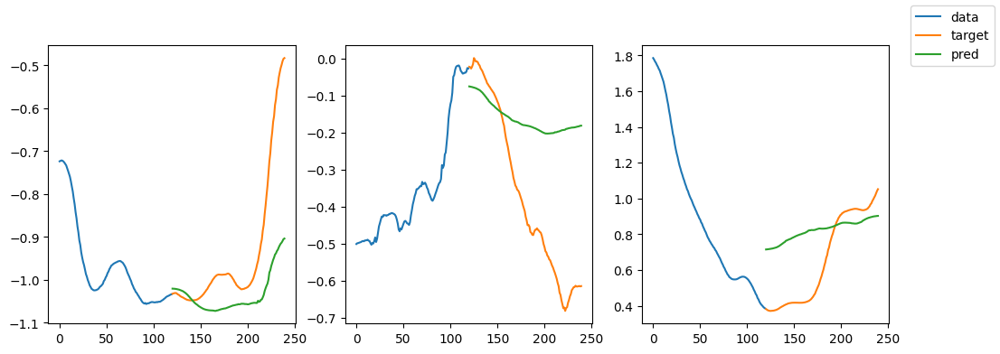

| epoch  71 |   148/  373 batches | lr 0.00014 | ms/batch 11.58651 | loss 0.49475
training prediction


<Figure size 640x480 with 0 Axes>

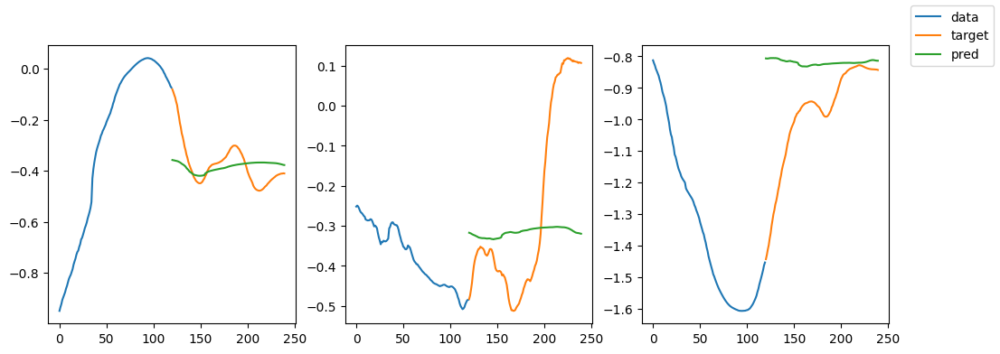

| epoch  71 |   222/  373 batches | lr 0.00014 | ms/batch 11.51133 | loss 0.57918
training prediction


<Figure size 640x480 with 0 Axes>

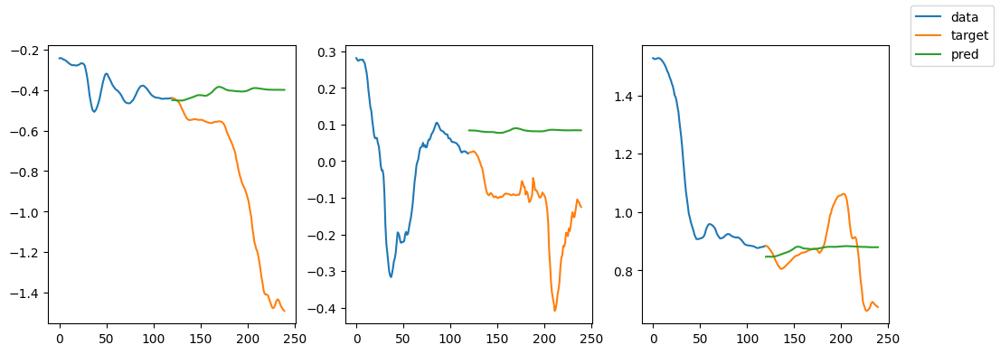

| epoch  71 |   296/  373 batches | lr 0.00014 | ms/batch 11.40933 | loss 0.61318
training prediction


<Figure size 640x480 with 0 Axes>

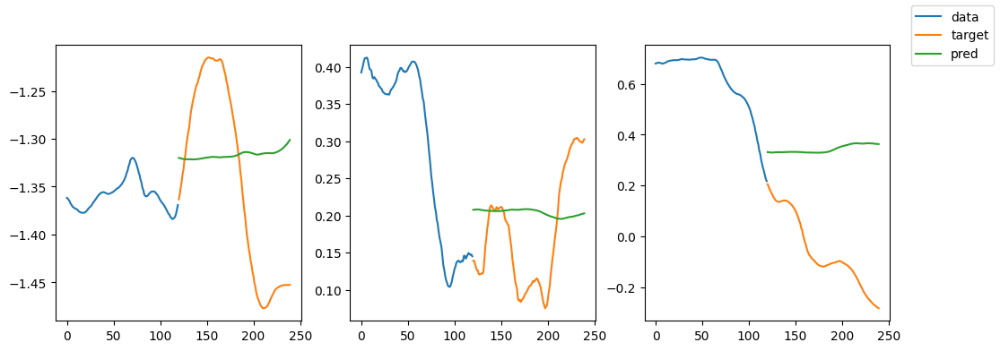

| epoch  71 |   370/  373 batches | lr 0.00014 | ms/batch 11.44137 | loss 0.50516
training prediction


<Figure size 640x480 with 0 Axes>

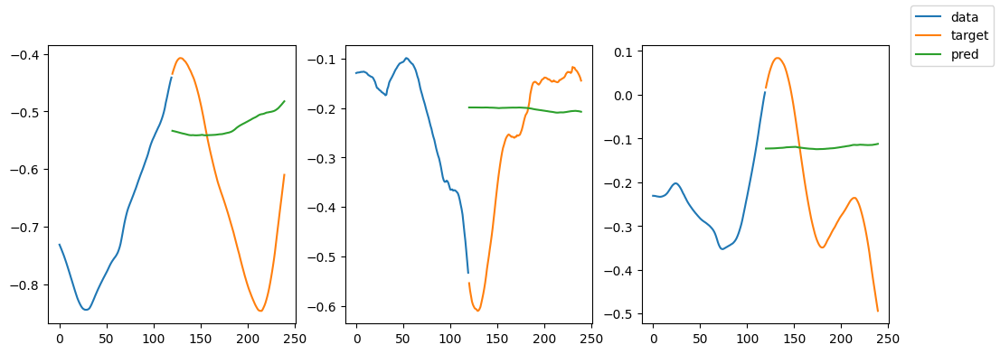

validation prediction


<Figure size 640x480 with 0 Axes>

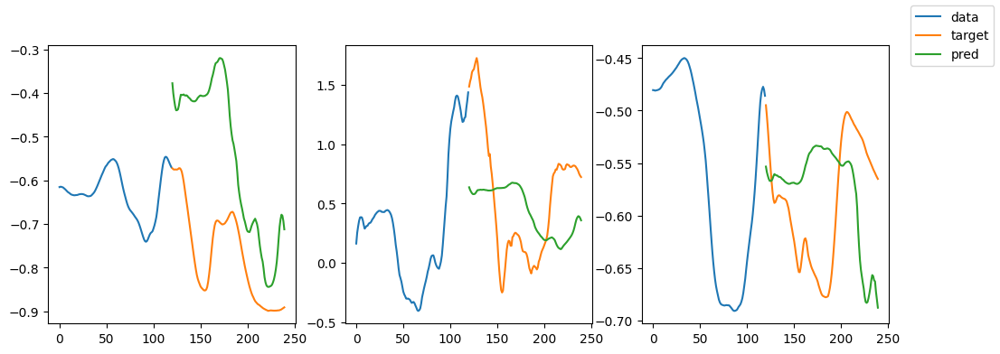

validation prediction


<Figure size 640x480 with 0 Axes>

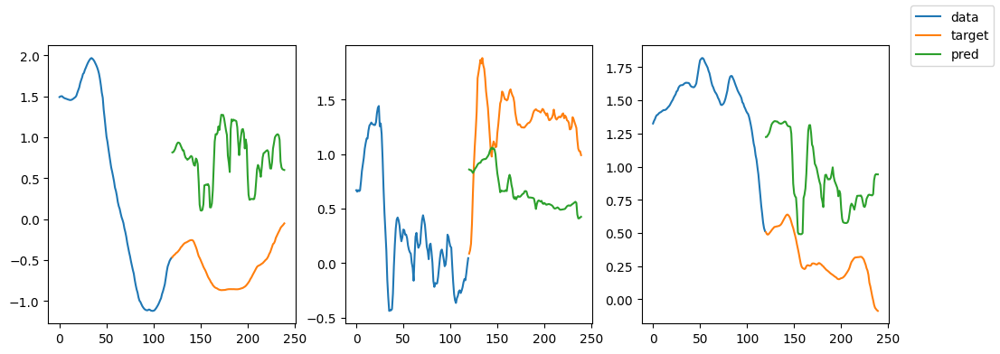

-----------------------------------------------------------------------------------------
| end of epoch  71 | time:  4.93s | valid loss 1.8047 | mean loss   0.5738
-----------------------------------------------------------------------------------------


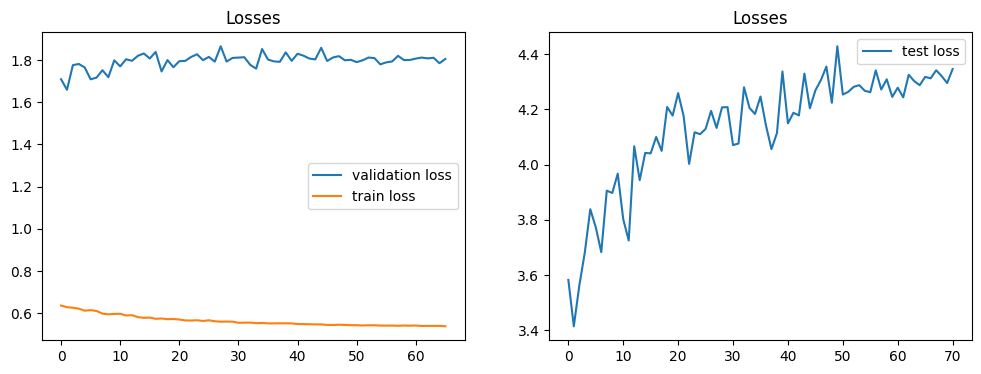

Epoch #72


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  72 |    74/  373 batches | lr 0.00013 | ms/batch 8.83964 | loss 0.53980
| epoch  72 |   148/  373 batches | lr 0.00013 | ms/batch 8.72596 | loss 0.53124
| epoch  72 |   222/  373 batches | lr 0.00013 | ms/batch 8.65535 | loss 0.56994
| epoch  72 |   296/  373 batches | lr 0.00013 | ms/batch 8.75214 | loss 0.54914
| epoch  72 |   370/  373 batches | lr 0.00013 | ms/batch 8.71097 | loss 0.51736
-----------------------------------------------------------------------------------------
| end of epoch  72 | time:  3.47s | valid loss 1.8064 | mean loss   0.5733
-----------------------------------------------------------------------------------------
Epoch #73


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  73 |    74/  373 batches | lr 0.00012 | ms/batch 8.80351 | loss 0.56845
training prediction


<Figure size 640x480 with 0 Axes>

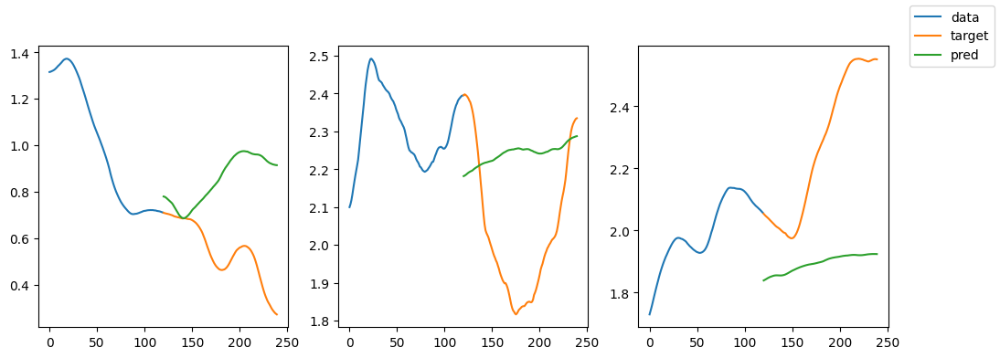

| epoch  73 |   148/  373 batches | lr 0.00012 | ms/batch 11.40175 | loss 0.61472
training prediction


<Figure size 640x480 with 0 Axes>

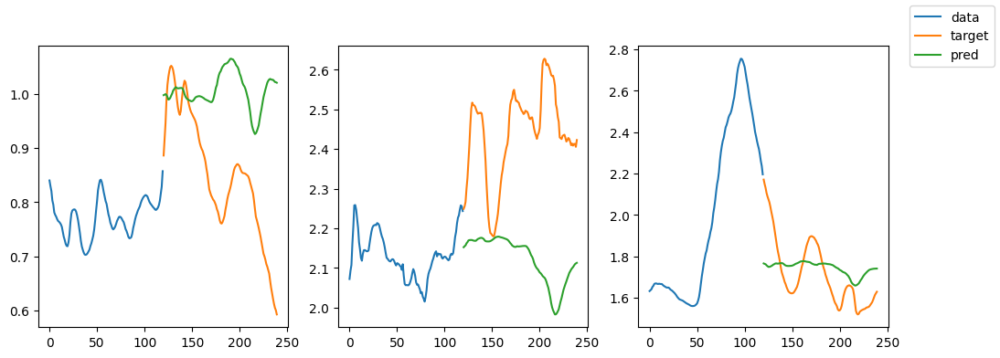

| epoch  73 |   222/  373 batches | lr 0.00012 | ms/batch 11.42712 | loss 0.50855
training prediction


<Figure size 640x480 with 0 Axes>

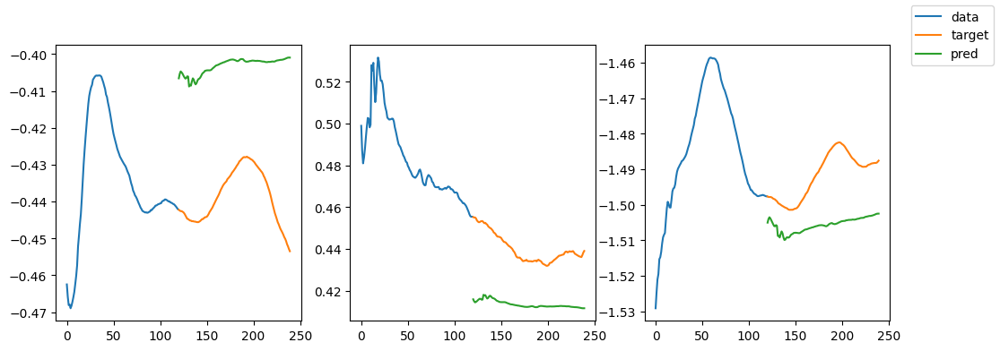

| epoch  73 |   296/  373 batches | lr 0.00012 | ms/batch 11.54838 | loss 0.50231
training prediction


<Figure size 640x480 with 0 Axes>

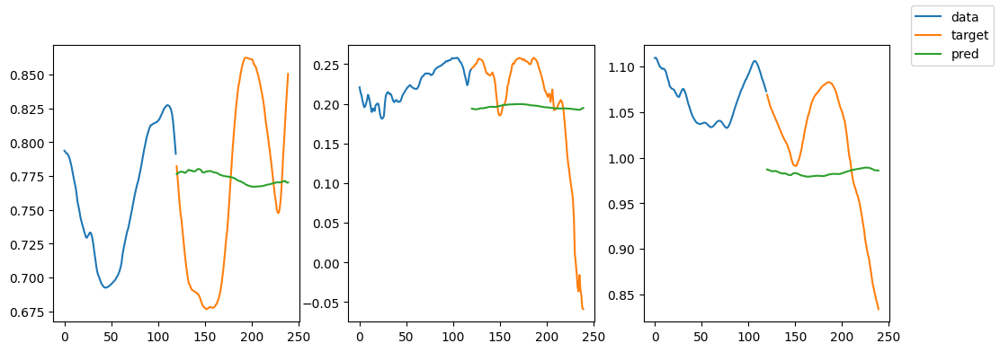

| epoch  73 |   370/  373 batches | lr 0.00012 | ms/batch 11.58336 | loss 0.50867
training prediction


<Figure size 640x480 with 0 Axes>

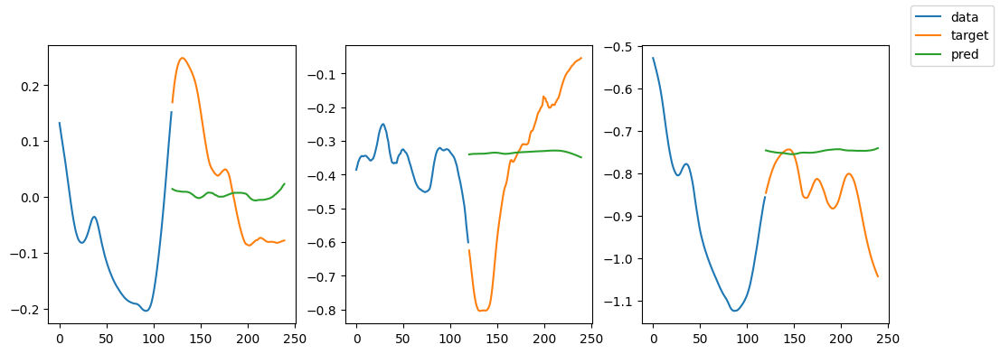

validation prediction


<Figure size 640x480 with 0 Axes>

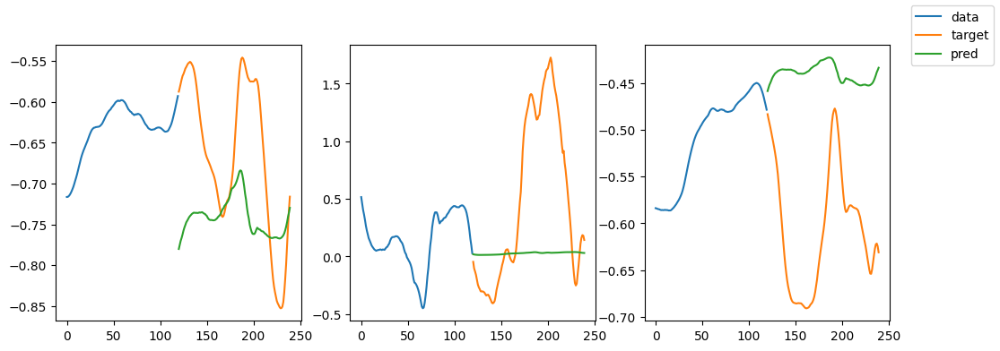

validation prediction


<Figure size 640x480 with 0 Axes>

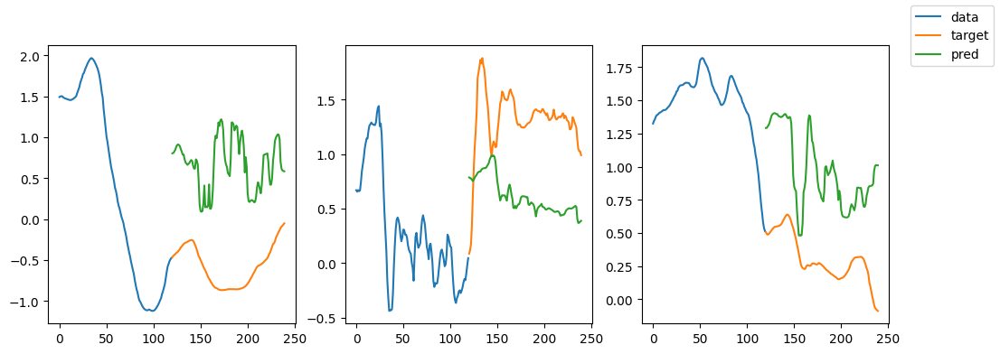

-----------------------------------------------------------------------------------------
| end of epoch  73 | time:  4.91s | valid loss 1.7944 | mean loss   0.5728
-----------------------------------------------------------------------------------------


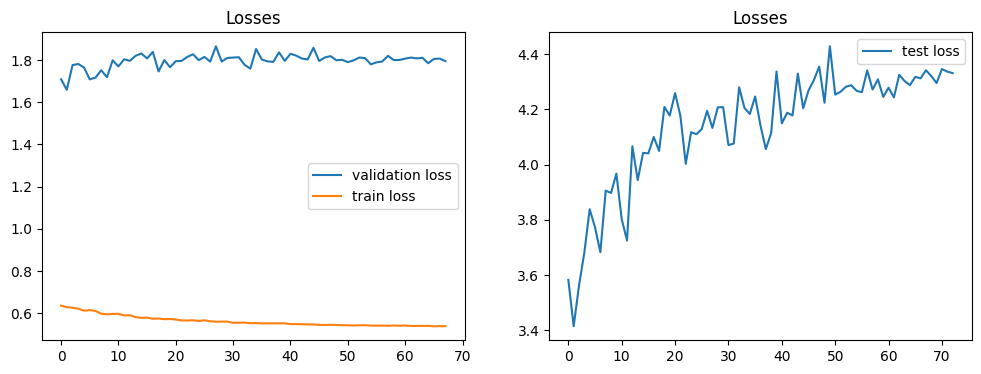

Epoch #74


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  74 |    74/  373 batches | lr 0.00012 | ms/batch 8.91397 | loss 0.56799
| epoch  74 |   148/  373 batches | lr 0.00012 | ms/batch 8.65881 | loss 0.50550
| epoch  74 |   222/  373 batches | lr 0.00012 | ms/batch 8.62890 | loss 0.56779
| epoch  74 |   296/  373 batches | lr 0.00012 | ms/batch 8.60998 | loss 0.51199
| epoch  74 |   370/  373 batches | lr 0.00012 | ms/batch 8.63502 | loss 0.54436
-----------------------------------------------------------------------------------------
| end of epoch  74 | time:  3.46s | valid loss 1.7976 | mean loss   0.5724
-----------------------------------------------------------------------------------------
Epoch #75


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  75 |    74/  373 batches | lr 0.00011 | ms/batch 9.04868 | loss 0.53436
training prediction


<Figure size 640x480 with 0 Axes>

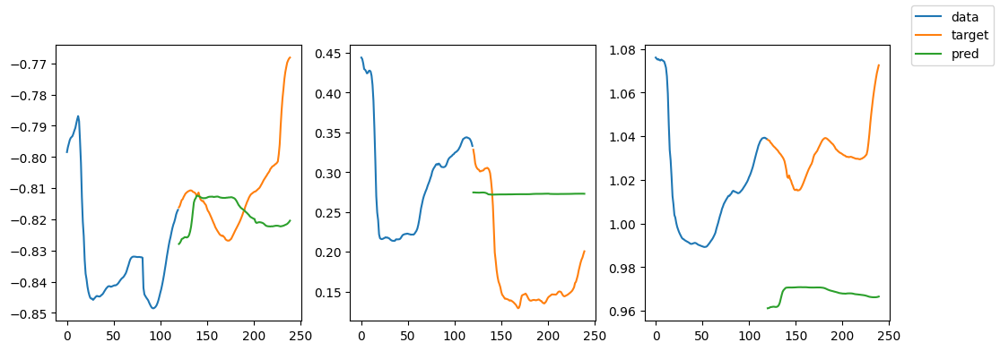

| epoch  75 |   148/  373 batches | lr 0.00011 | ms/batch 11.73884 | loss 0.58287
training prediction


<Figure size 640x480 with 0 Axes>

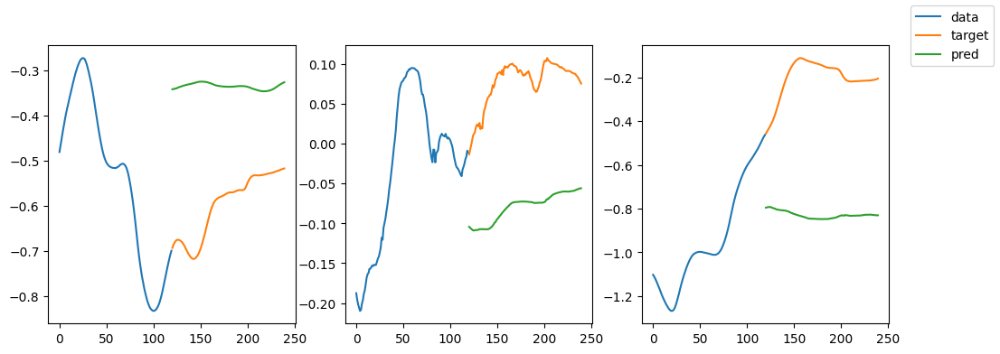

| epoch  75 |   222/  373 batches | lr 0.00011 | ms/batch 11.37733 | loss 0.57004
training prediction


<Figure size 640x480 with 0 Axes>

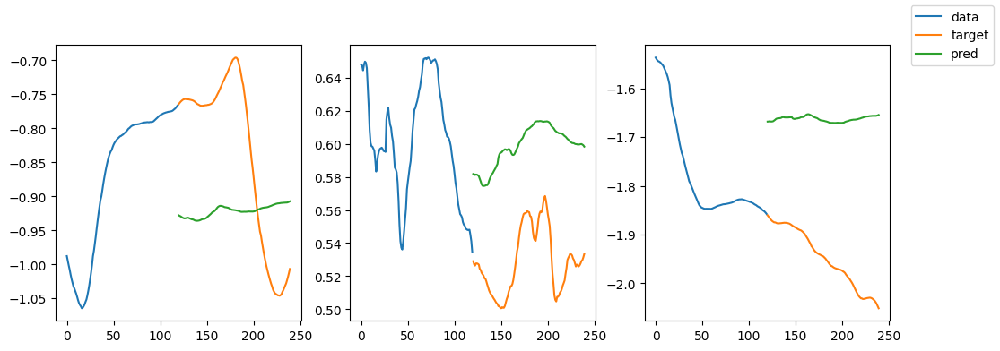

| epoch  75 |   296/  373 batches | lr 0.00011 | ms/batch 14.22234 | loss 0.51847
training prediction


<Figure size 640x480 with 0 Axes>

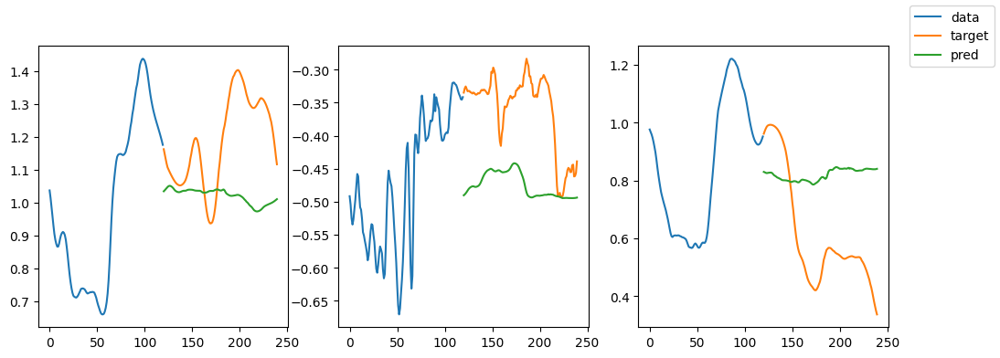

| epoch  75 |   370/  373 batches | lr 0.00011 | ms/batch 11.77025 | loss 0.49502
training prediction


<Figure size 640x480 with 0 Axes>

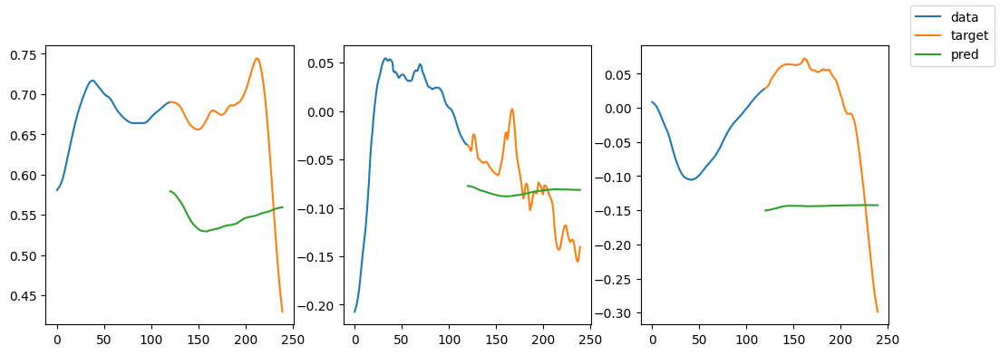

validation prediction


<Figure size 640x480 with 0 Axes>

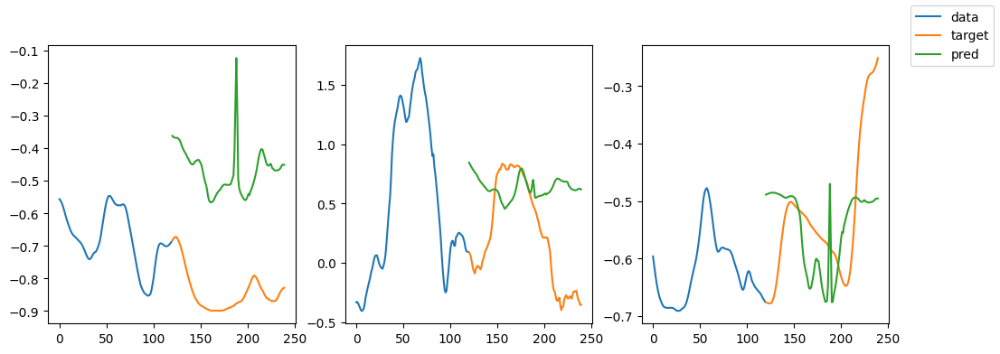

validation prediction


<Figure size 640x480 with 0 Axes>

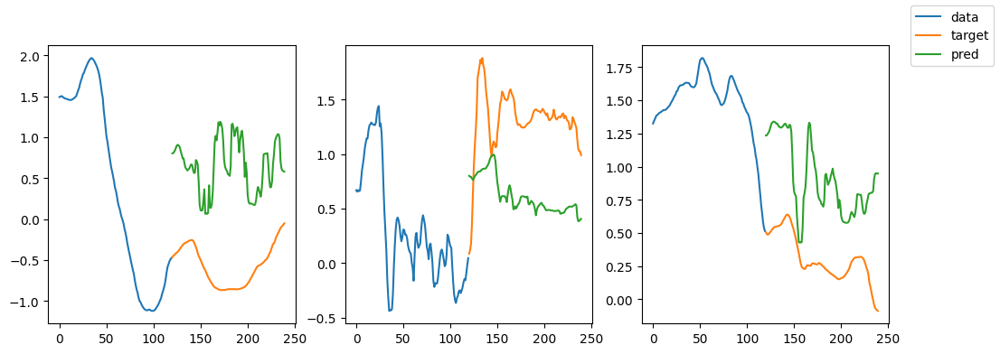

-----------------------------------------------------------------------------------------
| end of epoch  75 | time:  5.17s | valid loss 1.7973 | mean loss   0.5719
-----------------------------------------------------------------------------------------


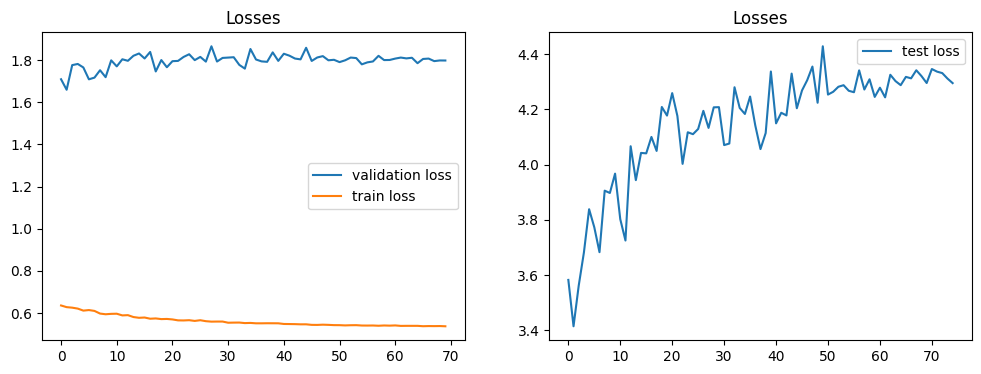

Epoch #76


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  76 |    74/  373 batches | lr 0.00011 | ms/batch 8.81745 | loss 0.56807
| epoch  76 |   148/  373 batches | lr 0.00011 | ms/batch 8.64406 | loss 0.52108
| epoch  76 |   222/  373 batches | lr 0.00011 | ms/batch 8.72259 | loss 0.48710
| epoch  76 |   296/  373 batches | lr 0.00011 | ms/batch 8.66777 | loss 0.55760
| epoch  76 |   370/  373 batches | lr 0.00011 | ms/batch 8.69118 | loss 0.56365
-----------------------------------------------------------------------------------------
| end of epoch  76 | time:  3.46s | valid loss 1.8101 | mean loss   0.5715
-----------------------------------------------------------------------------------------
Epoch #77


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  77 |    74/  373 batches | lr 0.00010 | ms/batch 8.77317 | loss 0.55728
training prediction


<Figure size 640x480 with 0 Axes>

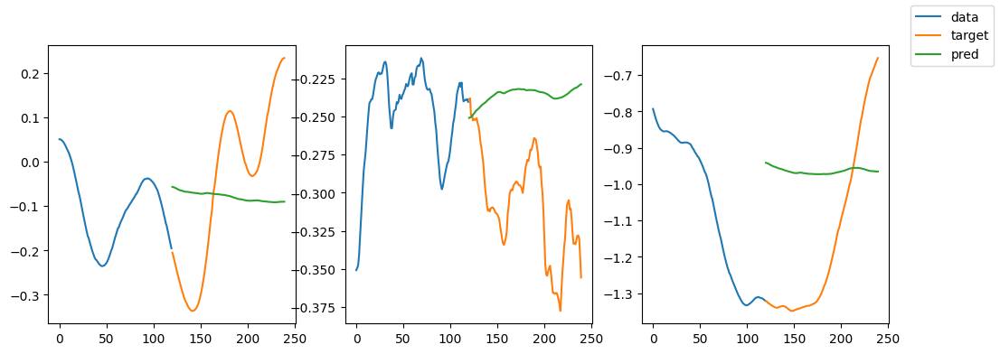

| epoch  77 |   148/  373 batches | lr 0.00010 | ms/batch 11.48576 | loss 0.52866
training prediction


<Figure size 640x480 with 0 Axes>

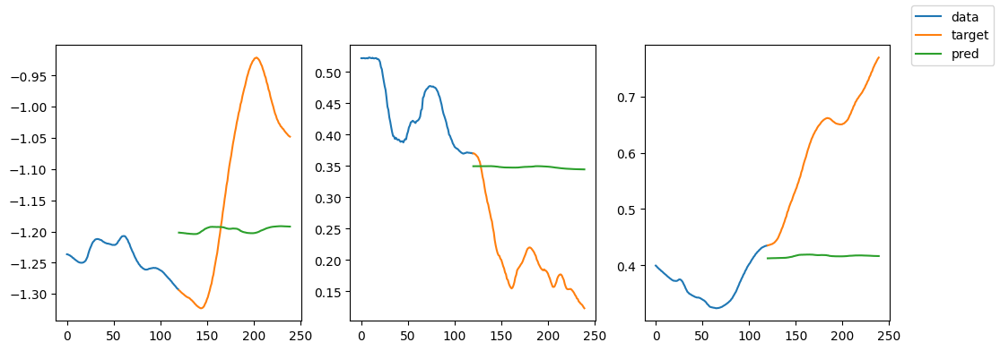

| epoch  77 |   222/  373 batches | lr 0.00010 | ms/batch 11.54643 | loss 0.48260
training prediction


<Figure size 640x480 with 0 Axes>

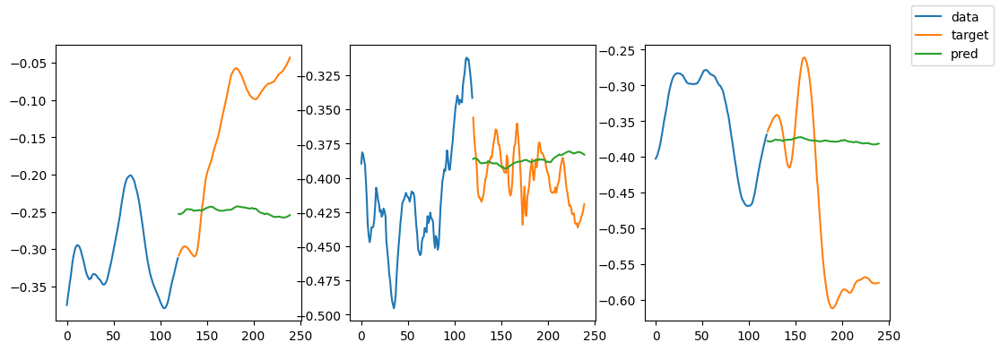

| epoch  77 |   296/  373 batches | lr 0.00010 | ms/batch 11.61660 | loss 0.54938
training prediction


<Figure size 640x480 with 0 Axes>

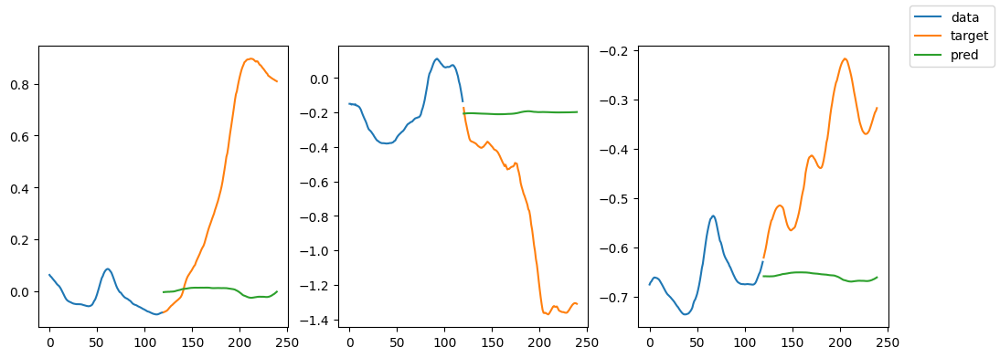

| epoch  77 |   370/  373 batches | lr 0.00010 | ms/batch 11.66344 | loss 0.58107
training prediction


<Figure size 640x480 with 0 Axes>

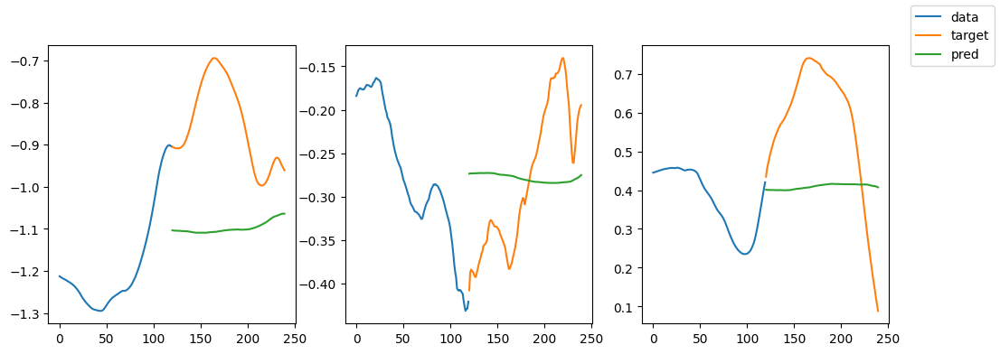

validation prediction


<Figure size 640x480 with 0 Axes>

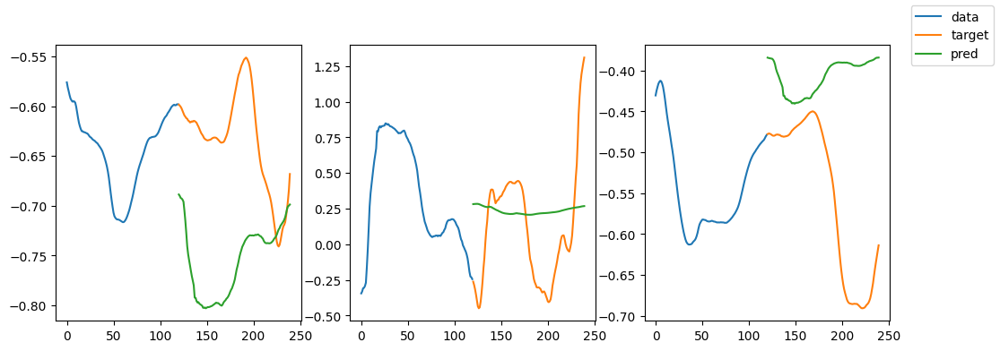

validation prediction


<Figure size 640x480 with 0 Axes>

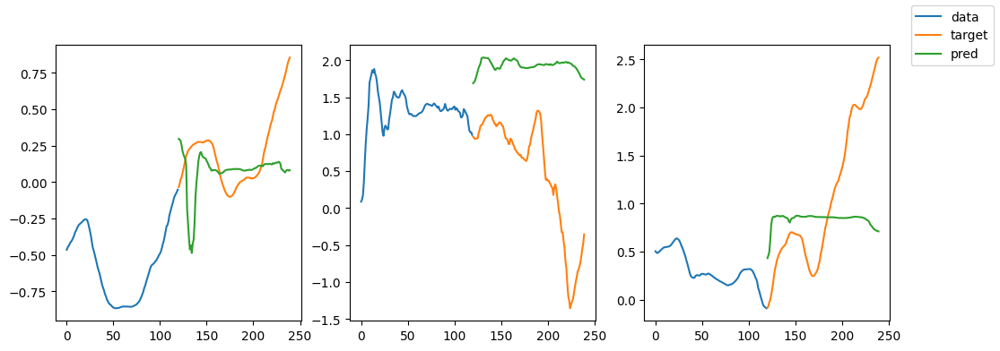

-----------------------------------------------------------------------------------------
| end of epoch  77 | time:  5.16s | valid loss 1.8012 | mean loss   0.5711
-----------------------------------------------------------------------------------------


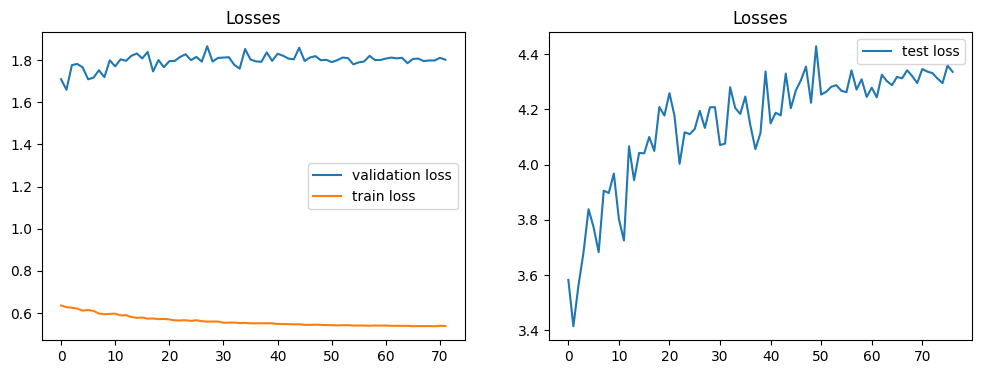

Epoch #78


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  78 |    74/  373 batches | lr 0.00010 | ms/batch 8.84052 | loss 0.59753
| epoch  78 |   148/  373 batches | lr 0.00010 | ms/batch 8.65828 | loss 0.52559
| epoch  78 |   222/  373 batches | lr 0.00010 | ms/batch 8.66649 | loss 0.58502
| epoch  78 |   296/  373 batches | lr 0.00010 | ms/batch 8.66067 | loss 0.47975
| epoch  78 |   370/  373 batches | lr 0.00010 | ms/batch 8.71429 | loss 0.50667
-----------------------------------------------------------------------------------------
| end of epoch  78 | time:  3.46s | valid loss 1.7998 | mean loss   0.5707
-----------------------------------------------------------------------------------------
Epoch #79


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  79 |    74/  373 batches | lr 0.00009 | ms/batch 8.85478 | loss 0.58088
training prediction


<Figure size 640x480 with 0 Axes>

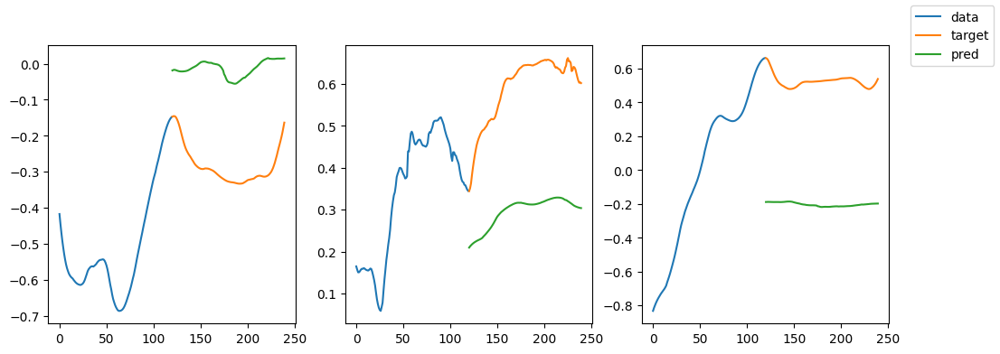

| epoch  79 |   148/  373 batches | lr 0.00009 | ms/batch 11.52147 | loss 0.49508
training prediction


<Figure size 640x480 with 0 Axes>

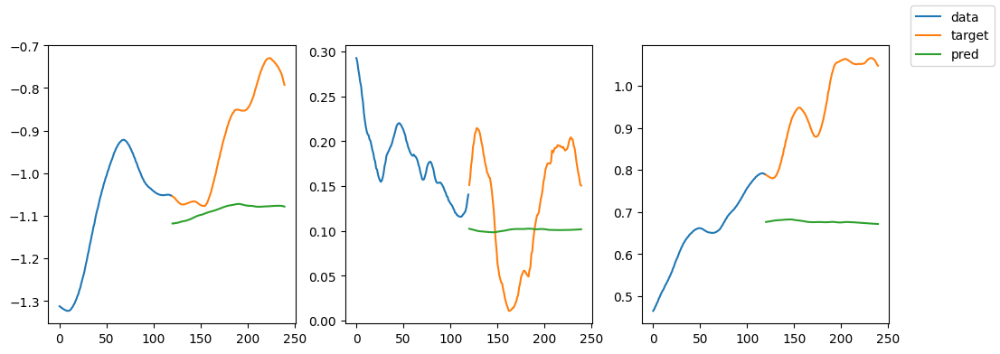

| epoch  79 |   222/  373 batches | lr 0.00009 | ms/batch 11.46626 | loss 0.59355
training prediction


<Figure size 640x480 with 0 Axes>

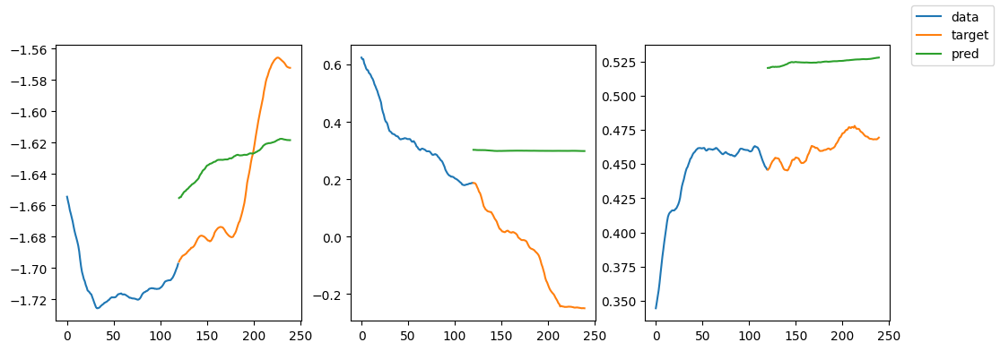

| epoch  79 |   296/  373 batches | lr 0.00009 | ms/batch 11.62102 | loss 0.50328
training prediction


<Figure size 640x480 with 0 Axes>

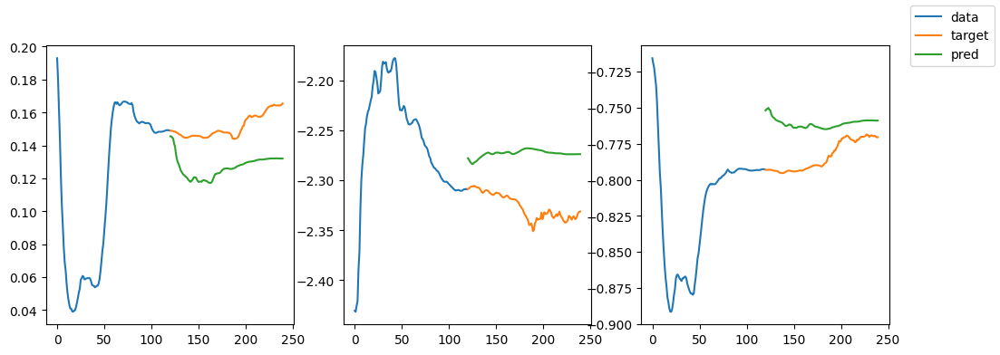

| epoch  79 |   370/  373 batches | lr 0.00009 | ms/batch 11.58477 | loss 0.51856
training prediction


<Figure size 640x480 with 0 Axes>

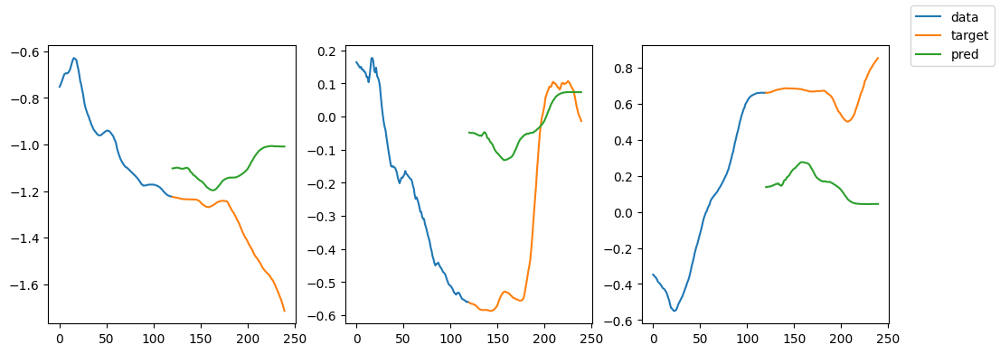

validation prediction


<Figure size 640x480 with 0 Axes>

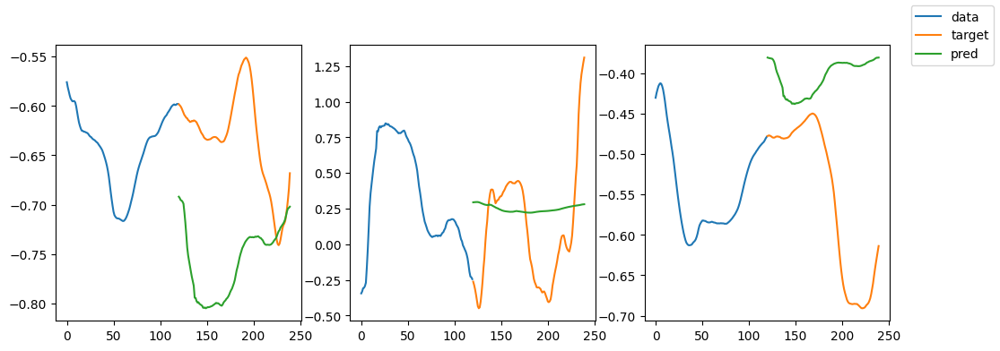

validation prediction


<Figure size 640x480 with 0 Axes>

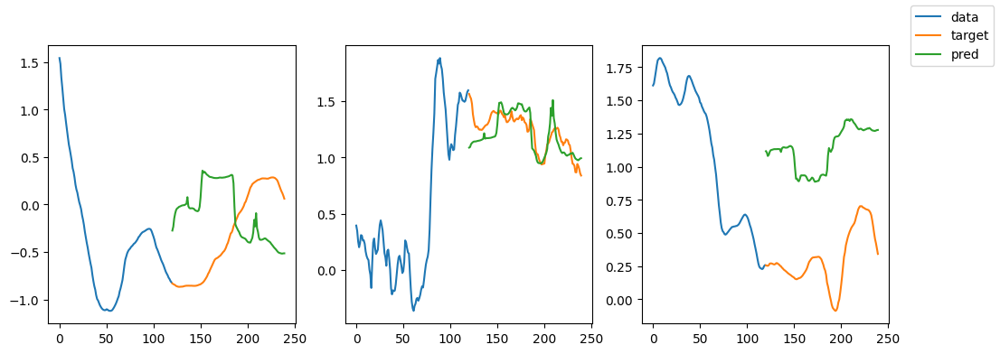

-----------------------------------------------------------------------------------------
| end of epoch  79 | time:  4.94s | valid loss 1.7976 | mean loss   0.5703
-----------------------------------------------------------------------------------------


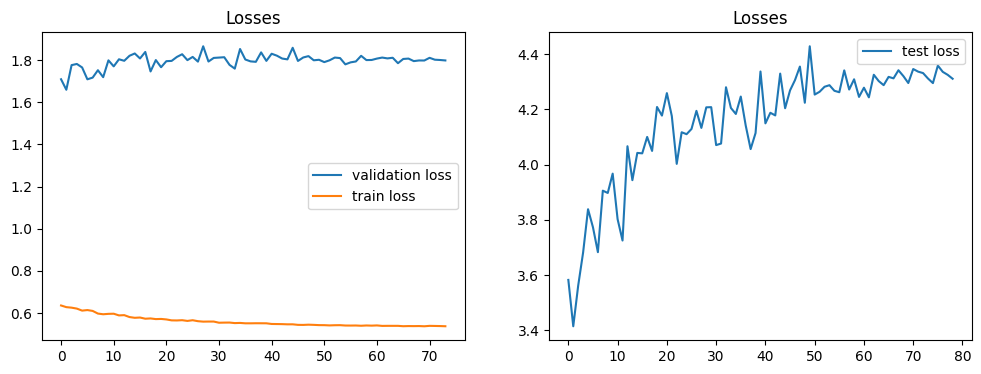

Epoch #80


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  80 |    74/  373 batches | lr 0.00009 | ms/batch 8.74493 | loss 0.54900
| epoch  80 |   148/  373 batches | lr 0.00009 | ms/batch 8.59093 | loss 0.50263
| epoch  80 |   222/  373 batches | lr 0.00009 | ms/batch 8.60379 | loss 0.58375
| epoch  80 |   296/  373 batches | lr 0.00009 | ms/batch 8.61268 | loss 0.51085
| epoch  80 |   370/  373 batches | lr 0.00009 | ms/batch 8.63105 | loss 0.55197
-----------------------------------------------------------------------------------------
| end of epoch  80 | time:  3.44s | valid loss 1.8021 | mean loss   0.5698
-----------------------------------------------------------------------------------------
Epoch #81


  0%|          | 0/373 [00:00<?, ?it/s]

| epoch  81 |    74/  373 batches | lr 0.00008 | ms/batch 8.78155 | loss 0.48494
training prediction


<Figure size 640x480 with 0 Axes>

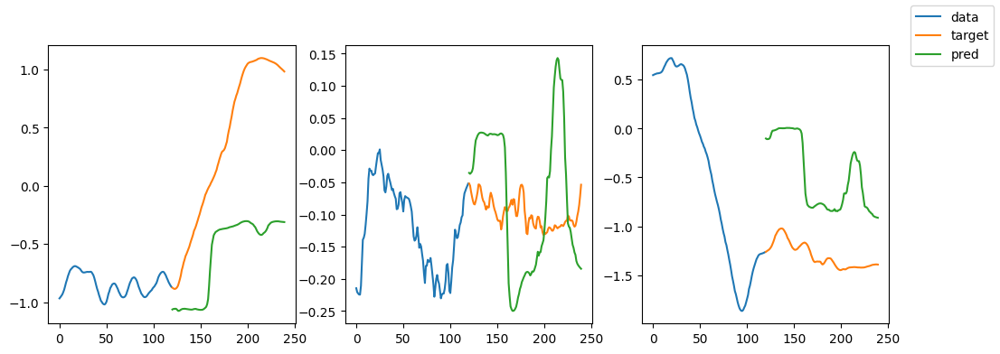

| epoch  81 |   148/  373 batches | lr 0.00008 | ms/batch 11.40303 | loss 0.53536
training prediction


<Figure size 640x480 with 0 Axes>

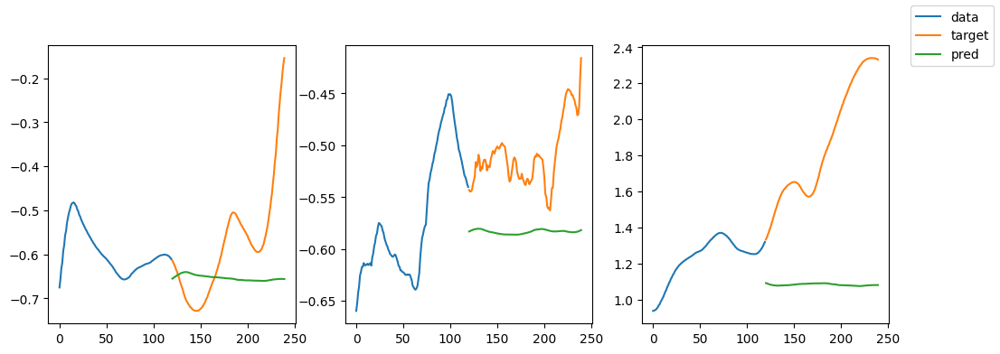

| epoch  81 |   222/  373 batches | lr 0.00008 | ms/batch 14.18869 | loss 0.55428
training prediction


<Figure size 640x480 with 0 Axes>

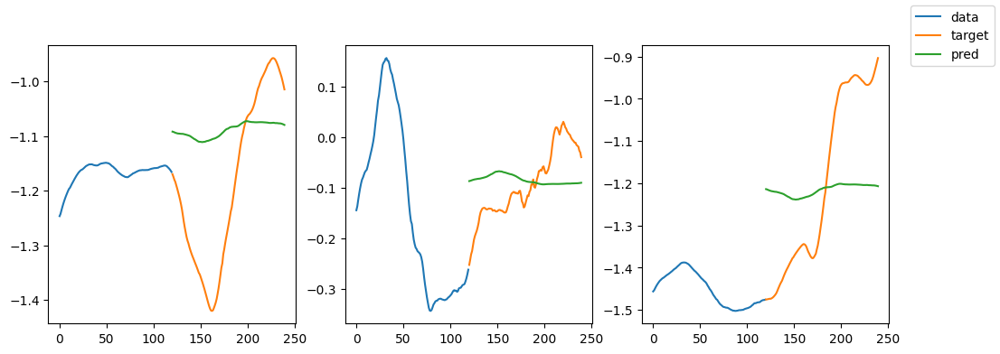

| epoch  81 |   296/  373 batches | lr 0.00008 | ms/batch 11.41251 | loss 0.57108
training prediction


<Figure size 640x480 with 0 Axes>

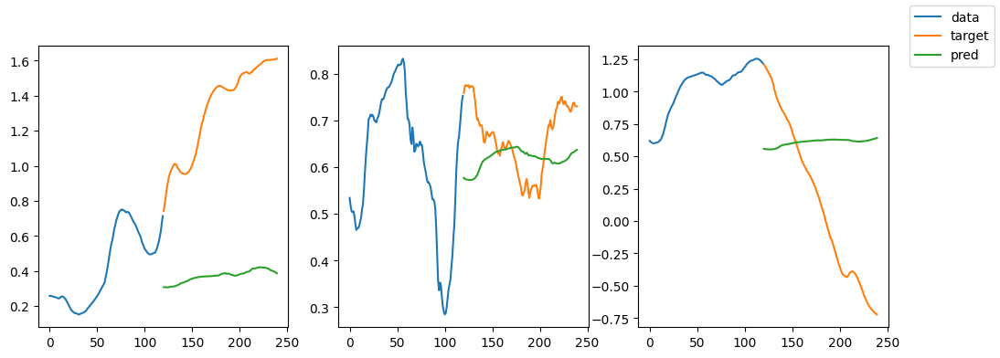

In [ ]:
# Trainig
#build live matplotlib fig


#plt.ion()
#fig.show()
#fig.canvas.draw()
epochs = 200
LOAD_MODEL = False
if LOAD_MODEL:
    load_ckpt(f"{os.getcwd()}/checkpoints/batch_{BATCH_SIZE}_{HISTORY_TIME}_{PREDICTION_TIME}_ckpts.pt".format(os.getcwd(), epochs, batch_size), model, optimizer)
lr = 0.1
scaler = torch.cuda.amp.GradScaler()
print(scaler)
best_val_loss = float('inf')
#writer = SummaryWriter("run/loss_plot")
step = 0
for epoch in tqdm(range(1, epochs+1)):
    print(f'Epoch #{epoch}')
    epoch_start_time = time.time()
    train_loss, sep_train_loss, train_pearsonr = train(model, train_dataloader, optimizer, scaler, None, step, feature_names, plot_flag=True if epoch % 2 == 1 else False)
#     print(train_loss)
    train_losses.append(train_loss)
    sep_train_losses.append(sep_train_loss)
    mean_loss = sum(train_losses)/len(train_losses)
    val_loss, sep_val_loss, val_pearsonr = validate(model, val_dataloader, feature_names, plot_flag=True if epoch % 2 == 1 else False)
    val_losses.append(val_loss)
    sep_val_losses.append(sep_val_loss)
    test_loss, sep_test_loss, test_pearsonr = validate(model, test_dataloader, feature_names, plot_flag=True if epoch % 2 == 1 else False)
    test_losses.append(test_loss)
    sep_test_losses.append(sep_test_loss)
    elapsed = time.time() - epoch_start_time
    print('-' * 89)
    print(f'| end of epoch {epoch:3d} | time: {elapsed:5.2f}s | '
        f'valid loss {val_loss:5.4f} | mean loss {mean_loss:8.4f}')
    print('-' * 89)
    if epoch % 2 == 1:
        fig, ax = plt.subplots(1,2, figsize=(12,4))
        #ax.plot([i.detach().cpu().numpy() for i in test_losses], label='train loss')
        ax[0].plot([i.detach().cpu().numpy() for i in val_losses[5:]] , label='validation loss')
        ax[0].plot([i  for i in train_losses[5:]] , label='train loss')
        ax[0].set_title("Losses")

        ax[0].legend()
        ax[1].plot([i.detach().cpu().numpy() for i in test_losses], label='test loss')
        ax[1].set_title("Losses")
        ax[1].legend()
        #fig.canvas.draw()
        plt.show()
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        # save model
#         save_ckpt("{}/checkpoints/epoch_{}_ckpts.pt".format(os.getcwd(), epoch), model, optimizer,epochs, val_loss)
        save_ckpt(f"{os.getcwd()}/checkpoints", model, optimizer, epoch, train_losses, val_losses)

    # scheduler.step(mean_loss)
    scheduler.step()
# load_ckpt("/content/drive/MyDrive/checkpoints.pt", model, optimizer)


In [88]:
mean_std

array([[-0.18793215,  1.5261388 , -0.13073014,  0.6257753 ,  0.15468523,
         0.60360074],
       [-0.62449   ,  1.5019501 ,  0.02522216,  0.5530124 ,  0.03978195,
         0.72023517],
       [-0.3388281 ,  1.5143266 ,  0.12828556,  0.20926948,  0.03762233,
         0.37227112]], dtype=float32)

In [ ]:
model.eval()
with torch.no_grad():
    for (data, targets) in train_xyz_dataloader:
        data = data.to(device=DEVICE) # [N, seq_len, feature_size]
        targets = targets.to(device=DEVICE) # [N, seq_len, feature_size]
        output = model(data)
        print(data.shape)
        fig, ax = plt.subplots(1,3,figsize=(12,4))
        if len(ax.shape) == 1:
            ax = np.expand_dims(ax, axis=0)
        for i in range(1):
            for j in range(3):
                ax[i,j].plot(targets.detach().cpu().numpy()[0,:,3*i+j])
                ax[i,j].plot(data.detach().cpu().numpy()[0,:,3*i+j])
                ax[i,j].plot(output.detach().cpu().numpy()[0,:,3*i+j])
                ax[i,j].legend(['target','data','predicted'])
                ax[i,j].set_title('train data and target feature #{}'.format(j))
        plt.show()

In [33]:
import math
import torch
import torch.nn as nn
import torch.nn.functional as F


__all__ = ['MultiHeadAttention', 'ScaledDotProductAttention']


class ScaledDotProductAttention(nn.Module):

    def forward(self, query, key, value, mask=None):
        dk = query.size()[-1]
        scores = query.matmul(key.transpose(-2, -1)) / math.sqrt(dk)
        if mask is not None:
            scores = scores.masked_fill(mask == 0, -1e9)
        attention = F.softmax(scores, dim=-1)
        return attention.matmul(value)


class MultiHeadAttention(nn.Module):

    def __init__(self,
                 dim_val,
                 in_features,
                 head_num,
                 bias=True,
                 activation=F.leaky_relu):
        """Multi-head attention.

        :param in_features: Size of each input sample.
        :param head_num: Number of heads.
        :param bias: Whether to use the bias term.
        :param activation: The activation after each linear transformation.
        """
        super(MultiHeadAttention, self).__init__()
        if in_features % head_num != 0:
            raise ValueError('`in_features`({}) should be divisible by `head_num`({})'.format(in_features, head_num))
        self.in_features = in_features
        self.head_num = head_num
        self.activation = activation
        self.bias = bias
        self.linear_q = nn.Linear(in_features, in_features, bias)
        self.linear_k = nn.Linear(in_features, in_features, bias)
        self.linear_v = nn.Linear(in_features, in_features, bias)
        self.linear_o = nn.Linear(in_features, dim_val, bias)
        self.q = nn.Linear(dim_val, in_features, bias = False)
        self.k = nn.Linear(dim_val, in_features, bias = False)
        self.v = nn.Linear(dim_val, in_features, bias = False)
        #self.fc = nn.Linear(in_features * head_dim, dim_val, bias = False)
    def forward(self, x, mask=None):
        q = self.q(x)
        k = self.k(x)
        v = self.v(x)
        q, k, v = self.linear_q(q), self.linear_k(k), self.linear_v(v)
        if self.activation is not None:
            q = self.activation(q)
            k = self.activation(k)
            v = self.activation(v)

        q = self._reshape_to_batches(q)
        k = self._reshape_to_batches(k)
        v = self._reshape_to_batches(v)
        if mask is not None:
            mask = mask.repeat(self.head_num, 1, 1)
        y = ScaledDotProductAttention()(q, k, v, mask)
        y = self._reshape_from_batches(y)

        y = self.linear_o(y)
        if self.activation is not None:
            y = self.activation(y)
        #import pdb;pdb.set_trace()
        #y = self.fc(y)
        return y

    @staticmethod
    def gen_history_mask(x):
        """Generate the mask that only uses history data.

        :param x: Input tensor.
        :return: The mask.
        """
        batch_size, seq_len, _ = x.size()
        return torch.tril(torch.ones(seq_len, seq_len)).view(1, seq_len, seq_len).repeat(batch_size, 1, 1)

    def _reshape_to_batches(self, x):
        batch_size, seq_len, in_feature = x.size()
        sub_dim = in_feature // self.head_num
        return x.reshape(batch_size, seq_len, self.head_num, sub_dim)\
                .permute(0, 2, 1, 3)\
                .reshape(batch_size * self.head_num, seq_len, sub_dim)

    def _reshape_from_batches(self, x):
        batch_size, seq_len, in_feature = x.size()
        batch_size //= self.head_num
        out_dim = in_feature * self.head_num
        return x.reshape(batch_size, self.head_num, seq_len, in_feature)\
                .permute(0, 2, 1, 3)\
                .reshape(batch_size, seq_len, out_dim)

    def extra_repr(self):
        return 'in_features={}, head_num={}, bias={}, activation={}'.format(
            self.in_features, self.head_num, self.bias, self.activation,
        )

In [ ]:
# x: [N, enc_seq_len, dim_val]
a = self.attn(x)
x1 = self.norm1(x + a)
a1 = self.fc1(F.elu(self.fc2(x1)))
out = self.norm2(x1 + a1) # [N, enc_seq_len, dim_val]

In [ ]:
# MLP
mlp = self.enc_input_fc(x) # [N, enc_seq_len, dim_val]
#encoder
e = self.encs[0](self.pos(mlp))
for enc in self.encs[1:]:
    e = enc(e) # [N, enc_seq_len, dim_val]
#decoder
out = self.out_fc(e) # [N, enc_seq_len, feature_size]

In [ ]:
hist(mlp.detach().cpu().numpy().ravel())

In [ ]:
test_losses

In [ ]:
val_loss.cpu()

In [55]:
%history -g -f filename